In [2]:
import numpy as np
import sys
sys.path.append('../wofs_phi')
import config as c
import utilities
from sklearn.metrics import brier_score_loss as BS
import os
from shutil import copy
import shutil
import copy
import matplotlib.pyplot as plt
import math
import pandas as pd
import matplotlib.ticker as ticker
import datetime as dt
#from wofs_phi import MLTrainer as t
#from wofs_phi import Grid
import imageio.v3 as iio
import skexplain
from copy import deepcopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import xarray as xr
import skexplain
import pickle
from matplotlib import rc, font_manager
from mpl_toolkits.axes_grid1 import make_axes_locatable
#from wofs.common.zarr import open_dataset
import matplotlib.colors as mpl_colors
import netCDF4 as ncdf
import statistics as stat

In [7]:
len(np.arange(0,1.01,0.1))

11

In [66]:
a = np.load('/work/ryan.martz/wofs_phi_data/experiments/obs_trained/length_60/hail/wofs_psv3_with_torp_obs_39km_trained_obs_39km_verified_hail_60min_bootstrapped_bss_from_raw_probs_by_lead_time_95_percent_CI.npy')
b = np.load('/work/ryan.martz/wofs_phi_data/experiments/obs_trained/length_60/hail/wofs_psv3_with_torp_obs_39km_trained_obs_39km_verified_hail_60min_bootstrapped_rel_30-90min_95_percent_CI.npy')
c = np.load('/work/ryan.martz/wofs_phi_data/experiments/obs_trained/length_60/hail/wofs_psv3_with_torp_obs_39km_trained_obs_39km_verified_hail_60min_bootstrapped_pd_30-90min_95_percent_CI.npy')

d = np.load('/work/ryan.martz/wofs_phi_data/experiments/warnings_trained/length_60/hail/wofs_psv3_with_torp_warnings_39km_trained_warnings_39km_verified_hail_60min_bootstrapped_bss_from_raw_probs_by_lead_time_95_percent_CI.npy')
e = np.load('/work/ryan.martz/wofs_phi_data/experiments/warnings_trained/length_60/hail/wofs_psv3_with_torp_warnings_39km_trained_warnings_39km_verified_hail_60min_bootstrapped_rel_30-90min_95_percent_CI.npy')
f = np.load('/work/ryan.martz/wofs_phi_data/experiments/warnings_trained/length_60/hail/wofs_psv3_with_torp_warnings_39km_trained_warnings_39km_verified_hail_60min_bootstrapped_pd_30-90min_95_percent_CI.npy')


In [67]:
a, d

(array([[0.28393136],
        [0.26898174],
        [0.25366623]]),
 array([[0.32855321],
        [0.31374963],
        [0.29898001]]))

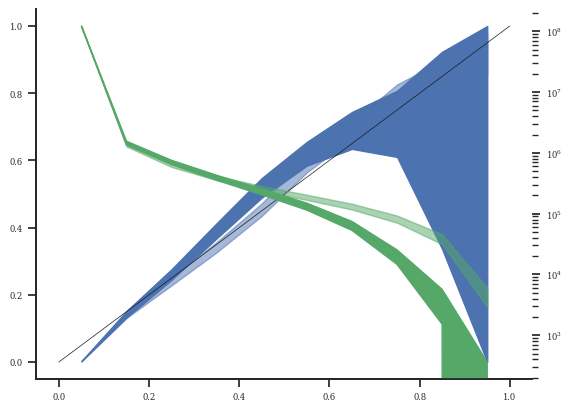

In [69]:
points = b[3,:]
fig, ax = plt.subplots()
ax.fill_between(points, b[10,:], y2 = b[12,:], color = 'b')
ax.fill_between(points, e[10,:], y2 = e[12,:], color = 'b', alpha = 0.5)
ax.plot([0,1], [0,1], 'k', linewidth = 0.5)
ax2 = ax.twinx()
ax2.set_yscale('log')
ax2.fill_between(points, b[13,:], y2 = b[15,:], color = 'g')
ax2.fill_between(points, e[13,:], y2 = e[15,:], color = 'g', alpha = 0.5)

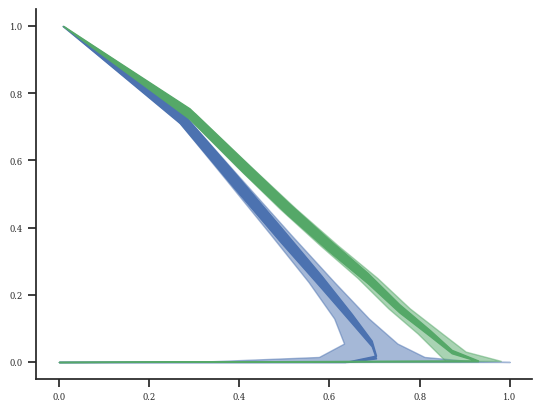

In [71]:
fig, ax = plt.subplots()
ax.fill_between(c[10,:],c[6,:], y2=c[8,:], color = 'b')
ax.fill_betweenx(c[7,:], c[9,:],x2=c[11,:], color = 'b', alpha = 0.5)
ax.fill_between(f[10,:],f[6,:], y2=f[8,:], color = 'g')
ax.fill_betweenx(f[7,:], f[9,:],x2=f[11,:], color = 'g', alpha = 0.5)

In [2]:
a = np.array([[1, 2, 3], [4, 5, 6]])
selections = np.array([1, 2, 1, 0, 0])
b = a[:,selections]

In [3]:
b

array([[2, 3, 2, 1, 1],
       [5, 6, 5, 4, 4]])

In [3]:
hail_warnings = np.load('/work/ryan.martz/wofs_phi_data/training_data/warnings/hail_warning_fcst_climos_bootstrapped.npy')
hail_lsrs_39 = np.load('/work/ryan.martz/wofs_phi_data/training_data/warnings/hail_39km_lsr_fcst_climos_bootstrapped.npy')

wind_warnings = np.load('/work/ryan.martz/wofs_phi_data/training_data/warnings/wind_warning_fcst_climos_bootstrapped.npy')
wind_lsrs_39 = np.load('/work/ryan.martz/wofs_phi_data/training_data/warnings/wind_39km_lsr_fcst_climos_bootstrapped.npy')
wind_lsrs_36 = np.load('/work/ryan.martz/wofs_phi_data/training_data/warnings/wind_36km_lsr_fcst_climos_bootstrapped.npy')
wind_lsrs_37 = np.load('/work/ryan.martz/wofs_phi_data/training_data/warnings/wind_37km_lsr_fcst_climos_bootstrapped.npy')
wind_lsrs_375 = np.load('/work/ryan.martz/wofs_phi_data/training_data/warnings/wind_375km_lsr_fcst_climos_bootstrapped.npy')
wind_lsrs_38 = np.load('/work/ryan.martz/wofs_phi_data/training_data/warnings/wind_38km_lsr_fcst_climos_bootstrapped.npy')

tor_warnings = np.load('/work/ryan.martz/wofs_phi_data/training_data/warnings/tornado_warning_fcst_climos_bootstrapped.npy')
tor_lsrs_39 = np.load('/work/ryan.martz/wofs_phi_data/training_data/warnings/tornado_39km_lsr_fcst_climos_bootstrapped.npy')

In [4]:
print('Hail Warnings: ', np.percentile(hail_warnings, 8), np.mean(hail_warnings), np.percentile(hail_warnings, 92))
print('Hail 39km LSRs: ', np.percentile(hail_lsrs_39, 8), np.mean(hail_lsrs_39), np.percentile(hail_lsrs_39, 92))
print()
print('Wind Warnings: ', np.percentile(wind_warnings, 8), np.mean(wind_warnings), np.percentile(wind_warnings, 92))
print('Wind 39km LSRs: ', np.percentile(wind_lsrs_39, 8), np.mean(wind_lsrs_39), np.percentile(wind_lsrs_39, 92))
print('Wind 36km LSRs: ', np.percentile(wind_lsrs_36, 8), np.mean(wind_lsrs_36), np.percentile(wind_lsrs_36, 92))
print('Wind 37km LSRs: ', np.percentile(wind_lsrs_37, 8), np.mean(wind_lsrs_37), np.percentile(wind_lsrs_37, 92))
print('Wind 37.5km LSRs: ', np.percentile(wind_lsrs_375, 8), np.mean(wind_lsrs_375), np.percentile(wind_lsrs_375, 92))
print('Wind 38km LSRs: ', np.percentile(wind_lsrs_38, 8), np.mean(wind_lsrs_38), np.percentile(wind_lsrs_38, 92))
print()
print('Tornado Warnings: ', np.percentile(tor_warnings, 8), np.mean(tor_warnings), np.percentile(tor_warnings, 92))
print('Tornado 39km LSRs: ', np.percentile(tor_lsrs_39, 8), np.mean(tor_lsrs_39), np.percentile(tor_lsrs_39, 92))

Hail Warnings:  0.007151812124167074 0.007561177730104556 0.007943507232244434
Hail 39km LSRs:  0.007361357617507558 0.0077438316218663384 0.008168649449236128

Wind Warnings:  0.00969262690286581 0.010275797773985589 0.010852624735901185
Wind 39km LSRs:  0.010525396834220692 0.011041880479863042 0.011568167302730257
Wind 36km LSRs:  0.009173600960896146 0.009618440391409742 0.010036518756297486
Wind 37km LSRs:  0.010074679021188205 0.010648187722885361 0.01114929846541521
Wind 37.5km LSRs:  0.009882756344622582 0.010396333380262036 0.01088699277786439
Wind 38km LSRs:  0.010074679021188205 0.010647555058036497 0.01114929846541521

Tornado Warnings:  0.001436357352079672 0.0015438655360281194 0.001660901191173599
Tornado 39km LSRs:  0.001439284330302676 0.0015736690650290403 0.001717110919424043


In [10]:
### Old ###

print('Hail Warnings: ', np.percentile(hail_warnings, 5), np.mean(hail_warnings), np.percentile(hail_warnings, 92))
print('Hail 39km LSRs: ', np.percentile(hail_lsrs_39, 5), np.mean(hail_lsrs_39), np.percentile(hail_lsrs_39, 95))
print('Hail 40km LSRs: ', np.percentile(hail_lsrs_40, 8), np.mean(hail_lsrs_40), np.percentile(hail_lsrs_40, 92))
print('Hail 41km LSRs: ', np.percentile(hail_lsrs_41, 8), np.mean(hail_lsrs_41), np.percentile(hail_lsrs_41, 92))
print('Hail 42km LSRs: ', np.percentile(hail_lsrs_42, 8), np.mean(hail_lsrs_42), np.percentile(hail_lsrs_42, 92))

print('Wind Warnings: ', np.percentile(wind_warnings, 8), np.mean(wind_warnings), np.percentile(wind_warnings, 92))
print('Wind 39km LSRs: ', np.percentile(wind_lsrs_39, 8), np.mean(wind_lsrs_39), np.percentile(wind_lsrs_39, 92))
print('Wind 40km LSRs: ', np.percentile(wind_lsrs_40, 8), np.mean(wind_lsrs_40), np.percentile(wind_lsrs_40, 92))
print('Wind 41km LSRs: ', np.percentile(wind_lsrs_41, 8), np.mean(wind_lsrs_41), np.percentile(wind_lsrs_41, 92))
print('Wind 42km LSRs: ', np.percentile(wind_lsrs_42, 8), np.mean(wind_lsrs_42), np.percentile(wind_lsrs_42, 92))

print('Tornado Warnings: ', np.percentile(tor_warnings, 8), np.mean(tor_warnings), np.percentile(tor_warnings, 92))
print('Tornado 39km LSRs: ', np.percentile(tor_lsrs_39, 8), np.mean(tor_lsrs_39), np.percentile(tor_lsrs_39, 92))
print('Tornado 40km LSRs: ', np.percentile(tor_lsrs_40, 8), np.mean(tor_lsrs_40), np.percentile(tor_lsrs_40, 92))
print('Tornado 41km LSRs: ', np.percentile(tor_lsrs_41, 8), np.mean(tor_lsrs_41), np.percentile(tor_lsrs_41, 92))
print('Tornado 42km LSRs: ', np.percentile(tor_lsrs_42, 8), np.mean(tor_lsrs_42), np.percentile(tor_lsrs_42, 92))

Hail Warnings:  0.006501615895332943 0.00694361972368678 0.007316173598906462
Hail 39km LSRs:  0.0056235012686312175 0.005977377827582093 0.006380379798426006
Hail 40km LSRs:  0.00687091766473125 0.007316048104994317 0.007730844451662372
Hail 41km LSRs:  0.00687091766473125 0.0073164883753000926 0.007730844451662372
Hail 42km LSRs:  0.00687091766473125 0.007316175655827168 0.007730844451662372
Wind Warnings:  0.008901205819175943 0.009352006333235697 0.009818721929310683
Wind 39km LSRs:  0.007948872296205887 0.008340536166403718 0.008765128877252072
Wind 40km LSRs:  0.010160664070507183 0.010642682364173223 0.011157725499942898
Wind 41km LSRs:  0.010135424849960734 0.010637828997389543 0.011157119384434293
Wind 42km LSRs:  0.010160664070507183 0.010644282422723524 0.011157725499942898
Tornado Warnings:  0.001428485647334505 0.0015404172368677991 0.001643087287639133
Tornado 39km LSRs:  0.0014100273463855415 0.0015701762683579315 0.0017138937801639885
Tornado 40km LSRs:  0.0017037751733

In [16]:
leads = [30, 60, 90, 120, 150, 180]
hazards = ['hail', 'wind', 'tornado']
for l in range(6):
    for h in range(3):
        sum_events = 0
        sum_all = 0
        for f in range(5):
            hazard = hazards[h]
            lead = leads[l]
            fold = f
            events = np.load('/work/ryan.martz/wofs_phi_data/warnings_train/test_fcsts/wofs_psv2_no_torp/%s/wofslag_25/length_60/fold%s/wofs_psv2_no_torp_warnings_trained_all_%s_events_spinup25min_length60min_%s-%s_fold%s.npy'\
                            %(hazard, fold, hazard, lead, lead+60, fold))
            sum_events += np.sum(events)
            sum_all += events.size
        print('%s, %s-%smin: ' %(hazard, lead, lead+60), round(sum_events/sum_all, 5))



hail, 30-90min:  0.00874
wind, 30-90min:  0.01195
tornado, 30-90min:  0.00207
hail, 60-120min:  0.01022
wind, 60-120min:  0.01307
tornado, 60-120min:  0.00217
hail, 90-150min:  0.00901
wind, 90-150min:  0.01243
tornado, 90-150min:  0.00205
hail, 120-180min:  0.01049
wind, 120-180min:  0.0135
tornado, 120-180min:  0.00212
hail, 150-210min:  0.00754
wind, 150-210min:  0.01016
tornado, 150-210min:  0.00164
hail, 180-240min:  0.00744
wind, 180-240min:  0.01006
tornado, 180-240min:  0.0016


In [12]:
hazards = ['hail', 'wind', 'tornado']
leads = [30, 60, 90, 120, 150, 180]

for i in range(6):
    for j in range(3):
        lead = leads[i]
        hazard = hazards[j]
        all_events_obsw = np.load('/work/ryan.martz/wofs_phi_data/archive/defense_data/obs_and_warnings_train/test_fcsts/wofs_psv3_with_torp/%s/wofslag_25/length_60/all_%s_obs_and_warnings_%s-%smin_r39km.npy' %(hazard, hazard, lead, lead+60))
        all_events_obs = np.load('/work/ryan.martz/wofs_phi_data/archive/defense_data/obs_train/test_fcsts/wofs_psv3_with_torp/%s/wofslag_25/length_60/all_%s_obs_%s-%smin_r39km.npy' %(hazard, hazard, lead, lead+60))

        print('%s, %s-%smin: ' %(hazard, lead, lead+60), round(np.sum(all_events_obs)/len(all_events_obs), 5))


hail, 30-90min:  0.00879
wind, 30-90min:  0.01082
tornado, 30-90min:  0.00223
hail, 60-120min:  0.00862
wind, 60-120min:  0.01074
tornado, 60-120min:  0.00217
hail, 90-150min:  0.00853
wind, 90-150min:  0.01073
tornado, 90-150min:  0.0021
hail, 120-180min:  0.00824
wind, 120-180min:  0.01058
tornado, 120-180min:  0.00202
hail, 150-210min:  0.00673
wind, 150-210min:  0.00991
tornado, 150-210min:  0.00174
hail, 180-240min:  0.00633
wind, 180-240min:  0.00971
tornado, 180-240min:  0.00162


In [36]:
hazard = 'tornado'
lead = 180

all_fcst_bs_obsw = np.load('/work/ryan.martz/wofs_phi_data/obs_and_warnings_train/test_fcsts/wofs_psv3_with_torp/%s/wofslag_25/length_60/wofs_psv3_with_torp_obs_and_warnings_r39km_trained_all_%s_test_daily_prob_bs_%s-%smin.npy' %(hazard, hazard, lead, lead+60))
all_fcst_bs_obs = np.load('/work/ryan.martz/wofs_phi_data/obs_train/test_fcsts/wofs_psv3_with_torp/%s/wofslag_25/length_60/wofs_psv3_with_torp_obs_r39km_trained_all_%s_test_daily_prob_bs_%s-%smin.npy' %(hazard, hazard, lead, lead+60))
all_fcst_bs_baseline = np.load('/work/ryan.martz/wofs_phi_data/obs_and_warnings_train/test_fcsts/wofs_psv2_no_torp/%s/wofslag_25/length_60/wofs_psv2_no_torp_obs_and_warnings_r39km_trained_all_%s_test_daily_prob_bs_%s-%smin.npy' %(hazard, hazard, lead, lead+60))
all_fcst_bs_ps0wt = np.load('/work/ryan.martz/wofs_phi_data/obs_and_warnings_train/test_fcsts/wofs_psv0_with_torp/%s/wofslag_25/length_60/wofs_psv0_with_torp_obs_and_warnings_r39km_trained_all_%s_test_daily_prob_bs_%s-%smin.npy' %(hazard, hazard, lead, lead+60))

print(stat.stdev(all_fcst_bs_obsw), stat.stdev(all_fcst_bs_obs), stat.stdev(all_fcst_bs_baseline), stat.stdev(all_fcst_bs_ps0wt))


0.005914345311158497 0.004582705918813867 0.005461637888007927 0.00593555133804137


In [37]:
#obsw:obs
stat.stdev(all_fcst_bs_obsw)/stat.stdev(all_fcst_bs_obs)

1.2905792813101338

In [38]:
#baseline:ps3wt
stat.stdev(all_fcst_bs_baseline)/stat.stdev(all_fcst_bs_obs)

1.1917932297566132

In [39]:
#ps3wt:ps0wt
stat.stdev(all_fcst_bs_obsw)/stat.stdev(all_fcst_bs_ps0wt)

0.9964272860809135

In [13]:
all_events_ps3wt.size

123660000

In [ ]:
class Wofs:
    '''Handles the wofs forecasting/processing'''
    
    #Number of WoFS members 
    N_MEMBERS = 18

    #Will compute number of members exceeding this threshold 
    DBZ_THRESH = 40 

    #Dictionary converting wofs initialization time strings to integers in order 
    #(to be used for converting wofs initialization times to 1-d predictors
    INIT_TIME_DICT = {'1700':1, '1730':2, '1800':3, '1830':4, '1900':5, '1930':6,\
                        '2000':7, '2030':8, '2100':9, '2130':10, '2200':11, '2230':12,\
                        '2300':13, '2330':14, '0000':15, '0030':16, '0100':17, '0130':18,\
                        '0200':19, '0230':20, '0300':21, '0330':22, '0400':23, '0430':24,\
                        '0500':25, '0530':26, '0600':27} 

    #Legacy file naming conventions 
    ENS_VARS = ["ws_80", "dbz_1km", "wz_0to2_instant", "uh_0to2_instant",  "uh_2to5", "w_up",\
                     "w_1km", "w_down", "buoyancy", "div_10m", "10-500m_bulkshear", "ctt", "fed",\
                     "rh_avg", "okubo_weiss", "hail", "hailcast", "freezing_level", "comp_dz"]

    ENV_VARS = ["mslp", "u_10", "v_10", "td_2", "t_2", "qv_2", "theta_e", "omega", "psfc", \
                            "pbl_mfc", "mid_level_lapse_rate", "low_level_lapse_rate" ]
    
    #variable names for the winds at the levels we want
    FIRST_GUESS_U_NAMES = ["u_10", "U_850", "U_700", "U_500"]
    FIRST_GUESS_V_NAMES = ["v_10", "V_850", "V_700", "V_500"]
    
    #pressure levels to be used, the "0" level gets replaced by mslp at each gridpoint
    FIRST_GUESS_LEVELS = [0, 850, 700, 500]
    
    SVR_VARS = ["shear_u_0to1", "shear_v_0to1", "shear_u_0to3", "shear_v_0to3", "shear_u_0to6", "shear_v_0to6",\
                      "srh_0to500", "srh_0to1", "srh_0to3", "cape_sfc", "cin_sfc", "lcl_sfc", "lfc_sfc",\
                       "stp", "scp", "stp_srh0to500"]
    

    def __init__(self, xarr):
        ''' Wofs object will contain a geodataframe of attributes and an xarray of predictors.
            @gdf is the geodataframe -- exclude for now because we might not need
            @xarr is the xarray
            @first_guess_u is the pressure weighted ensemble mean of u wind at 10m
                and 850, 700, and 500 hPa
            @first_guess_v is the pressure weighted ensemble mean of v wind at 10m
                and 850, 700, and 500 hPa
        '''


        #self.gdf = gdf
        self.xarr = xarr
        self.first_guess_u = np.zeros((300,300))
        self.first_guess_v = np.zeros((300,300))

        return 


    @classmethod
    def preprocess_wofs(cls, specs, grid, wofs_path, wofs_files):
        ''' Handles the WoFS preprocessing--like the factory/blueprint method for the WoFS side of things.
            @specs is the current ForecastSpecs object
            @grid is the current Grid object (should be current WoFS grid
            @wofs_path is the path to the wofs files 
            @wofs_files is a list of wofs files that are considered
        '''

        #Get the wofs fields and methods from text files (set in the config.py file)
        wofs_fields = np.genfromtxt(c.wofs_fields_file, dtype='str') 
        wofs_methods = np.genfromtxt(c.wofs_methods_file, dtype='str') 
         
        
        #First, obtain the list of WoFS_Agg objects for all/all standard variables 
        
        temporal_agg_list = WoFS_Agg.create_wofs_agg_list(wofs_fields, wofs_methods, specs, grid,\
                                wofs_path, wofs_files)

        #print (temporal_agg_list) 
        wofs_xr = Wofs.list_to_xr(temporal_agg_list) 

        #Create new wofs object that holds the xarray 
        wofs_obj = Wofs(wofs_xr) 

        #Add wofs metadata
        wofs_obj.add_wofs_metadata(wofs_path, wofs_files[0])
        
        #create first guess storm motions
        wofs_obj.set_first_guess_storm_motion(wofs_path, wofs_files[0], grid)

        return wofs_obj
    
    def set_first_guess_storm_motion(self, wofs_path, wofs_file, grid):
        ''' Sets the first guess storm motion fields for QCing ProbSevere
            object motion. Uses the first WoFS file in the list to get
            estimate of winds at the start of the extrapolation for PS
            objects.
            @wofs_path is the full path to the current WoFS file
            @wofs_file is the first WoFS file in the list of WoFS files
                being used at this timestep
            @grid is the grid based on the current WoFS domain
        '''
        
        try:
            wofs_data = nc.Dataset('%s/%s' %(wofs_path, wofs_file))
        except:
            if "ALL" in wofs_file:
                wofs_file = wofs_file.replace("ALL", "ENV")
            wofs_data = nc.Dataset('%s/%s' %(wofs_path, wofs_file))
            
        u_winds = np.zeros((len(Wofs.FIRST_GUESS_LEVELS), grid.nx, grid.ny))
        v_winds = np.zeros((len(Wofs.FIRST_GUESS_LEVELS), grid.nx, grid.ny))
        pressures = np.zeros((len(Wofs.FIRST_GUESS_LEVELS), grid.nx, grid.ny))
        pressures[0,:,:] = np.mean(wofs_data.variables['mslp'][:].data, axis = 0)
        for k in range(len(Wofs.FIRST_GUESS_U_NAMES)):
            u_name = Wofs.FIRST_GUESS_U_NAMES[k]
            v_name = Wofs.FIRST_GUESS_V_NAMES[k]
            u_winds[k,:,:] = np.mean(wofs_data.variables[u_name][:].data, axis=0)
            v_winds[k,:,:] = np.mean(wofs_data.variables[v_name][:].data, axis=0)
            if k > 0:
                pressures[k,:,:] = np.zeros((grid.nx, grid.ny)) + Wofs.FIRST_GUESS_LEVELS[k]
        
        self.first_guess_u = np.trapz(pressures * u_winds, x=pressures, axis=0)/(0.5 * (np.min(Wofs.FIRST_GUESS_LEVELS) ** 2 - pressures[0,:,:] ** 2))
        self.first_guess_v = np.trapz(pressures * v_winds, x=pressures, axis=0)/(0.5 * (np.min(Wofs.FIRST_GUESS_LEVELS) ** 2 - pressures[0,:,:] ** 2))
        
        speed = np.sqrt(np.power(self.first_guess_u, 2) + np.power(self.first_guess_v, 2))
        
        #take 85% of speed if its faster than 30 kt, otherwise 75% of speed
        self.first_guess_u[np.where(speed > 30)] = self.first_guess_u[np.where(speed > 30)] * 0.85
        self.first_guess_v[np.where(speed > 30)] = self.first_guess_v[np.where(speed > 30)] * 0.85
        self.first_guess_u[np.where(speed <= 30)] = self.first_guess_u[np.where(speed <= 30)] * 0.75
        self.first_guess_v[np.where(speed <= 30)] = self.first_guess_v[np.where(speed <= 30)] * 0.75
        
        #convert knots to km/min:
        self.first_guess_u = (self.first_guess_u * 0.514) * 0.06
        self.first_guess_v = (self.first_guess_v * 0.514) * 0.06
        
        new_speed = np.sqrt(np.power(self.first_guess_u, 2) + np.power(self.first_guess_v, 2))
        
        #rotate 30 degrees to the right for speeds > 30 kt, 20 degrees for speeds less than/equal to 30 kt
        new_dir_30r = np.degrees(np.arctan(self.first_guess_v/self.first_guess_u)) - 30
        new_dir_20r = np.degrees(np.arctan(self.first_guess_v/self.first_guess_u)) - 20
        
        self.first_guess_u[np.where(speed > 30)] = new_speed[np.where(speed > 30)] * np.cos(np.radians(new_dir_30r[np.where(speed > 30)]))
        self.first_guess_v[np.where(speed > 30)] = new_speed[np.where(speed > 30)] * np.sin(np.radians(new_dir_30r[np.where(speed > 30)]))
        
        self.first_guess_u[np.where(speed <= 30)] = new_speed[np.where(speed <= 30)] * np.cos(np.radians(new_dir_20r[np.where(speed <= 30)]))
        self.first_guess_v[np.where(speed <= 30)] = new_speed[np.where(speed <= 30)] * np.sin(np.radians(new_dir_20r[np.where(speed <= 30)]))
        
        return

    def add_wofs_metadata(self, wofsPath, wofsFile):
        '''Adds the wofs metadata based on the xarr attribute and a wofs summary file
            @wofsPath is the path to the wofs summary file 
            @wofsFile is the name of the wofs summary file 
        '''


        #Load dataset into an xarray
        try:
            full_file = "%s/%s" %(wofsPath, wofsFile)
            tmp_data = open_dataset(full_file, decode_times=False) 
        except FileNotFoundError:
            #try converting to legacy filename if ALL file isn't found 
            legacy_name = wofsFile.replace("ALL", "ENV") 
            full_file = "%s/%s" %(wofsPath, legacy_name)
            tmp_data = open_dataset(full_file, decode_times=False) 
            
    
        #Modify the existing xarray attribute
        self.xarr['xlat'] = tmp_data['xlat']
        self.xarr['xlat'].attrs = remove_reserved_keys(tmp_data['xlat'].attrs)

        self.xarr['xlon'] = tmp_data['xlon']
        self.xarr['xlon'].attrs = remove_reserved_keys(tmp_data['xlon'].attrs)

        #copy global attributes 
        self.xarr.attrs = remove_reserved_keys(tmp_data.attrs)



        return 


    @staticmethod 
    def list_to_xr(obj_list):
        '''Converts list of WoFS_Agg objects to an xarray with dimensions
            (nY, nX)
            @obj_list is a list of WoFS_Agg objects that will be used to 
                create the xarray
        '''

        nY = obj_list[0].ny #number of y points
        nX = obj_list[0].nx #number of x points 

        #Create new x array dataset with dimensions (nY, nX)
        new_xr = xr.Dataset(data_vars=None, coords={"y": (range(nY)), "x": (range(nX))})

        for obj in obj_list: 
            mlName = obj.ml_var_name
            new_xr[mlName] = (["y", "x"], obj.agg_grid)
             

        return new_xr

In [ ]:
class WoFS_Agg: 
    '''
        WoFS_Agg handles the temporal aggregation of wofs files 

    '''

    def __init__(self, wofs_var_name, ml_var_name, mem_index, \
                    filepath, filenames, method, nx, ny, grid_time_list, agg_grid,
                    threshold, legacy_filenames):
        '''
            @wofs_var_name is the name of the field as represented in wofs file
            @ml_var_name is the name of the field as represented in the ML 
            @mem_index is an integer corresponding to what member we care about
                #0 is first member, 1 is second, 2 is third, etc. 
                #-1 means we care about the ensemble mean 
                #-2 means we care about the number of members exceeding a threshold
                #(@threshold) 
            @filepath is the path to the wofs files 
            @filenames is the list of wofs filenames (no path) 
            @method is the temporal aggregation method (e.g., "min", "max")
            @nx is the number of x wofs points
            @ny is the number of y wofs points 
            @grid_time_list is the list of initial wofs grids at the relevant time
                [list of np array (ny,nx) at each time over the period]
            @agg_grid is the time-aggregated grid for the given variable  
            @threshold is the threshold used to compute threshold exceedance 
                (if applicable; for most variables, probably won't be applicable) 
            @legacy_filenames is the list of filenames with the "ALL" replaced with, 
                e.g., ENV, ENS, SWT, etc., as appropriate, based on the legacy
                file naming convention. 
        '''

        self.wofs_var_name = wofs_var_name
        self.ml_var_name = ml_var_name 
        self.mem_index = mem_index
        self.filepath = filepath 
        self.filenames = filenames
        self.method = method 
        self.nx = nx 
        self.ny = ny 
        self.grid_time_list = grid_time_list
        self.agg_grid = agg_grid  
        self.threshold = threshold
        self.legacy_filenames = legacy_filenames

        return 


    @classmethod
    def create_wofs_agg_list(cls, wofsFields, wofsMethods, specsObj, gridObj, \
                                wofsPath, wofsFilenames):
        ''' Creates/returns a list of (complete) WoFS_Agg objects (for each variable) 
            @wofsFields is a list of wofs fields (from text file) 
            @wofsMethods is a list of computation methods to apply to the wofs fields
            @specsObj is the ForecastSpecs object for the current situation
            @gridObj is the Grid object for the current situation. 
            @wofsPath is the path to the wofs files 
            @wofsFilenames is the list of wofs filenames (without path) 
        '''

        agg_files = [] #Will hold the list of time-aggregated WoFS_Agg objects

        #Used to initialize WoFS_Agg object
        initial_grid = np.zeros((gridObj.ny, gridObj.nx))

        initial_grid_list = [initial_grid for g in wofsFilenames] 
            

        #Create an object for each variable 
        for v in range(len(wofsFields)):
        
            #set ml variable name
            ml_variable = wofsFields[v] 

            #Set wofs variable name and member index from ml variable name 
            wofs_variable, member_index, threshold_value = WoFS_Agg.find_var_attributes(ml_variable) 

            #Set computational method to be used for aggregation
            wofs_method = wofsMethods[v] 

            #Get list of legacy filenames -- e.g., replace ALL with ENS, ENV, SVR, etc. 
            #as was done in the old naming convention. 
            legacyFilenames = WoFS_Agg.get_legacy_filenames(wofs_variable, wofsFilenames) 
    
            #Create an initial WoFS_Agg object
            wofs_agg_obj = WoFS_Agg(wofs_variable, ml_variable, member_index, wofsPath, wofsFilenames,\
                                wofs_method, gridObj.nx, gridObj.ny, initial_grid_list, initial_grid, \
                                threshold_value, legacyFilenames)


            #Set the object's grid time list 
            wofs_agg_obj.set_grid_time_list() 

            #Set the object's temporal aggregation
            wofs_agg_obj.set_temporal_aggregation()

            #Add wofs_agg_obj to list 
            agg_files.append(wofs_agg_obj) 


        return agg_files

    def set_temporal_aggregation(self):
        ''' Sets an instance's agg_grid attribute based on the other attributes of 
                the instance.'''


        #Convert list to np array 
        #Dimensions will be (number of times, number of members, y points, x points)
        time_array = WoFS_Agg.time_list_to_array(self.grid_time_list) 

        #How to proceed will depend on the instance's member index and method (i.e.,
        #agg strategy. 

      
        #If mem_index is -1, we will take a time aggregation over the individual 
        #members, followed by an ensemble mean at each grid point 
        #(This will be for the majority of variables) 
        if (self.mem_index == -1):
            
            #Take time aggregation depending on the instance's method 
            if (self.method == "max"):
                time_agg = np.amax(time_array, axis=0)
            elif (self.method == "min"):
                time_agg = np.amin(time_array, axis=0) 


            #Take ensemble mean 
            time_agg = np.mean(time_agg, axis=0) 

            #Get rid of the masking element of the array    
            time_agg = np.ma.getdata(time_agg) 


        #In this case, we will take the aggregation of the individual member 
        #indicated by the mem_index 
        elif (self.mem_index >= 0):
            
            #First, extract the relevant member from time_array
            member_array = time_array[:,self.mem_index,:,:]

            #Take the time aggregation (depending on the instance's method) 
            #of the single member 
            if (self.method == "max"):
                time_agg = np.amax(member_array, axis=0) 
            elif (self.method == "min"):
                time_agg = np.amin(member_array, axis=0) 

        #In this case, we'd want to first apply the threshold to get a 
        #"probability" at each point and time and take the max/min of 
        #this probability over time.             
        elif (self.mem_index == -2):
    

            #Apply the threshold to each member
            probability_array = np.where(time_array >= self.threshold, 1/Wofs.N_MEMBERS, 0)

            #Sum over the ensemble members
            probability_array = np.sum(probability_array, axis=1) 

            #Take the max/min over time
            if (self.method == "max"):
                time_agg = np.amax(probability_array, axis=0)
            elif (self.method == "min"):
                time_agg = np.amin(probability_array, axis=0)


        #Get rid of nans and inf values -- NOTE: Moved this to where we 
        #first read in the WoFS data. 
        #np.nan_to_num(time_agg, copy=False, nan=c.nan_replace_value,\
        #        posinf=c.nan_replace_value, neginf=c.nan_replace_value)

        #Convert to float32 
        time_agg = np.float32(time_agg)

        #Update the instance's attribute 
        self.agg_grid = time_agg


        return 


    def set_grid_time_list(self):
        #Reads in the list of gridded data  over time from the relevant files

        data_list = self.populate_data_list()

        #Update the instance
        self.grid_time_list = data_list


        return 


    def populate_data_list(self):
        #Read in the data from the file at each time step 

        var_data_list = [] 
        for n in range(len(self.filenames)):

            full_filename = "%s/%s" %(self.filepath, self.filenames[n])
            full_legacy_filename = "%s/%s" %(self.filepath, self.legacy_filenames[n])

            if (c.use_ALL_files == False):
                try: 
                    data = open_dataset(full_legacy_filename, decode_times=False) 
                except FileNotFoundError:
                    try: 
                        #Try to load the ALL file if we can if the
                        #legacy file isn't there 
                        data = open_dataset(full_filename, decode_times=False) 
                    except FileNotFoundError:
                        print ("Neither %s nor %s found. Moving on." \
                                %(full_legacy_filename, full_filename))
                        continue 


            else: #if we are using the ALL files 
                try: 
                    data = open_dataset(full_filename, decode_times=False)
                except FileNotFoundError:
                    try: 
                        #Try to load the legacy file if the ALL file isn't there 
                        data = open_dataset(full_legacy_filename, decode_times=False)
                    except FileNotFoundError:

                        print ("Neither %s nor %s found. Moving on." \
                                %(full_filename, full_legacy_filename)) 

                        continue 


            #Extract relevant variable 
            var_data = data.variables[self.wofs_var_name][:]

            #Get rid of nans and inf values
            np.nan_to_num(var_data, copy=False, nan=c.nan_replace_value,\
                posinf=c.nan_replace_value, neginf=c.nan_replace_value)
            
            #Append to list 
            var_data_list.append(var_data) 


        return var_data_list 


    @staticmethod
    def time_list_to_array(time_list):
        '''Converts the list of wofs data (nm, ny, nx) to an array 
            (nt, nm, ny, nx), where nt is the number of times
            @time_list is the list of wofs data at successive lead times 

        '''

        nt = len(time_list)
        shape_of_list_elements = np.shape(time_list[0]) 
        nnm = shape_of_list_elements[0]
        nny = shape_of_list_elements[1]
        nnx = shape_of_list_elements[2] 

        out_array = np.zeros((nt, nnm, nny, nnx))

        for t in range(nt):
            out_array[t, :, :,:] = time_list[t] 
            


        return out_array

    @staticmethod
    def get_legacy_filenames(wofs_var_name, wofs_files_list):
        ''' Returns a list of wofs filenames in legacy format. 
            e.g., replacing the "ALL" with "ENS" or "ENV", etc. 
            @wofs_var_name is the string wofs variable name for 
                the current variable
            @wofs_files_list is the list of wofs filenames
                (with the ALL convention) 
        '''
    
        #Default
        new_names = copy.deepcopy(wofs_files_list) 

        if (wofs_var_name in Wofs.ENS_VARS):
            new_names = [s.replace("ALL", "ENS") for s in wofs_files_list] 

        elif (wofs_var_name in Wofs.ENV_VARS):
            new_names = [s.replace("ALL", "ENV") for s in wofs_files_list]

        elif (wofs_var_name in Wofs.SVR_VARS):
            new_names = [s.replace("ALL", "SVR") for s in wofs_files_list] 
            

        return new_names


    @staticmethod
    def find_var_attributes(ml_var):
        #Returns the appropriate wofs variable name, member index, and
        #threshold value given the incoming ml variable name (@ml_var) 

        #Default threshold
        #threshold_val is the threshold we use for finding the 
        #number of wofs members meeting or exceeding this value; 
        #only used for a small number of variables, so most of
        #the time, will be set to -999.0
        threshold_val = -999.0
        

        if (ml_var == "m1_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 0
        elif (ml_var == "m2_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 1
        elif (ml_var == "m3_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 2
        elif (ml_var == "m4_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 3
        elif (ml_var == "m5_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 4
        elif (ml_var == "m6_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 5
        elif (ml_var == "m7_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 6
        elif (ml_var == "m8_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 7
        elif (ml_var == "m9_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 8
        elif (ml_var == "m10_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 9
        elif (ml_var == "m11_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 10
        elif (ml_var == "m12_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 11
        elif (ml_var == "m13_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 12
        elif (ml_var == "m14_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 13
        elif (ml_var == "m15_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 14
        elif (ml_var == "m16_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 15
        elif (ml_var == "m17_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 16
        elif (ml_var == "m18_uh_2to5"):
            wofs_var = "uh_2to5"
            mem_index = 17
        elif (ml_var == "prob40dbz"):
            wofs_var = "comp_dz"
            mem_index = -2
            threshold_val = Wofs.DBZ_THRESH

        #Default
        else: 
            wofs_var = copy.deepcopy(ml_var)     
            mem_index = -1       

        return wofs_var, mem_index, threshold_val

In [ ]:
class Grid: 
    '''Handles the (wofs) grid attributes.'''


    def __init__(self, ny, nx, lats, lons, tlat1, tlat2, stlon, sw_lat, ne_lat, sw_lon, ne_lon, ypts, xpts): 
        ''' @ny is number of y grid points,
            @nx is number of x grid points,
            @lats is list of latitudes 
            @lons is list of longitudes
            @tlat1 is true latitude 1
            @tlat2 is true latitude 2
            @stlon is standard longitude
            @sw_lat is the southwest corner latitude
            @ne_lat is the northeast corner latitude
            @sw_lon is the southwest corner longitude
            @ne_lon is the northeast corner longitude 
            @ypts is a 2-d array of y values (ny,nx) 
            @xpts is a 2-d array of x values (ny,nx) 
        '''

        self.ny = ny
        self.nx = nx
        self.lats = lats
        self.lons = lons
        self.tlat1 = tlat1
        self.tlat2 = tlat2
        self.stlon = stlon
        self.sw_lat = sw_lat
        self.ne_lat = ne_lat
        self.sw_lon = sw_lon
        self.ne_lon = ne_lon
        self.ypts = ypts
        self.xpts = xpts 


    @classmethod
    def create_wofs_grid(cls, wofs_path, wofs_file): 
        '''Creates a Grid object from a wofs path and wofs file.'''

        full_wofs_file = "%s/%s" %(wofs_path, wofs_file)

        #Get legacy file
        legacy_fnames = WoFS_Agg.get_legacy_filenames("mslp", [wofs_file])
        legacy_fname = legacy_fnames[0]

        full_legacy_wofs_file = "%s/%s" %(wofs_path, legacy_fname)

        #Add capabilities to account for ALL or legacy file names
        if (c.use_ALL_files == True):
            try: 
                ds = open_dataset(full_wofs_file, decode_times=False)
            except FileNotFoundError:
                try: 
                    ds = open_dataset(full_legacy_wofs_file, decode_times=False)
                except:
                    print ("Neither %s nor %s found" %(full_wofs_file, full_legacy_wofs_file))
                    quit()


        else: 

            try: 
                ds = open_dataset(full_legacy_wofs_file, decode_times=False)
            except FileNotFoundError:
                try: 
                    ds = open_dataset(full_wofs_file, decode_times=False) 
                except:
                    print ("Neither %s nor %s found" \
                            %(full_legacy_wofs_file, full_wofs_file))
                    quit() 


        ny = int(ds.attrs['ny'])
        nx = int(ds.attrs['nx'])


        wofsLats = ds.variables['xlat'][:]
        wofsLons = ds.variables['xlon'][:]

        Tlat1 = ds.attrs['TRUELAT1']
        Tlat2 = ds.attrs['TRUELAT2']
        Stlon = ds.attrs['STAND_LON']

        SW_lat = wofsLats[0,0]
        NE_lat = wofsLats[-1,-1]
        SW_lon = wofsLons[0,0]
        NE_lon = wofsLons[-1,-1]

        #Find arrays of x and y points 
        xArr, yArr = Grid.get_xy_points(ny, nx) 

        #Create new wofs Grid object 
        wofs_grid = Grid(ny, nx, wofsLats, wofsLons, Tlat1, Tlat2, Stlon, SW_lat, NE_lat, SW_lon, NE_lon, yArr, xArr)  

        return wofs_grid

    @staticmethod 
    def get_xy_points(num_y, num_x):
        '''Gets a grid of x and y points given the 
            number of points in the y direction (@num_y)
            and number of points in the x direction (@num_x) 
        '''

        x_arr = np.zeros((num_y, num_x)) 
        y_arr = np.zeros((num_y, num_x)) 
    
        for x in range(num_x):
            for y in range(num_y): 
                x_arr[y,x] = x
                y_arr[y,x] = y 
                


        return x_arr, y_arr

In [ ]:
def plot_probs(fig, ax, probs, obs, obs_color, levels, init_date, title,\
               cbar_ticks = [], cbar_font = 9, do_cbar = True, cmap = 'Blues', obs_lw = 0.25):
    wofs_template_directory = '/work2/wof/SummaryFiles/' + init_date + '/2200'
    wofs_file = 'wofs_SWT_00_' + init_date + '_2200_2200.nc'
    wofs_grid = Grid.create_wofs_grid(wofs_template_directory, wofs_file)
    
    #fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.STATES, edgecolor='black', linewidth=1)
    if (np.max(levels) >= 0.9):
        p = ax.contourf(wofs_grid.lons, wofs_grid.lats, probs, cmap=cmap, levels = levels,\
                        alpha = 0.8, antialiased = True, ls=None)
    elif (np.min(levels) < 0):
        p = ax.contourf(wofs_grid.lons, wofs_grid.lats, probs, cmap=cmap, levels = levels,\
                        alpha = 0.8, antialiased = True, extend = 'both', ls=None)
    else:
        p = ax.contourf(wofs_grid.lons, wofs_grid.lats, probs, cmap=cmap, levels = levels,\
                        alpha = 0.8, antialiased = True, extend = 'max', ls=None)
        
    ax.contour(wofs_grid.lons, wofs_grid.lats, obs, colors = obs_color, linewidths = obs_lw)
    
    if do_cbar:
        if len(cbar_ticks) == 0:
            cbar = fig.colorbar(p, ax=ax, orientation='horizontal')
        else:
            cbar = fig.colorbar(p, ax=ax, orientation='horizontal', ticks = cbar_ticks)
        cbar.ax.tick_params(labelsize=cbar_font)
    ax.set_title(title)
    #plt.close(fig)
    
    return fig, ax

In [ ]:
#2x2 plots of one lead time, all hazards

length = 60
date = '20190430'
init_str = '0100'
ps_init = '0024'
#date = '20200428'
#init_str = '2100'
#ps_init = '2124'
init = dt.datetime(1970, 1, 1, int(init_str[0:2]), int(init_str[2:]))
hazards = ['tornado', 'wind', 'hail']
labels = ['Tornado', 'Wind', 'Hail', '']
radius = 39
p_type = 'raw'
train_type = 'obs'
obs_type = train_type
#obs_type = 'obs'
model_type = 'wofs_psv2_with_torp'
obs_color = 'k'
#levels = np.arange(0.05, 0.51, 0.05)

gif_fnames = []

for lead in [30, 60, 90, 120, 150, 180]:
    start = init + dt.timedelta(seconds = lead*60)
    end = start + dt.timedelta(seconds = length*60)

    start_str = start.strftime('%H%M')
    end_str = end.strftime('%H%M')
    
    fig, ax = plt.subplots(2,2, figsize=(8,8), subplot_kw={'projection': ccrs.PlateCarree()})
    
    for i in range(len(hazards)):
        hazard = hazards[i]
        if hazard == 'hail':
            obs_color = 'b'
            levels = np.arange(0.1, 1.01, 0.1)
        elif hazard == 'wind':
            obs_color = 'c'
            levels = np.arange(0.1, 1.01, 0.1)
        elif hazard == 'tornado':
            obs_color = 'r'
            levels = np.arange(0.05, 0.51, 0.05)
        obs_color = 'k'
        row = math.floor(i/2)
        col = i % 2

        probs = np.genfromtxt('/work/ryan.martz/wofs_phi_data/%s_train/test_fcsts/%s/%s/wofslag_25/length_%s/%s/%s/%s_%s_trained_rf_%s_%s_probs_%s_init%s_v%s-%s_r%skm.txt'\
                              %(train_type, model_type, hazard, length, date, init_str, model_type, train_type, hazard, p_type, date, init_str, start_str, end_str, radius))
        obs = np.genfromtxt('/work/ryan.martz/wofs_phi_data/%s_train/test_fcsts/%s/%s/wofslag_25/length_%s/%s/%s/%s_%s_trained_rf_%s_events_%s_init%s_v%s-%s_r%skm.txt'\
                            %(obs_type, model_type, hazard, length, date, init_str, model_type, obs_type, hazard, date, init_str, start_str, end_str, radius)).reshape(300,300)
        title = ''
        plot_save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/Sample_Forecasts/2x2_plots'
        save_file = '%s_%s_trained_%s_overlayed_%s_probs_%s_init_%s_%s-%s_r%skm.png'\
        %(model_type, train_type, obs_type, p_type, date, init_str, lead, lead+length, radius)
        fig, ax[row, col] = plot_probs(fig, ax[row, col], probs, obs, obs_color, levels, date, title, cmap='rainbow', obs_lw = 1)
        ax[row, col].text(0.1,0.85, labels[i], fontname = 'DejaVu Sans',\
                          fontsize = 15, transform=ax[row,col].transAxes)
    ax[1,1].set_visible(False)
    fig.tight_layout()
    utilities.save_data(plot_save_dir, save_file, fig, 'png')
    gif_fnames.append('%s/%s' %(plot_save_dir, save_file))

gif_save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/Sample_Forecasts/2x2_gifs'
fcst_gif_file = '%s_%s_trained_%s_overlayed_%s_probs_%s_init_%s_r%skm.gif'\
%(model_type, train_type, obs_type, p_type, date, init_str, radius)
if length == 120:
    fcst_gif_file = '%s_%s_trained_%s_overlayed_%s_probs_%s_init_%s_r%skm_2_hour.gif'\
    %(model_type, train_type, obs_type, p_type, date, init_str, radius)

images = []
for filename in gif_fnames:
    images.append(iio.imread(filename))
iio.imwrite('%s/%s' %(gif_save_dir, fcst_gif_file), images, duration = 500, loop = 0)


In [156]:
#6x3 plot of all lead times, all hazards

length = 60
#date = '20190430'
#init_str = '0100'
#ps_init = '0024'
date = '20200428'
init_str = '2100'
ps_init = '2124'

init = dt.datetime(1970, 1, 1, int(init_str[0:2]), int(init_str[2:]))
hazards = ['tornado', 'wind', 'hail']
leads = [30, 60, 90, 120, 150, 180]
labels = np.array([['(a)', '(b)', '(c)', '(d)', '(e)', '(f)'],\
                   ['(g)', '(h)', '(i)', '(j)', '(k)', '(l)'],\
                   ['(m)', '(n)', '(o)', '(p)', '(q)', '(r)']])
if length == 120:
    labels = np.array([['(a)', '(b)', '(c)', '(d)'],\
                       ['(e)', '(f)', '(g)', '(h)'],\
                       ['(i)', '(j)', '(k)', '(l)']])
    fig, ax = plt.subplots(4,3, figsize=(8,12), subplot_kw={'projection': ccrs.PlateCarree()})
else:
    fig, ax = plt.subplots(6,3, figsize=(8,16), subplot_kw={'projection': ccrs.PlateCarree()})
radius = 39
p_type = 'raw'
train_type = 'obs_and_warnings'
obs_type = train_type
model_type = 'wofs_psv0_with_torp'
obs_color = 'k'
#levels = np.arange(0.05, 0.51, 0.05)

gif_fnames = []

for j in range(len(leads)):
    lead = leads[j]
    row = j
    start = init + dt.timedelta(seconds = lead*60)
    end = start + dt.timedelta(seconds = length*60)

    start_str = start.strftime('%H%M')
    end_str = end.strftime('%H%M')
    
    for i in range(len(hazards)):
        col = i
        hazard = hazards[i]
        if hazard == 'hail':
            obs_color = 'b'
            levels = np.arange(0.1, 1.01, 0.1)
            cbar_ticks = np.arange(0.2, 1.01, 0.2)
        elif hazard == 'wind':
            obs_color = 'c'
            levels = np.arange(0.1, 1.01, 0.1)
            cbar_ticks = np.arange(0.2, 1.01, 0.2)
        elif hazard == 'tornado':
            obs_color = 'r'
            levels = np.arange(0.05, 0.51, 0.05)
            cbar_ticks = np.arange(0.1, 0.51, 0.1)
        obs_color = 'k'

        probs = np.genfromtxt('/work/ryan.martz/wofs_phi_data/%s_train/test_fcsts/%s/%s/wofslag_25/length_%s/%s/%s/%s_%s_trained_rf_%s_%s_probs_%s_init%s_v%s-%s_r%skm.txt'\
                              %(train_type, model_type, hazard, length, date, init_str, model_type, train_type, hazard, p_type, date, init_str, start_str, end_str, radius))
        obs = np.genfromtxt('/work/ryan.martz/wofs_phi_data/%s_train/test_fcsts/%s/%s/wofslag_25/length_%s/%s/%s/%s_%s_trained_rf_%s_events_%s_init%s_v%s-%s_r%skm.txt'\
                            %(obs_type, model_type, hazard, length, date, init_str, model_type, obs_type, hazard, date, init_str, start_str, end_str, radius)).reshape(300,300)
        title = ''
        if (row == (len(leads)-1)):
            do_cbar = True
        else:
            do_cbar = False
        if hazard == 'tornado':
            cbar_font = 10
        else:
            cbar_font = 10
        fig, ax[row, col] = plot_probs(fig, ax[row, col], probs, obs, obs_color, levels, date, title,\
                                       cbar_ticks = cbar_ticks, cbar_font = cbar_font, do_cbar = do_cbar,\
                                       cmap='rainbow', obs_lw = 1)
        ax[row, col].text(0.1,0.85, labels[i,j], transform=ax[row,col].transAxes)
        if col == 0:
            ax[row, col].text(-0.35, 0.45, '%s-%s\nmin.' %(lead-30, lead+length-30), va='bottom',\
                         ha='left', rotation='horizontal', rotation_mode='anchor',\
                         transform=ax[row, col].transAxes, fontname = 'DejaVu Sans')
        if row == 0:
            ax[row, col].text(0.5, 1.03, hazard.capitalize(), va='bottom',\
                         ha='center', rotation='horizontal', rotation_mode='anchor',\
                         transform=ax[row, col].transAxes, fontname = 'DejaVu Sans')
    fig.tight_layout()
    save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/Sample_Forecasts/6x3_plots'
    save_file = '%s_%s_trained_%s_overlayed_%s_probs_%s_init_%s_r%skm.png'\
    %(model_type, train_type, obs_type, p_type, date, init_str, radius)
    if length == 120:
        save_file = '%s_%s_trained_%s_overlayed_%s_probs_%s_init_%s_r%skm_2_hour.png'\
        %(model_type, train_type, obs_type, p_type, date, init_str, radius)
    utilities.save_data(save_dir, save_file, fig, 'png')

In [182]:
#2x2 plot of one lead time, all hazards, model comparison and difference plot

length = 60
date = '20190430'
init_str = '0100'
ps_init = '0024'
#date = '20200428'
#init_str = '2100'
#ps_init = '2124'
init = dt.datetime(1970, 1, 1, int(init_str[0:2]), int(init_str[2:]))
hazards = ['tornado', 'wind', 'hail']
labels = ['Tornado', 'Wind', 'Hail', '']
radius = 39
p_type = 'raw'
obs_color = 'k'
#levels = np.arange(0.05, 0.51, 0.05)

model1 = 'wofs_psv3_with_torp'
train_type1 = 'obs_and_warnings'
radius1 = 39
model2 = 'wofs_psv0_with_torp'
train_type2 = 'obs_and_warnings'
radius2 = 39

if (train_type1 == 'obs_and_warnings') or (train_type2 == 'obs_and_warnings'):
    obs_type = 'obs_and_warnings'
else:
    obs_type = 'obs'

gif_fnames = []

for lead in [30, 60, 90, 120, 150, 180]:
    start = init + dt.timedelta(seconds = lead*60)
    end = start + dt.timedelta(seconds = length*60)

    start_str = start.strftime('%H%M')
    end_str = end.strftime('%H%M')
    
    fig, ax = plt.subplots(2,2, figsize=(8,8), subplot_kw={'projection': ccrs.PlateCarree()})
    
    for i in range(len(hazards)):
        hazard = hazards[i]
        if hazard == 'hail':
            obs_color = 'b'
            levels = np.array([-0.5, -0.4, -0.3, -0.2, -0.1, 0.1, 0.2, 0.3, 0.4, 0.5])
        elif hazard == 'wind':
            obs_color = 'c'
            levels = np.array([-0.5, -0.4, -0.3, -0.2, -0.1, 0.1, 0.2, 0.3, 0.4, 0.5])
        elif hazard == 'tornado':
            obs_color = 'r'
            levels = np.array([-0.25, -0.2, -0.15, -0.1, -0.05, 0.05, 0.1, 0.15, 0.2, 0.25])
        obs_color = 'k'
        row = math.floor(i/2)
        col = i % 2

        probs1 = np.genfromtxt('/work/ryan.martz/wofs_phi_data/%s_train/test_fcsts/%s/%s/wofslag_25/length_%s/%s/%s/%s_%s_trained_rf_%s_%s_probs_%s_init%s_v%s-%s_r%skm.txt'\
                              %(train_type1, model1, hazard, length, date, init_str, model1, train_type1, hazard, p_type, date, init_str, start_str, end_str, radius1))
        probs2 = np.genfromtxt('/work/ryan.martz/wofs_phi_data/%s_train/test_fcsts/%s/%s/wofslag_25/length_%s/%s/%s/%s_%s_trained_rf_%s_%s_probs_%s_init%s_v%s-%s_r%skm.txt'\
                              %(train_type2, model2, hazard, length, date, init_str, model2, train_type2, hazard, p_type, date, init_str, start_str, end_str, radius2))
        p_diff = probs1 - probs2
        obs = np.genfromtxt('/work/ryan.martz/wofs_phi_data/%s_train/test_fcsts/%s/%s/wofslag_25/length_%s/%s/%s/%s_%s_trained_rf_%s_events_%s_init%s_v%s-%s_r%skm.txt'\
                            %(obs_type, model1, hazard, length, date, init_str, model1, obs_type, hazard, date, init_str, start_str, end_str, radius)).reshape(300,300)
        title = ''
        plot_save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/Forecast_Diffs/2x2_plots'
        save_file = '%s_r%skm_%s_trained_minus_%s_r%skm_%s_trained_%s_overlayed_%s_prob_diff_%s_init_%s_%s-%s.png'\
        %(model1, radius1, train_type1, model2, radius2, train_type2, obs_type, p_type, date, init_str, lead, lead+length)
        fig, ax[row, col] = plot_probs(fig, ax[row, col], p_diff, obs, obs_color, levels, date, title,\
                                       cmap='bwr', obs_lw = 1)
        ax[row, col].text(0.1,0.85, labels[i], fontname = 'DejaVu Sans',\
                          fontsize = 15, transform=ax[row,col].transAxes)
    ax[1,1].set_visible(False)
    fig.tight_layout()
    utilities.save_data(plot_save_dir, save_file, fig, 'png')
    gif_fnames.append('%s/%s' %(plot_save_dir, save_file))

gif_save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/Forecast_Diffs/2x2_gifs'
fcst_gif_file = '%s_r%skm_%s_trained_minus_%s_r%skm_%s_trained_%s_overlayed_%s_prob_diff_%s_init_%s.gif'\
%(model1, radius1, train_type1, model2, radius2, train_type2, obs_type, p_type, date, init_str)
if length == 120:
    fcst_gif_file = '%s_r%skm_%s_trained_minus_%s_r%skm_%s_trained_%s_overlayed_%s_prob_diff_%s_init_%s_2_hour.gif'\
    %(model1, radius1, train_type1, model2, radius2, train_type2, obs_type, p_type, date, init_str)

images = []
for filename in gif_fnames:
    images.append(iio.imread(filename))
iio.imwrite('%s/%s' %(gif_save_dir, fcst_gif_file), images, duration = 500, loop = 0)


In [190]:
##6x3 plot of all lead times, all hazards, model comparison and difference plot

length = 60
#date = '20190430'
#init_str = '0100'
#ps_init = '0024'
date = '20200428'
init_str = '2100'
ps_init = '2124'

init = dt.datetime(1970, 1, 1, int(init_str[0:2]), int(init_str[2:]))
hazards = ['tornado', 'wind', 'hail']
leads = [30, 60, 90, 120, 150, 180]
labels = np.array([['(a)', '(b)', '(c)', '(d)', '(e)', '(f)'],\
                   ['(g)', '(h)', '(i)', '(j)', '(k)', '(l)'],\
                   ['(m)', '(n)', '(o)', '(p)', '(q)', '(r)']])
if length == 120:
    labels = np.array([['(a)', '(b)', '(c)', '(d)'],\
                       ['(e)', '(f)', '(g)', '(h)'],\
                       ['(i)', '(j)', '(k)', '(l)']])
    fig, ax = plt.subplots(4,3, figsize=(8,12), subplot_kw={'projection': ccrs.PlateCarree()})
else:
    fig, ax = plt.subplots(6,3, figsize=(8,16), subplot_kw={'projection': ccrs.PlateCarree()})
radius = 39
p_type = 'raw'
obs_color = 'k'
#levels = np.arange(0.05, 0.51, 0.05)

model1 = 'wofs_psv3_no_torp'
train_type1 = 'obs'
radius1 = 39
model2 = 'wofs_psv2_no_torp'
train_type2 = 'obs'
radius2 = 39

if (train_type1 == 'obs_and_warnings') or (train_type2 == 'obs_and_warnings'):
    obs_type = 'obs_and_warnings'
else:
    obs_type = 'obs'

gif_fnames = []

for j in range(len(leads)):
    lead = leads[j]
    row = j
    start = init + dt.timedelta(seconds = lead*60)
    end = start + dt.timedelta(seconds = length*60)

    start_str = start.strftime('%H%M')
    end_str = end.strftime('%H%M')
    
    for i in range(len(hazards)):
        col = i
        hazard = hazards[i]
        if hazard == 'hail':
            obs_color = 'b'
            levels = np.array([-0.5, -0.4, -0.3, -0.2, -0.1, 0.1, 0.2, 0.3, 0.4, 0.5])
            cbar_ticks = np.arange(-0.4, 0.41, 0.2)
        elif hazard == 'wind':
            obs_color = 'c'
            levels = np.array([-0.5, -0.4, -0.3, -0.2, -0.1, 0.1, 0.2, 0.3, 0.4, 0.5])
            cbar_ticks = np.arange(-0.4, 0.41, 0.2)
        elif hazard == 'tornado':
            obs_color = 'r'
            cbar_ticks = np.arange(-0.2, 0.21, 0.1)
            levels = np.array([-0.25, -0.2, -0.15, -0.1, -0.05, 0.05, 0.1, 0.15, 0.2, 0.25])
        obs_color = 'k'

        probs1 = np.genfromtxt('/work/ryan.martz/wofs_phi_data/%s_train/test_fcsts/%s/%s/wofslag_25/length_%s/%s/%s/%s_%s_trained_rf_%s_%s_probs_%s_init%s_v%s-%s_r%skm.txt'\
                              %(train_type1, model1, hazard, length, date, init_str, model1, train_type1, hazard, p_type, date, init_str, start_str, end_str, radius1))
        probs2 = np.genfromtxt('/work/ryan.martz/wofs_phi_data/%s_train/test_fcsts/%s/%s/wofslag_25/length_%s/%s/%s/%s_%s_trained_rf_%s_%s_probs_%s_init%s_v%s-%s_r%skm.txt'\
                              %(train_type2, model2, hazard, length, date, init_str, model2, train_type2, hazard, p_type, date, init_str, start_str, end_str, radius2))
        p_diff = probs1 - probs2
        obs = np.genfromtxt('/work/ryan.martz/wofs_phi_data/%s_train/test_fcsts/%s/%s/wofslag_25/length_%s/%s/%s/%s_%s_trained_rf_%s_events_%s_init%s_v%s-%s_r%skm.txt'\
                            %(obs_type, model1, hazard, length, date, init_str, model1, obs_type, hazard, date, init_str, start_str, end_str, radius)).reshape(300,300)
        title = ''
        if (row == (len(leads)-1)):
            do_cbar = True
        else:
            do_cbar = False
        if hazard == 'tornado':
            cbar_font = 10
        else:
            cbar_font = 10
        fig, ax[row, col] = plot_probs(fig, ax[row, col], p_diff, obs, obs_color, levels, date, title,\
                                       cbar_ticks = cbar_ticks, cbar_font = cbar_font, do_cbar = do_cbar,\
                                       cmap='bwr', obs_lw = 1)
        ax[row, col].text(0.1,0.85, labels[i,j], transform=ax[row,col].transAxes)
        if col == 0:
            ax[row, col].text(-0.35, 0.45, '%s-%s\nmin.' %(lead-30, lead+length-30), va='bottom',\
                         ha='left', rotation='horizontal', rotation_mode='anchor',\
                         transform=ax[row, col].transAxes, fontname = 'DejaVu Sans')
        if row == 0:
            ax[row, col].text(0.5, 1.03, hazard.capitalize(), va='bottom',\
                         ha='center', rotation='horizontal', rotation_mode='anchor',\
                         transform=ax[row, col].transAxes, fontname = 'DejaVu Sans')
    fig.tight_layout()
    save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/Forecast_Diffs/6x3_plots'
    save_file = '%s_r%skm_%s_trained_%s_r%skm_%s_trained_%s_overlayed_%s_prob_diff_%s_init_%s.png'\
    %(model1, radius1, train_type1, model2, radius2, train_type2, obs_type, p_type, date, init_str)
    utilities.save_data(save_dir, save_file, fig, 'png')

In [2]:
def get_ale(model_type, train_type, hazard, lead, length, radius):
    ale_dir = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/%s/length_%s/ale_curves/%s'\
    %(model_type, train_type, length, hazard)
    ale_fname = 'highest_skill_model_ale_curves_%s_%s_%s_trained_%s-%smin_r%skm.nc'\
    %(model_type, hazard, train_type, lead, lead+length, radius)
    ale_ds = xr.open_dataset('%s/%s' %(ale_dir, ale_fname))
    
    return ale_ds

In [3]:
def get_ale_torp_only(model_type, train_type, hazard, lead, length, radius):
    ale_dir = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/%s/length_%s/ale_curves/%s'\
    %(model_type, train_type, length, hazard)
    ale_fname = 'highest_skill_model_ale_curves_%s_%s_%s_trained_%s-%smin_r%skm_torp_only_100_percent.nc'\
    %(model_type, hazard, train_type, lead, lead+length, radius)
    ale_ds = xr.open_dataset('%s/%s' %(ale_dir, ale_fname))
    
    return ale_ds

In [4]:
def get_ale_data(model_type, train_type, hazard, lead, length, radius, dataset, variable):
    ale_var_name = '%s__%s_%s_%s_trained_%s-%smin_r%skm__ale'\
    %(variable, model_type, hazard, train_type, lead, lead+length, radius)
    bins_var_name = '%s__bin_values' %(variable)
    
    ale = dataset[ale_var_name].data[0]
    bins = dataset[bins_var_name].data
    #vals = dataset[variable].data
    
    return ale, bins

In [5]:
def make_ale_subplot(fig, ax, vals, ale, color, linecolor, label, xlims,\
                     xticks, ylims, yticks, ls, subfig_label):
    xticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                              size=6, weight='normal', stretch='normal')
    yticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                              size=6, weight='normal', stretch='normal')
    legend_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                              size=6, weight='normal', stretch='normal')
    
    ax.plot([-50000000, 50000000], [0, 0], 'k', linewidth = 0.25)
    
    ax.plot(vals, ale, color = linecolor, linestyle = ls)
    ax.set_xlabel(label, fontname = 'DejaVu Sans', fontsize = 7, color = color)
    ax.set_xlim(xlims)
    ax.set_xticks(xticks)
    xtick_labels = []
    for xtick in ax.get_xticks():
        xtick_label = f'{xtick:0<4.1f}'
        xtick_labels.append(xtick_label[:-1].rstrip('.'))
    ax.set_xticklabels(xtick_labels)
    
    ax.set_ylabel('ALE %', fontname = 'DejaVu Sans', fontsize = 7)
    ax.set_ylim(ylims)
    ax.set_yticks(yticks)
    ytick_labels = []
    for ytick in ax.get_yticks():
        ytick_label = f'{ytick:0<4.3f}'
        ytick_labels.append(ytick_label[:-1].rstrip('.'))
    ax.set_yticklabels(ytick_labels)
    
    #ax.text(0.5,0.85, subfig_label, transform=ax.transAxes, fontsize = 8, ha='center')
    
    for label in ax.get_xticklabels():
        label.set_fontproperties(xticks_font)
    for label in ax.get_yticklabels():
        label.set_fontproperties(yticks_font)
    
    #ax.legend(prop=legend_font)
    
    return fig, ax

In [6]:
def get_xlims(xlim_min, xlim_max, ax):
    curr_lims = ax.get_xlim()
    new_lims = [curr_lims[0],curr_lims[1]]
    
    if curr_lims[0] == 0 and curr_lims[1] == 1:
        return [xlim_min, xlim_max]
    
    if xlim_min < curr_lims[0]:
        new_lims[0] = xlim_min
    if xlim_max > curr_lims[1]:
        new_lims[1] = xlim_max
    return new_lims

In [7]:
def get_ylims(ylim_min, ylim_max, ax):
    curr_lims = ax.get_ylim()
    new_lims = [curr_lims[0],curr_lims[1]]
    
    if curr_lims[0] == 0 and curr_lims[1] == 1:
        return [ylim_min, ylim_max]
    
    if ylim_min < curr_lims[0]:
        new_lims[0] = ylim_min
    if ylim_max > curr_lims[1]:
        new_lims[1] = ylim_max
    return new_lims

In [8]:
def make_full_ale_subplot(fig, ax, model_type, train_type, hazard, length,\
                          radius, leads, legend_label, legend_label_x, set_vis_arr):
    plot_vars = np.array([['80m Wind Speed (30km)', '5-min Avg 0-2km UH (30km)', 'Column Maximum Vertical Velocity (30km)', '2-5km UH (30km)'],\
                         ['SCP', 'STP', '0-500m STP', 'Lightning Flash Extent Density (30km)'],\
                         ['Latitude', 'Longitude', 'WoFS Initialization Time', 'TORP Max Reflectivity (30km)'],\
                         ['Wind PS Smooth Probs (30km)', 'Tornado PS Smooth Probs (30km)', 'TORP Probability (30km)', 'Hail PS Smooth Probs (30km)']])

    plot_labels = np.array([['80m Wind\nSpeed ($m$$s^{-1}$)', '0-2km UH ($m^2$$s^{-2}$)', 'Maximum Vertical\nVelocity ($m$$s^{-1}$)', '2-5km UH ($m^2$$s^{-2}$)'],\
                         ['SCP', 'STP', '0-500m STP', 'Lightning Flash\nExtent Density\n($5-min^{-1}$$pixel^{-1}$)'],\
                         ['Latitude', 'Longitude', 'WoFS Initialization\nTime', 'TORP Max\nReflectivity (%)'],\
                         ['Wind PS Smooth\nProbs (%)', 'Tornado PS\nSmooth Probs (%)', 'TORP Probability (%)', 'Hail PS Smooth\nProbs (%)']])

    wofs_vars = np.array(['80m Wind\nSpeed ($m$$s^{-1}$)', '0-2km UH ($m^2$$s^{-2}$)',\
                          'Maximum Vertical\nVelocity ($m$$s^{-1}$)', '2-5km UH ($m^2$$s^{-2}$)',\
                          'SCP', 'STP', '0-500m STP', 'Lightning Flash\nExtent Density\n($5-min^{-1}$$pixel^{-1}$)'])
    ps_vars = np.array(['Wind PS Smooth\nProbs (%)', 'Tornado PS\nSmooth Probs (%)', 'Hail PS Smooth\nProbs (%)'])
    torp_vars = np.array(['TORP Probability (%)', 'TORP Max\nReflectivity (%)'])
    misc_vars = np.array(['Latitude', 'Longitude', 'WoFS Initialization\nTime'])
    
    subfig_labels = np.array([['(a)', '(b)', '(c)', '(d)'],\
                              ['(e)', '(f)', '(g)', '(h)'],\
                              ['(i)', '(j)', '(k)', '(l)'],\
                              ['(m)', '(n)', '(o)', '(p)']])

    for i in range(4):
        for j in range(4):
            xlim_min = 9999
            ylim_min = 9999
            xlim_max = -9999
            ylim_max = -9999
            label = plot_vars[i,j]
            plot_label = plot_labels[i,j]
            if plot_label in wofs_vars:
                color = 'chocolate'
                istorp = False
            elif plot_label in ps_vars:
                color = 'darkmagenta'
                istorp = False
            elif plot_label in torp_vars:
                color = 'deepskyblue'
                istorp = True
            elif plot_label in misc_vars:
                color = 'k'
                istorp = False
            
            linecolor = get_ale_plot_color(model_type, train_type, length)
            
            fig.text(legend_label_x, 0.94, legend_label, ha="center", va="center",\
                     size=9,color=linecolor, fontname = 'DejaVu Sans', weight = 'light')
            
            for k in range(len(leads)):
                lead = leads[k]
                #if lead == 0:
                #    ls = '-'
                #elif lead == 60:
                #    ls = '--'
                #elif lead == 120:
                #    ls = ':'
                ls = '-'
                
                try:
                    if istorp:
                        model_ds = get_ale_torp_only(model_type, train_type, hazard, lead+30, length, radius)
                    else:
                        model_ds = get_ale(model_type, train_type, hazard, lead+30, length, radius)
                except:
                    continue
                
                try:
                    ale, bins = get_ale_data(model_type, train_type, hazard, lead+30, length,\
                                             radius, model_ds, label)
                    ale = ale*100
                    set_vis_arr[i,j] = 1
                    ax[i,j].set_visible(True)
                except:
                    if set_vis_arr[i,j] == 0:
                        ax[i,j].set_visible(False)
                    continue
                
                new_xlim_min = np.min(bins)
                new_xlim_max = np.max(bins)
                if new_xlim_min < xlim_min:
                    xlim_min = new_xlim_min
                if new_xlim_max > xlim_max:
                    xlim_max = new_xlim_max
                
                xlims = get_xlims(xlim_min, xlim_max, ax[i,j])
                
                new_ylim_min = np.min(ale)
                new_ylim_max = np.max(ale)
                if new_ylim_min < ylim_min:
                    ylim_min = new_ylim_min
                if new_ylim_max > ylim_max:
                    ylim_max = new_ylim_max
                    
                ylims = get_ylims(ylim_min, ylim_max, ax[i,j])
                
                xticks = np.linspace(xlims[0], xlims[1],3)
                yticks = np.linspace(ylims[0], ylims[1],3)
                fig, ax[i,j] = make_ale_subplot(fig, ax[i,j], bins, ale, color, linecolor,
                                                plot_label, xlims, xticks, ylims, yticks,\
                                                ls, subfig_labels[i,j])
                if label == 'WoFS Initialization Time':
                    xticks = np.linspace(5, 15, 25)
                    ax[i,j].set_xticklabels(['1900', '0000', '0500'])
    #plot_bins = np.linspace(np.min(wi), np.max(wi), 10)
    #freqs = np.searchsorted(plot_bins,np.sort(wi))
    #binned_freqs = np.bincount(freqs)[0:]
    #ax2 = ax.twinx()
    #ax2.bar(plot_bins, binned_freqs, width = plot_bins[1]-plot_bins[0], alpha = 0.2)
    #ax2.set_yscale('log')

    #ax.plot(wi_bin_vals, wi_ale*100, 'c', label = 'WoFS Init Time ALE')
    #ax.plot(wind_ps_bin_vals*100, wind_ps_ale*100, 'c', label = 'Wind PS')
    #ax.plot(hail_ps_bin_vals*100, hail_ps_ale*100, 'b', label = 'Hail PS')
    #ax.plot(tornado_ps_bin_vals*100, tornado_ps_ale*100, 'r', label = 'Tornado PS')

    #init_time_dict = {1:'1700', 2:'1730', 3:'1800', 4:'1830', 5:'1900', 6:'1930',\
    #                  7:'2000', 8:'2030', 9:'2100', 10:'2130', 11:'2200', 12:'2230',\
    #                  13:'2300', 14:'2330', 15:'0000', 16:'0030', 17:'0100', 18:'0130',\
    #                  19:'0200', 20:'0230', 21:'0300', 22:'0330', 23:'0400', 24:'0430',\
    #                  25:'0500', 26:'0530', 27:'0600'}

    #ax.set_xticks(np.arange(1,28,2))
    #a = []
    #for i in range(len(np.arange(1,28,2))):
    #    a.append(init_time_dict[np.arange(1,28,2)[i]].zfill(4))
    #ax.set_xticklabels(a)
    #ax.set_xlim([2,23])
    
    return fig

In [3]:
def make_reduced_ale_subplot(fig, ax, model_type, train_type, hazard, length,\
                          radius, leads, legend_label, legend_label_x, set_vis_arr):
    #plot_vars = np.array([['Lightning Flash Extent Density (30km)', 'Hail PS Smooth Probs (30km)', 'TORP Max Reflectivity (30km)'],\
    #                      ['Wind PS Smooth Probs (30km)', 'Tornado PS Smooth Probs (30km)', 'TORP Probability (30km)']])
    plot_vars = np.array([['2-5km UH (30km)', 'Wind PS Smooth Probs (30km)'],\
                          ['TORP Max Reflectivity (30km)', 'Hail PS Smooth Probs (30km)'],\
                          ['TORP Probability (30km)', 'Tornado PS Smooth Probs (30km)']])

    #plot_labels = np.array([['Lightning Flash\nExtent Density\n($5-min^{-1}$$pixel^{-1}$)', 'Hail PS Smooth\nProbs (%)', 'TORP Max\nReflectivity (%)'],\
    #                     ['Wind PS Smooth\nProbs (%)', 'Tornado PS\nSmooth Probs (%)', 'TORP Probability (%)']])
    plot_labels = np.array([['2-5km UH ($m^2$$s^{-2}$)', 'Wind PS Smooth\nProbs (%)'],\
                            ['TORP Max\nReflectivity (%)', 'Hail PS Smooth\nProbs (%)'],\
                            ['TORP Probability (%)', 'Tornado PS\nSmooth Probs (%)']])

    wofs_vars = np.array(['2-5km UH ($m^2$$s^{-2}$)'])
    ps_vars = np.array(['Wind PS Smooth\nProbs (%)', 'Tornado PS\nSmooth Probs (%)', 'Hail PS Smooth\nProbs (%)'])
    torp_vars = np.array(['TORP Probability (%)', 'TORP Max\nReflectivity (%)'])
    misc_vars = np.array(['Latitude', 'Longitude', 'WoFS Initialization\nTime'])
    
    subfig_labels = np.array([['(a)', '(b)', '(c)', '(d)'],\
                              ['(e)', '(f)', '(g)', '(h)'],\
                              ['(i)', '(j)', '(k)', '(l)'],\
                              ['(m)', '(n)', '(o)', '(p)']])

    for i in range(len(set_vis_arr[:,0])):
        for j in range(len(set_vis_arr[0,:])):
            xlim_min = 9999
            ylim_min = 9999
            xlim_max = -9999
            ylim_max = -9999
            label = plot_vars[i,j]
            plot_label = plot_labels[i,j]
            if plot_label in wofs_vars:
                color = 'chocolate'
                istorp = False
            elif plot_label in ps_vars:
                color = 'darkmagenta'
                istorp = False
            elif plot_label in torp_vars:
                color = 'deepskyblue'
                istorp = True
            elif plot_label in misc_vars:
                color = 'k'
                istorp = False
            
            linecolor = get_ale_plot_color(model_type, train_type, length)
            
            fig.text(legend_label_x, 0.94, legend_label, ha="center", va="center",\
                     size=9,color=linecolor, fontname = 'DejaVu Sans', weight = 'light')
            
            for k in range(len(leads)):
                lead = leads[k]
                #if lead == 0:
                #    ls = '-'
                #elif lead == 60:
                #    ls = '--'
                #elif lead == 120:
                #    ls = ':'
                ls = '-'
                
                try:
                    if istorp:
                        model_ds = get_ale_torp_only(model_type, train_type, hazard, lead+30, length, radius)
                    else:
                        model_ds = get_ale(model_type, train_type, hazard, lead+30, length, radius)
                except:
                    continue
                
                try:
                    ale, bins = get_ale_data(model_type, train_type, hazard, lead+30, length,\
                                             radius, model_ds, label)
                    ale = ale*100
                    set_vis_arr[i,j] = 1
                    ax[i,j].set_visible(True)
                except:
                    if set_vis_arr[i,j] == 0:
                        ax[i,j].set_visible(False)
                    continue
                
                new_xlim_min = np.min(bins)
                new_xlim_max = np.max(bins)
                if new_xlim_min < xlim_min:
                    xlim_min = new_xlim_min
                if new_xlim_max > xlim_max:
                    xlim_max = new_xlim_max
                
                xlims = get_xlims(xlim_min, xlim_max, ax[i,j])
                
                new_ylim_min = np.min(ale)
                new_ylim_max = np.max(ale)
                if new_ylim_min < ylim_min:
                    ylim_min = new_ylim_min
                if new_ylim_max > ylim_max:
                    ylim_max = new_ylim_max
                    
                ylims = get_ylims(ylim_min, ylim_max, ax[i,j])
                
                xticks = np.linspace(xlims[0], xlims[1],5)
                yticks = np.linspace(ylims[0], ylims[1],5)
                fig, ax[i,j] = make_ale_subplot(fig, ax[i,j], bins, ale, color, linecolor,
                                                plot_label, xlims, xticks, ylims, yticks,\
                                                ls, subfig_labels[i,j])
    
    return fig

In [4]:
def get_ale_plot_color(model_type, train_type, length):
    
    if model_type == 'wofs_psv2_no_torp':
        color = 'r'
    elif model_type == 'wofs_psv3_with_torp' and train_type == 'obs':
        color = 'blue'
    elif model_type == 'wofs_psv3_with_torp' and train_type == 'obs_and_warnings':
        color = 'g'
    elif model_type == 'wofs_psv0_with_torp':
        color = 'navy'
    
    if length == 120:
        color = 'm'
    
    return color

NameError: name 'make_full_ale_subplot' is not defined

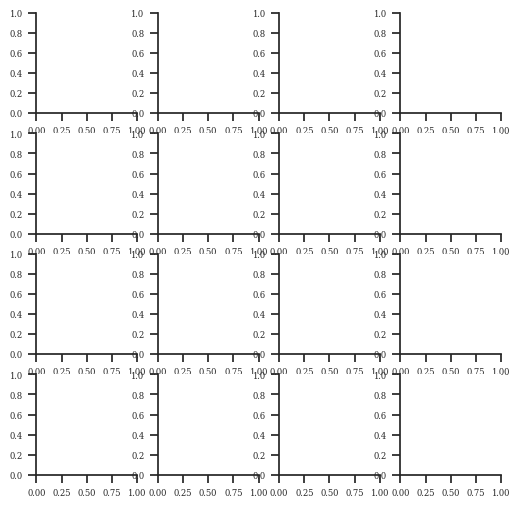

In [5]:
%matplotlib inline

model_types = ['wofs_psv2_no_torp', 'wofs_psv3_with_torp']
train_types = ['obs', 'obs']
hazards = ['tornado', 'wind', 'hail']
lengths = [60, 60]
radii = [39, 39]
leads = [0, 60, 120]

fig_save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/ALE_Comp_Plots'

for lead in leads:
    for hazard in hazards:
        #model comps
        fig_save_file = '%s_vs_%s_%s-%smin_%s_%skm_%s_trained_ale_comp.png'\
        %(model_types[0], model_types[1], lead, lead+60, hazard, radii[0], train_types[0])
        
        #lsrs vs warnings
        #fig_save_file = '%s_%s-%smin_%s_%skm_%s_trained_vs_%s_trained_ale_comp.png'\
        #%(model_types[0], lead, lead+60, hazard, radii[0], train_types[0], train_types[1])
        
        #1 vs 2 hours
        #fig_save_file = '%s_%s_vs_%smin_%s-%smin_%s_%skm_%s_trained_ale_comp.png'\
        #%(model_types[0], lengths[0], lengths[1], lead, lead+60, hazard, radii[0], train_types[0])
        
        fig, ax = plt.subplots(4,4,figsize = (6,6))
        truth_arr = np.zeros((4,4))
        fig = make_full_ale_subplot(fig, ax, model_types[0], train_types[0],\
                                        hazard, lengths[0], radii[0], [lead],\
                                        'PS2 no TORP', 0.4, truth_arr)
        fig = make_full_ale_subplot(fig, ax, model_types[1], train_types[1],\
                                        hazard, lengths[1], radii[1], [lead],\
                                        'PS3 with TORP', 0.6, truth_arr)
        #fig.suptitle("%s ALE (%s Minute Lead Time): " %(hazard.capitalize(), lead),\
        #             weight = 'bold', fontsize = 12, fontname = 'DejaVu Sans')
        #fig.suptitle("%s ALE (%s-%s Minutes): " %(hazard.capitalize(), lead, lead+lengths[0]),\
        #             weight = 'bold', fontsize = 12, fontname = 'DejaVu Sans')
        fig.tight_layout()

        fig.savefig('%s/%s' %(fig_save_dir, fig_save_file))

In [ ]:
#Defense Presentation ALE Figs

%matplotlib inline

model_types = ['wofs_psv3_with_torp', 'wofs_psv3_with_torp']
train_types = ['obs_and_warnings', 'obs_and_warnings']
hazards = ['tornado', 'wind', 'hail']
lengths = [60, 120]
radii = [39, 39]
leads = [0, 60]#, 120]

fig_save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/ALE_Reduced_Plots'

for hazard in hazards:
    gif_fig_list = []
    for lead in leads:
        #model comps
        #fig_save_file = '%s_vs_%s_%s-%smin_%s_%skm_%s_trained_ale_reduced.png'\
        #%(model_types[0], model_types[1], lead, lead+60, hazard, radii[0], train_types[0])
        
        #lsrs vs warnings
        #fig_save_file = '%s_%s-%smin_%s_%skm_%s_trained_vs_%s_trained_ale_comp.png'\
        #%(model_types[0], lead, lead+60, hazard, radii[0], train_types[0], train_types[1])
        
        #1 vs 2 hours
        fig_save_file = '%s_%s_vs_%smin_%s-%smin_%s_%skm_%s_trained_ale_comp.png'\
        %(model_types[0], lengths[0], lengths[1], lead, lead+60, hazard, radii[0], train_types[0])
        
        fig, ax = plt.subplots(3,2,figsize = (4,6))
        truth_arr = np.zeros((3,2))
        fig = make_reduced_ale_subplot(fig, ax, model_types[0], train_types[0],\
                                        hazard, lengths[0], radii[0], [lead],\
                                        '1-Hour', 0.35, truth_arr)
        fig = make_reduced_ale_subplot(fig, ax, model_types[1], train_types[1],\
                                        hazard, lengths[1], radii[1], [lead],\
                                        '2-Hours', 0.65, truth_arr)
        fig.suptitle("%s ALE (%s Minute Lead Time): " %(hazard.capitalize(), lead),\
                     weight = 'bold', fontsize = 12, fontname = 'DejaVu Sans')
        #fig.suptitle("%s ALE (%s-%s Minutes): " %(hazard.capitalize(), lead, lead+lengths[0]),\
        #             weight = 'bold', fontsize = 12, fontname = 'DejaVu Sans')
        fig.tight_layout()

        fig.savefig('%s/%s' %(fig_save_dir, fig_save_file))
        gif_fig_list.append('%s/%s' %(fig_save_dir, fig_save_file))
    
    images = []
    #model comps
    #gif_fname = '%s_vs_%s_%skm_%s_trained_ale_reduced.gif'\
    #%(model_types[0], model_types[1], hazard, radii[0], train_types[0])
    
    #lsrs vs warnings
    #gif_fname = '%s_%s_%skm_%s_trained_vs_%s_trained_ale_reduced.gif'\
    #%(model_types[0], hazard, radii[0], train_types[0], train_types[1])
    
    #1 vs 2 hours
    gif_fname = '%s_%s_vs_%smin_%s_%skm_%s_trained_ale_reduced.gif'\
    %(model_types[0], lengths[0], lengths[1], hazard, radii[0], train_types[0])
    for filename in gif_fig_list:
        images.append(iio.imread(filename))
    iio.imwrite('%s/%s' %(fig_save_dir, gif_fname), images, duration = 1500, loop = 0)

In [ ]:
model_ds_100 = get_ale_torp_only('wofs_psv3_with_torp', 'obs_and_warnings', 'wind', 30, 60, 39)
#ale, bins, vals = get_ale_data('wofs_psv0_with_torp', 'obs_and_warnings', 'tornado',\
#                               30, 60, 39, model_ds, 'TORP Probability')

ale, bins = get_ale_data('wofs_psv3_with_torp', 'obs_and_warnings', 'wind',\
                               30, 60, 39, model_ds_100, 'TORP Probability (30km)')

In [ ]:
torp_probs = model_ds_100['TORP Probability (30km)'].values
non_zero_indices = np.where(torp_probs > 0)[0]
zero_indices = np.where(torp_probs == 0)[0]

rand_inds = np.random.choice(np.arange(len(zero_indices)), size=int(0.1*len(zero_indices)), replace=False)
full_sample = np.append(non_zero_indices, rand_inds)

original_feature_values = torp_probs[full_sample]
n_bins = 30

bin_edges = np.unique(
                np.percentile(
                    original_feature_values,
                    np.linspace(0, 100, n_bins + 1),
                    interpolation="lower",
                )
            )

In [32]:
print(len(non_zero_indices))
print(len(rand_inds))
print(len(full_sample), len(non_zero_indices) + len(rand_inds))
bin_edges

512151
1856784
2368935 2368935


array([0.    , 0.0345, 0.147 , 0.194 , 0.235 , 0.281 , 0.344 , 0.443 ,
       0.946 ], dtype=float32)

In [13]:
ncdf.Dataset('/work/ryan.martz/wofs_phi_data/experiments/wofs_psv3_with_torp_trained/obs_and_warnings/length_60/ale_curves/hail/highest_skill_model_ale_curves_wofs_psv3_with_torp_hail_obs_and_warnings_trained_30-90min_r39km_torp_only_100_percent.nc')


OSError: [Errno -51] NetCDF: Unknown file format: b'/work/ryan.martz/wofs_phi_data/experiments/wofs_psv3_with_torp_trained/obs_and_warnings/length_60/ale_curves/hail/highest_skill_model_ale_curves_wofs_psv3_with_torp_hail_obs_and_warnings_trained_30-90min_r39km_torp_only_100_percent.nc'

In [ ]:
model_type = 'wofs_psv2_no_torp'
train_type = 'obs'
hazard = 'tornado'
length = 60
radius = 39
lead = 150
ds = get_ale(model_type, train_type, hazard, lead, length, radius)
ds

In [4]:
filename = '/work/ryan.martz/wofs_phi_data/experiments/wofs_psv3_no_torp_trained/obs/length_60/ale_curves/tornado/wofs_psv3_no_torp_obs_trained_wofsphi_tornado_60min_window30-90_r39km_fold0.pkl'
f = open(filename, 'rb')
model = pickle.load(f)
f.close()
ex = skexplain.ExplainToolkit(estimators = ('wofs_psv3_no_torp_tornado_obs_trained_30-90min_r39km', model))

In [5]:
ex

ExplainToolkit(estimator=OrderedDict([('wofs_psv3_no_torp_tornado_obs_trained_30-90min_r39km', RandomForestClassifier(criterion='entropy', max_depth=15, max_features='sqrt',
                       min_samples_leaf=20, n_estimators=200, n_jobs=36))]) 
                                  estimator_names=['wofs_psv3_no_torp_tornado_obs_trained_30-90min_r39km'] 
                                  X=<class 'pandas.core.frame.DataFrame'> length:0 
                                  y=<class 'numpy.ndarray'> length:0 
                                  estimator_output=probability 
                                  feature_names=<class 'list'> length 1)

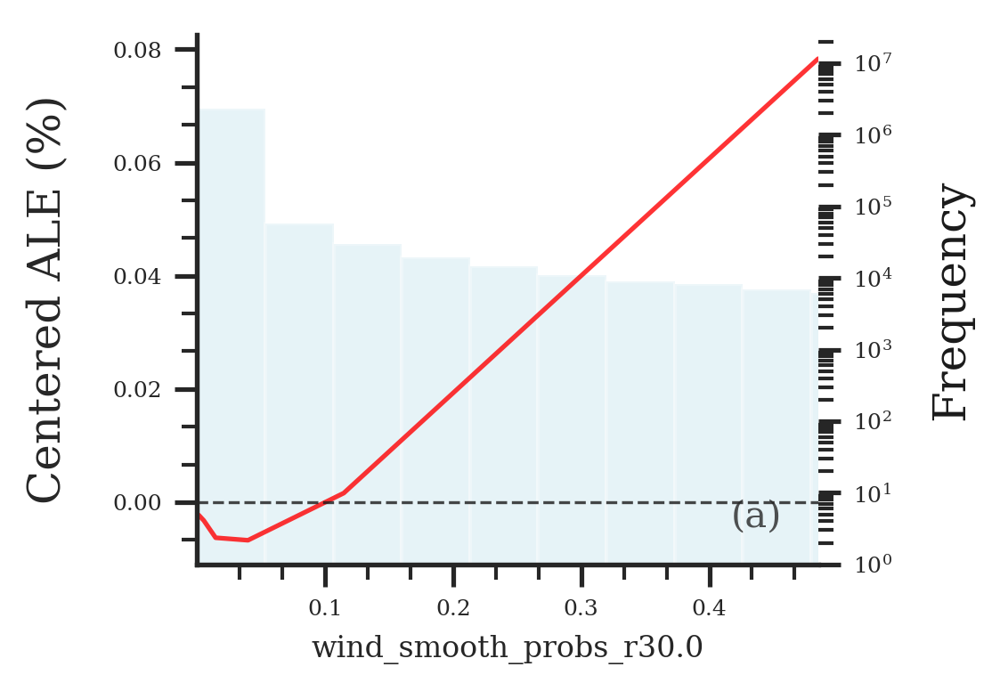

In [24]:
%matplotlib inline
fig, ax = ex.plot_ale(ale = a, features='wind_smooth_probs_r30.0')#,\
                             #display_units=plotting_config.display_units,\
                             #display_feature_names=plotting_config.display_feature_names,)

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


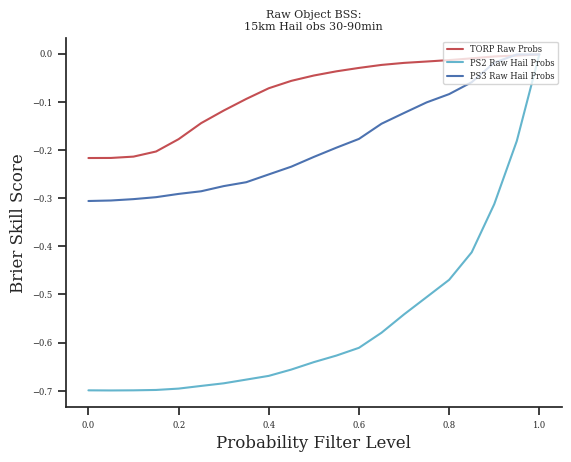

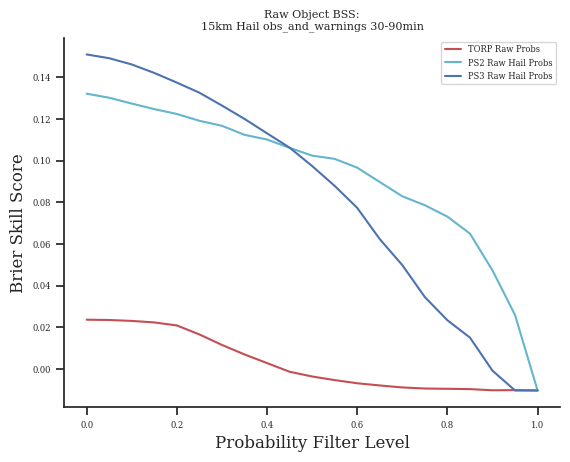

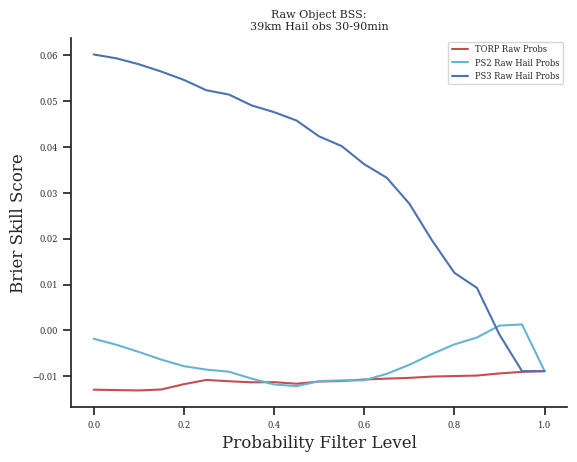

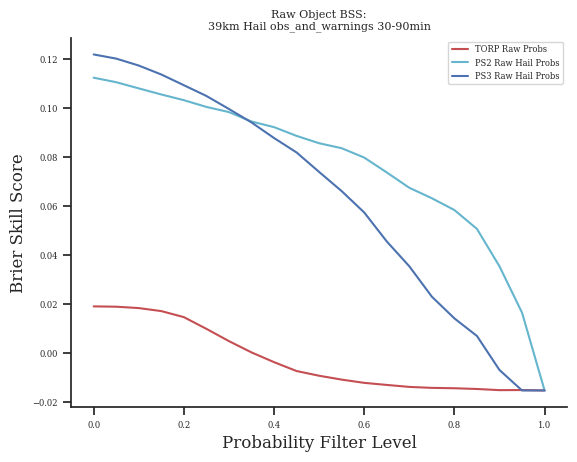

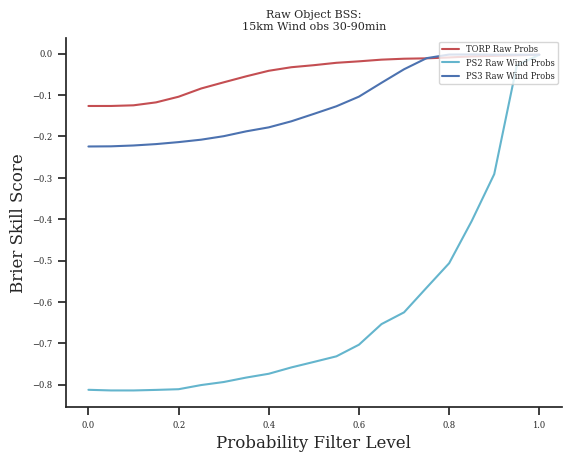

...

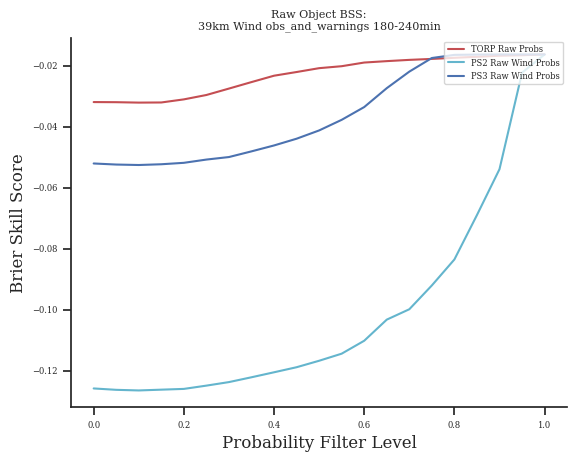

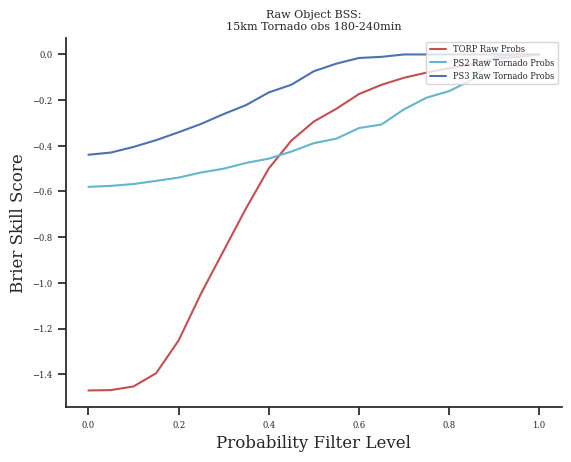

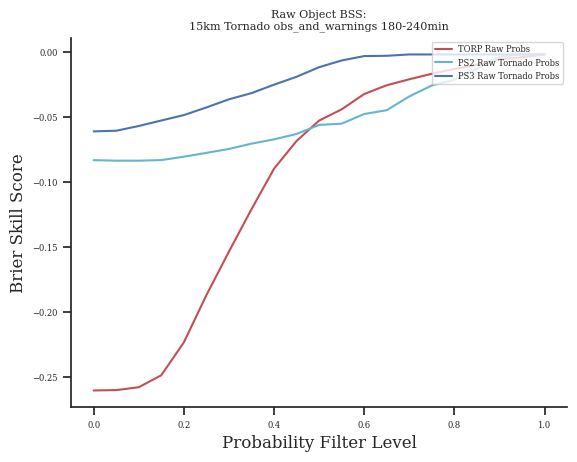

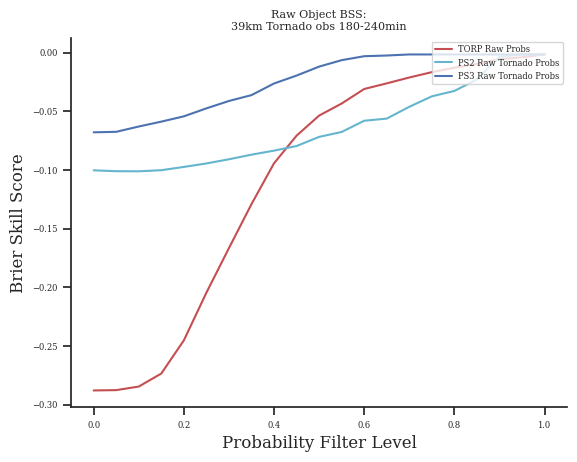

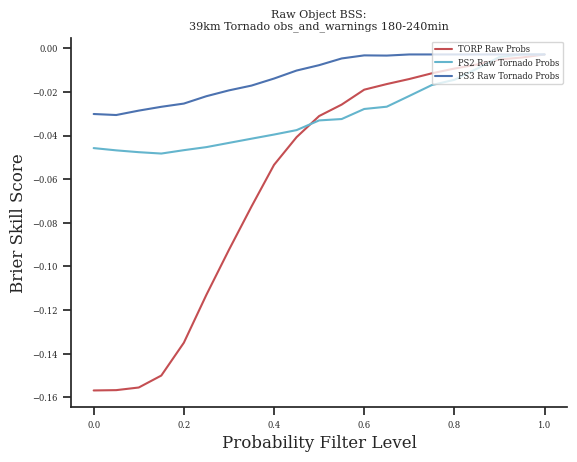

In [6]:
leads = [30, 60, 90, 120, 150, 180]
lengths = [60]#, 120]
hazards = ['hail', 'wind', 'tornado']
radii = [15, 39]
ver_types = ['obs', 'obs_and_warnings']

metrics_dir = '/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/metrics'
fig_dir = '/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/figures'

filter_levels = np.arange(0,1.01,0.05)

for lead in leads:
    for length in lengths:
        for hazard in hazards:
            for radius in radii:
                for ver_type in ver_types:
                    ps2_label = 'PS2 Raw %s Probs' %(hazard.capitalize())
                    ps3_label = 'PS3 Raw %s Probs' %(hazard.capitalize())
                    title = 'Raw Object BSS:\n%skm %s %s %s-%smin' %(radius, hazard.capitalize(), ver_type, lead, lead+length)
                    
                    torp_bss_file = 'torp_bss_%s_%s_r%skm_%s-%smin.npy' %(hazard, ver_type, radius, lead, lead+length)
                    ps2_bss_file = 'ps2_bss_%s_%s_r%skm_%s-%smin.npy' %(hazard, ver_type, radius, lead, lead+length)
                    ps3_bss_file = 'ps3_bss_%s_%s_r%skm_%s-%smin.npy' %(hazard, ver_type, radius, lead, lead+length)
                    
                    torp_bss_arr = np.load('%s/%s' %(metrics_dir, torp_bss_file))
                    ps2_bss_arr = np.load('%s/%s' %(metrics_dir, ps2_bss_file))
                    ps3_bss_arr = np.load('%s/%s' %(metrics_dir, ps3_bss_file))
                    
                    fig, ax = plt.subplots()
                    ax.plot(filter_levels, torp_bss_arr, 'r', label = 'TORP Raw Probs')
                    ax.plot(filter_levels, ps2_bss_arr, 'c', label = ps2_label)
                    ax.plot(filter_levels, ps3_bss_arr, 'b', label = ps3_label)
                    ax.set_xlabel('Probability Filter Level')
                    ax.set_ylabel('Brier Skill Score')
                    ax.set_title(title)
                    ax.legend(loc = 'upper right')
                    #ax.set_ylim([-0.13,0.13])
                    
                    fig_save_file = 'bss_plot_%skm_%s_%s_%s-%smin.png' %(radius, hazard, ver_type, lead, lead+length)
                    utilities.save_data(fig_dir, fig_save_file, fig, 'png')

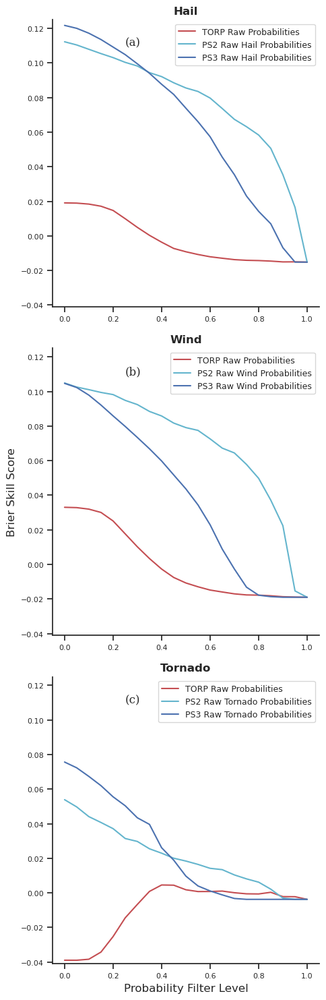

In [9]:
%matplotlib inline

hazards = ['hail', 'wind', 'tornado']
labels = ['(a)', '(b)', '(c)']
lead = 30
length = 60#, 120]
radius = 39
ver_type = 'obs_and_warnings'
fig, ax = plt.subplots(3,1)
fig.set_figheight(15)
fig.set_figwidth(5)
metrics_dir = '/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/metrics'
fig_dir = '/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/figures'

xticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=8, weight='normal', stretch='normal')
yticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=8, weight='normal', stretch='normal')
legend_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=9, weight='normal', stretch='normal')

filter_levels = np.arange(0,1.01,0.05)

for i in range(len(hazards)):
    #fig, ax = plt.subplots()
    hazard = hazards[i]
    ps2_label = 'PS2 Raw %s Probabilities' %(hazard.capitalize())
    ps3_label = 'PS3 Raw %s Probabilities' %(hazard.capitalize())
    title = 'Raw Object BSS:\n%skm %s %s %s-%smin' %(radius, hazard.capitalize(), ver_type, lead, lead+length)
    
    torp_bss_file = 'torp_bss_%s_%s_r%skm_%s-%smin.npy' %(hazard, ver_type, radius, lead, lead+length)
    ps2_bss_file = 'ps2_bss_%s_%s_r%skm_%s-%smin.npy' %(hazard, ver_type, radius, lead, lead+length)
    ps3_bss_file = 'ps3_bss_%s_%s_r%skm_%s-%smin.npy' %(hazard, ver_type, radius, lead, lead+length)
    
    torp_bss_arr = np.load('%s/%s' %(metrics_dir, torp_bss_file))
    ps2_bss_arr = np.load('%s/%s' %(metrics_dir, ps2_bss_file))
    ps3_bss_arr = np.load('%s/%s' %(metrics_dir, ps3_bss_file))
    
    ax[i].plot(filter_levels, torp_bss_arr, 'r', label = 'TORP Raw Probabilities')
    ax[i].plot(filter_levels, ps2_bss_arr, 'c', label = ps2_label)
    ax[i].plot(filter_levels, ps3_bss_arr, 'b', label = ps3_label)
    ax[2].set_xlabel('Probability Filter Level', fontname = 'DejaVu Sans')
    ax[1].set_ylabel('Brier Skill Score', fontname = 'DejaVu Sans')
    ax[i].set_ylim([-0.041,0.125])
    ax[i].set_title(title)
    ax[i].legend(loc = 'upper right', prop=legend_font)
    ax[i].tick_params(axis='both', which='major', labelsize=9)
    ax[i].text(0.25, 0.11, labels[i])
    #ax.set_ylim([-0.13,0.13])
    #ax.plot(filter_levels, torp_bss_arr, 'r', label = 'TORP Raw Probabilities')
    #ax.plot(filter_levels, ps2_bss_arr, 'c', label = ps2_label)
    #ax.plot(filter_levels, ps3_bss_arr, 'b', label = ps3_label)
    #ax.plot([0,1], [0,0], 'k', linewidth = 0.5)
    #ax.set_xlabel('Probability Filter Level', fontname = 'DejaVu Sans')
    #ax.set_ylabel('Brier Skill Score', fontname = 'DejaVu Sans')
    #ax.set_ylim([-0.041,0.125])
    #ax.set_xlim([0,1])
    #ax.set_title(title)
    #ax.legend(loc = 'upper right', prop=legend_font)
    #ax.tick_params(axis='both', which='major', labelsize=9)
    ax[i].set_title('%s' %(hazards[i].capitalize()), fontsize = 14, font = 'DejaVu Sans', weight = 'bold')
    
    fig_save_file = 'bss_plot_%skm_all_hazards_%s_%s-%smin.png' %(radius, ver_type, lead, lead+length)
    #fig_save_file = 'bss_plot_%skm_%s_%s_%s-%smin.png' %(radius, hazard, ver_type, lead, lead+length)
    #utilities.save_data(fig_dir, fig_save_file, fig, 'png')
    #for label in axs.get_xticklabels():
    for label in ax[i].get_xticklabels():
        label.set_fontproperties(xticks_font)
    #for label in axs.get_yticklabels():
    for label in ax[i].get_yticklabels():
        label.set_fontproperties(yticks_font)
fig.tight_layout()

In [3]:
torp_probs_30_90 = np.load('/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/object_probs/all_torp_raw_object_probs_30-90min.npy')
torp_reflectivity_30_90 = np.load('/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/object_probs/all_torp_raw_object_reflectivities_30-90min.npy')
ps2_tor_probs_30_90 = np.load('/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/object_probs/all_ps2_tornado_raw_object_probs_30-90min.npy')
ps3_tor_probs_30_90 = np.load('/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/object_probs/all_ps3_tornado_raw_object_probs_30-90min.npy')
ps2_hail_probs_30_90 = np.load('/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/object_probs/all_ps2_hail_raw_object_probs_30-90min.npy')
ps3_hail_probs_30_90 = np.load('/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/object_probs/all_ps3_hail_raw_object_probs_30-90min.npy')
ps2_wind_probs_30_90 = np.load('/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/object_probs/all_ps2_wind_raw_object_probs_30-90min.npy')
ps3_wind_probs_30_90 = np.load('/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/object_probs/all_ps3_wind_raw_object_probs_30-90min.npy')
ps3_wind_probs_30_90 = np.load('/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/object_probs/all_ps3_wind_raw_object_probs_30-90min.npy')

tor_39km_30_90_obsw = np.load('/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/obs/all_tornado_obs_and_warnings_r39km_30-90min.npy')
hail_39km_30_90_obsw = np.load('/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/obs/all_hail_obs_and_warnings_r39km_30-90min.npy')
wind_39km_30_90_obsw = np.load('/work/ryan.martz/wofs_phi_data/experiments/torp_ps_raw_evals/obs/all_wind_obs_and_warnings_r39km_30-90min.npy')

print('Num Forecasts: %s, %s%%' %(torp_probs_30_90.shape[0], (torp_probs_30_90.shape[0]/torp_probs_30_90.shape[0])*100))
print()
print('Num TORP Gridpoints: %s, %.2f%%' %(torp_probs_30_90[torp_probs_30_90 > 0].shape[0],\
      (torp_probs_30_90[torp_probs_30_90 > 0].shape[0]/torp_probs_30_90.shape[0])*100))
print('Num TORP Gridpoints at 50 dBZ: %s, %.2f%%' %(torp_reflectivity_30_90[torp_reflectivity_30_90 >= 50].shape[0],\
      (torp_reflectivity_30_90[torp_reflectivity_30_90 >= 50].shape[0]/torp_reflectivity_30_90.shape[0])*100))
print('Percent of TORP Gridpoints over 50 dBZ: %.2f%%'\
      %((torp_probs_30_90[torp_reflectivity_30_90 >= 50].shape[0]/torp_probs_30_90[torp_reflectivity_30_90 > 0].shape[0])*100))
print('Num TORP Gridpoints at least 30%%: %s, %.2f%%' %(torp_probs_30_90[torp_probs_30_90 >= 0.3].shape[0],\
      (torp_probs_30_90[torp_probs_30_90 >= 0.3].shape[0]/torp_probs_30_90.shape[0])*100))
print('Percent of TORP Gridpoints over 30%%: %.2f%%'\
      %((torp_probs_30_90[torp_probs_30_90 >= 0.3].shape[0]/torp_probs_30_90[torp_probs_30_90 > 0].shape[0])*100))
print('Num TORP Gridpoints at least 40%%: %s, %.2f%%' %(torp_probs_30_90[torp_probs_30_90 >= 0.4].shape[0],\
      (torp_probs_30_90[torp_probs_30_90 >= 0.4].shape[0]/torp_probs_30_90.shape[0])*100))
print('Percent of TORP Gridpoints over 40%%: %.2f%%'\
      %((torp_probs_30_90[torp_probs_30_90 >= 0.4].shape[0]/torp_probs_30_90[torp_probs_30_90 > 0].shape[0])*100))
print()
print('Num Tor PS2 Gridpoints: %s, %.2f%%' %(ps2_tor_probs_30_90[ps2_tor_probs_30_90 > 0].shape[0],\
                                    (ps2_tor_probs_30_90[ps2_tor_probs_30_90 > 0].shape[0]/ps2_tor_probs_30_90.shape[0])*100))
print('Num Tor PS3 Gridpoints: %s, %.2f%%' %(ps3_tor_probs_30_90[ps3_tor_probs_30_90 > 0].shape[0],\
                                    (ps3_tor_probs_30_90[ps3_tor_probs_30_90 > 0].shape[0]/ps3_tor_probs_30_90.shape[0])*100))
print()
print('Num Hail PS2 Gridpoints: %s, %.2f%%' %(ps2_hail_probs_30_90[ps2_hail_probs_30_90 > 0].shape[0],\
                                    (ps2_hail_probs_30_90[ps2_hail_probs_30_90 > 0].shape[0]/ps2_hail_probs_30_90.shape[0])*100))
print('Num Hail PS3 Gridpoints: %s, %.2f%%' %(ps3_tor_probs_30_90[ps3_tor_probs_30_90 > 0].shape[0],\
                                    (ps3_hail_probs_30_90[ps3_hail_probs_30_90 > 0].shape[0]/ps3_hail_probs_30_90.shape[0])*100))
print()
print('Num Wind PS2 Gridpoints: %s, %.2f%%' %(ps2_wind_probs_30_90[ps2_wind_probs_30_90 > 0].shape[0],\
                                    (ps2_wind_probs_30_90[ps2_wind_probs_30_90 > 0].shape[0]/ps2_wind_probs_30_90.shape[0])*100))
print('Num Wind PS3 Gridpoints: %s, %.2f%%' %(ps3_wind_probs_30_90[ps3_wind_probs_30_90 > 0].shape[0],\
                                    (ps3_wind_probs_30_90[ps3_wind_probs_30_90 > 0].shape[0]/ps3_wind_probs_30_90.shape[0])*100))

print()
print('Num Tornado 39km LSR/Warning Gridpoints: %s, %.2f%%' %(tor_39km_30_90_obsw[tor_39km_30_90_obsw == 1].shape[0],\
                                                              (tor_39km_30_90_obsw[tor_39km_30_90_obsw == 1].shape[0]/tor_39km_30_90_obsw.shape[0])*100))
print('Num Hail 39km LSR/Warning Gridpoints: %s, %.2f%%' %(hail_39km_30_90_obsw[hail_39km_30_90_obsw == 1].shape[0],\
                                                              (hail_39km_30_90_obsw[hail_39km_30_90_obsw == 1].shape[0]/hail_39km_30_90_obsw.shape[0])*100))
print('Num Wind 39km LSR/Warning Gridpoints: %s, %.2f%%' %(wind_39km_30_90_obsw[wind_39km_30_90_obsw == 1].shape[0],\
                                                              (wind_39km_30_90_obsw[wind_39km_30_90_obsw == 1].shape[0]/wind_39km_30_90_obsw.shape[0])*100))


Num Forecasts: 124740000, 100.0%

Num TORP Gridpoints: 1266860, 1.02%
Num TORP Gridpoints at 50 dBZ: 473366, 0.38%
Percent of TORP Gridpoints over 50 dBZ: 37.29%
Num TORP Gridpoints at least 30%: 252114, 0.20%
Percent of TORP Gridpoints over 30%: 19.90%
Num TORP Gridpoints at least 40%: 96755, 0.08%
Percent of TORP Gridpoints over 40%: 7.64%

Num Tor PS2 Gridpoints: 1244073, 1.00%
Num Tor PS3 Gridpoints: 1615617, 1.30%

Num Hail PS2 Gridpoints: 2011101, 1.61%
Num Hail PS3 Gridpoints: 1615617, 1.49%

Num Wind PS2 Gridpoints: 3577714, 2.87%
Num Wind PS3 Gridpoints: 2691093, 2.16%

Num Tornado 39km LSR/Warning Gridpoints: 465584, 0.37%
Num Hail 39km LSR/Warning Gridpoints: 1864014, 1.49%
Num Wind 39km LSR/Warning Gridpoints: 2326750, 1.87%


In [6]:
def get_plot_style(model_type, train_type, train_radius, length, prob_type):
    marker_size = 4
    
    if train_radius == 15:
        linewidth = 1
        marker_size = 3
    elif train_radius == 39:
        linewidth = 2
    
    if model_type == 'wofs_psv2_no_torp':
        color = 'r'
    elif model_type == 'wofs_psv2_with_torp':
        color = 'c'
    elif model_type == 'wofs_psv3_no_torp':
        color = 'springgreen'
    elif model_type == 'wofs_psv3_with_torp':
        color = 'm'
    elif model_type == 'wofs_psv0_with_torp':
        color = 'navy'
    elif model_type == 'wofs_psv3_with_torp_filtered':
        color = 'g'
    elif model_type == 'wofs_psv3_with_torp_p_only':
        color = 'orange'
    
    if length == 120:
        color = 'pink'
    
    if train_type == 'obs':
        linestyle = '--'
        fcst_freq_linestyle = ':'
    elif train_type == 'obs_and_warnings':
        linestyle = '-'
        fcst_freq_linestyle = '-.'
    
    if prob_type == 'avg_sr':
        color = 'orange'
    
    pod_marker = 's'
    
    
    
    return color, linewidth, linestyle, fcst_freq_linestyle, pod_marker, marker_size

In [57]:
def get_train_type_label(train_type):
    
    if train_type == 'obs':
        return 'LSRs-Only'
    elif train_type == 'obs_and_warnings':
        return 'LSRs+Warnings'

In [8]:
def get_model_label(model_type):
    
    arr = model_type.split('_')
    ps_version = arr[0][3]
    torp_flag = arr[1]
    
    model_label = 'PS%s %s TORP' %(ps_version, torp_flag.capitalize())
    
    if ps_version == '0':
        model_label = 'TORP Only'
    elif 'filtered' in model_type:
        model_label = 'PS3 With Filtered TORP'
    elif 'p_only' in model_type:
        model_label = 'PS3 With P-Only TORP'
    
    
    return model_label

In [9]:
def get_reliability_file(model_type, train_type, ver_type, hazard, forecast_length, train_radius, ver_radius, lead, use_avg_srs):
    directory = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/length_%s/%s' %(train_type, forecast_length, hazard)
    if train_type == 'warnings' and ver_type == 'warnings':
        if use_avg_srs:
            rel_fname = '%s_%s_trained_%s_verified_%s_%smin_reliability_data_avg_srs_%s-%s.npy' %(model_type, train_type, ver_type, hazard, forecast_length, lead, lead+forecast_length)
        else:
            rel_fname = '%s_%s_trained_%s_verified_%s_%smin_reliability_data_%s-%s.npy' %(model_type, train_type, ver_type, hazard, forecast_length, lead, lead+forecast_length)
    elif train_type == 'warnings':
        if use_avg_srs:
            rel_fname = '%s_%s_trained_%s_%skm_verified_%s_%smin_reliability_data_avg_srs_%s-%s.npy' %(model_type, train_type, ver_type, ver_radius, hazard, forecast_length, lead, lead+forecast_length)
        else:
            rel_fname = '%s_%s_trained_%s_%skm_verified_%s_%smin_reliability_data_%s-%s.npy' %(model_type, train_type, ver_type, ver_radius, hazard, forecast_length, lead, lead+forecast_length)
    elif ver_type == 'warnings':
        if use_avg_srs:
            rel_fname = '%s_%s_%skm_trained_%s_verified_%s_%smin_reliability_data_avg_srs_%s-%s.npy' %(model_type, train_type, train_radius, ver_type, hazard, forecast_length, lead, lead+forecast_length)
        else:
            rel_fname = '%s_%s_%skm_trained_%s_verified_%s_%smin_reliability_data_%s-%s.npy' %(model_type, train_type, train_radius, ver_type, hazard, forecast_length, lead, lead+forecast_length)
    else:
        if use_avg_srs:
            rel_fname = '%s_%s_%skm_trained_%s_%skm_verified_%s_%smin_reliability_data_avg_srs_%s-%s.npy' %(model_type, train_type, train_radius, ver_type, ver_radius, hazard, forecast_length, lead, lead+forecast_length)
        else:
            rel_fname = '%s_%s_%skm_trained_%s_%skm_verified_%s_%smin_reliability_data_%s-%s.npy' %(model_type, train_type, train_radius, ver_type, ver_radius, hazard, forecast_length, lead, lead+forecast_length)
    full_fname = '%s/%s' %(directory, rel_fname)
    return full_fname

In [10]:
def get_performance_diagram_file(model_type, train_type, ver_type, hazard, forecast_length, train_radius, ver_radius, lead, use_avg_srs):
    directory = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/length_%s/%s' %(train_type, forecast_length, hazard)
    if train_type == 'warnings' and ver_type == 'warnings':
        pd_fname = '%s_%s_trained_%s_verified_%s_%smin_performance_diagram_data_avg_srs_%s-%s.npy' %(model_type, train_type, ver_type, hazard, forecast_length, lead, lead+forecast_length)
    elif train_type == 'warnings':
        pd_fname = '%s_%s_trained_%s_%skm_verified_%s_%smin_performance_diagram_data_avg_srs_%s-%s.npy' %(model_type, train_type, ver_type, ver_radius, hazard, forecast_length, lead, lead+forecast_length)
    elif ver_type == 'warnings':
        pd_fname = '%s_%s_%skm_trained_%s_verified_%s_%smin_performance_diagram_data_avg_srs_%s-%s.npy' %(model_type, train_type, train_radius, ver_type, hazard, forecast_length, lead, lead+forecast_length)
    else:
        pd_fname = '%s_%s_%skm_trained_%s_%skm_verified_%s_%smin_performance_diagram_data_avg_srs_%s-%s.npy' %(model_type, train_type, train_radius, ver_type, ver_radius, hazard, forecast_length, lead, lead+forecast_length)
    full_fname = '%s/%s' %(directory, pd_fname)
    return full_fname

In [11]:
def get_overall_bss_file(model_type, train_type, ver_type, hazard, forecast_length, train_radius, ver_radius, use_avg_srs = False):
    directory = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/length_%s/%s' %(train_type, forecast_length, hazard)
    if train_type == 'warnings' and ver_type == 'warnings':
        prob_fname = '%s_%s_trained_%s_verified_%s_%smin_bss_from_raw_probs_by_lead_time.npy' %(model_type, train_type, ver_type, hazard, forecast_length)
        if use_avg_srs:
            sr_fname = '%s_%s_trained_%s_verified_%s_%smin_bss_from_avg_sr_map_by_lead_time.npy' %(model_type, train_type, ver_type, hazard, forecast_length)
        else:
            sr_fname = '%s_%s_trained_%s_verified_%s_%smin_bss_from_sr_map_by_lead_time.npy' %(model_type, train_type, ver_type, hazard, forecast_length)
    elif train_type == 'warnings':
        prob_fname = '%s_%s_trained_%s_%skm_verified_%s_%smin_bss_from_raw_probs_by_lead_time.npy' %(model_type, train_type, ver_type, ver_radius, hazard, forecast_length)
        if use_avg_srs:
            sr_fname = '%s_%s_trained_%s_%skm_verified_%s_%smin_bss_from_avg_sr_map_by_lead_time.npy' %(model_type, train_type, ver_type, ver_radius, hazard, forecast_length)
        else:
            sr_fname = '%s_%s_trained_%s_%skm_verified_%s_%smin_bss_from_sr_map_by_lead_time.npy' %(model_type, train_type, ver_type, ver_radius, hazard, forecast_length)
    elif ver_type == 'warnings':
        prob_fname = '%s_%s_%skm_trained_%s_verified_%s_%smin_bss_from_raw_probs_by_lead_time.npy' %(model_type, train_type, train_radius, ver_type, hazard, forecast_length)
        if use_avg_srs:
            sr_fname = '%s_%s_%skm_trained_%s_verified_%s_%smin_bss_from_avg_sr_map_by_lead_time.npy' %(model_type, train_type, train_radius, ver_type, hazard, forecast_length)
        else:
            sr_fname = '%s_%s_%skm_trained_%s_verified_%s_%smin_bss_from_sr_map_by_lead_time.npy' %(model_type, train_type, train_radius, ver_type, hazard, forecast_length)
    else:
        prob_fname = '%s_%s_%skm_trained_%s_%skm_verified_%s_%smin_bss_from_raw_probs_by_lead_time.npy' %(model_type, train_type, train_radius, ver_type, ver_radius, hazard, forecast_length)
        if use_avg_srs:
            sr_fname = '%s_%s_%skm_trained_%s_%skm_verified_%s_%smin_bss_from_avg_sr_map_by_lead_time.npy' %(model_type, train_type, train_radius, ver_type, ver_radius, hazard, forecast_length)
        else:
            sr_fname = '%s_%s_%skm_trained_%s_%skm_verified_%s_%smin_bss_from_sr_map_by_lead_time.npy' %(model_type, train_type, train_radius, ver_type, ver_radius, hazard, forecast_length)
    prob_full_fname = '%s/%s' %(directory, prob_fname)
    sr_full_fname = '%s/%s' %(directory, sr_fname)
    return prob_full_fname, sr_full_fname

In [12]:
def get_bootstrapped_bss_file(model_type, train_type, ver_type, hazard, forecast_length, train_radius, ver_radius):
    base_dir = '/work/ryan.martz/wofs_phi_data/experiments'
    full_dir = '%s/%s_trained/length_%s/%s' %(base_dir, train_type, forecast_length, hazard)
    
    prob_fname = '%s/%s_%s_%skm_trained_%s_%skm_verified_%s_%smin_bootstrapped_bss_from_raw_probs_by_lead_time.npy'\
    %(full_dir, model_type, train_type, train_radius, ver_type, ver_radius, hazard, forecast_length)
    sr_fname = '%s/%s_%s_%skm_trained_%s_%skm_verified_%s_%smin_bootstrapped_bss_from_avg_sr_map_by_lead_time.npy'\
    %(full_dir, model_type, train_type, train_radius, ver_type, ver_radius, hazard, forecast_length)
    
    return prob_fname, sr_fname

In [13]:
def get_haz_color(haz):
    if haz == 'hail':
        return 'b'
    elif haz == 'wind':
        return 'c'
    elif haz == 'tornado':
        return 'r'

In [14]:
def get_model_color(m):
    if m == 'wofs_psv2_no_torp':
        return 'r'
    elif m == 'wofs_psv2_with_torp':
        return 'y'
    elif m == 'wofs_psv3_no_torp':
        return 'c'
    elif m == 'wofs_psv3_with_torp':
        return 'b'

In [15]:
def get_reliability_fig_fname(model_type, train_type, ver_type, hazard, forecast_length, train_radius, ver_radius, lead, sr_or_probs):
    directory = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/length_%s/%s/plots' %(train_type, forecast_length, hazard)
    if train_type == 'warnings' and ver_type == 'warnings':
        rel_fname = '%s_%s_trained_%s_verified_%s_%smin_%s_reliability_data_subplot.png' %(model_type, train_type, ver_type, hazard, forecast_length, sr_or_probs)
    elif train_type == 'warnings':
        rel_fname = '%s_%s_trained_%s_%skm_verified_%s_%smin_%s_reliability_subplot.png' %(model_type, train_type, ver_type, ver_radius, hazard, forecast_length, sr_or_probs)
    elif ver_type == 'warnings':
        rel_fname = '%s_%s_%skm_trained_%s_verified_%s_%smin_%s_reliability_data_subplot.png' %(model_type, train_type, train_radius, ver_type, hazard, forecast_length, sr_or_probs)
    else:
        rel_fname = '%s_%s_%skm_trained_%s_%skm_verified_%s_%smin_%s_reliability_data_subplot.png' %(model_type, train_type, train_radius, ver_type, ver_radius, hazard, forecast_length, sr_or_probs)
    
    return directory, rel_fname
    

In [16]:
def get_reliability_fig_fname_haz_compare(model_type, train_type, ver_type, forecast_length, train_radius, ver_radius, lead, sr_or_probs):
    directory = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/length_%s/aggregate_plots' %(train_type, forecast_length)
    if train_type == 'warnings' and ver_type == 'warnings':
        rel_fname = '%s_%s_trained_%s_verified_all_hazards_%smin_%s_reliability_data_subplot.png' %(model_type, train_type, ver_type, forecast_length, sr_or_probs)
    elif train_type == 'warnings':
        rel_fname = '%s_%s_trained_%s_%skm_verified_all_hazards_%smin_%s_reliability_subplot.png' %(model_type, train_type, ver_type, ver_radius, forecast_length, sr_or_probs)
    elif ver_type == 'warnings':
        rel_fname = '%s_%s_%skm_trained_%s_verified_all_hazards_%smin_%s_reliability_data_subplot.png' %(model_type, train_type, train_radius, ver_type, forecast_length, sr_or_probs)
    else:
        rel_fname = '%s_%s_%skm_trained_%s_%skm_verified_all_hazards_%smin_%s_reliability_data_subplot.png' %(model_type, train_type, train_radius, ver_type, ver_radius, forecast_length, sr_or_probs)
    
    return directory, rel_fname
    

In [17]:
def get_reliability_fig_fname_model_compare(train_type, ver_type, hazard, forecast_length, train_radius, ver_radius, lead, sr_or_probs):
    directory = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/length_%s/aggregate_plots' %(train_type, forecast_length)
    if train_type == 'warnings' and ver_type == 'warnings':
        rel_fname = 'all_models_%s_trained_%s_verified_%s_%smin_%s_reliability_data_subplot.png' %(train_type, ver_type, hazard, forecast_length, sr_or_probs)
    elif train_type == 'warnings':
        rel_fname = 'all_models_%s_trained_%s_%skm_verified_%s_%smin_%s_reliability_subplot.png' %(train_type, ver_type, ver_radius, hazard, forecast_length, sr_or_probs)
    elif ver_type == 'warnings':
        rel_fname = 'all_models_%s_%skm_trained_%s_verified_%s_%smin_%s_reliability_data_subplot.png' %(train_type, train_radius, ver_type, hazard, forecast_length, sr_or_probs)
    else:
        rel_fname = 'all_models_%s_%skm_trained_%s_%skm_verified_%s_%smin_%s_reliability_data_subplot.png' %(train_type, train_radius, ver_type, ver_radius, hazard, forecast_length, sr_or_probs)
    
    return directory, rel_fname
    

In [18]:
def get_performance_diagram_fig_fname(model_type, train_type, ver_type, hazard, forecast_length, train_radius, ver_radius, lead, sr_or_probs):
    directory = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/length_%s/%s/plots' %(train_type, forecast_length, hazard)
    if train_type == 'warnings' and ver_type == 'warnings':
        pd_fname = '%s_%s_trained_%s_verified_%s_%smin_%s_performance_diagram_data_subplot.png' %(model_type, train_type, ver_type, hazard, forecast_length, sr_or_probs)
    elif train_type == 'warnings':
        pd_fname = '%s_%s_trained_%s_%skm_verified_%s_%smin_%s_performance_diagram_data_subplot.png' %(model_type, train_type, ver_type, ver_radius, hazard, forecast_length, sr_or_probs)
    elif ver_type == 'warnings':
        pd_fname = '%s_%s_%skm_trained_%s_verified_%s_%smin_%s_performance_diagram_data_subplot.png' %(model_type, train_type, train_radius, ver_type, hazard, forecast_length, sr_or_probs)
    else:
        pd_fname = '%s_%s_%skm_trained_%s_%skm_verified_%s_%smin_%s_performance_diagram_data_subplot.png' %(model_type, train_type, train_radius, ver_type, ver_radius, hazard, forecast_length, sr_or_probs)
    
    return directory, pd_fname
    

In [19]:
def get_performance_diagram_fig_fname_haz_compare(model_type, train_type, ver_type, forecast_length, train_radius, ver_radius, lead, sr_or_probs):
    directory = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/length_%s/aggregate_plots' %(train_type, forecast_length)
    if train_type == 'warnings' and ver_type == 'warnings':
        pd_fname = '%s_%s_trained_%s_verified_all_hazards_%smin_%s_performance_diagram_data_subplot.png' %(model_type, train_type, ver_type, forecast_length, sr_or_probs)
    elif train_type == 'warnings':
        pd_fname = '%s_%s_trained_%s_%skm_verified_all_hazards_%smin_%s_performance_diagram_data_subplot.png' %(model_type, train_type, ver_type, ver_radius, forecast_length, sr_or_probs)
    elif ver_type == 'warnings':
        pd_fname = '%s_%s_%skm_trained_%s_verified_all_hazards_%smin_%s_performance_diagram_data_subplot.png' %(model_type, train_type, train_radius, ver_type, forecast_length, sr_or_probs)
    else:
        pd_fname = '%s_%s_%skm_trained_%s_%skm_verified_all_hazards_%smin_%s_performance_diagram_data_subplot.png' %(model_type, train_type, train_radius, ver_type, ver_radius, forecast_length, sr_or_probs)
    
    return directory, pd_fname

In [20]:
def get_performance_diagram_fig_fname_model_compare(train_type, ver_type, hazard, forecast_length, train_radius, ver_radius, lead, sr_or_probs):
    directory = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/length_%s/aggregate_plots' %(train_type, forecast_length)
    if train_type == 'warnings' and ver_type == 'warnings':
        pd_fname = 'all_models_%s_trained_%s_verified_%s_%smin_%s_performance_diagram_data_subplot.png' %(train_type, ver_type, hazard, forecast_length, sr_or_probs)
    elif train_type == 'warnings':
        pd_fname = 'all_models_%s_trained_%s_%skm_verified_%s_%smin_%s_performance_diagram_data_subplot.png' %(train_type, ver_type, ver_radius, hazard, forecast_length, sr_or_probs)
    elif ver_type == 'warnings':
        pd_fname = 'all_models_%s_%skm_trained_%s_verified_%s_%smin_%s_performance_diagram_data_subplot.png' %(train_type, train_radius, ver_type, hazard, forecast_length, sr_or_probs)
    else:
        pd_fname = 'all_models_%s_%skm_trained_%s_%skm_verified_%s_%smin_%s_performance_diagram_data_subplot.png' %(train_type, train_radius, ver_type, ver_radius, hazard, forecast_length, sr_or_probs)
    
    return directory, pd_fname

In [21]:
def get_area_under_performance_diagram_fig_fname_haz_compare(model_type, train_type, ver_type, forecast_length, train_radius, ver_radius, sr_or_probs):
    directory = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/length_%s/aggregate_plots' %(train_type, forecast_length)
    if train_type == 'warnings' and ver_type == 'warnings':
        pd_fname = '%s_%s_trained_%s_verified_%smin_%s_area_under_performance_diagram_data_subplot.png' %(model_type, train_type, ver_type, forecast_length, sr_or_probs)
    elif train_type == 'warnings':
        pd_fname = '%s_%s_trained_%s_%skm_verified_%smin_%s_area_under_performance_diagram_data_subplot.png' %(model_type, train_type, ver_type, ver_radius, forecast_length, sr_or_probs)
    elif ver_type == 'warnings':
        pd_fname = '%s_%s_%skm_trained_%s_verified_%smin_%s_area_under_performance_diagram_data_subplot.png' %(model_type, train_type, train_radius, ver_type, forecast_length, sr_or_probs)
    else:
        pd_fname = '%s_%s_%skm_trained_%s_%skm_verified_%smin_%s_area_under_performance_diagram_data_subplot.png' %(model_type, train_type, train_radius, ver_type, ver_radius, forecast_length, sr_or_probs)
    
    return directory, pd_fname

In [22]:
def get_area_under_performance_diagram_fig_fname_model_compare(hazard, train_type, ver_type, forecast_length, train_radius, ver_radius, sr_or_probs):
    directory = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/length_%s/aggregate_plots' %(train_type, forecast_length)
    if train_type == 'warnings' and ver_type == 'warnings':
        pd_fname = '%s_%s_trained_%s_verified_%smin_%s_area_under_performance_diagram_data_subplot.png' %(hazard, train_type, ver_type, forecast_length, sr_or_probs)
    elif train_type == 'warnings':
        pd_fname = '%s_%s_trained_%s_%skm_verified_%smin_%s_area_under_performance_diagram_data_subplot.png' %(hazard, train_type, ver_type, ver_radius, forecast_length, sr_or_probs)
    elif ver_type == 'warnings':
        pd_fname = '%s_%s_%skm_trained_%s_verified_%smin_%s_area_under_performance_diagram_data_subplot.png' %(hazard, train_type, train_radius, ver_type, forecast_length, sr_or_probs)
    else:
        pd_fname = '%s_%s_%skm_trained_%s_%skm_verified_%smin_%s_area_under_performance_diagram_data_subplot.png' %(hazard, train_type, train_radius, ver_type, ver_radius, forecast_length, sr_or_probs)
    
    return directory, pd_fname

In [23]:
def get_bss_fig_fname(model_type, train_type, ver_type, forecast_length, train_radius, ver_radius, use_avg_srs):
    directory = '/work/ryan.martz/wofs_phi_data/experiments/%s_trained/length_%s/aggregate_plots' %(train_type, forecast_length)
    if train_type == 'warnings' and ver_type == 'warnings':
        if use_avg_srs:
            bss_fname = '%s_%s_trained_%s_verified_%smin_avg_sr_bss_plot.png' %(model_type, train_type, ver_type, forecast_length)
        else:
            bss_fname = '%s_%s_trained_%s_verified_%smin_bss_plot.png' %(model_type, train_type, ver_type, forecast_length)
    elif train_type == 'warnings':
        if use_avg_srs:
            bss_fname = '%s_%s_trained_%s_%skm_verified_%smin_avg_sr_bss_plot.png' %(model_type, train_type, ver_type, ver_radius, forecast_length)
        else:
            bss_fname = '%s_%s_trained_%s_%skm_verified_%smin_bss_plot.png' %(model_type, train_type, ver_type, ver_radius, forecast_length)
    elif ver_type == 'warnings':
        if use_avg_srs:
            bss_fname = '%s_%s_%skm_trained_%s_verified_%smin_avg_sr_bss_plot.png' %(model_type, train_type, train_radius, ver_type, forecast_length)
        else:
            bss_fname = '%s_%s_%skm_trained_%s_verified_%smin_bss_plot.png' %(model_type, train_type, train_radius, ver_type, forecast_length)
    else:
        if use_avg_srs:
            bss_fname = '%s_%s_%skm_trained_%s_%skm_verified_%smin_avg_sr_bss_plot.png' %(model_type, train_type, train_radius, ver_type, ver_radius, forecast_length)
        else:
            bss_fname = '%s_%s_%skm_trained_%s_%skm_verified_%smin_bss_plot.png' %(model_type, train_type, train_radius, ver_type, ver_radius, forecast_length)
    return directory, bss_fname

In [24]:
def calc_csi_bias_contours():
    srs = np.arange(0.01, 1, 0.01)
    pods = abs(np.arange(-0.99, 0, 0.01))
    mesh_sr, mesh_pod = np.meshgrid(srs, pods)
    csis = (1/mesh_sr) + (1/mesh_pod) - 1
    return mesh_sr, mesh_pod, 1/csis, mesh_pod/mesh_sr

In [25]:
def calc_pd_area(pod_file, use_avg_srs):
    pod_stats = np.load(pod_file)
    if use_avg_srs:
        y_points = pod_stats[1,:][np.where(pod_stats[1,:] > 0)] #pod from sr probs
        x_points = pod_stats[2,:][np.where(pod_stats[2,:] > 0)] #sr from sr probs
    else:
        y_points = pod_stats[4,:][np.where(pod_stats[4,:] > 0)] #pod from raw probs
        x_points = pod_stats[5,:][np.where(pod_stats[5,:] > 0)] #sr from raw probs
    pd_area = np.trapz(y_points, x = x_points)
    return pd_area, y_points, x_points

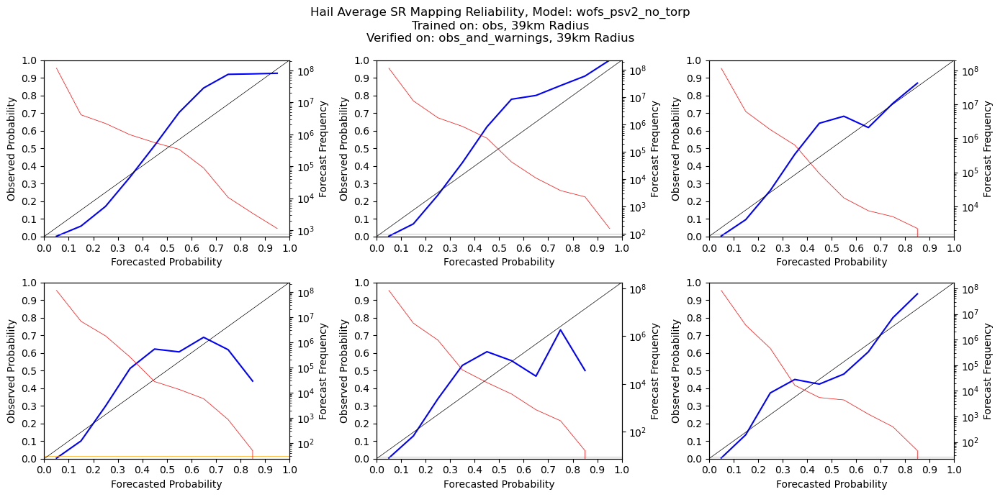

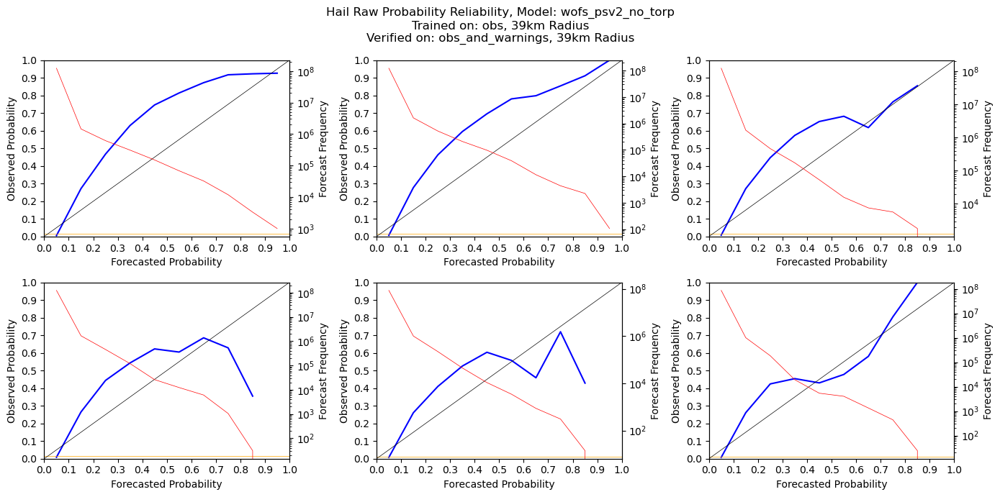

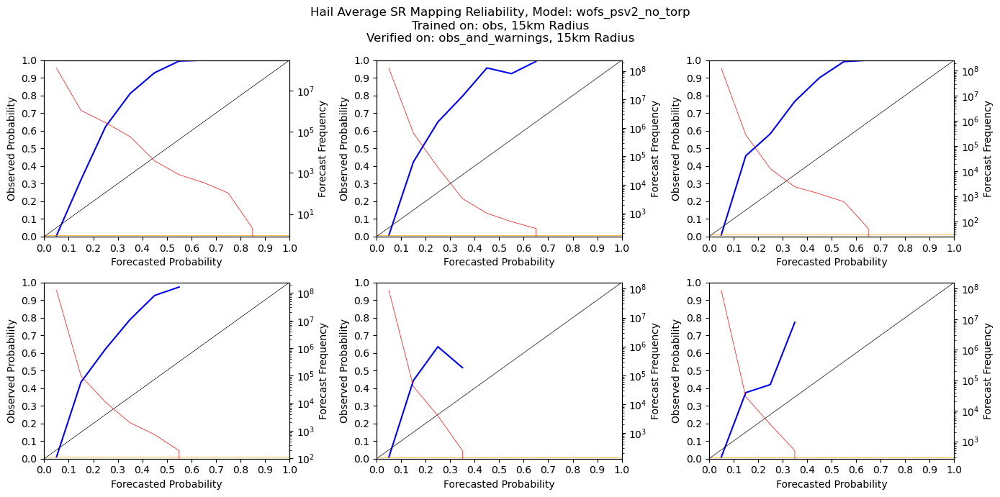

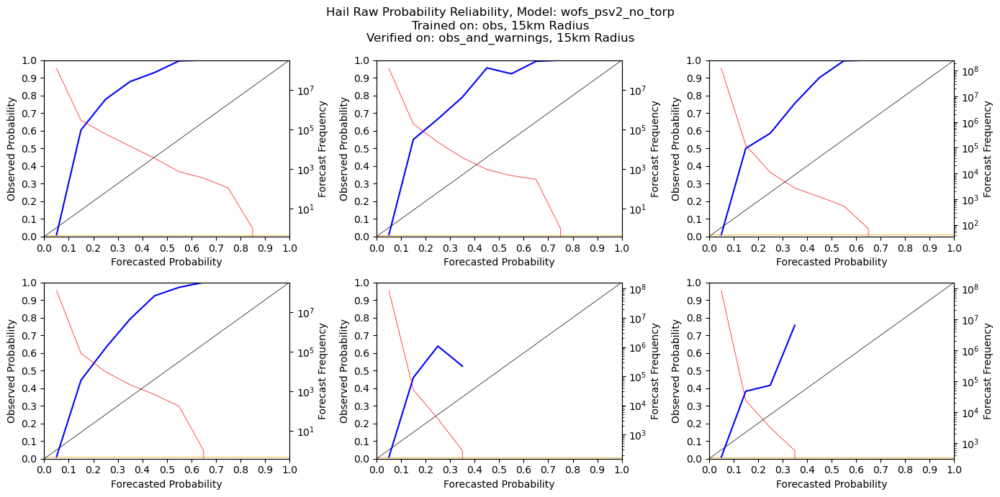

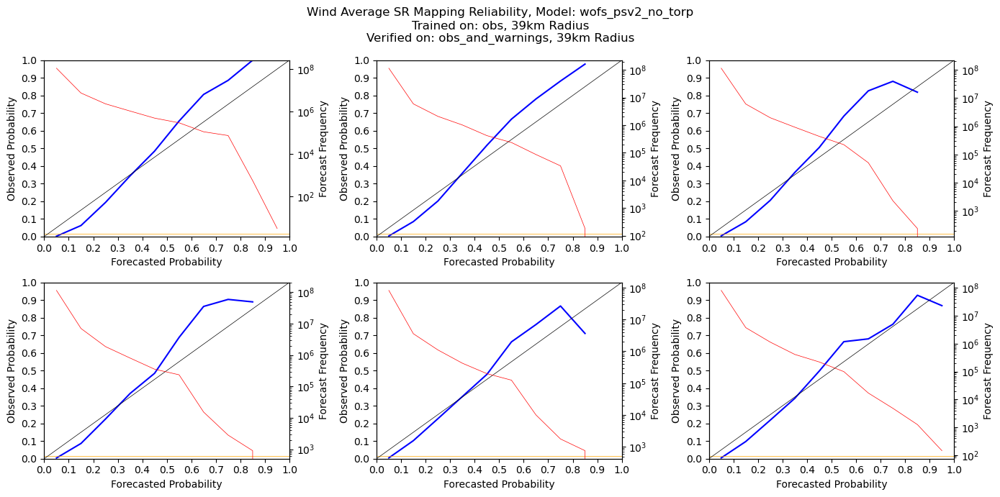

...

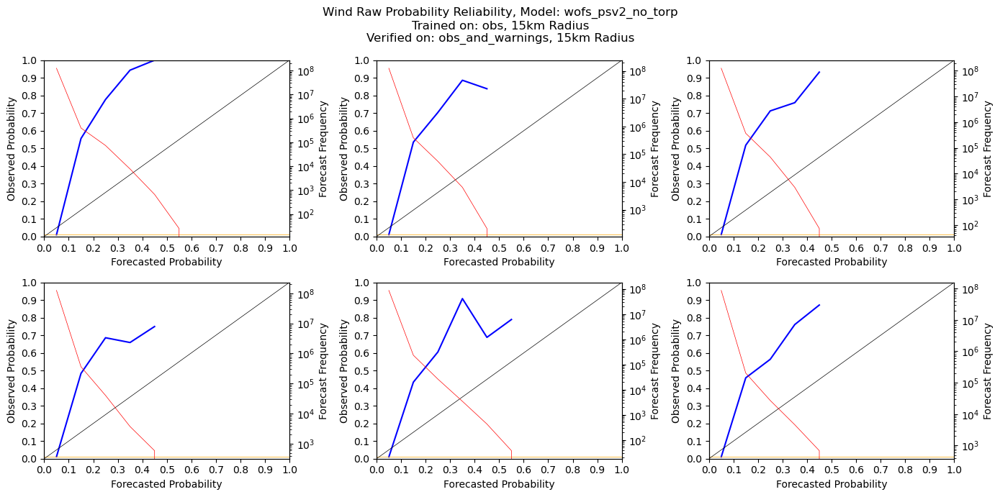

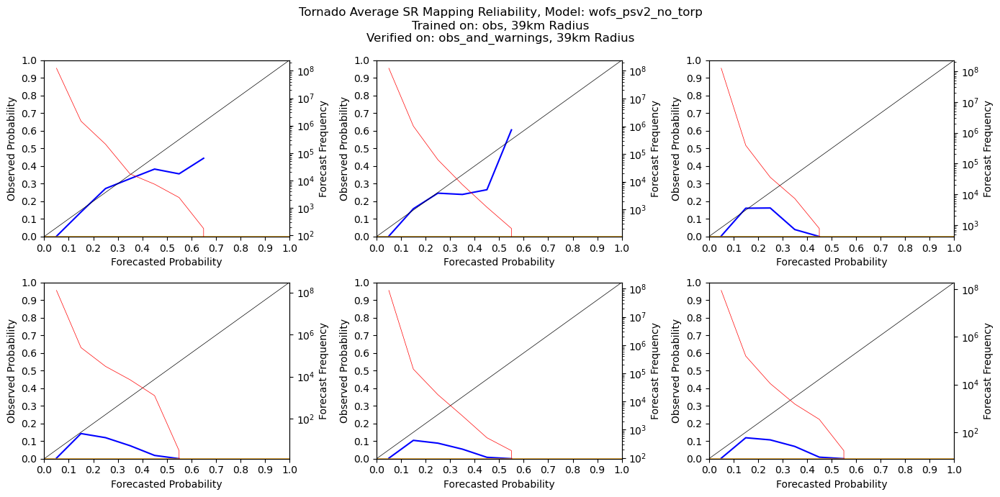

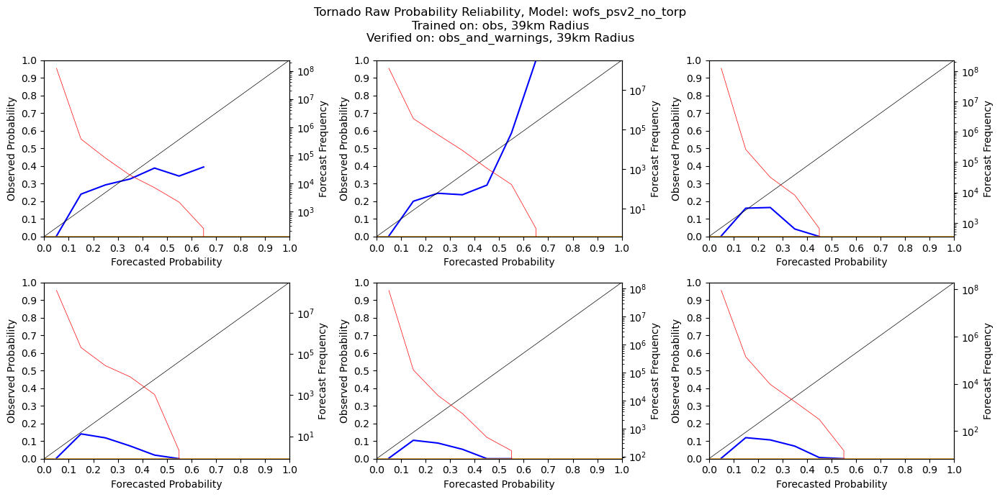

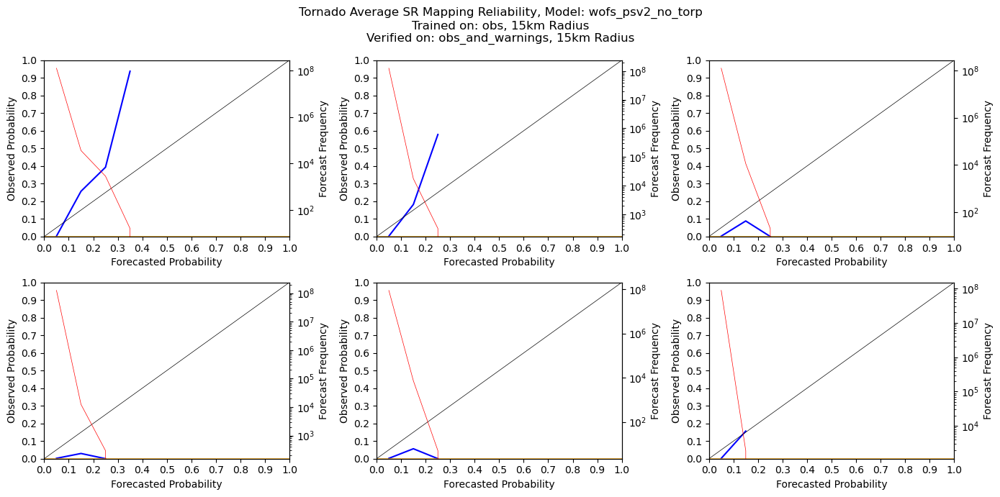

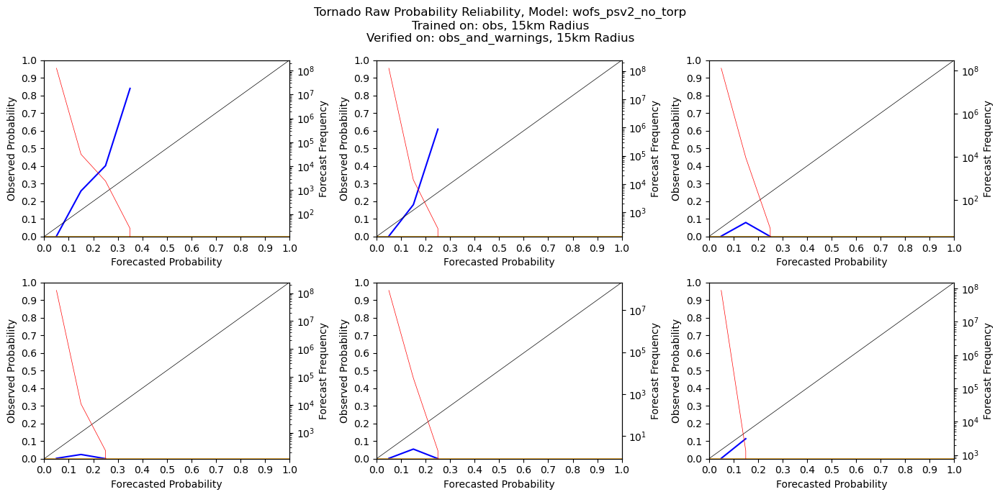

In [45]:
#################### Reliability Subplots ####################

hazards = ['hail', 'wind', 'tornado']
length = 60
train_types = ['obs']
ver_types = ['obs_and_warnings']
radii = [39, 15]
leads = [30, 60, 90, 120, 150, 180]

ps_version = 2
torp = False

use_avg_srs = True

if (ps_version == 2) and (not torp):
    model_type = 'wofs_psv2_no_torp'
elif (ps_version == 2) and (torp):
    model_type = 'wofs_psv2_with_torp'
elif (ps_version == 3) and (not torp):
    model_type = 'wofs_psv3_no_torp'
elif (ps_version == 3) and (torp):
    model_type = 'wofs_psv3_with_torp'

for haz in hazards:
    for train_type in train_types:
        for ver_type in ver_types:
            for train_radius in radii:
                ver_radius = train_radius
                sr_rel_scores = []
                prob_rel_scores = []
                climos = []
                if length == 60:
                    num_cols = 3
                    fig_width = 14
                elif length == 120:
                    num_cols = 2
                    fig_width = 14/1.5
                
                sr_fig, sr_axs = plt.subplots(2,num_cols, figsize = (fig_width, 7))
                if use_avg_srs:
                    sup_title = '%s Average SR Mapping Reliability, Model: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), model_type, train_type, train_radius, ver_type, ver_radius)
                else:
                    sup_title = '%s SR Mapping Reliability, Model: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), model_type, train_type, train_radius, ver_type, ver_radius)
                sr_fig.suptitle(sup_title)
                
                prob_fig, prob_axs = plt.subplots(2,num_cols, figsize = (fig_width,7))
                sup_title = '%s Raw Probability Reliability, Model: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), model_type, train_type, train_radius, ver_type, ver_radius)
                prob_fig.suptitle(sup_title)
                for i in range(len(leads)):
                    lead = leads[i]
                    rel_data_fname = get_reliability_file(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, use_avg_srs)
                    rel_data = np.load(rel_data_fname)
                    sr_rel_scores.append(rel_data[0,0])
                    prob_rel_scores.append(rel_data[0,1])
                    climos.append(rel_data[0,2])
                    fcsts = rel_data[1,:]
                    sr_fcst_freq = rel_data[2,:]
                    sr_obs_freq = rel_data[3,:]
                    prob_fcst_freq = rel_data[4,:]
                    prob_obs_freq = rel_data[5,:]
                    
                    sr_obs_freq = sr_obs_freq[np.where(sr_fcst_freq > 0)]
                    sr_fcsts = fcsts[np.where(sr_fcst_freq > 0)]
                    
                    prob_obs_freq = prob_obs_freq[np.where(prob_fcst_freq > 0)]
                    prob_fcsts = fcsts[np.where(prob_fcst_freq > 0)]
                    
                    index = int(lead/30)-1
                    row_index = math.floor(index/num_cols)
                    if index <= (num_cols-1):
                        col_index = index
                    else:
                        col_index = index-num_cols
                    
                    l1 = sr_axs[row_index, col_index].plot(sr_fcsts, sr_obs_freq, 'b', label = 'Reliability')
                    l2 = sr_axs[row_index, col_index].plot([0,1], [climos[i], climos[i]], 'orange', linewidth = 0.5, label = 'Climatology')
                    l3 = sr_axs[row_index, col_index].plot([0,1], [0,1], 'k', linewidth = 0.5, label = 'Perfect Reliability')
                    sr_axs[row_index, col_index].set_xlim([0,1])
                    sr_axs[row_index, col_index].set_ylim([0,1])
                    sr_axs[row_index, col_index].set_xlabel('Forecasted Probability')
                    sr_axs[row_index, col_index].set_xticks(np.arange(0,1.01,0.1))
                    sr_axs[row_index, col_index].set_yticks(np.arange(0,1.01,0.1))
                    sr_axs[row_index, col_index].set_ylabel('Observed Probability')
                    ax2 = sr_axs[row_index, col_index].twinx()
                    l4 = ax2.plot(fcsts, sr_fcst_freq, 'r', linewidth = 0.5, label = 'Forecast Frequency')
                    ax2.set_yscale('log')
                    ax2.set_ylabel('Forecast Frequency')
                    title = '%s - %s Minute Window, Error Score: %s' %(lead, lead+length, round(sr_rel_scores[i], 3))
                    #sr_axs[row_index, col_index].set_title(title)
                    lns = l1+l2+l3+l4
                    labs = [l.get_label() for l in lns]
                    #sr_axs[row_index, col_index].legend(lns, labs, loc=0)
                    
                    l1 = prob_axs[row_index, col_index].plot(prob_fcsts, prob_obs_freq, 'b', label = 'Reliability')
                    l2 = prob_axs[row_index, col_index].plot([0,1], [climos[i], climos[i]], 'orange', linewidth = 0.5, label = 'Climatology')
                    l3 = prob_axs[row_index, col_index].plot([0,1], [0,1], 'k', linewidth = 0.5, label = 'Perfect Reliability')
                    prob_axs[row_index, col_index].set_xlim([0,1])
                    prob_axs[row_index, col_index].set_ylim([0,1])
                    prob_axs[row_index, col_index].set_xlabel('Forecasted Probability')
                    prob_axs[row_index, col_index].set_xticks(np.arange(0,1.01,0.1))
                    prob_axs[row_index, col_index].set_yticks(np.arange(0,1.01,0.1))
                    prob_axs[row_index, col_index].set_ylabel('Observed Probability')
                    ax2 = prob_axs[row_index, col_index].twinx()
                    l4 = ax2.plot(fcsts, prob_fcst_freq, 'r', linewidth = 0.5, label = 'Forecast Frequency')
                    ax2.set_yscale('log')
                    ax2.set_ylabel('Forecast Frequency')
                    title = '%s - %s Minute Window, Error Score: %s' %(lead, lead+length, round(prob_rel_scores[i], 3))
                    #prob_axs[row_index, col_index].set_title(title)
                    lns = l1+l2+l3+l4
                    labs = [l.get_label() for l in lns]
                    #prob_axs[row_index, col_index].legend(lns, labs, loc=0)
                
                sr_fig.tight_layout()
                prob_fig.tight_layout()
                if use_avg_srs:
                    sr_fig_dir, sr_fig_fname = get_reliability_fig_fname(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, 'avg_sr_map')
                else:
                    sr_fig_dir, sr_fig_fname = get_reliability_fig_fname(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, 'sr_map')
                utilities.save_data(sr_fig_dir, sr_fig_fname, sr_fig, 'png')
                prob_fig_dir, prob_fig_fname = get_reliability_fig_fname(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, 'raw_probs')
                utilities.save_data(prob_fig_dir, prob_fig_fname, prob_fig, 'png')
                

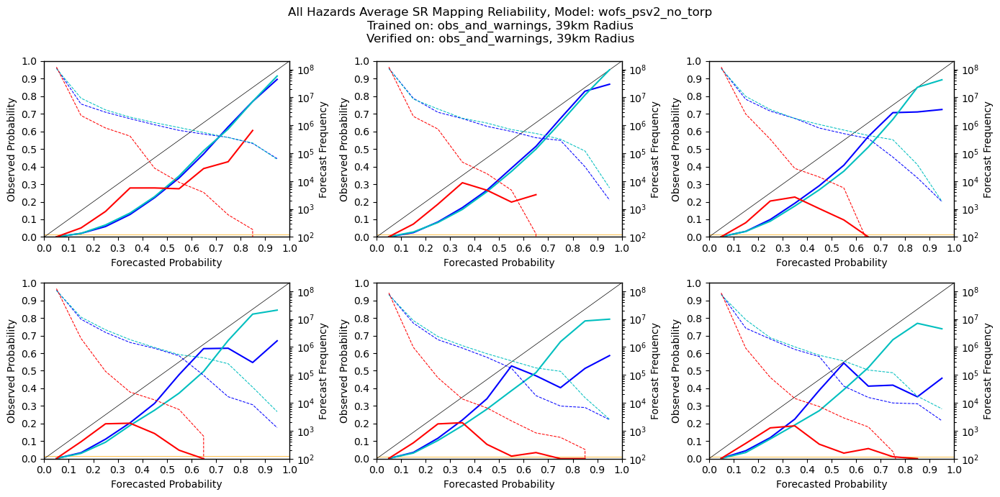

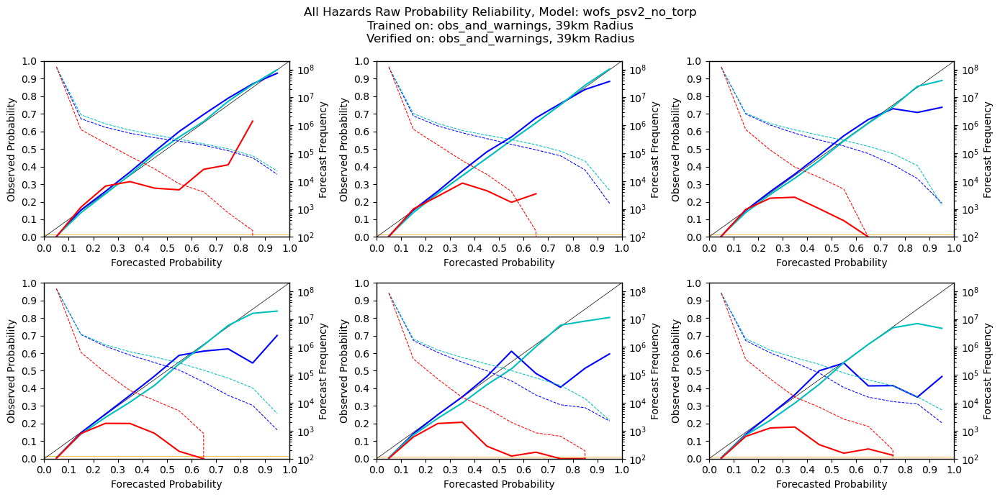

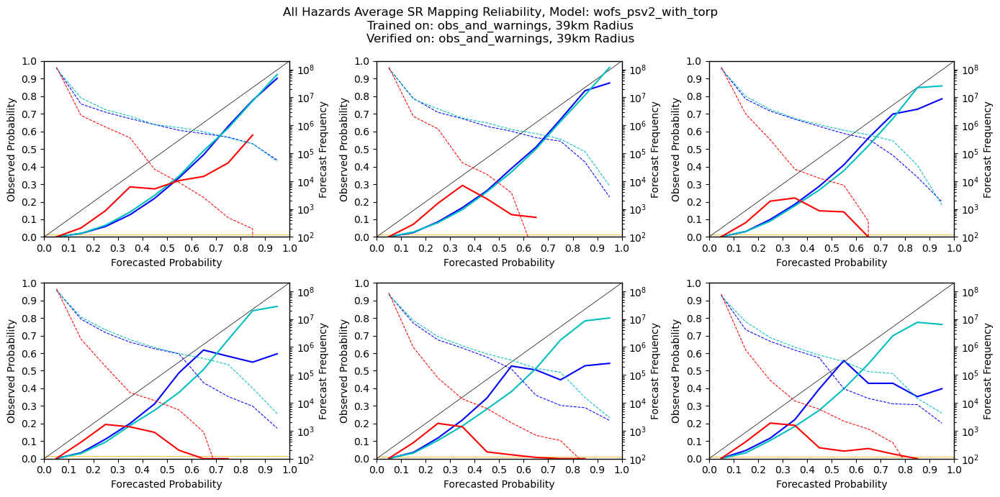

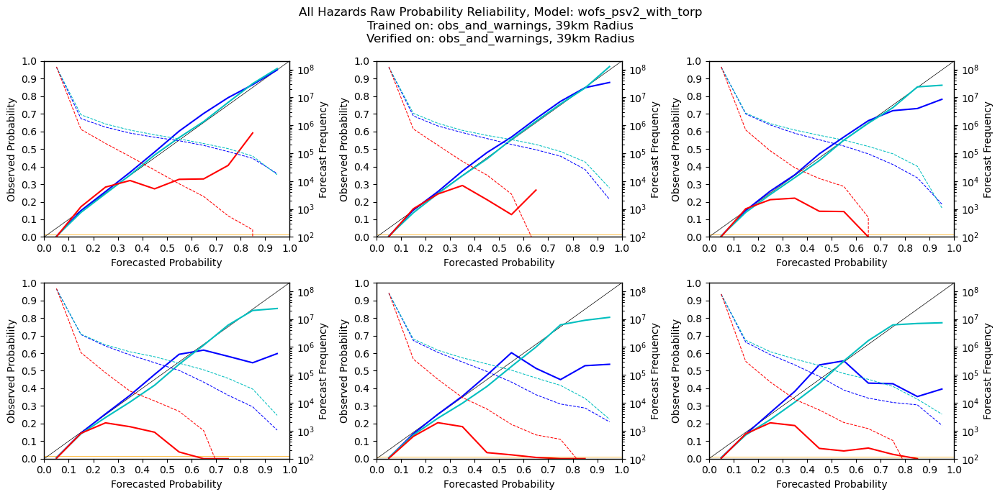

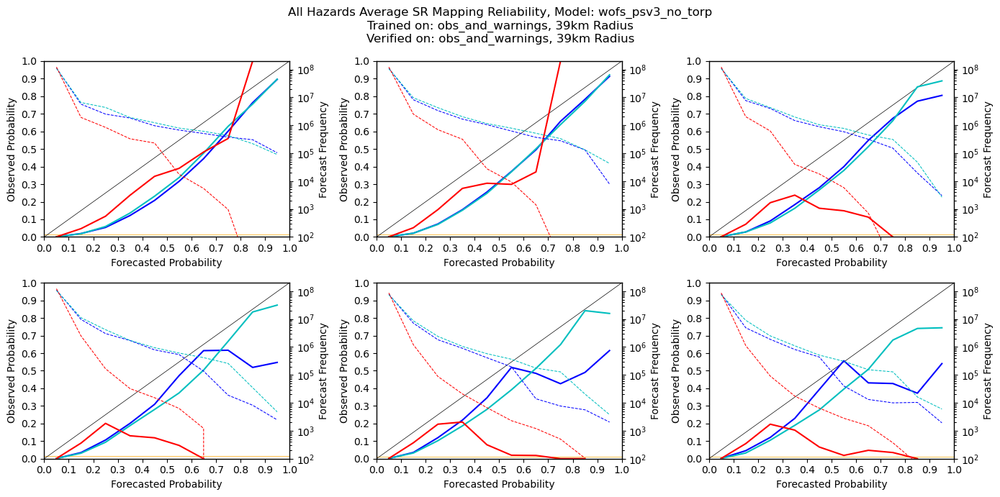

...

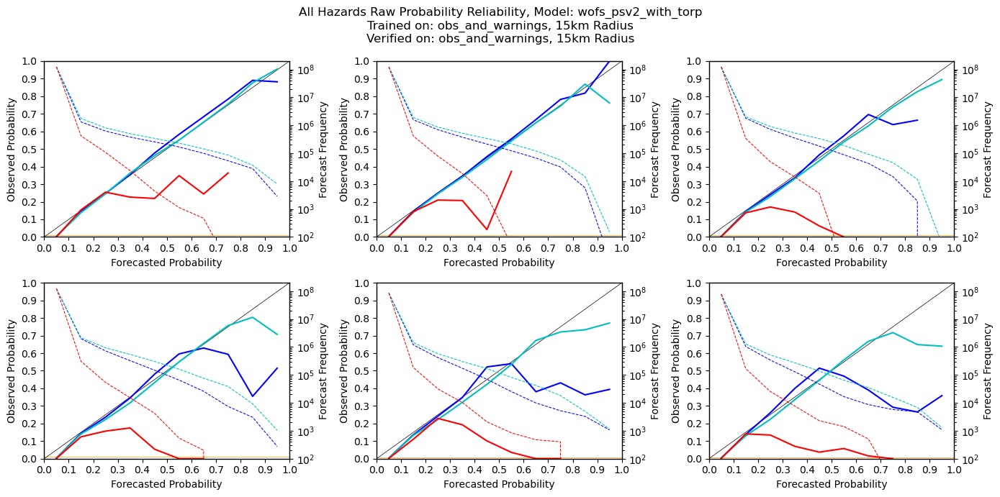

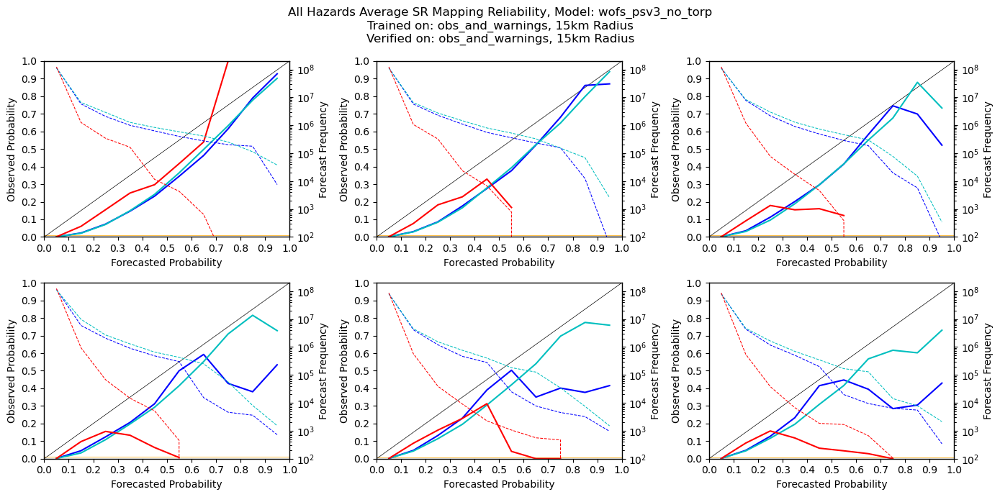

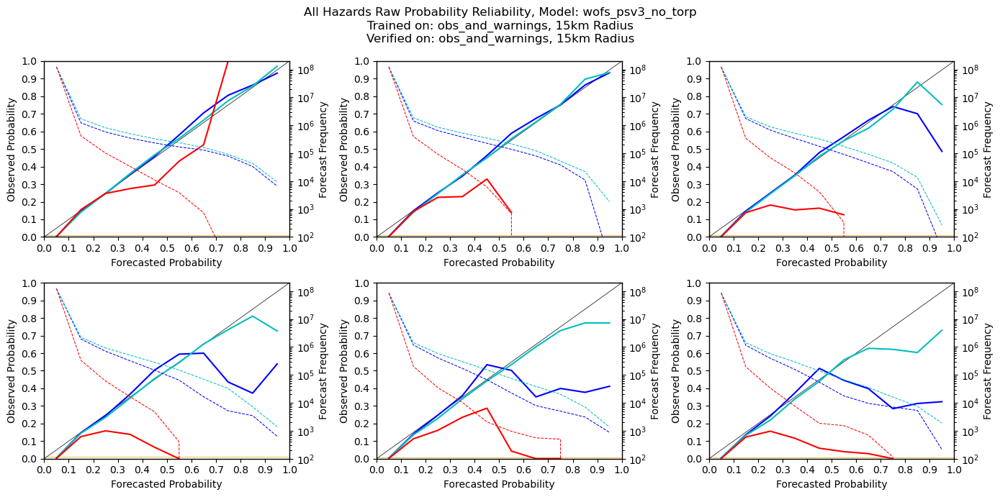

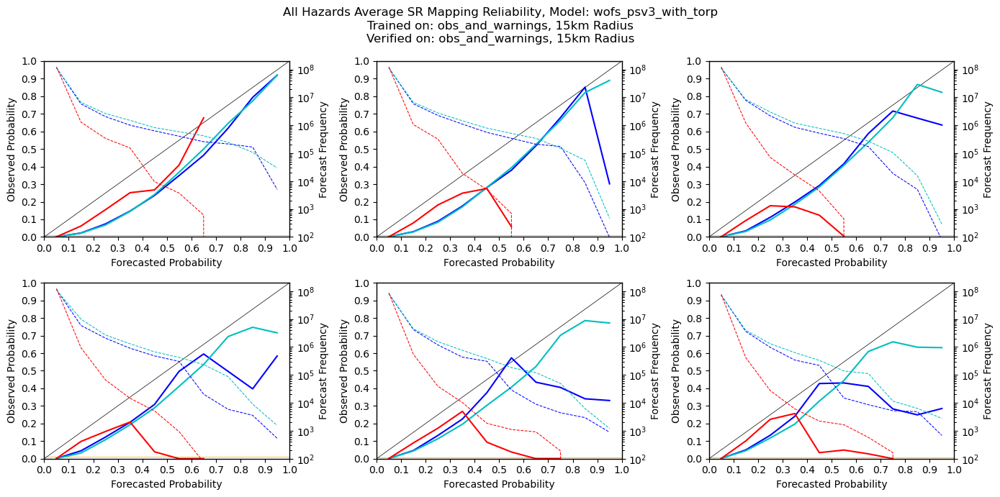

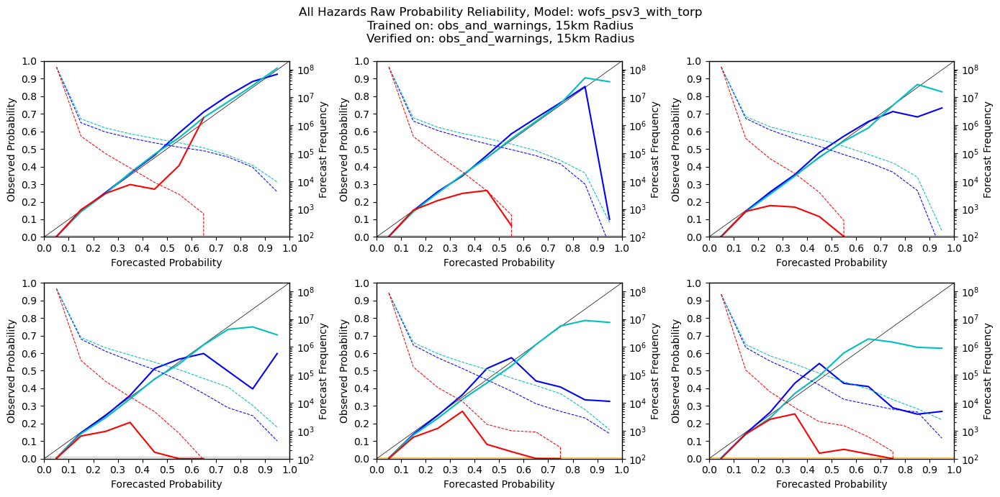

In [20]:
#################### Reliability Subplots Hazard Comparison ####################

hazards = ['hail', 'wind', 'tornado']
length = 60
train_types = ['obs_and_warnings']
ver_types = ['obs_and_warnings']
radii = [39, 15]
leads = [30, 60, 90, 120, 150, 180]

ps_version = 3
torp = False

use_avg_srs = True

if (ps_version == 2) and (not torp):
    model_type = 'wofs_psv2_no_torp'
elif (ps_version == 2) and (torp):
    model_type = 'wofs_psv2_with_torp'
elif (ps_version == 3) and (not torp):
    model_type = 'wofs_psv3_no_torp'
elif (ps_version == 3) and (torp):
    model_type = 'wofs_psv3_with_torp'

model_types = ['wofs_psv2_no_torp', 'wofs_psv2_with_torp', 'wofs_psv3_no_torp', 'wofs_psv3_with_torp']


for train_type in train_types:
    for ver_type in ver_types:
        for train_radius in radii:
            ver_radius = train_radius
            
            for model_type in model_types:
                
                if length == 60:
                    num_cols = 3
                    fig_width = 14
                elif length == 120:
                    num_cols = 2
                    fig_width = 14/1.5
                
                sr_fig, sr_axs = plt.subplots(2,num_cols, figsize = (fig_width, 7))
                if use_avg_srs:
                    sup_title = 'All Hazards Average SR Mapping Reliability, Model: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(model_type, train_type, train_radius, ver_type, ver_radius)
                else:
                    sup_title = 'All Hazards SR Mapping Reliability, Model: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(model_type, train_type, train_radius, ver_type, ver_radius)
                sr_fig.suptitle(sup_title)
                
                prob_fig, prob_axs = plt.subplots(2,num_cols, figsize = (fig_width,7))
                sup_title = 'All Hazards Raw Probability Reliability, Model: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(model_type, train_type, train_radius, ver_type, ver_radius)
                prob_fig.suptitle(sup_title)
                
                haz_count = 0
                for haz in hazards:
                
                    sr_rel_scores = []
                    prob_rel_scores = []
                    climos = []

                    for i in range(len(leads)):
                        lead = leads[i]
                        rel_data_fname = get_reliability_file(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, use_avg_srs)
                        rel_data = np.load(rel_data_fname)
                        sr_rel_scores.append(rel_data[0,0])
                        prob_rel_scores.append(rel_data[0,1])
                        climos.append(rel_data[0,2])
                        fcsts = rel_data[1,:]
                        sr_fcst_freq = rel_data[2,:]
                        sr_obs_freq = rel_data[3,:]
                        prob_fcst_freq = rel_data[4,:]
                        prob_obs_freq = rel_data[5,:]

                        sr_obs_freq = sr_obs_freq[np.where(sr_fcst_freq > 0)]
                        sr_fcsts = fcsts[np.where(sr_fcst_freq > 0)]

                        prob_obs_freq = prob_obs_freq[np.where(prob_fcst_freq > 0)]
                        prob_fcsts = fcsts[np.where(prob_fcst_freq > 0)]

                        index = int(lead/30)-1
                        row_index = math.floor(index/num_cols)
                        if index <= (num_cols-1):
                            col_index = index
                        else:
                            col_index = index-num_cols
                        
                        color = get_haz_color(haz)
                        dash_length = 5
                        dash_spacing = 5
                        
                        if haz_count == 0:
                            l2 = sr_axs[row_index, col_index].plot([0,1], [climos[i], climos[i]], 'orange', linewidth = 0.5, label = 'Climatology')
                            l3 = sr_axs[row_index, col_index].plot([0,1], [0,1], 'k', linewidth = 0.5, label = 'Perfect Reliability')
                        l1 = sr_axs[row_index, col_index].plot(sr_fcsts, sr_obs_freq, color, label = 'Reliability')
                        sr_axs[row_index, col_index].set_xlim([0,1])
                        sr_axs[row_index, col_index].set_ylim([0,1])
                        sr_axs[row_index, col_index].set_xlabel('Forecasted Probability')
                        sr_axs[row_index, col_index].set_xticks(np.arange(0,1.01,0.1))
                        sr_axs[row_index, col_index].set_yticks(np.arange(0,1.01,0.1))
                        sr_axs[row_index, col_index].set_ylabel('Observed Probability')
                        ax2 = sr_axs[row_index, col_index].twinx()
                        ax2.set_yscale('log')
                        ax2.set_ylim([10**2, 10**8.3])
                        if haz_count == 0:
                            ax2.set_ylabel('Forecast Frequency')
                        else:
                            ax2.yaxis.set_major_locator(ticker.NullLocator())
                        l4 = ax2.plot(fcsts, sr_fcst_freq, color + '--', linewidth = 0.75, label = 'Forecast Frequency')
                        title = '%s - %s Minute Window, Error Score: %s' %(lead, lead+length, round(sr_rel_scores[i], 3))
                        #sr_axs[row_index, col_index].set_title(title)
                        lns = l1+l2+l3+l4
                        labs = [l.get_label() for l in lns]
                        #sr_axs[row_index, col_index].legend(lns, labs, loc=0)
                        
                        if haz_count == 0:
                            l2 = prob_axs[row_index, col_index].plot([0,1], [climos[i], climos[i]], 'orange', linewidth = 0.5, label = 'Climatology')
                            l3 = prob_axs[row_index, col_index].plot([0,1], [0,1], 'k', linewidth = 0.5, label = 'Perfect Reliability')
                        l1 = prob_axs[row_index, col_index].plot(prob_fcsts, prob_obs_freq, color, label = 'Reliability')
                        prob_axs[row_index, col_index].set_xlim([0,1])
                        prob_axs[row_index, col_index].set_ylim([0,1])
                        prob_axs[row_index, col_index].set_xlabel('Forecasted Probability')
                        prob_axs[row_index, col_index].set_xticks(np.arange(0,1.01,0.1))
                        prob_axs[row_index, col_index].set_yticks(np.arange(0,1.01,0.1))
                        prob_axs[row_index, col_index].set_ylabel('Observed Probability')
                        ax2 = prob_axs[row_index, col_index].twinx()
                        ax2.set_yscale('log')
                        ax2.set_ylim([10**2, 10**8.3])
                        if haz_count == 0:
                            ax2.set_ylabel('Forecast Frequency')
                        else:
                            ax2.yaxis.set_major_locator(ticker.NullLocator())
                        l4 = ax2.plot(fcsts, prob_fcst_freq, color + '--', linewidth = 0.75, label = 'Forecast Frequency')
                        title = '%s - %s Minute Window, Error Score: %s' %(lead, lead+length, round(prob_rel_scores[i], 3))
                        #prob_axs[row_index, col_index].set_title(title)
                        lns = l1+l2+l3+l4
                        labs = [l.get_label() for l in lns]
                        #prob_axs[row_index, col_index].legend(lns, labs, loc=0)
                        if i == len(leads) - 1:
                            haz_count += 1

                    sr_fig.tight_layout()
                    prob_fig.tight_layout()
                    if use_avg_srs:
                        sr_fig_dir, sr_fig_fname = get_reliability_fig_fname_haz_compare(model_type, train_type, ver_type, length, train_radius, ver_radius, lead, 'avg_sr_map')
                    else:
                        sr_fig_dir, sr_fig_fname = get_reliability_fig_fname_haz_compare(model_type, train_type, ver_type, length, train_radius, ver_radius, lead, 'sr_map')
                    utilities.save_data(sr_fig_dir, sr_fig_fname, sr_fig, 'png')
                    prob_fig_dir, prob_fig_fname = get_reliability_fig_fname_haz_compare(model_type, train_type, ver_type, length, train_radius, ver_radius, lead, 'raw_probs')
                    utilities.save_data(prob_fig_dir, prob_fig_fname, prob_fig, 'png')


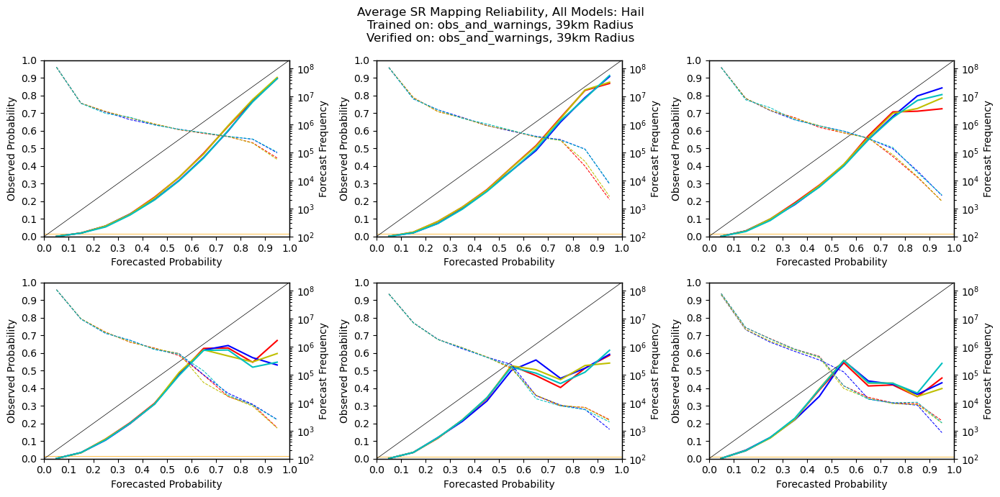

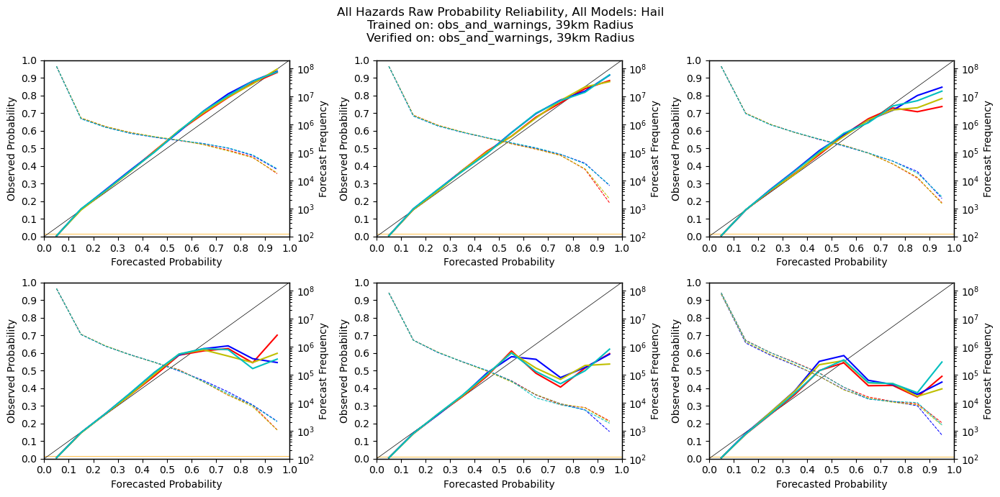

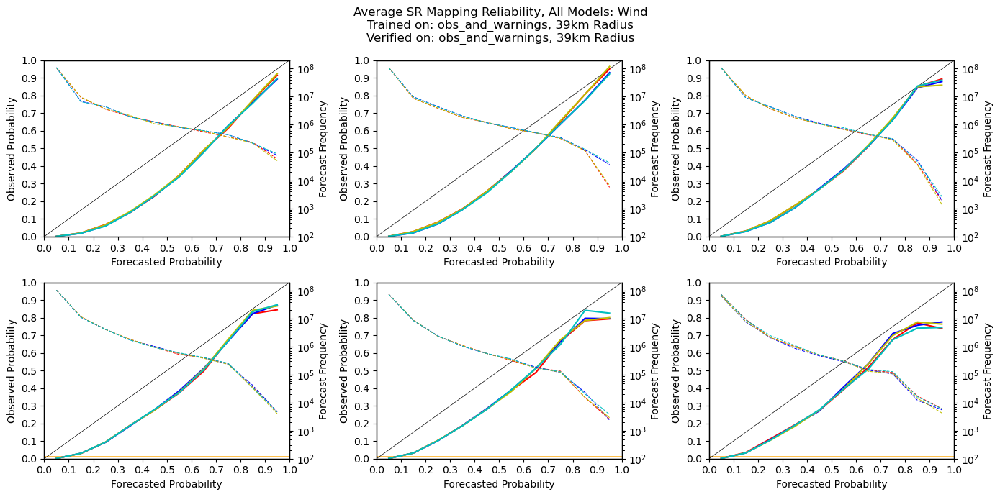

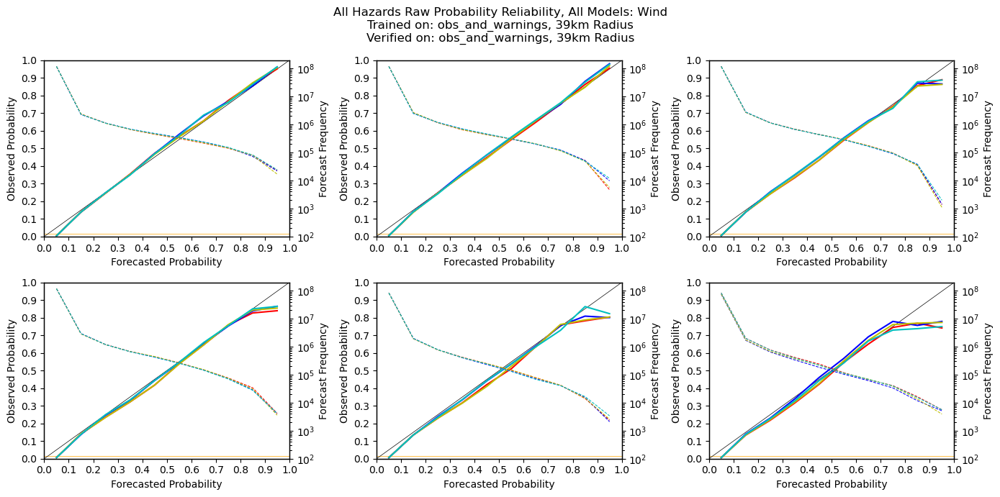

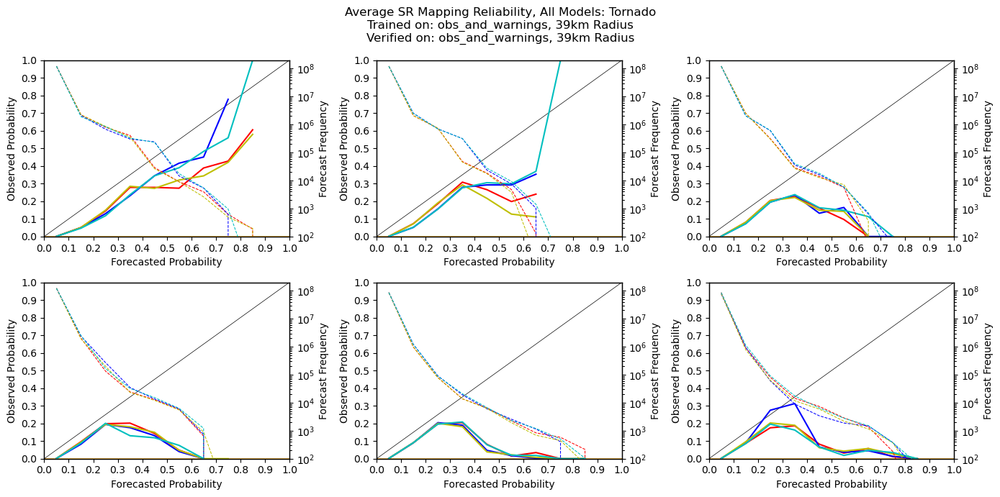

...

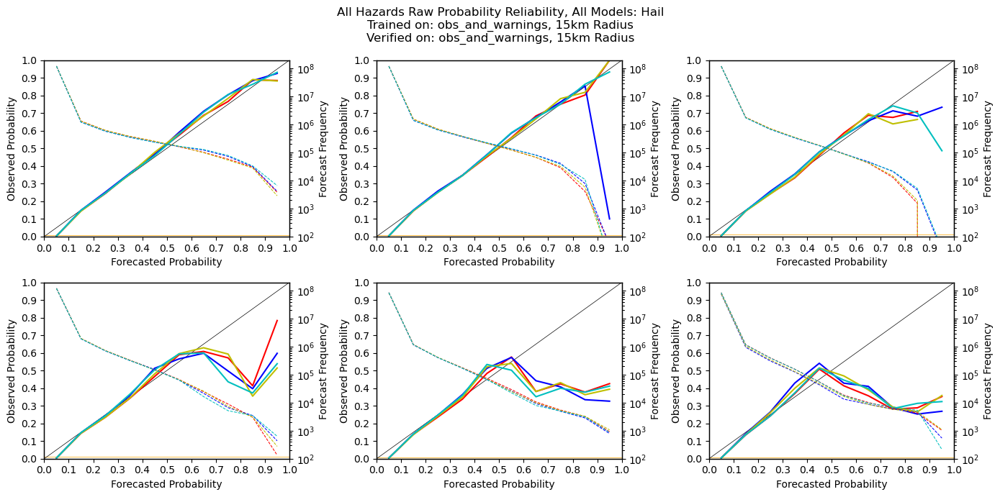

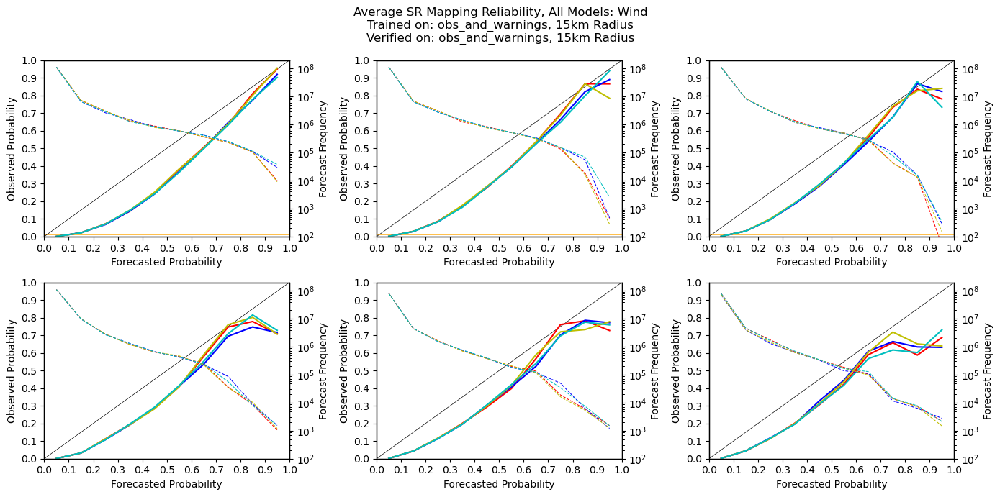

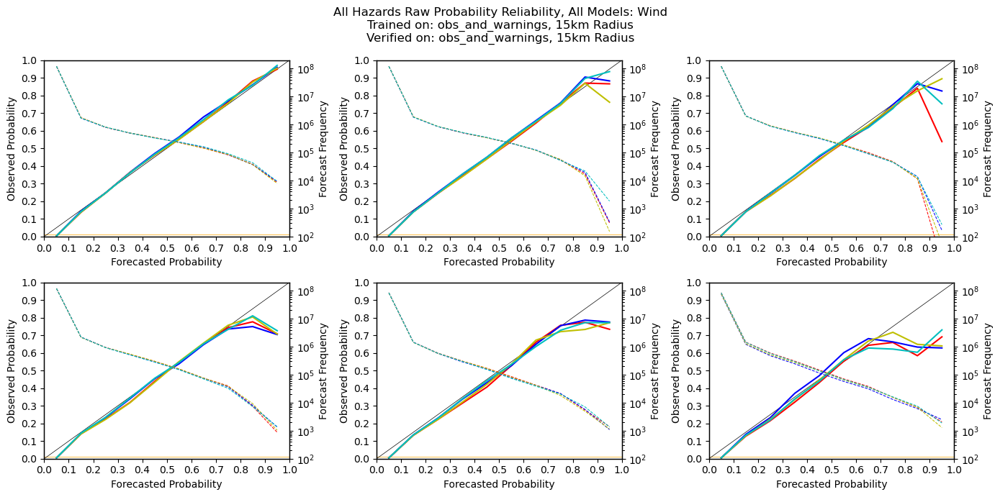

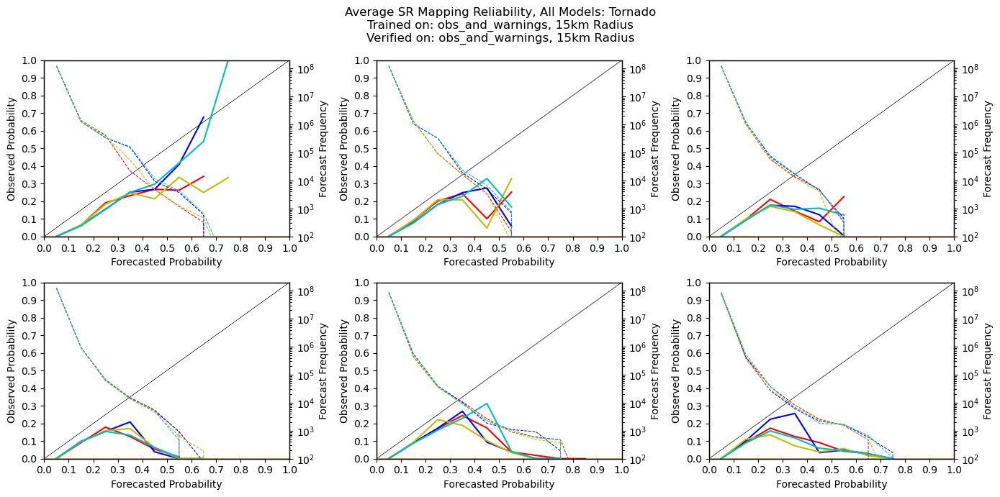

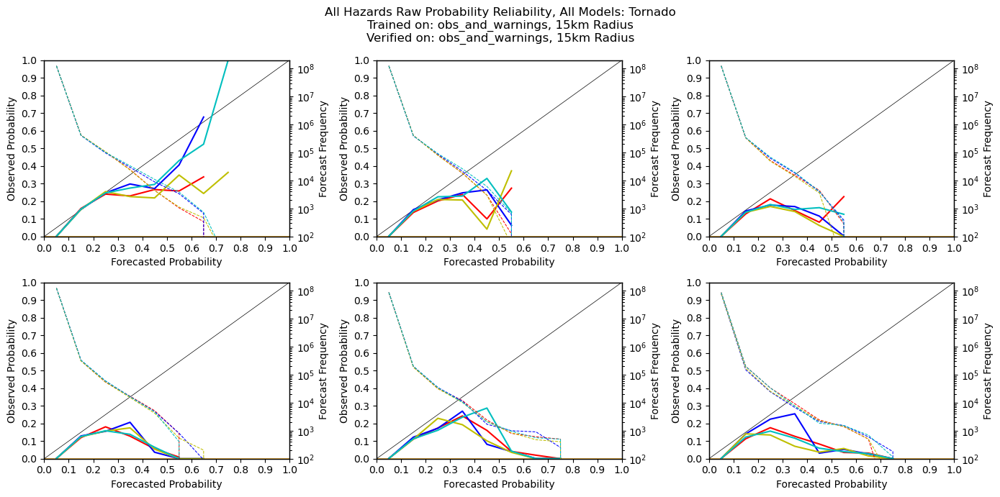

In [21]:
#################### Reliability Subplots Model Comparison ####################

hazards = ['hail', 'wind', 'tornado']
length = 60
train_types = ['obs_and_warnings']
ver_types = ['obs_and_warnings']
radii = [39, 15]
leads = [30, 60, 90, 120, 150, 180]

ps_version = 3
torp = False

use_avg_srs = True

if (ps_version == 2) and (not torp):
    model_type = 'wofs_psv2_no_torp'
elif (ps_version == 2) and (torp):
    model_type = 'wofs_psv2_with_torp'
elif (ps_version == 3) and (not torp):
    model_type = 'wofs_psv3_no_torp'
elif (ps_version == 3) and (torp):
    model_type = 'wofs_psv3_with_torp'

model_types = ['wofs_psv2_no_torp', 'wofs_psv3_with_torp', 'wofs_psv2_with_torp', 'wofs_psv3_no_torp',\
               'wofs_psv3_with_torp_filtered', 'wofs_psv3_with_torp_filtered_p_only']


for train_type in train_types:
    for ver_type in ver_types:
        for train_radius in radii:
            ver_radius = train_radius
            
            for haz in hazards:
                
                if length == 60:
                    num_cols = 3
                    fig_width = 14
                elif length == 120:
                    num_cols = 2
                    fig_width = 14/1.5
                
                sr_fig, sr_axs = plt.subplots(2,num_cols, figsize = (fig_width, 7))
                if use_avg_srs:
                    sup_title = 'Average SR Mapping Reliability, All Models: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), train_type, train_radius, ver_type, ver_radius)
                else:
                    sup_title = 'SR Mapping Reliability, All Models: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), train_type, train_radius, ver_type, ver_radius)
                sr_fig.suptitle(sup_title)
                
                prob_fig, prob_axs = plt.subplots(2,num_cols, figsize = (fig_width,7))
                sup_title = 'All Hazards Raw Probability Reliability, All Models: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), train_type, train_radius, ver_type, ver_radius)
                prob_fig.suptitle(sup_title)
                
                model_count = 0
                for model_type in model_types:
                
                    sr_rel_scores = []
                    prob_rel_scores = []
                    climos = []

                    for i in range(len(leads)):
                        lead = leads[i]
                        rel_data_fname = get_reliability_file(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, use_avg_srs)
                        rel_data = np.load(rel_data_fname)
                        sr_rel_scores.append(rel_data[0,0])
                        prob_rel_scores.append(rel_data[0,1])
                        climos.append(rel_data[0,2])
                        fcsts = rel_data[1,:]
                        sr_fcst_freq = rel_data[2,:]
                        sr_obs_freq = rel_data[3,:]
                        prob_fcst_freq = rel_data[4,:]
                        prob_obs_freq = rel_data[5,:]

                        sr_obs_freq = sr_obs_freq[np.where(sr_fcst_freq > 0)]
                        sr_fcsts = fcsts[np.where(sr_fcst_freq > 0)]

                        prob_obs_freq = prob_obs_freq[np.where(prob_fcst_freq > 0)]
                        prob_fcsts = fcsts[np.where(prob_fcst_freq > 0)]

                        index = int(lead/30)-1
                        row_index = math.floor(index/num_cols)
                        if index <= (num_cols-1):
                            col_index = index
                        else:
                            col_index = index-num_cols
                        
                        color = get_model_color(model_type)
                        dash_length = 5
                        dash_spacing = 5
                        
                        if model_count == 0:
                            l2 = sr_axs[row_index, col_index].plot([0,1], [climos[i], climos[i]], 'orange', linewidth = 0.5, label = 'Climatology')
                            l3 = sr_axs[row_index, col_index].plot([0,1], [0,1], 'k', linewidth = 0.5, label = 'Perfect Reliability')
                        l1 = sr_axs[row_index, col_index].plot(sr_fcsts, sr_obs_freq, color, label = 'Reliability')
                        sr_axs[row_index, col_index].set_xlim([0,1])
                        sr_axs[row_index, col_index].set_ylim([0,1])
                        sr_axs[row_index, col_index].set_xlabel('Forecasted Probability')
                        sr_axs[row_index, col_index].set_xticks(np.arange(0,1.01,0.1))
                        sr_axs[row_index, col_index].set_yticks(np.arange(0,1.01,0.1))
                        sr_axs[row_index, col_index].set_ylabel('Observed Probability')
                        ax2 = sr_axs[row_index, col_index].twinx()
                        ax2.set_yscale('log')
                        ax2.set_ylim([10**2, 10**8.3])
                        if model_count == 0:
                            ax2.set_ylabel('Forecast Frequency')
                        else:
                            ax2.yaxis.set_major_locator(ticker.NullLocator())
                        l4 = ax2.plot(fcsts, sr_fcst_freq, color + '--', linewidth = 0.75, label = 'Forecast Frequency')
                        title = '%s - %s Minute Window, Error Score: %s' %(lead, lead+length, round(sr_rel_scores[i], 3))
                        #sr_axs[row_index, col_index].set_title(title)
                        lns = l1+l2+l3+l4
                        labs = [l.get_label() for l in lns]
                        #sr_axs[row_index, col_index].legend(lns, labs, loc=0)
                        
                        if model_count == 0:
                            l2 = prob_axs[row_index, col_index].plot([0,1], [climos[i], climos[i]], 'orange', linewidth = 0.5, label = 'Climatology')
                            l3 = prob_axs[row_index, col_index].plot([0,1], [0,1], 'k', linewidth = 0.5, label = 'Perfect Reliability')
                        l1 = prob_axs[row_index, col_index].plot(prob_fcsts, prob_obs_freq, color, label = 'Reliability')
                        prob_axs[row_index, col_index].set_xlim([0,1])
                        prob_axs[row_index, col_index].set_ylim([0,1])
                        prob_axs[row_index, col_index].set_xlabel('Forecasted Probability')
                        prob_axs[row_index, col_index].set_xticks(np.arange(0,1.01,0.1))
                        prob_axs[row_index, col_index].set_yticks(np.arange(0,1.01,0.1))
                        prob_axs[row_index, col_index].set_ylabel('Observed Probability')
                        ax2 = prob_axs[row_index, col_index].twinx()
                        ax2.set_yscale('log')
                        ax2.set_ylim([10**2, 10**8.3])
                        if model_count == 0:
                            ax2.set_ylabel('Forecast Frequency')
                        else:
                            ax2.yaxis.set_major_locator(ticker.NullLocator())
                        l4 = ax2.plot(fcsts, prob_fcst_freq, color + '--', linewidth = 0.75, label = 'Forecast Frequency')
                        title = '%s - %s Minute Window, Error Score: %s' %(lead, lead+length, round(prob_rel_scores[i], 3))
                        #prob_axs[row_index, col_index].set_title(title)
                        lns = l1+l2+l3+l4
                        labs = [l.get_label() for l in lns]
                        #prob_axs[row_index, col_index].legend(lns, labs, loc=0)
                        if i == len(leads) - 1:
                            model_count += 1

                    sr_fig.tight_layout()
                    prob_fig.tight_layout()
                    if use_avg_srs:
                        sr_fig_dir, sr_fig_fname = get_reliability_fig_fname_model_compare(train_type, ver_type, haz, length, train_radius, ver_radius, lead, 'avg_sr_map')
                    else:
                        sr_fig_dir, sr_fig_fname = get_reliability_fig_fname_model_compare(train_type, ver_type, haz, length, train_radius, ver_radius, lead, 'sr_map')
                    utilities.save_data(sr_fig_dir, sr_fig_fname, sr_fig, 'png')
                    prob_fig_dir, prob_fig_fname = get_reliability_fig_fname_model_compare(train_type, ver_type, haz, length, train_radius, ver_radius, lead, 'raw_probs')
                    utilities.save_data(prob_fig_dir, prob_fig_fname, prob_fig, 'png')


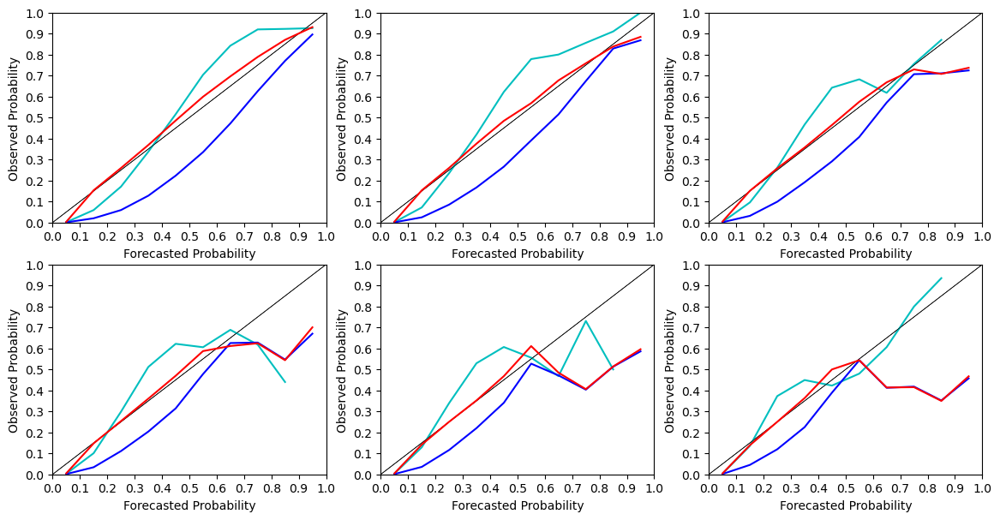

In [29]:
%matplotlib inline

#################### Reliability Subplots AMS Figs ####################

hazards = ['hail']#, 'wind', 'tornado']
length = 60
train_types = ['obs', 'obs_and_warnings']
ver_types = ['obs_and_warnings']
radii = [39]#, 15]
leads = [30, 60, 90, 120, 150, 180]

ps_version = 2
torp = False

use_avg_srs = True

if (ps_version == 2) and (not torp):
    model_type = 'wofs_psv2_no_torp'
elif (ps_version == 2) and (torp):
    model_type = 'wofs_psv2_with_torp'
elif (ps_version == 3) and (not torp):
    model_type = 'wofs_psv3_no_torp'
elif (ps_version == 3) and (torp):
    model_type = 'wofs_psv3_with_torp'

fig, axs = plt.subplots(2,3, figsize = (14, 7))

for haz in hazards:
    for train_type in train_types:
        for ver_type in ver_types:
            for train_radius in radii:
                ver_radius = train_radius
                sr_rel_scores = []
                prob_rel_scores = []
                climos = []
                if length == 60:
                    num_cols = 3
                    fig_width = 14
                elif length == 120:
                    num_cols = 2
                    fig_width = 14/1.5
                
                #sr_fig, sr_axs = plt.subplots(2,num_cols, figsize = (fig_width, 7))
                if use_avg_srs:
                    sup_title = '%s Average SR Mapping Reliability, Model: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), model_type, train_type, train_radius, ver_type, ver_radius)
                else:
                    sup_title = '%s SR Mapping Reliability, Model: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), model_type, train_type, train_radius, ver_type, ver_radius)
                #sr_fig.suptitle(sup_title)
                
                #prob_fig, prob_axs = plt.subplots(2,num_cols, figsize = (fig_width,7))
                #sup_title = '%s Raw Probability Reliability, Model: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), model_type, train_type, train_radius, ver_type, ver_radius)
                #prob_fig.suptitle(sup_title)
                for i in range(len(leads)):
                    lead = leads[i]
                    rel_data_fname = get_reliability_file(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, use_avg_srs)
                    rel_data = np.load(rel_data_fname)
                    sr_rel_scores.append(rel_data[0,0])
                    prob_rel_scores.append(rel_data[0,1])
                    climos.append(rel_data[0,2])
                    fcsts = rel_data[1,:]
                    sr_fcst_freq = rel_data[2,:]
                    sr_obs_freq = rel_data[3,:]
                    prob_fcst_freq = rel_data[4,:]
                    prob_obs_freq = rel_data[5,:]
                    
                    sr_obs_freq = sr_obs_freq[np.where(sr_fcst_freq > 0)]
                    sr_fcsts = fcsts[np.where(sr_fcst_freq > 0)]
                    
                    prob_obs_freq = prob_obs_freq[np.where(prob_fcst_freq > 0)]
                    prob_fcsts = fcsts[np.where(prob_fcst_freq > 0)]
                    
                    index = int(lead/30)-1
                    row_index = math.floor(index/num_cols)
                    if index <= (num_cols-1):
                        col_index = index
                    else:
                        col_index = index-num_cols
                    
                    axs[row_index, col_index].plot([0,1], [0,1], 'k', linewidth = 0.5, label = 'Perfect Reliability')
                    
                    if train_type == 'obs':
                        axs[row_index, col_index].plot(sr_fcsts, sr_obs_freq, 'c', label = 'Reliability')
                    else:
                        axs[row_index, col_index].plot(sr_fcsts, sr_obs_freq, 'b', label = 'Reliability')
                        axs[row_index, col_index].plot(prob_fcsts, prob_obs_freq, 'r', label = 'Reliability')
                    
                    axs[row_index, col_index].set_xlim([0,1])
                    axs[row_index, col_index].set_ylim([0,1])
                    axs[row_index, col_index].set_xlabel('Forecasted Probability')
                    axs[row_index, col_index].set_xticks(np.arange(0,1.01,0.1))
                    axs[row_index, col_index].set_yticks(np.arange(0,1.01,0.1))
                    axs[row_index, col_index].set_ylabel('Observed Probability')
                    
                    #l1 = sr_axs[row_index, col_index].plot(sr_fcsts, sr_obs_freq, 'b', label = 'Reliability')
                    #l2 = sr_axs[row_index, col_index].plot([0,1], [climos[i], climos[i]], 'orange', linewidth = 0.5, label = 'Climatology')
                    #l3 = sr_axs[row_index, col_index].plot([0,1], [0,1], 'k', linewidth = 0.5, label = 'Perfect Reliability')
                    #sr_axs[row_index, col_index].set_xlim([0,1])
                    #sr_axs[row_index, col_index].set_ylim([0,1])
                    #sr_axs[row_index, col_index].set_xlabel('Forecasted Probability')
                    #sr_axs[row_index, col_index].set_xticks(np.arange(0,1.01,0.1))
                    #sr_axs[row_index, col_index].set_yticks(np.arange(0,1.01,0.1))
                    #sr_axs[row_index, col_index].set_ylabel('Observed Probability')
                    #ax2 = sr_axs[row_index, col_index].twinx()
                    #l4 = ax2.plot(fcsts, sr_fcst_freq, 'r', linewidth = 0.5, label = 'Forecast Frequency')
                    #ax2.set_yscale('log')
                    #ax2.set_ylabel('Forecast Frequency')
                    #title = '%s - %s Minute Window, Error Score: %s' %(lead, lead+length, round(sr_rel_scores[i], 3))
                    #sr_axs[row_index, col_index].set_title(title)
                    #lns = l1+l2+l3+l4
                    #labs = [l.get_label() for l in lns]
                    #sr_axs[row_index, col_index].legend(lns, labs, loc=0)
                    
                    #l1 = prob_axs[row_index, col_index].plot(prob_fcsts, prob_obs_freq, 'b', label = 'Reliability')
                    #l2 = prob_axs[row_index, col_index].plot([0,1], [climos[i], climos[i]], 'orange', linewidth = 0.5, label = 'Climatology')
                    #l3 = prob_axs[row_index, col_index].plot([0,1], [0,1], 'k', linewidth = 0.5, label = 'Perfect Reliability')
                    #prob_axs[row_index, col_index].set_xlim([0,1])
                    #prob_axs[row_index, col_index].set_ylim([0,1])
                    #prob_axs[row_index, col_index].set_xlabel('Forecasted Probability')
                    #prob_axs[row_index, col_index].set_xticks(np.arange(0,1.01,0.1))
                    #prob_axs[row_index, col_index].set_yticks(np.arange(0,1.01,0.1))
                    #prob_axs[row_index, col_index].set_ylabel('Observed Probability')
                    #ax2 = prob_axs[row_index, col_index].twinx()
                    #l4 = ax2.plot(fcsts, prob_fcst_freq, 'r', linewidth = 0.5, label = 'Forecast Frequency')
                    #ax2.set_yscale('log')
                    #ax2.set_ylabel('Forecast Frequency')
                    #title = '%s - %s Minute Window, Error Score: %s' %(lead, lead+length, round(prob_rel_scores[i], 3))
                    #prob_axs[row_index, col_index].set_title(title)
                    #lns = l1+l2+l3+l4
                    #labs = [l.get_label() for l in lns]
                    #prob_axs[row_index, col_index].legend(lns, labs, loc=0)
                
                #sr_fig.tight_layout()
                #prob_fig.tight_layout()
                if use_avg_srs:
                    sr_fig_dir, sr_fig_fname = get_reliability_fig_fname(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, 'avg_sr_map')
                else:
                    sr_fig_dir, sr_fig_fname = get_reliability_fig_fname(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, 'sr_map')
                #utilities.save_data(sr_fig_dir, sr_fig_fname, sr_fig, 'png')
                #prob_fig_dir, prob_fig_fname = get_reliability_fig_fname(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, 'raw_probs')
                #utilities.save_data(prob_fig_dir, prob_fig_fname, prob_fig, 'png')
                

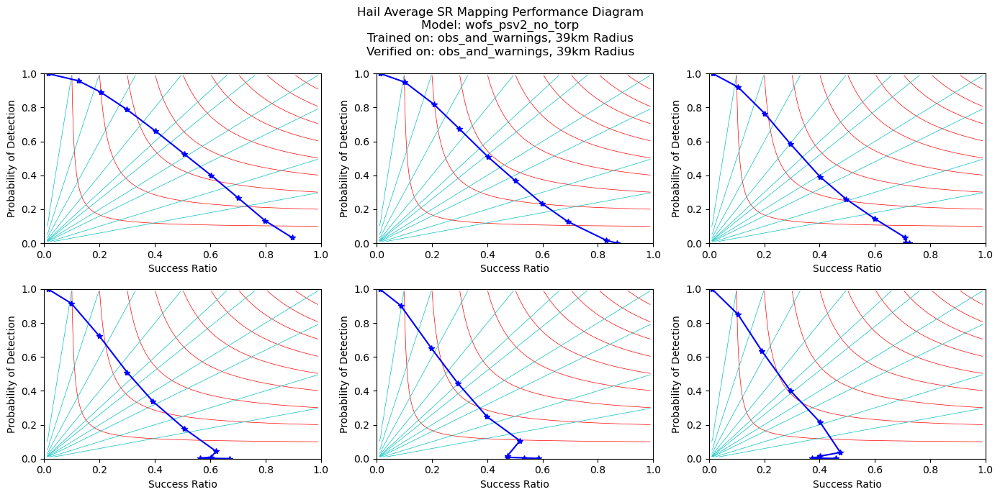

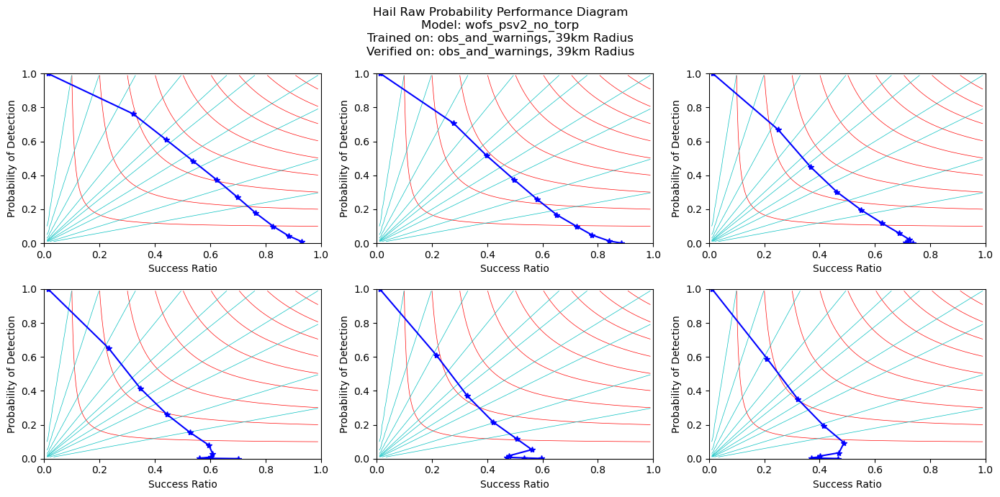

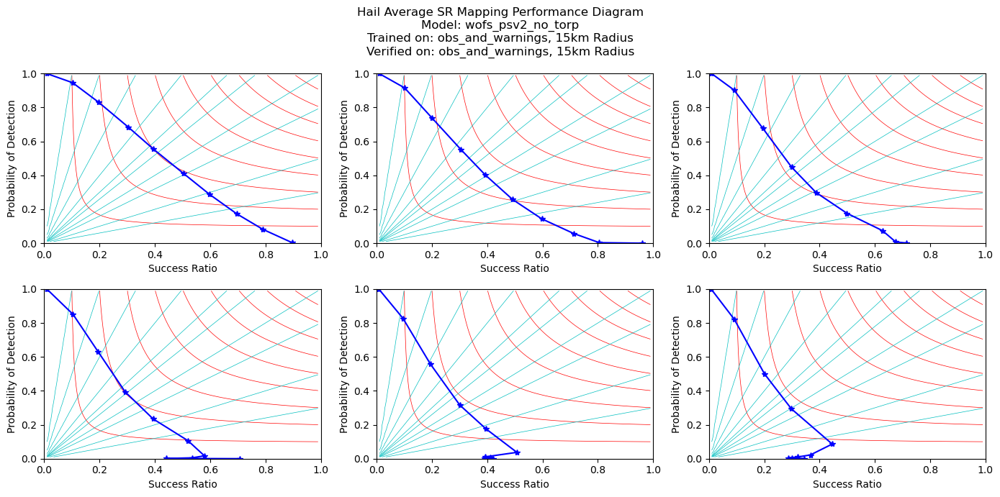

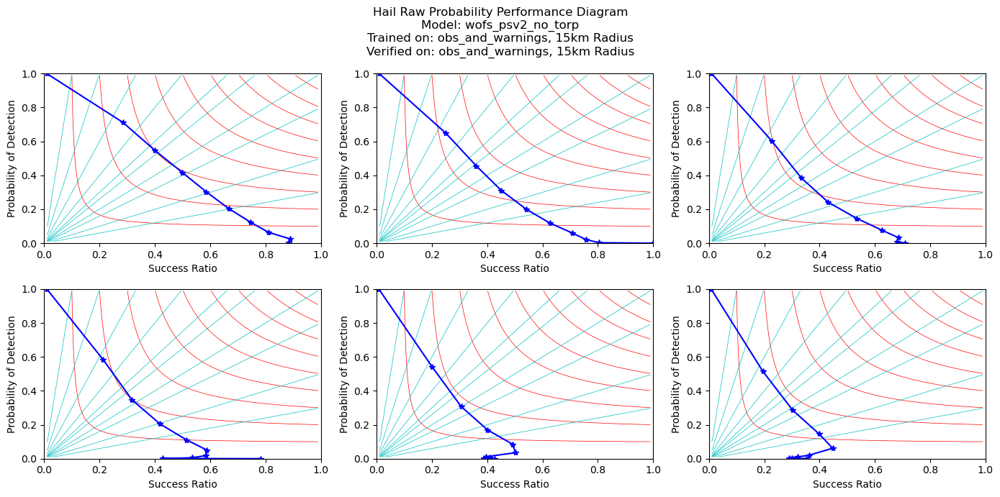

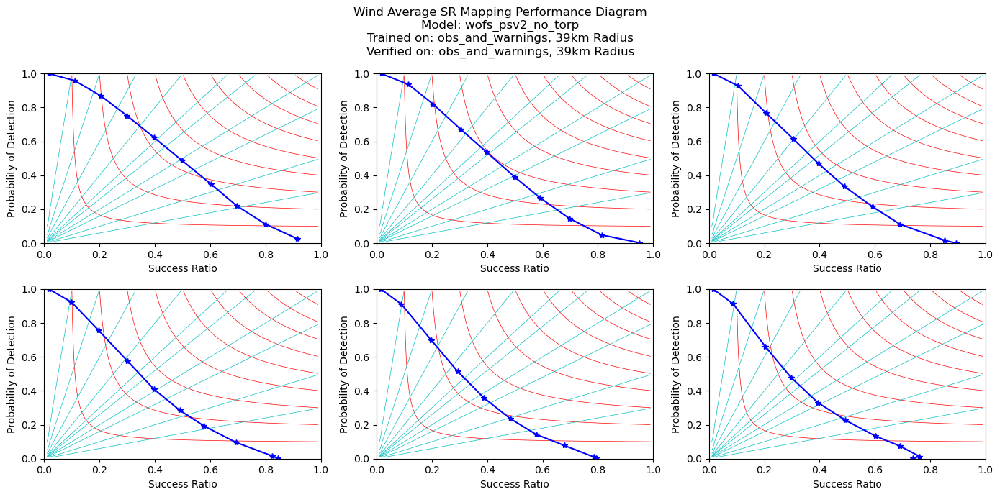

...

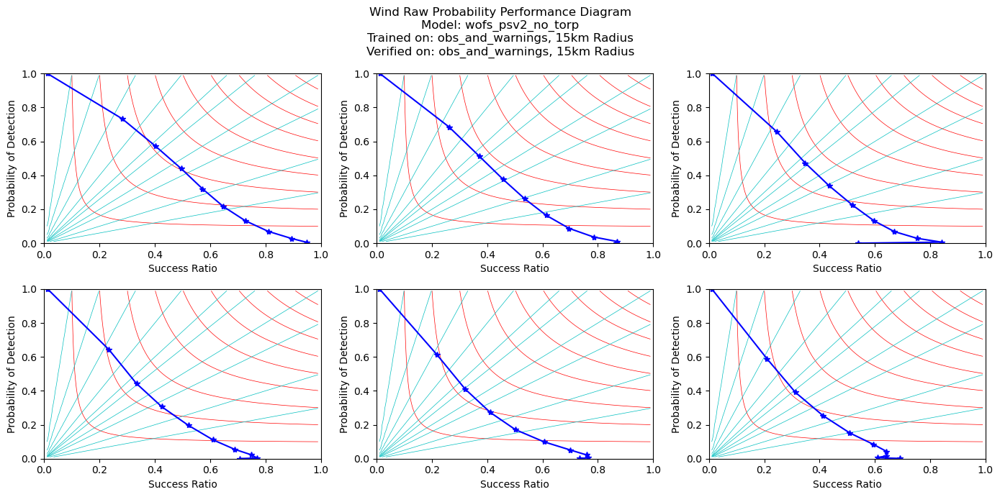

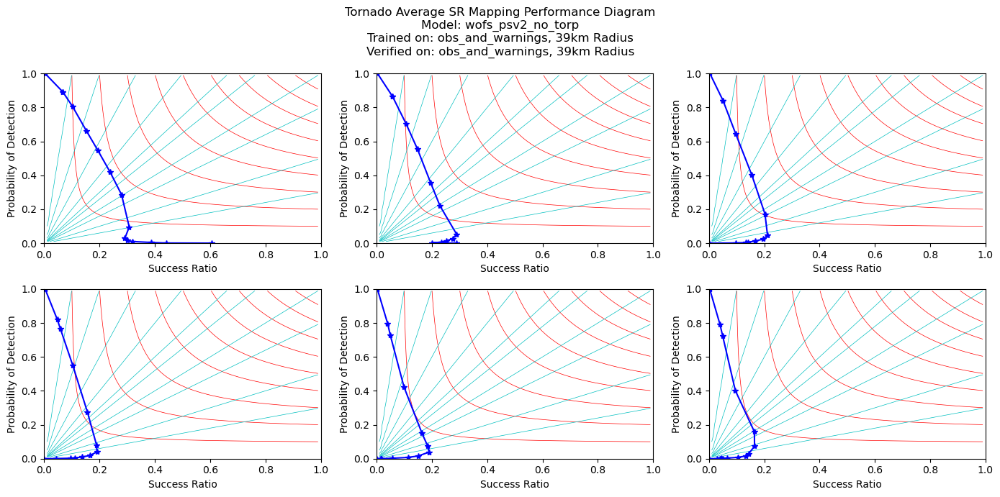

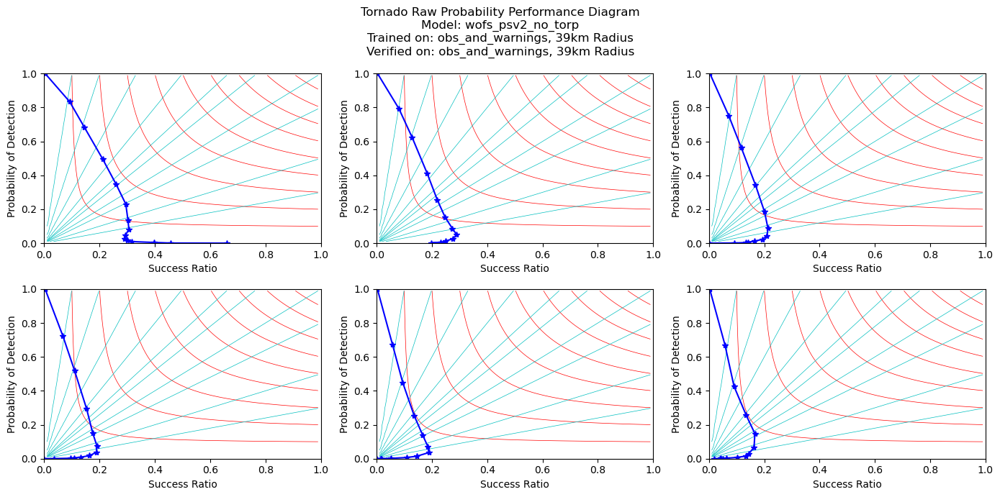

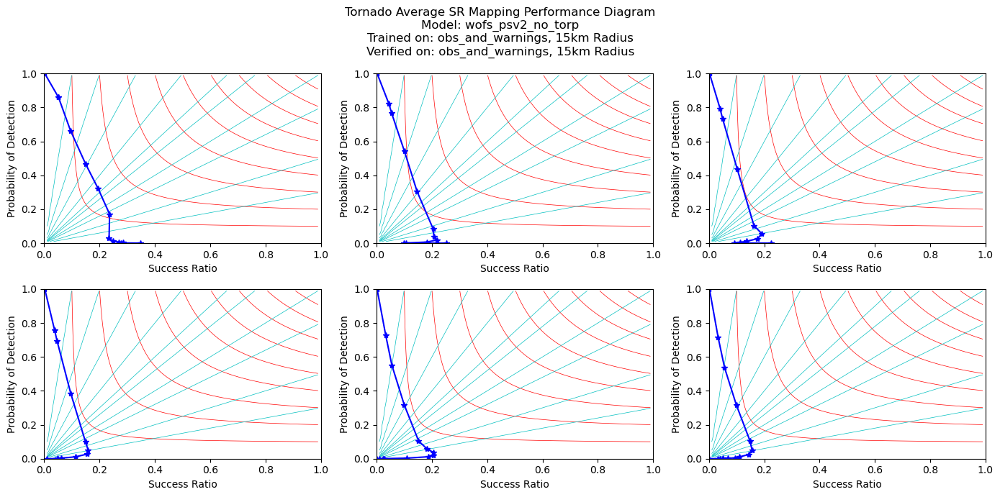

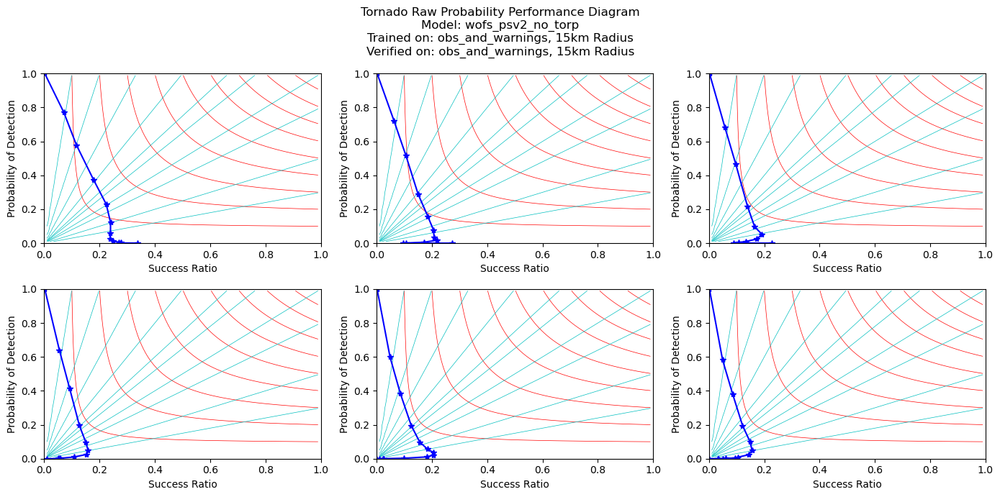

In [49]:
#################### Performance Diagrams ####################

hazards = ['hail', 'wind', 'tornado']
length = 60
train_types = ['obs_and_warnings']
ver_types = ['obs_and_warnings']
radii = [39, 15]
leads = [30, 60, 90, 120, 150, 180]

ps_version = 2
torp = False

use_avg_srs = True

if (ps_version == 2) and (not torp):
    model_type = 'wofs_psv2_no_torp'
elif (ps_version == 2) and (torp):
    model_type = 'wofs_psv2_with_torp'
elif (ps_version == 3) and (not torp):
    model_type = 'wofs_psv3_no_torp'
elif (ps_version == 3) and (torp):
    model_type = 'wofs_psv3_with_torp'

for haz in hazards:
    for train_type in train_types:
        for ver_type in ver_types:
            for train_radius in radii:
                ver_radius = train_radius
                
                if length == 60:
                    num_cols = 3
                    fig_width = 14
                elif length == 120:
                    num_cols = 2
                    fig_width = 14/1.5
                
                sr_fig, sr_axs = plt.subplots(2,num_cols, figsize = (fig_width, 7))
                if use_avg_srs:
                    sup_title = '%s Average SR Mapping Performance Diagram\nModel: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), model_type, train_type, train_radius, ver_type, ver_radius)
                else:
                    sup_title = '%s SR Mapping Performance Diagram\nModel: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), model_type, train_type, train_radius, ver_type, ver_radius)
                sr_fig.suptitle(sup_title)
                
                prob_fig, prob_axs = plt.subplots(2,num_cols, figsize = (fig_width, 7))
                sup_title = '%s Raw Probability Performance Diagram\nModel: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), model_type, train_type, train_radius, ver_type, ver_radius)
                prob_fig.suptitle(sup_title)
                for i in range(len(leads)):
                    lead = leads[i]
                    pd_fname = get_performance_diagram_file(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, use_avg_srs)
                    pd_data = np.load(pd_fname)
                    sr_thresholds = pd_data[0,:]
                    sr_pods = pd_data[1,:]
                    sr_srs = pd_data[2,:]
                    prob_thresholds = pd_data[3,:]
                    prob_pods = pd_data[4,:]
                    prob_srs = pd_data[5,:]
                    
                    sr_thresholds = sr_thresholds[np.where(sr_thresholds > -1)]
                    sr_pods = sr_pods[np.where(sr_pods > -1)]
                    sr_srs = sr_srs[np.where(sr_srs > -1)]
                    prob_thresholds = prob_thresholds[np.where(prob_thresholds > -1)]
                    prob_pods = prob_pods[np.where(prob_pods > -1)]
                    prob_srs = prob_srs[np.where(prob_srs > -1)]
                    
                    mesh_sr, mesh_pod, csis, bias = calc_csi_bias_contours()
                    
                    index = int(lead/30)-1
                    row_index = math.floor(index/num_cols)
                    if index <= (num_cols-1):
                        col_index = index
                    else:
                        col_index = index-num_cols
                    
                    pd = sr_axs[row_index, col_index].plot(sr_srs, sr_pods, 'b-*')
                    csi_lines = sr_axs[row_index, col_index].contour(mesh_sr, mesh_pod, csis, np.arange(0.1, 1, 0.1), colors = ['r'], linewidths = 0.5)
                    bias_lines = sr_axs[row_index, col_index].contour(mesh_sr, mesh_pod, bias, [0.3, 0.5, 0.8, 1, 1.3, 1.5, 2, 3, 5, 10], colors = ['c'], linewidths = 0.5)
                    h2,_ = csi_lines.legend_elements()
                    h3,_ = bias_lines.legend_elements()
                    sr_axs[row_index, col_index].set_xlim([0,1])
                    sr_axs[row_index, col_index].set_ylim([0,1])
                    sr_axs[row_index, col_index].set_xlabel('Success Ratio')
                    sr_axs[row_index, col_index].set_ylabel('Probability of Detection')
                    title = '%s - %s Minute Window' %(lead, lead+length)
                    #sr_axs[row_index, col_index].set_title(title)
                    #sr_axs[row_index, col_index].legend([pd[0], h2[0], h3[0]], ['Performance Curve', 'CSI', 'Bias'])
                    
                    
                    pd = prob_axs[row_index, col_index].plot(prob_srs, prob_pods, 'b-*', label = 'Performance Curve')
                    csi_lines = prob_axs[row_index, col_index].contour(mesh_sr, mesh_pod, csis, np.arange(0.1, 1, 0.1), colors = ['r'], linewidths = 0.5)
                    bias_lines = prob_axs[row_index, col_index].contour(mesh_sr, mesh_pod, bias, [0.3, 0.5, 0.8, 1, 1.3, 1.5, 2, 3, 5, 10], colors = ['c'], linewidths = 0.5)
                    h2,_ = csi_lines.legend_elements()
                    h3,_ = bias_lines.legend_elements()
                    prob_axs[row_index, col_index].set_xlim([0,1])
                    prob_axs[row_index, col_index].set_ylim([0,1])
                    prob_axs[row_index, col_index].set_xlabel('Success Ratio')
                    prob_axs[row_index, col_index].set_ylabel('Probability of Detection')
                    title = '%s - %s Minute Window' %(lead, lead+length)
                    #prob_axs[row_index, col_index].set_title(title)
                    #prob_axs[row_index, col_index].legend([pd[0], h2[0], h3[0]], ['Performance Curve', 'CSI', 'Bias'])
                
                sr_fig.tight_layout()
                prob_fig.tight_layout()
                if use_avg_srs:
                    sr_fig_dir, sr_fig_fname = get_performance_diagram_fig_fname(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, 'avg_sr_map')
                else:
                    sr_fig_dir, sr_fig_fname = get_performance_diagram_fig_fname(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, 'sr_map')
                utilities.save_data(sr_fig_dir, sr_fig_fname, sr_fig, 'png')
                prob_fig_dir, prob_fig_fname = get_performance_diagram_fig_fname(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, 'raw_probs')
                utilities.save_data(prob_fig_dir, prob_fig_fname, prob_fig, 'png')
                

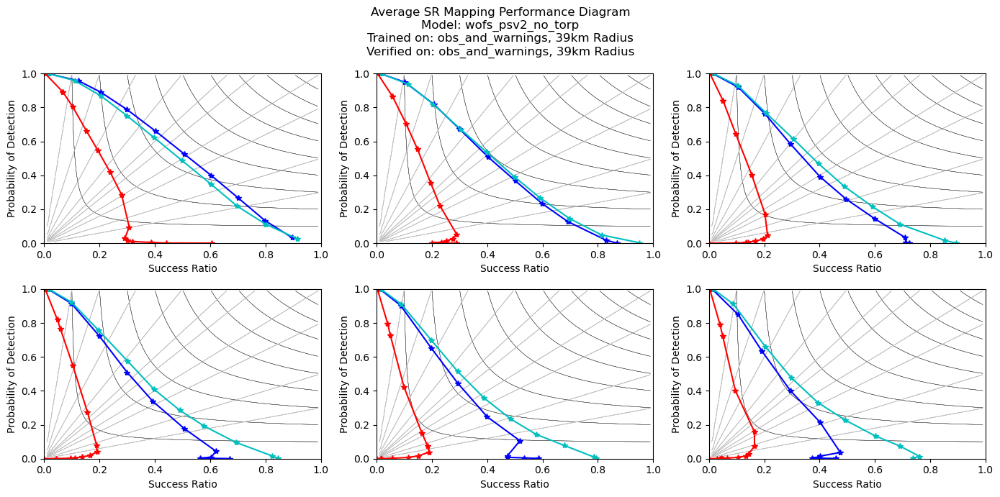

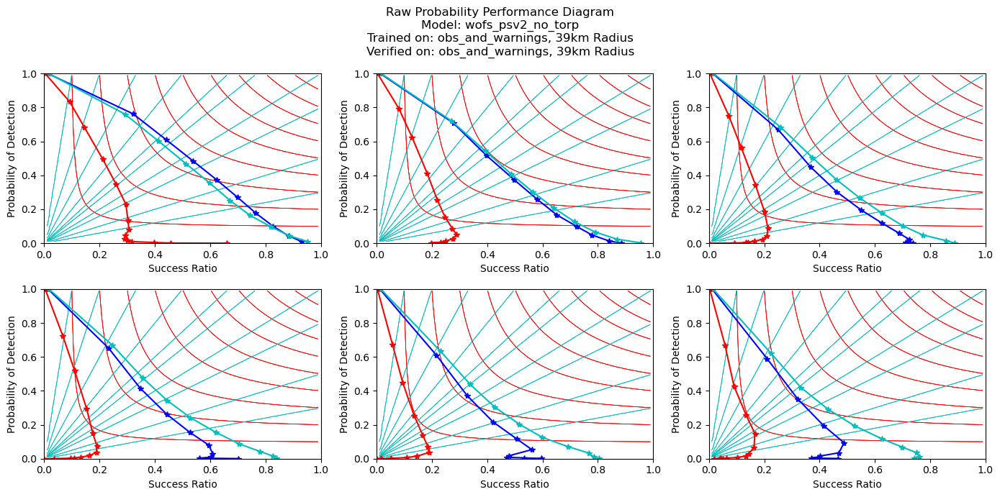

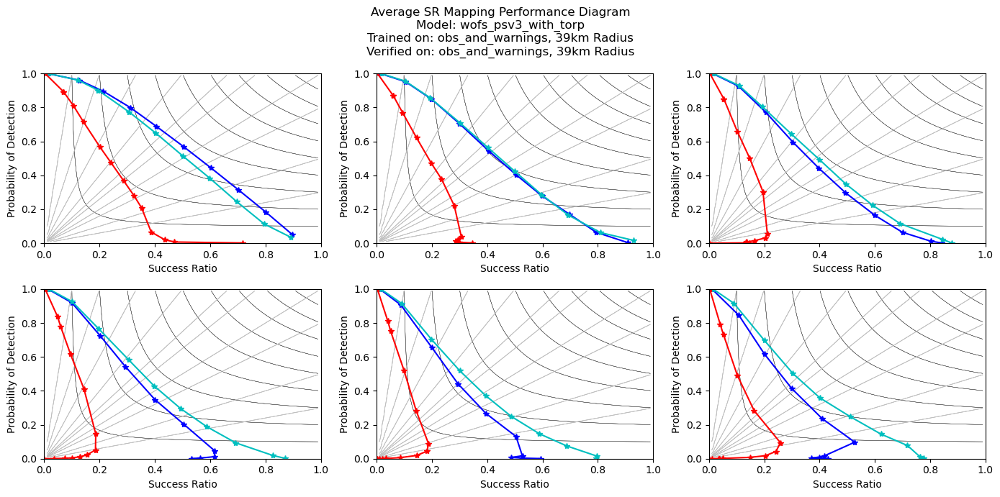

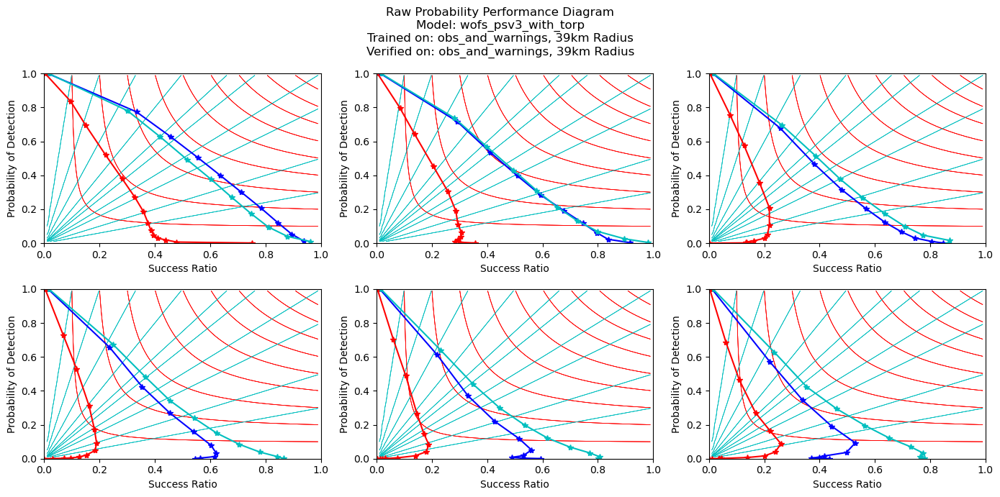

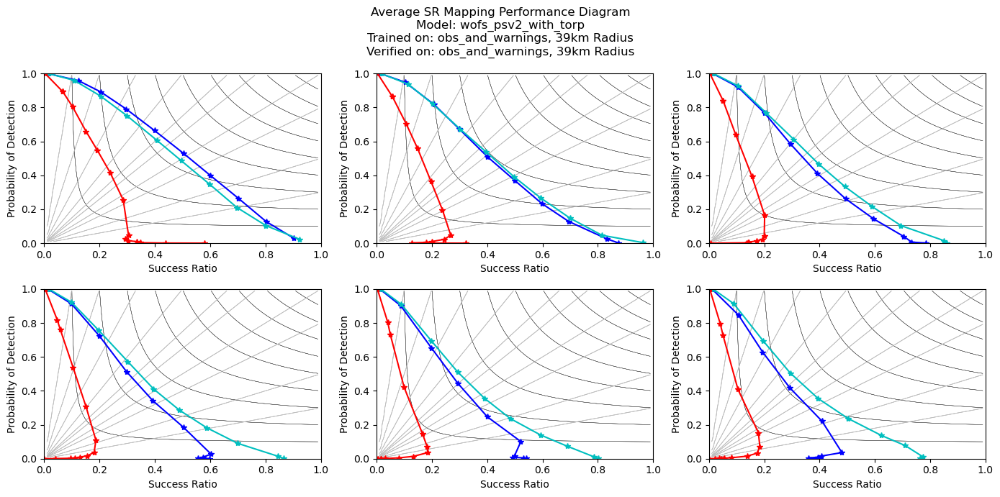

...

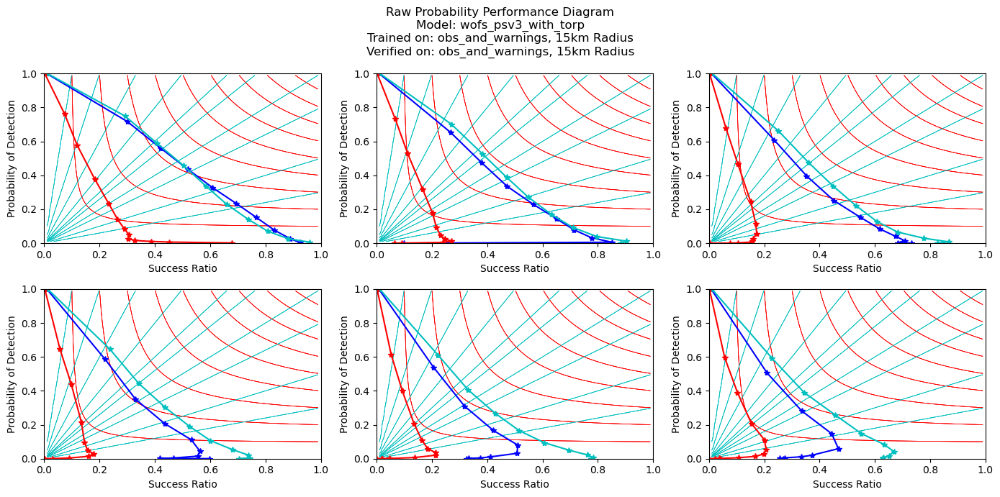

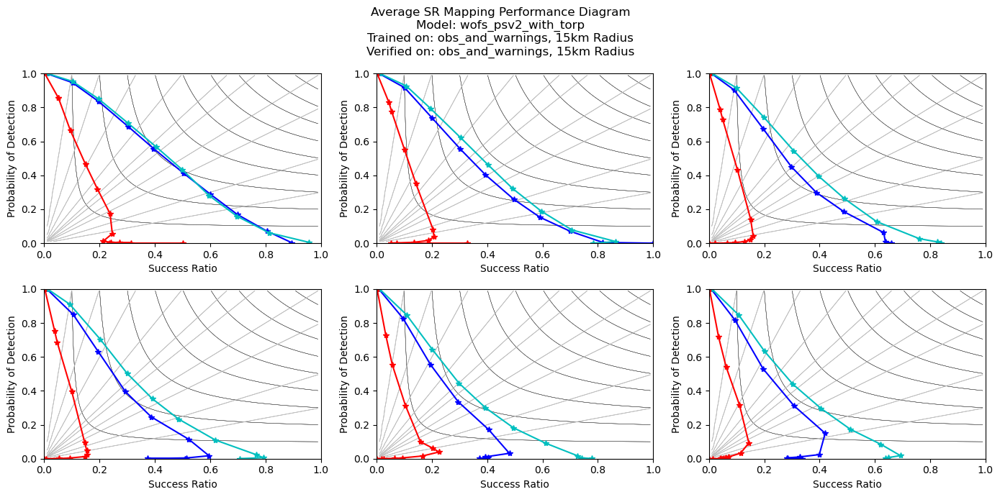

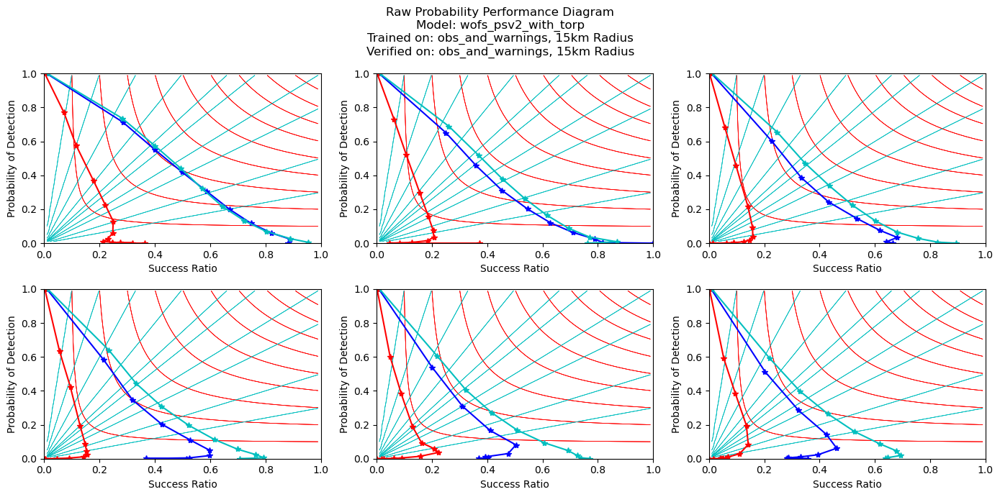

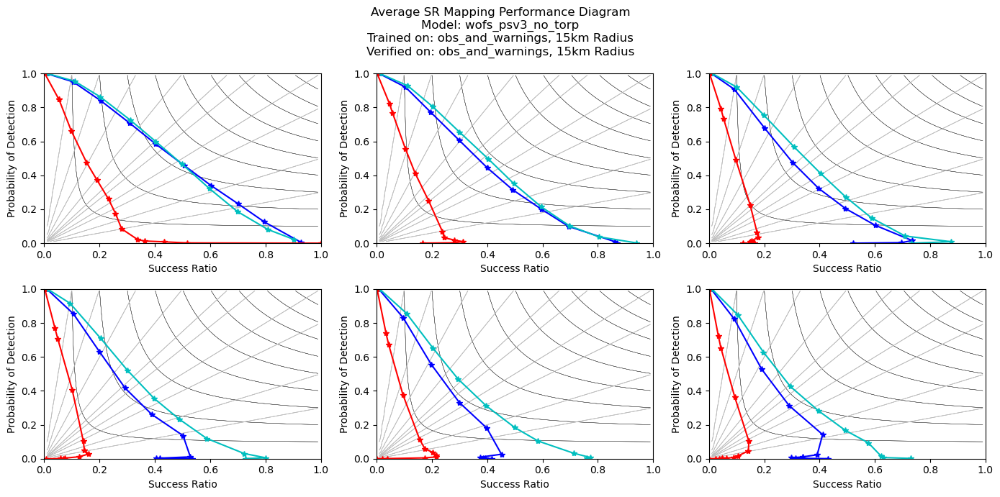

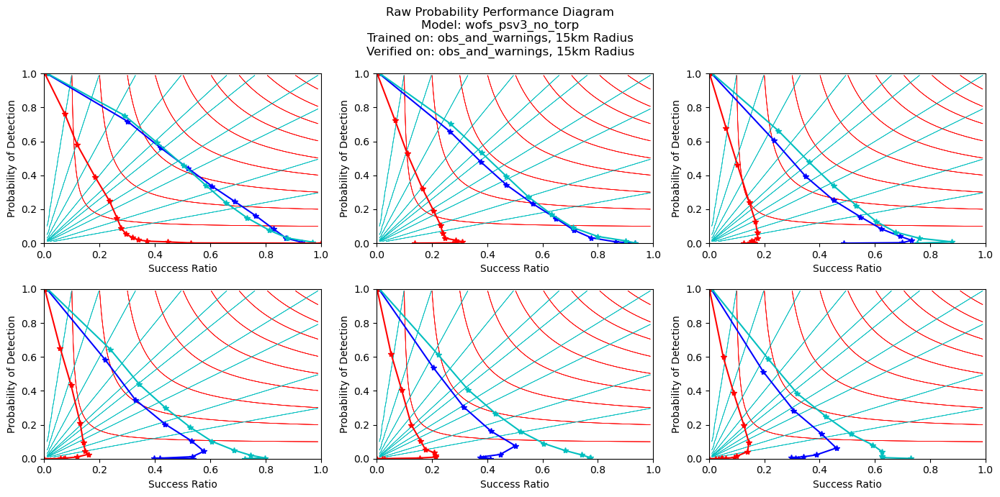

In [23]:
#################### Performance Diagrams Hazard Comparisons ####################

hazards = ['hail', 'wind', 'tornado']
length = 60
train_types = ['obs_and_warnings']
ver_types = ['obs_and_warnings']
radii = [39, 15]
leads = [30, 60, 90, 120, 150, 180]

ps_version = 3
torp = False

use_avg_srs = True
model_types = ['wofs_psv2_no_torp', 'wofs_psv3_with_torp', 'wofs_psv2_with_torp', 'wofs_psv3_no_torp']

if (ps_version == 2) and (not torp):
    model_type = 'wofs_psv2_no_torp'
elif (ps_version == 2) and (torp):
    model_type = 'wofs_psv2_with_torp'
elif (ps_version == 3) and (not torp):
    model_type = 'wofs_psv3_no_torp'
elif (ps_version == 3) and (torp):
    model_type = 'wofs_psv3_with_torp'

for train_type in train_types:
    for ver_type in ver_types:
        for train_radius in radii:
            ver_radius = train_radius
            
            if length == 60:
                num_cols = 3
                fig_width = 14
            elif length == 120:
                num_cols = 2
                fig_width = 14/1.5
            
            for model_type in model_types:
            
                sr_fig, sr_axs = plt.subplots(2,num_cols, figsize = (fig_width, 7))
                if use_avg_srs:
                    sup_title = 'Average SR Mapping Performance Diagram\nModel: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(model_type, train_type, train_radius, ver_type, ver_radius)
                else:
                    sup_title = 'SR Mapping Performance Diagram\nModel: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(model_type, train_type, train_radius, ver_type, ver_radius)
                sr_fig.suptitle(sup_title)

                prob_fig, prob_axs = plt.subplots(2,num_cols, figsize = (fig_width, 7))
                sup_title = 'Raw Probability Performance Diagram\nModel: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(model_type, train_type, train_radius, ver_type, ver_radius)
                prob_fig.suptitle(sup_title)

                for haz in hazards:

                    for i in range(len(leads)):
                        lead = leads[i]
                        pd_fname = get_performance_diagram_file(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, use_avg_srs)
                        pd_data = np.load(pd_fname)
                        sr_thresholds = pd_data[0,:]
                        sr_pods = pd_data[1,:]
                        sr_srs = pd_data[2,:]
                        prob_thresholds = pd_data[3,:]
                        prob_pods = pd_data[4,:]
                        prob_srs = pd_data[5,:]

                        sr_thresholds = sr_thresholds[np.where(sr_thresholds > -1)]
                        sr_pods = sr_pods[np.where(sr_pods > -1)]
                        sr_srs = sr_srs[np.where(sr_srs > -1)]
                        prob_thresholds = prob_thresholds[np.where(prob_thresholds > -1)]
                        prob_pods = prob_pods[np.where(prob_pods > -1)]
                        prob_srs = prob_srs[np.where(prob_srs > -1)]

                        mesh_sr, mesh_pod, csis, bias = calc_csi_bias_contours()

                        index = int(lead/30)-1
                        row_index = math.floor(index/num_cols)
                        if index <= (num_cols-1):
                            col_index = index
                        else:
                            col_index = index-num_cols

                        color = get_haz_color(haz)

                        sr_axs[row_index, col_index].plot(sr_srs, sr_pods, color + '-*')
                        csi_color = (0.5, 0.5, 0.5)
                        csi_lines = sr_axs[row_index, col_index].contour(mesh_sr, mesh_pod, csis, np.arange(0.1, 1, 0.1), colors = [(0.25, 0.25, 0.25)], linewidths = 0.25)
                        bias_lines = sr_axs[row_index, col_index].contour(mesh_sr, mesh_pod, bias, [0.3, 0.5, 0.8, 1, 1.3, 1.5, 2, 3, 5, 10], colors = [(0.75, 0.75, 0.75)], linewidths = 0.5)
                        h2,_ = csi_lines.legend_elements()
                        h3,_ = bias_lines.legend_elements()
                        sr_axs[row_index, col_index].set_xlim([0,1])
                        sr_axs[row_index, col_index].set_ylim([0,1])
                        sr_axs[row_index, col_index].set_xlabel('Success Ratio')
                        sr_axs[row_index, col_index].set_ylabel('Probability of Detection')
                        title = '%s - %s Minute Window' %(lead, lead+length)
                        #sr_axs[row_index, col_index].set_title(title)
                        #sr_axs[row_index, col_index].legend([pd[0], h2[0], h3[0]], ['Performance Curve', 'CSI', 'Bias'])


                        prob_axs[row_index, col_index].plot(prob_srs, prob_pods, color + '-*', label = 'Performance Curve')
                        csi_lines = prob_axs[row_index, col_index].contour(mesh_sr, mesh_pod, csis, np.arange(0.1, 1, 0.1), colors = ['r'], linewidths = 0.5)
                        bias_lines = prob_axs[row_index, col_index].contour(mesh_sr, mesh_pod, bias, [0.3, 0.5, 0.8, 1, 1.3, 1.5, 2, 3, 5, 10], colors = ['c'], linewidths = 0.5)
                        h2,_ = csi_lines.legend_elements()
                        h3,_ = bias_lines.legend_elements()
                        prob_axs[row_index, col_index].set_xlim([0,1])
                        prob_axs[row_index, col_index].set_ylim([0,1])
                        prob_axs[row_index, col_index].set_xlabel('Success Ratio')
                        prob_axs[row_index, col_index].set_ylabel('Probability of Detection')
                        title = '%s - %s Minute Window' %(lead, lead+length)
                        #prob_axs[row_index, col_index].set_title(title)
                        #prob_axs[row_index, col_index].legend([pd[0], h2[0], h3[0]], ['Performance Curve', 'CSI', 'Bias'])

                    sr_fig.tight_layout()
                    prob_fig.tight_layout()
                    if use_avg_srs:
                        sr_fig_dir, sr_fig_fname = get_performance_diagram_fig_fname_haz_compare(model_type, train_type, ver_type, length, train_radius, ver_radius, lead, 'avg_sr_map')
                    else:
                        sr_fig_dir, sr_fig_fname = get_performance_diagram_fig_fname_haz_compare(model_type, train_type, ver_type, length, train_radius, ver_radius, lead, 'sr_map')
                    utilities.save_data(sr_fig_dir, sr_fig_fname, sr_fig, 'png')
                    prob_fig_dir, prob_fig_fname = get_performance_diagram_fig_fname_haz_compare(model_type, train_type, ver_type, length, train_radius, ver_radius, lead, 'raw_probs')
                    utilities.save_data(prob_fig_dir, prob_fig_fname, prob_fig, 'png')


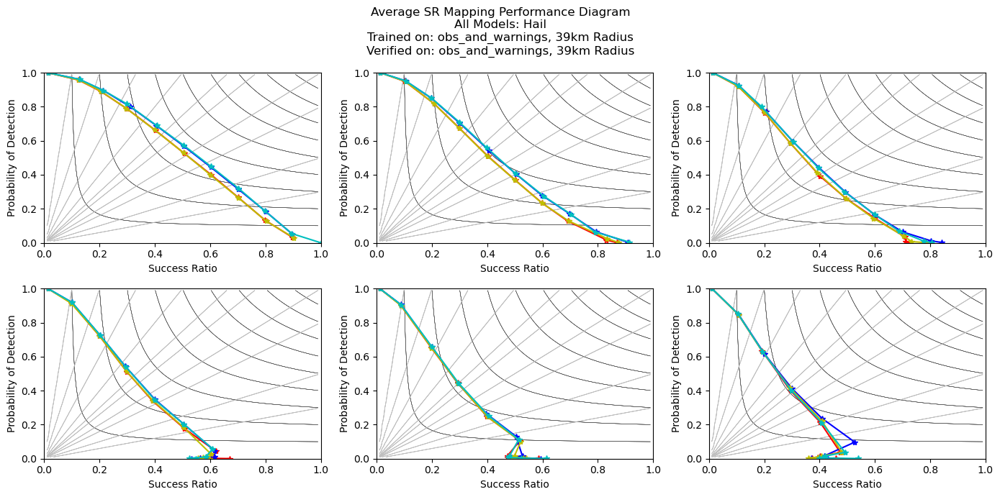

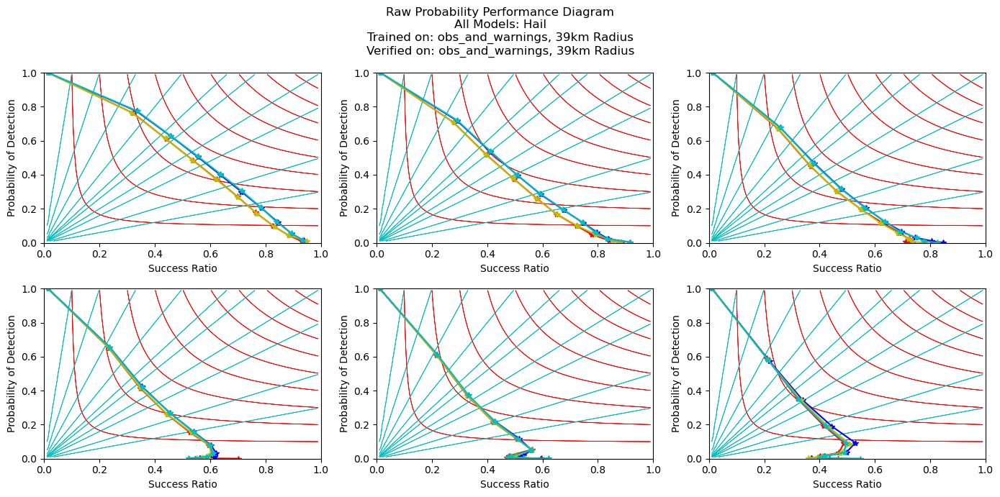

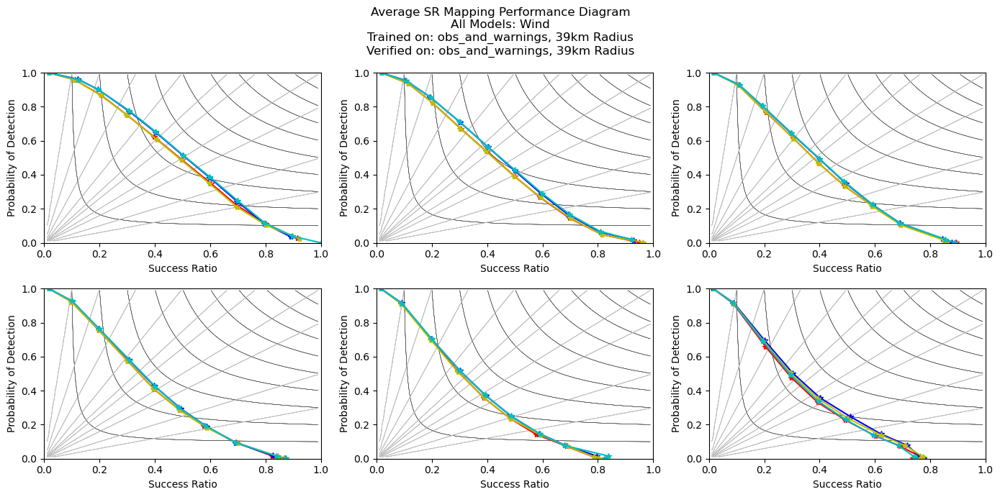

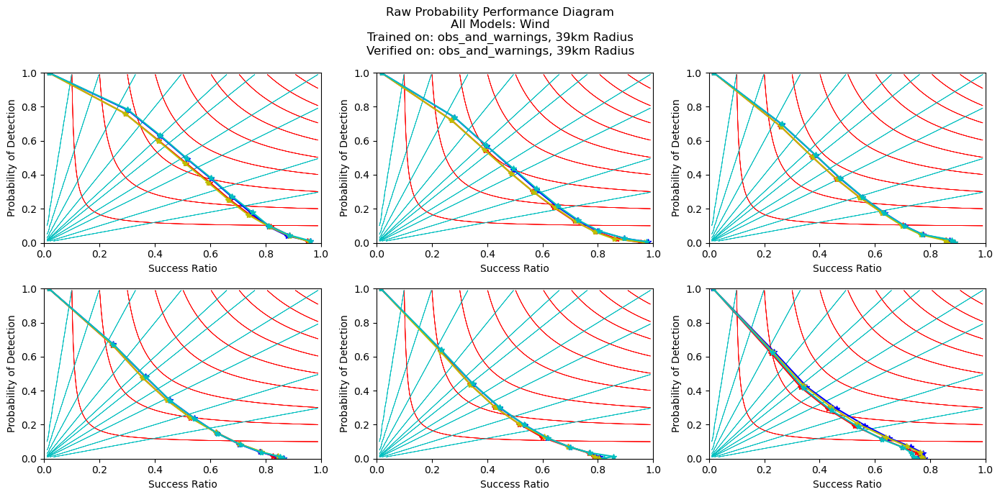

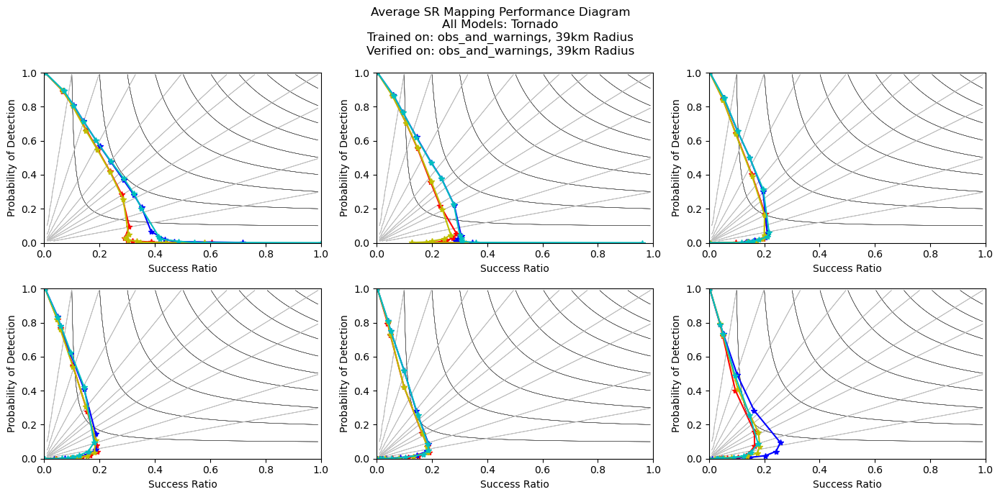

...

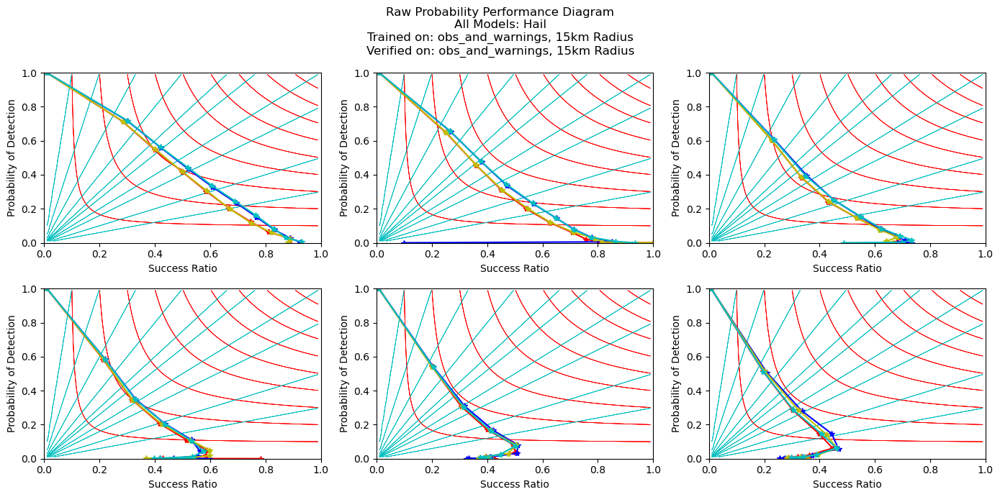

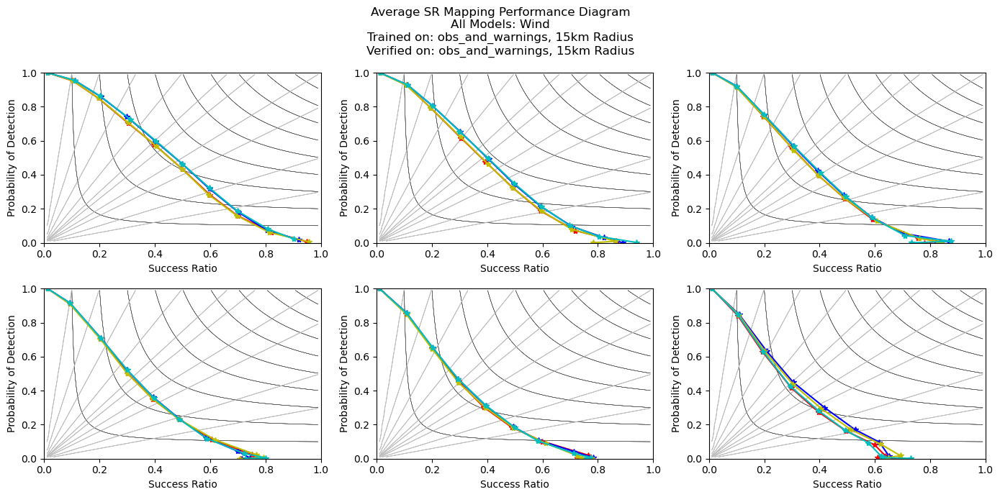

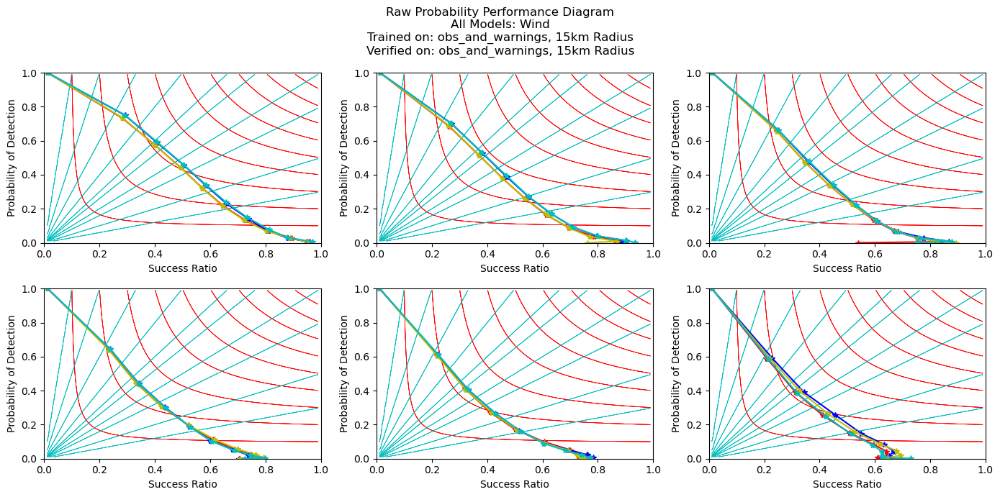

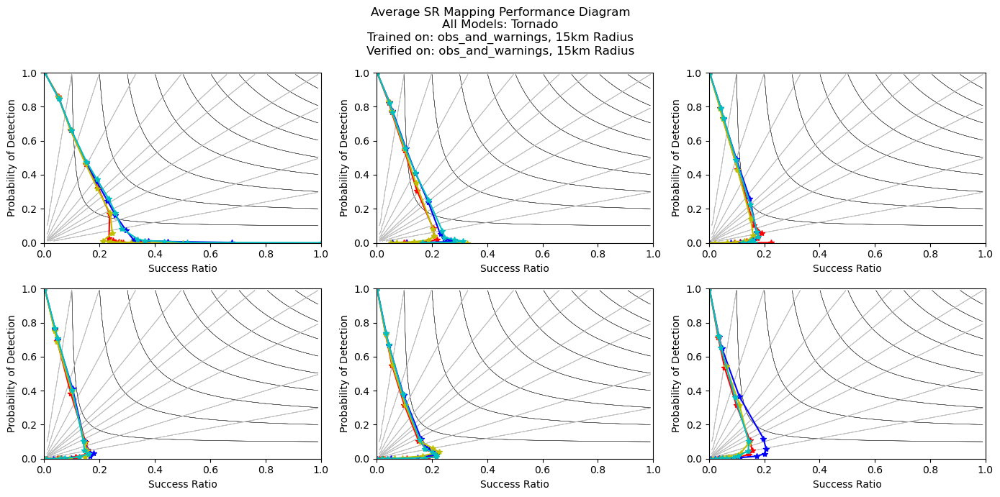

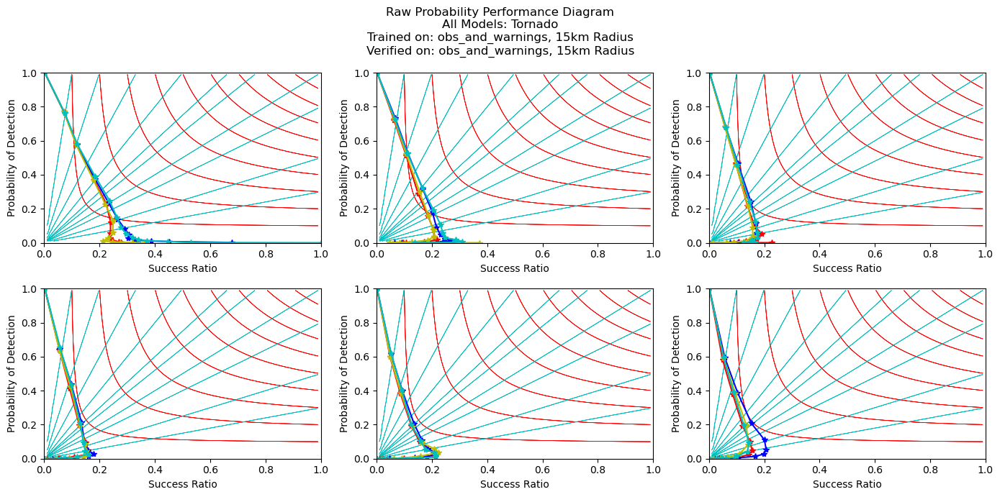

In [24]:
#################### Performance Diagrams Model Comparisons ####################

hazards = ['hail', 'wind', 'tornado']
length = 60
train_types = ['obs_and_warnings']
ver_types = ['obs_and_warnings']
radii = [39, 15]
leads = [30, 60, 90, 120, 150, 180]

ps_version = 3
torp = False

use_avg_srs = True
model_types = ['wofs_psv2_no_torp', 'wofs_psv3_with_torp', 'wofs_psv2_with_torp', 'wofs_psv3_no_torp']

if (ps_version == 2) and (not torp):
    model_type = 'wofs_psv2_no_torp'
elif (ps_version == 2) and (torp):
    model_type = 'wofs_psv2_with_torp'
elif (ps_version == 3) and (not torp):
    model_type = 'wofs_psv3_no_torp'
elif (ps_version == 3) and (torp):
    model_type = 'wofs_psv3_with_torp'

for train_type in train_types:
    for ver_type in ver_types:
        for train_radius in radii:
            ver_radius = train_radius
            
            if length == 60:
                num_cols = 3
                fig_width = 14
            elif length == 120:
                num_cols = 2
                fig_width = 14/1.5
            
            for haz in hazards:
                sr_fig, sr_axs = plt.subplots(2,num_cols, figsize = (fig_width, 7))
                if use_avg_srs:
                    sup_title = 'Average SR Mapping Performance Diagram\nAll Models: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), train_type, train_radius, ver_type, ver_radius)
                else:
                    sup_title = 'SR Mapping Performance Diagram\nAll Models: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), train_type, train_radius, ver_type, ver_radius)
                sr_fig.suptitle(sup_title)

                prob_fig, prob_axs = plt.subplots(2,num_cols, figsize = (fig_width, 7))
                sup_title = 'Raw Probability Performance Diagram\nAll Models: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz.capitalize(), train_type, train_radius, ver_type, ver_radius)
                prob_fig.suptitle(sup_title)
            
                for model_type in model_types:
                    for i in range(len(leads)):
                        lead = leads[i]
                        pd_fname = get_performance_diagram_file(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, lead, use_avg_srs)
                        pd_data = np.load(pd_fname)
                        sr_thresholds = pd_data[0,:]
                        sr_pods = pd_data[1,:]
                        sr_srs = pd_data[2,:]
                        prob_thresholds = pd_data[3,:]
                        prob_pods = pd_data[4,:]
                        prob_srs = pd_data[5,:]

                        sr_thresholds = sr_thresholds[np.where(sr_thresholds > -1)]
                        sr_pods = sr_pods[np.where(sr_pods > -1)]
                        sr_srs = sr_srs[np.where(sr_srs > -1)]
                        prob_thresholds = prob_thresholds[np.where(prob_thresholds > -1)]
                        prob_pods = prob_pods[np.where(prob_pods > -1)]
                        prob_srs = prob_srs[np.where(prob_srs > -1)]

                        mesh_sr, mesh_pod, csis, bias = calc_csi_bias_contours()

                        index = int(lead/30)-1
                        row_index = math.floor(index/num_cols)
                        if index <= (num_cols-1):
                            col_index = index
                        else:
                            col_index = index-num_cols

                        color = get_model_color(model_type)

                        sr_axs[row_index, col_index].plot(sr_srs, sr_pods, color + '-*')
                        csi_color = (0.5, 0.5, 0.5)
                        csi_lines = sr_axs[row_index, col_index].contour(mesh_sr, mesh_pod, csis, np.arange(0.1, 1, 0.1), colors = [(0.25, 0.25, 0.25)], linewidths = 0.25)
                        bias_lines = sr_axs[row_index, col_index].contour(mesh_sr, mesh_pod, bias, [0.3, 0.5, 0.8, 1, 1.3, 1.5, 2, 3, 5, 10], colors = [(0.75, 0.75, 0.75)], linewidths = 0.5)
                        h2,_ = csi_lines.legend_elements()
                        h3,_ = bias_lines.legend_elements()
                        sr_axs[row_index, col_index].set_xlim([0,1])
                        sr_axs[row_index, col_index].set_ylim([0,1])
                        sr_axs[row_index, col_index].set_xlabel('Success Ratio')
                        sr_axs[row_index, col_index].set_ylabel('Probability of Detection')
                        title = '%s - %s Minute Window' %(lead, lead+length)
                        #sr_axs[row_index, col_index].set_title(title)
                        #sr_axs[row_index, col_index].legend([pd[0], h2[0], h3[0]], ['Performance Curve', 'CSI', 'Bias'])


                        prob_axs[row_index, col_index].plot(prob_srs, prob_pods, color + '-*', label = 'Performance Curve')
                        csi_lines = prob_axs[row_index, col_index].contour(mesh_sr, mesh_pod, csis, np.arange(0.1, 1, 0.1), colors = ['r'], linewidths = 0.5)
                        bias_lines = prob_axs[row_index, col_index].contour(mesh_sr, mesh_pod, bias, [0.3, 0.5, 0.8, 1, 1.3, 1.5, 2, 3, 5, 10], colors = ['c'], linewidths = 0.5)
                        h2,_ = csi_lines.legend_elements()
                        h3,_ = bias_lines.legend_elements()
                        prob_axs[row_index, col_index].set_xlim([0,1])
                        prob_axs[row_index, col_index].set_ylim([0,1])
                        prob_axs[row_index, col_index].set_xlabel('Success Ratio')
                        prob_axs[row_index, col_index].set_ylabel('Probability of Detection')
                        title = '%s - %s Minute Window' %(lead, lead+length)
                        #prob_axs[row_index, col_index].set_title(title)
                        #prob_axs[row_index, col_index].legend([pd[0], h2[0], h3[0]], ['Performance Curve', 'CSI', 'Bias'])

                    sr_fig.tight_layout()
                    prob_fig.tight_layout()
                    if use_avg_srs:
                        sr_fig_dir, sr_fig_fname = get_performance_diagram_fig_fname_model_compare(model_type, train_type, ver_type, length, train_radius, ver_radius, lead, 'avg_sr_map')
                    else:
                        sr_fig_dir, sr_fig_fname = get_performance_diagram_fig_fname_model_compare(model_type, train_type, ver_type, length, train_radius, ver_radius, lead, 'sr_map')
                    utilities.save_data(sr_fig_dir, sr_fig_fname, sr_fig, 'png')
                    prob_fig_dir, prob_fig_fname = get_performance_diagram_fig_fname_model_compare(model_type, train_type, ver_type, length, train_radius, ver_radius, lead, 'raw_probs')
                    utilities.save_data(prob_fig_dir, prob_fig_fname, prob_fig, 'png')
                

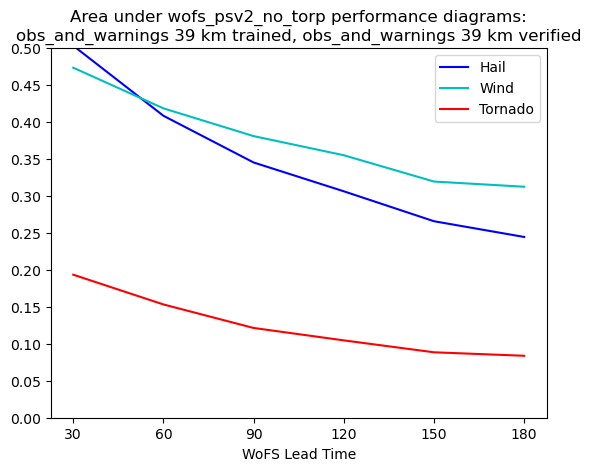

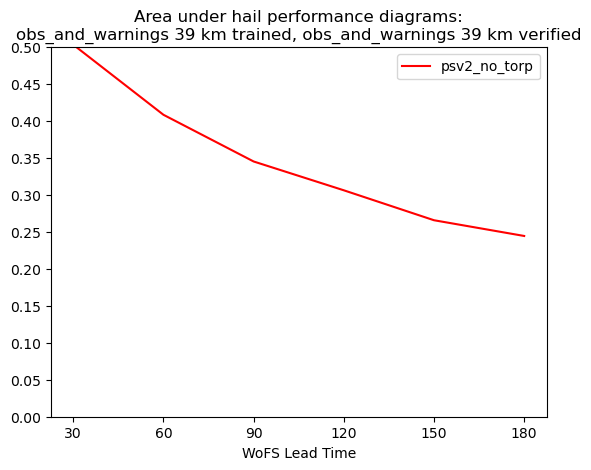

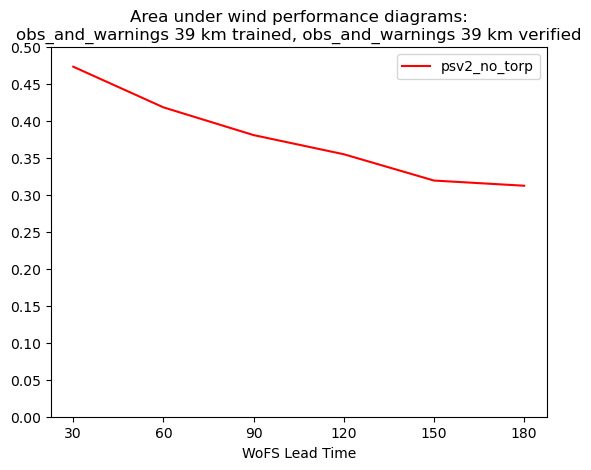

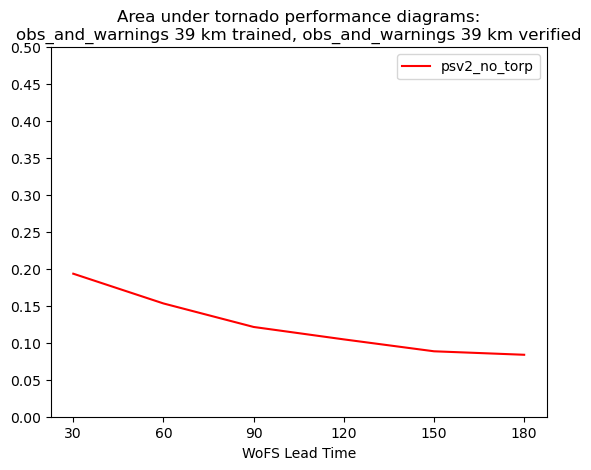

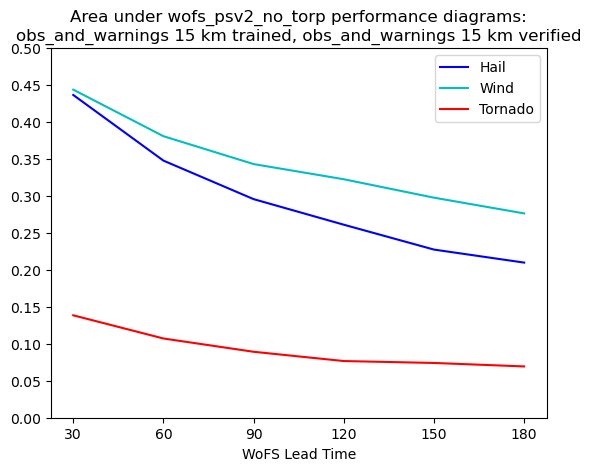

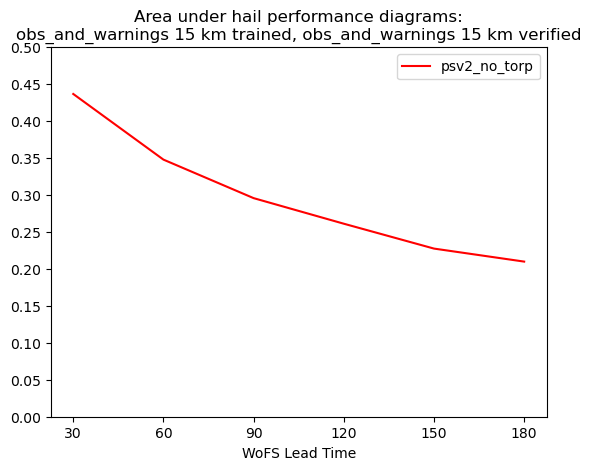

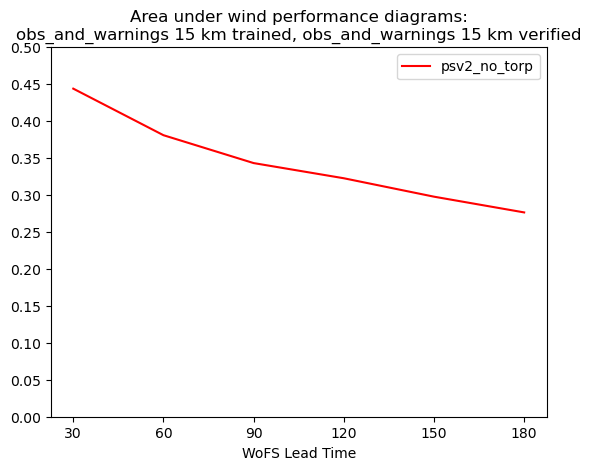

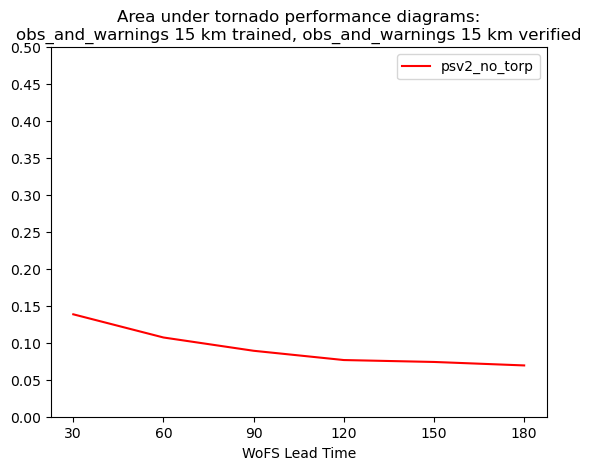

In [48]:
#################### Area Under Performance Diagrams ####################

hazards = ['hail', 'wind', 'tornado']
length = 60
train_types = ['obs_and_warnings']
ver_types = ['obs_and_warnings']
radii = [39, 15]
leads = [30, 60, 90, 120, 150, 180]

ps_version = 2
torp = False
sr_or_probs = 'avg_srs' #'avg_srs' or 'raw_probs'

use_avg_srs = True
#model_types = ['wofs_psv2_no_torp', 'wofs_psv3_with_torp', 'wofs_psv2_with_torp', 'wofs_psv3_no_torp']
model_types = ['wofs_psv2_no_torp']

if (ps_version == 2) and (not torp):
    model_type = 'wofs_psv2_no_torp'
elif (ps_version == 2) and (torp):
    model_type = 'wofs_psv2_with_torp'
elif (ps_version == 3) and (not torp):
    model_type = 'wofs_psv3_no_torp'
elif (ps_version == 3) and (torp):
    model_type = 'wofs_psv3_with_torp'

for train_type in train_types:
    for ver_type in ver_types:
        for train_radius in radii:
            ver_radius = train_radius

            for model_type in model_types:
                fig, axs = plt.subplots()
                fig_dir, fig_fname = get_area_under_performance_diagram_fig_fname_haz_compare(model_type, train_type, ver_type, length, train_radius, ver_radius, sr_or_probs)
                title = 'Area under %s performance diagrams:\n%s %s km trained, %s %s km verified' %(model_type, train_type, train_radius, ver_type, ver_radius)
                axs.set_title(title)

                for hazard in hazards:
                    color = get_haz_color(hazard)
                    pd_areas = np.zeros(len(leads))
                    for i in range(len(leads)):
                        lead = leads[i]
                        pod_file = get_performance_diagram_file(model_type, train_type, ver_type, hazard, length, train_radius, ver_radius, lead, use_avg_srs)
                        pd_areas[i], x_points, y_points = calc_pd_area(pod_file, use_avg_srs)

                    axs.plot(leads, pd_areas, color, label = hazard.capitalize())
                    axs.set_xlabel('WoFS Lead Time', fontsize = 10)
                    axs.set_xticks(leads)
                    axs.tick_params(axis='both', which='major', labelsize=10)
                    axs.legend()
                    axs.set_ylim([0,0.5])
                    axs.set_yticks(np.arange(0,0.51,0.05))
                utilities.save_data(fig_dir, fig_fname, fig, 'png')

            for hazard in hazards:
                fig, axs = plt.subplots()
                fig_dir, fig_fname = get_area_under_performance_diagram_fig_fname_model_compare(hazard, train_type, ver_type, length, train_radius, ver_radius, sr_or_probs)
                title = 'Area under %s performance diagrams:\n%s %s km trained, %s %s km verified' %(hazard, train_type, train_radius, ver_type, ver_radius)
                axs.set_title(title)

                for model_type in model_types:
                    color = get_model_color(model_type)
                    pd_areas = np.zeros(len(leads))
                    for i in range(len(leads)):
                        lead = leads[i]
                        pod_file = get_performance_diagram_file(model_type, train_type, ver_type, hazard, length, train_radius, ver_radius, lead, use_avg_srs)
                        pd_areas[i], x_points, y_points = calc_pd_area(pod_file, use_avg_srs)

                    axs.plot(leads, pd_areas, color, label = model_type[5:])
                    axs.set_xlabel('WoFS Lead Time', fontsize = 10)
                    axs.set_xticks(leads)
                    axs.tick_params(axis='both', which='major', labelsize=10)
                    axs.legend()
                    axs.set_ylim([0,0.5])
                    axs.set_yticks(np.arange(0,0.51,0.05))
                utilities.save_data(fig_dir, fig_fname, fig, 'png')

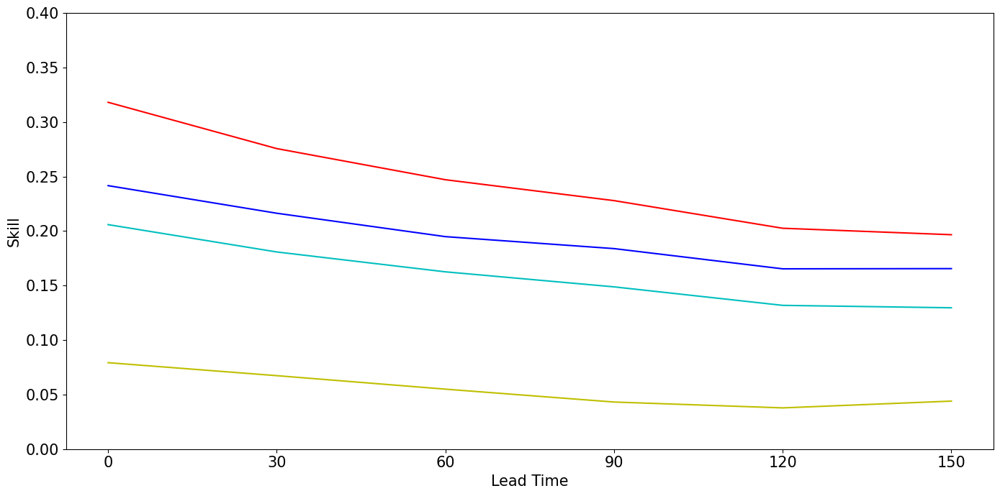

In [18]:
#################### BSS Plots ####################

%matplotlib inline

hazards = ['wind']#, 'hail', 'tornado']
length = 60
train_types = ['obs', 'obs_and_warnings']
ver_types = ['obs', 'obs_and_warnings']
radii = [39]#, 15]
leads = np.array([30, 60, 90, 120, 150, 180])

ps_version = 2
torp = False

use_avg_srs = True

if (ps_version == 2) and (not torp):
    model_type = 'wofs_psv2_no_torp'
elif (ps_version == 2) and (torp):
    model_type = 'wofs_psv2_with_torp'
elif (ps_version == 3) and (not torp):
    model_type = 'wofs_psv3_no_torp'
elif (ps_version == 3) and (torp):
    model_type = 'wofs_psv3_with_torp'

for train_radius in radii:
    ver_radius = train_radius
    fig, axs = plt.subplots(figsize=(14,7))
    for train_type in train_types:
        for ver_type in ver_types:
            #ver_type = train_type
            #fig, axs = plt.subplots(figsize = (14,7))
            #sup_title = 'SR Mapping Brier Skill Scores\nModel: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(model_type, train_type, train_radius, ver_type, ver_radius)
            #fig.suptitle(sup_title)
            
            #prob_fig, prob_axs = plt.subplots(figsize = (14,7))
            #sup_title = 'Raw Probability Brier Skill Scores\nModel: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(model_type, train_type, train_radius, ver_type, ver_radius)
            #prob_fig.suptitle(sup_title)
            
            for haz in hazards:
                color = get_haz_color(haz)
                if train_type == 'obs' and ver_type == 'obs_and_warnings':
                    style = '--'
                    color = 'b'
                elif train_type == 'obs_and_warnings' and ver_type == 'obs_and_warnings':
                    style = '-'
                    color = 'r'
                elif train_type == 'obs' and ver_type == 'obs':
                    style = '-'
                    color = 'c'
                else:
                    style = '-'
                    color = 'y'
                
                prob_bss_file, sr_bss_file = get_overall_bss_file(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
                prob_bss = np.load(prob_bss_file)
                sr_bss = np.load(sr_bss_file)
                
                #axs.plot(leads-30, sr_bss, color + style, label = haz.capitalize() + ' SR Map')
                
                axs.plot(leads-30, prob_bss, color, label = haz.capitalize() + ' Raw Probs')
                axs.set_xlabel('Lead Time', fontsize = 15)
                axs.set_ylabel('Skill', fontsize = 15)
                axs.set_xticks(leads-30)
                axs.tick_params(axis='both', which='major', labelsize=15)
                axs.tick_params(axis='both', which='minor', labelsize=8)
                axs.set_ylim([0,0.4])
                
                #axs.legend()
                
            fig.tight_layout()
            fig_dir, fig_fname = get_bss_fig_fname(model_type, train_type, ver_type, length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
            #utilities.save_data(fig_dir, fig_fname, fig, 'png')
            

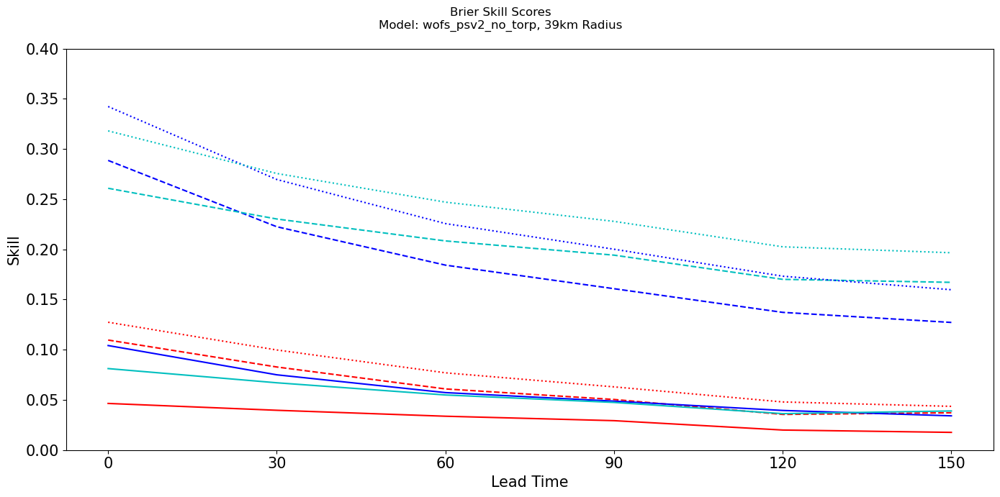

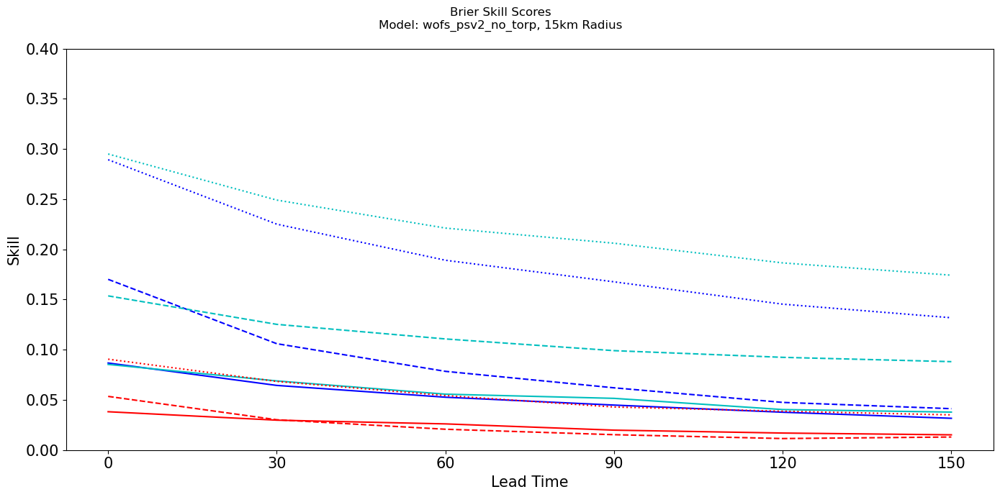

In [60]:
%matplotlib inline

#################### BSS Plots ####################

hazards = ['hail', 'wind', 'tornado']
length = 60
train_types = ['obs', 'obs_and_warnings']
ver_types = ['obs_and_warnings']
radii = [39, 15]
leads = np.array([30, 60, 90, 120, 150, 180])

ps_version = 2
torp = False

use_avg_srs = True

if (ps_version == 2) and (not torp):
    model_type = 'wofs_psv2_no_torp'
elif (ps_version == 2) and (torp):
    model_type = 'wofs_psv2_with_torp'
elif (ps_version == 3) and (not torp):
    model_type = 'wofs_psv3_no_torp'
elif (ps_version == 3) and (torp):
    model_type = 'wofs_psv3_with_torp'

for train_radius in radii:
    ver_radius = train_radius
    fig, axs = plt.subplots(figsize = (14,7))
    sup_title = 'Brier Skill Scores\nModel: %s, %skm Radius' %(model_type, train_radius)
    fig.suptitle(sup_title)
    for train_type in train_types:
        for ver_type in ver_types:
            #ver_type = train_type
            
            #prob_fig, prob_axs = plt.subplots(figsize = (14,7))
            #sup_title = 'Raw Probability Brier Skill Scores\nModel: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(model_type, train_type, train_radius, ver_type, ver_radius)
            #prob_fig.suptitle(sup_title)
            
            for haz in hazards:
                color = get_haz_color(haz)
                prob_bss_file, sr_bss_file = get_overall_bss_file(model_type, train_type, ver_type, haz, length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
                prob_bss = np.load(prob_bss_file)
                sr_bss = np.load(sr_bss_file)
                
                if train_type == 'obs':
                    axs.plot(leads-30, sr_bss, color + '--', label = haz.capitalize() + ' Obs SR Map')
                else:
                    axs.plot(leads-30, sr_bss, color + '-', label = haz.capitalize() + ' Obs+Warnings\nSR Map')
                    axs.plot(leads-30, prob_bss, color + ':', label = haz.capitalize() + 'Obs+Warnings\nRaw Probs')
                axs.set_xlabel('Lead Time', fontsize = 15)
                axs.set_ylabel('Skill', fontsize = 15)
                axs.set_xticks(leads-30)
                axs.tick_params(axis='both', which='major', labelsize=15)
                axs.tick_params(axis='both', which='minor', labelsize=8)
                axs.set_ylim([0,0.4])
                
                #axs.legend()
                
            fig.tight_layout()
            fig_dir, fig_fname = get_bss_fig_fname(model_type, train_type, ver_type, length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
            #utilities.save_data(fig_dir, fig_fname, fig, 'png')
            

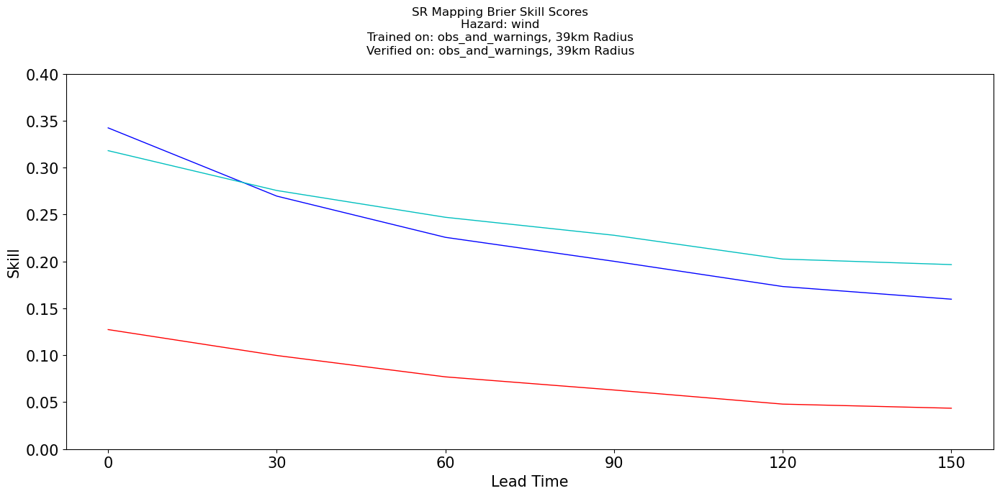

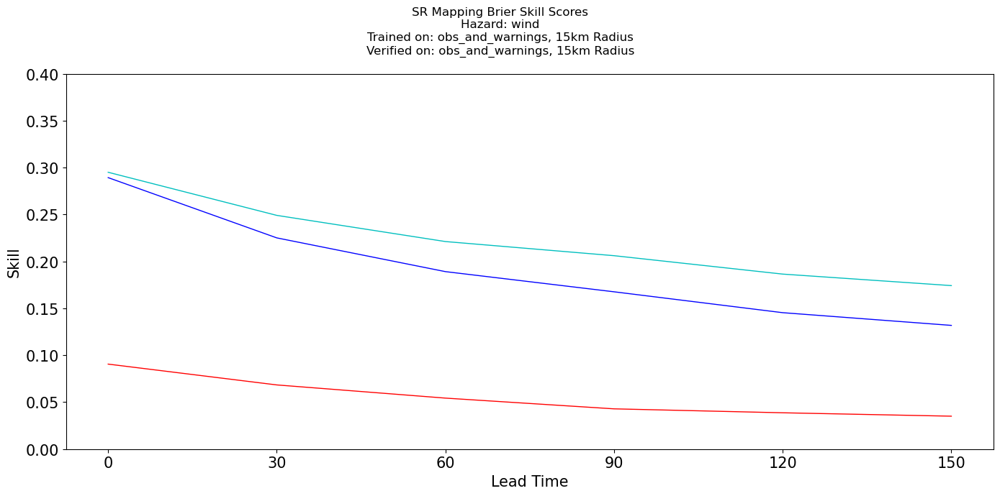

In [59]:
#################### BSS Plots Between Models ####################

haz = 'wind'
length = 60
train_types = ['obs_and_warnings']
ver_types = ['obs_and_warnings']
radii = [39, 15]
leads = np.array([30, 60, 90, 120, 150, 180])
models = ['wofs_psv2_no_torp']#, 'wofs_psv2_with_torp', 'wofs_psv3_no_torp', 'wofs_psv3_with_torp']

use_avg_srs = True

for train_radius in radii:
    ver_radius = train_radius
    for train_type in train_types:
        for ver_type in ver_types:
            ver_type = train_type
            fig, axs = plt.subplots(figsize = (14,7))
            sup_title = 'SR Mapping Brier Skill Scores\nHazard: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(haz, train_type, train_radius, ver_type, ver_radius)
            fig.suptitle(sup_title)
            
            #prob_fig, prob_axs = plt.subplots(figsize = (14,7))
            #sup_title = 'Raw Probability Brier Skill Scores\nModel: %s\nTrained on: %s, %skm Radius\nVerified on: %s, %skm Radius' %(model_type, train_type, train_radius, ver_type, ver_radius)
            #prob_fig.suptitle(sup_title)
            
            for model_type in models:
                for hazard in ['hail', 'wind', 'tornado']:
                    color = get_haz_color(hazard)
                    prob_bss_file, sr_bss_file = get_overall_bss_file(model_type, train_type, ver_type, hazard, length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
                    prob_bss = np.load(prob_bss_file)
                    sr_bss = np.load(sr_bss_file)
                    
                    if model_type == 'wofs_psv2_no_torp':
                        style = '-'
                        width = 1
                    elif model_type == 'wofs_psv2_with_torp':
                        style = '--'
                        width = 1
                    elif model_type == 'wofs_psv3_no_torp':
                        style = ':'
                        width = 1
                    else:
                        style = '-'
                        width = 3

                    #axs.plot(leads, sr_bss, color, label = model_type.capitalize() + ' SR Map')

                    axs.plot(leads-30, prob_bss, color + style, label = model_type.capitalize(), linewidth = width)
                    axs.set_xlabel('Lead Time', fontsize = 15)
                    axs.set_ylabel('Skill', fontsize = 15)
                    axs.set_xticks(leads-30)
                    axs.tick_params(axis='both', which='major', labelsize=15)
                    axs.tick_params(axis='both', which='minor', labelsize=8)
                    axs.set_ylim([0,0.4])

                    #axs.legend()
                
            fig.tight_layout()
            fig_dir, fig_fname = get_bss_fig_fname(model_type, train_type, ver_type, length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
            fig_fname = 'all_%s_models_%s_%skm_trained_%s_%skm_verified_%smin_avg_sr_bss_plot.png' %(haz, train_type, train_radius, ver_type, ver_radius, length)
            #utilities.save_data(fig_dir, fig_fname, fig, 'png')
                

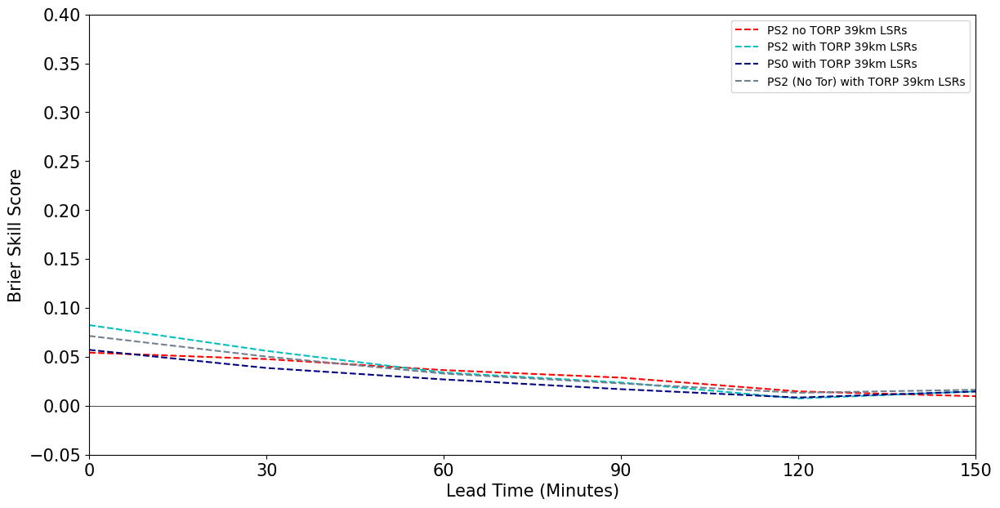

In [341]:
######## BSS Thesis Figs ########

hazard = 'tornado'
use_avg_srs = True
length = 60
train_radius = 39
ver_radius = 39
leads = [0, 30, 60, 90, 120, 150]

ps2nt15o_prob_bss_file, ps2nt15o_sr_bss_file = get_overall_bss_file('wofs_psv2_no_torp', 'obs', 'obs', hazard,\
                                                  length, 15, 15, use_avg_srs = use_avg_srs)
ps2nt39o_prob_bss_file, ps2nt39o_sr_bss_file = get_overall_bss_file('wofs_psv2_no_torp', 'obs', 'obs', hazard,\
                                                  length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
ps0wt39o_prob_bss_file, ps0wt39o_sr_bss_file = get_overall_bss_file('wofs_psv0_with_torp', 'obs', 'obs', hazard,\
                                                  length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
ps2wt39o_prob_bss_file, ps2wt39o_sr_bss_file = get_overall_bss_file('wofs_psv2_with_torp', 'obs', 'obs', hazard,\
                                                  length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
ps2NTwt39o_prob_bss_file, ps2NTwt39o_sr_bss_file = get_overall_bss_file('wofs_psv2NoTor_with_torp', 'obs', 'obs', hazard,\
                                                  length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
ps3nt39o_prob_bss_file, ps3nt39o_sr_bss_file = get_overall_bss_file('wofs_psv3_no_torp', 'obs', 'obs', hazard,\
                                                  length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
ps3nt39ow_prob_bss_file, ps3nt39ow_sr_bss_file = get_overall_bss_file('wofs_psv3_no_torp', 'obs_and_warnings',\
                                                                      'obs_and_warnings', hazard,\
                                                                      length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
ps3wt39o_prob_bss_file, ps3wt39o_sr_bss_file = get_overall_bss_file('wofs_psv3_with_torp', 'obs', 'obs', hazard,\
                                                  length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
ps3wt39ow_prob_bss_file, ps3wt39ow_sr_bss_file = get_overall_bss_file('wofs_psv3_with_torp', 'obs_and_warnings',\
                                                                      'obs_and_warnings', hazard,\
                                                                      length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
ps3wtf39ow_prob_bss_file, ps3wtf39ow_sr_bss_file = get_overall_bss_file('wofs_psv3_with_torp_filtered',\
                                                                        'obs_and_warnings', 'obs_and_warnings', hazard,\
                                                                        length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
ps3wtfnr39ow_prob_bss_file, ps3wtfnr39ow_sr_bss_file = get_overall_bss_file('wofs_psv3_with_torp_filtered_p_only',\
                                                                        'obs_and_warnings', 'obs_and_warnings', hazard,\
                                                                        length, train_radius, ver_radius, use_avg_srs = use_avg_srs)
ps3wtfnr39ow2h_prob_bss_file, ps3wtfnr39ow2h_sr_bss_file = get_overall_bss_file('wofs_psv3_with_torp_filtered_p_only',\
                                                                        'obs_and_warnings', 'obs_and_warnings', hazard,\
                                                                        120, train_radius, ver_radius, use_avg_srs = use_avg_srs)

ps2nt15o_prob_bss = np.load(ps2nt15o_prob_bss_file)
ps2nt39o_prob_bss = np.load(ps2nt39o_prob_bss_file)
ps2wt39o_prob_bss = np.load(ps2wt39o_prob_bss_file)
ps2NTwt39o_prob_bss = np.load(ps2NTwt39o_prob_bss_file)
ps0wt39o_prob_bss = np.load(ps0wt39o_prob_bss_file)
ps3nt39o_prob_bss = np.load(ps3nt39o_prob_bss_file)
ps3nt39ow_prob_bss = np.load(ps3nt39ow_prob_bss_file)
ps3wt39o_prob_bss = np.load(ps3wt39o_prob_bss_file)
ps3wt39ow_prob_bss = np.load(ps3wt39ow_prob_bss_file)
ps3wtf39ow_prob_bss = np.load(ps3wtf39ow_prob_bss_file)
ps3wtfnr39ow_prob_bss = np.load(ps3wtfnr39ow_prob_bss_file)
ps3wtfnr39ow2h_prob_bss = np.load(ps3wtfnr39ow2h_prob_bss_file)

fig, axs = plt.subplots(figsize = (14,7))
axs.plot([-30,180], [0,0], 'k', linewidth = 0.5)
#axs.plot(leads, ps2nt15o_prob_bss, 'r--', linewidth = 0.5, label = 'PS2 no TORP 15km LSRs')
axs.plot(leads, ps2nt39o_prob_bss, 'r--', label = 'PS2 no TORP 39km LSRs')
axs.plot(leads, ps2wt39o_prob_bss, 'c--', label = 'PS2 with TORP 39km LSRs')
axs.plot(leads, ps0wt39o_prob_bss, color = 'navy', linestyle = '--', label = 'PS0 with TORP 39km LSRs')
axs.plot(leads, ps2NTwt39o_prob_bss, color = 'slategray', linestyle = '--', label = 'PS2 (No Tor) with TORP 39km LSRs')
#axs.plot(leads, ps3nt39o_prob_bss, 'b--', label = 'PS3 no TORP 39km LSRs')
#axs.plot(leads, ps3nt39ow_prob_bss, 'b', label = 'PS2 no TORP 39km LSRs+Warnings')
#axs.plot(leads, ps3wt39o_prob_bss, 'm--', label = 'PS3 with TORP 39km LSRs')
#axs.plot(leads, ps3wt39ow_prob_bss, 'm', label = 'PS3 with TORP 39km LSRs+Warnings')
#axs.plot(leads, ps3wtf39ow_prob_bss, 'g', label = 'PS3 with Filtered TORP\n39km LSRs+Warnings')
#axs.plot(leads, ps3wtfnr39ow_prob_bss, 'orange', label = 'PS3 with Filtered TORP\n(No Radar) 39km LSRs+Warnings')
#axs.plot(leads[0:4], ps3wtfnr39ow2h_prob_bss[0:4], 'orange', linewidth = 2, label = '2hr PS3 with Filtered TORP\n(No Radar) 39km LSRs+Warnings')

axs.set_xlabel('Lead Time (Minutes)', fontsize = 15)
axs.set_ylabel('Brier Skill Score', fontsize = 15)
axs.set_xticks(leads)
axs.tick_params(axis='both', which='major', labelsize=15)
axs.tick_params(axis='both', which='minor', labelsize=8)
axs.set_ylim([-0.05,0.4])
axs.set_xlim([leads[0], leads[-1]])
axs.legend(loc = 'upper right', prop={'size': 10})

NameError: name 'fig_save_fname' is not defined

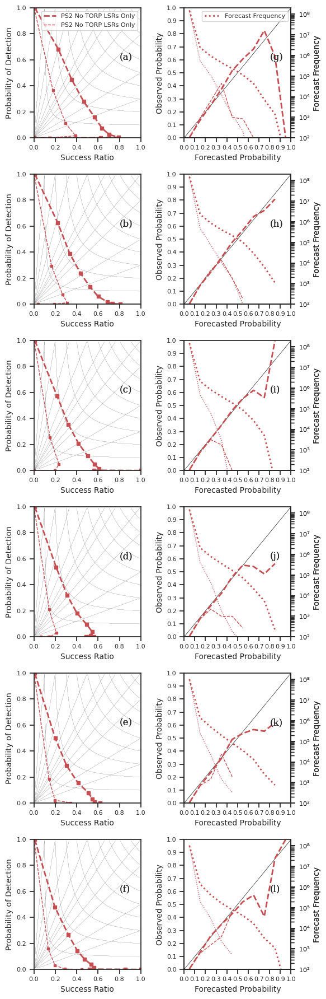

In [33]:
########### Rel/PD 12 panel subplot ##########

%matplotlib inline
xticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=8, weight='normal', stretch='normal')
yticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=8, weight='normal', stretch='normal')
legend_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=6, weight='normal', stretch='normal')

model_types = ['wofs_psv2_no_torp']
train_types = ['obs']#'obs_and_warnings']
prob_types = ['raw']#, 'avg_sr']
hazard = 'wind'
forecast_lengths = [60]#, 120]
train_radii = [39, 15]
leads = [30, 60, 90, 120, 150, 180]
use_avg_srs = True

if len(leads) == 6:
    fig, axs = plt.subplots(6,2,figsize = (6,18))
else:
    fig, axs = plt.subplots(4,2,figsize = (6,12))

xticks = np.array([0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65, 0.75, 0.85, 0.95])
positions_plotted = []
rel_lns = []
freq_lns = []
rel_legend_row = 0
rel_legend_col = 0

subplot_labels = ['(a)', '(b)', '(c)', '(d)', '(e)', '(f)', '(g)', '(h)', '(i)', '(j)', '(k)', '(l)']

fig_save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/Rel_PD_Figs'

#fig_save_fname = 'ps2_no_torp_15_v_39_%s_%s_rel_pd.png' %(hazard, train_types[0])
#fig_save_fname = 'ps2_no_vs_with_torp_%s_%s_rel_pd.png' %(hazard, train_types[0])
#fig_save_fname = 'ps3_no_vs_with_torp_%s_%s_rel_pd.png' %(hazard, train_types[0])
#fig_save_fname = 'ps2_vs_3_no_torp_%s_%s_rel_pd.png' %(hazard, train_types[0])
#fig_save_fname = 'ps2_vs_3_with_torp_%s_%s_rel_pd.png' %(hazard, train_types[0])
#fig_save_fname = 'ps2_no_torp_obs_vs_ps3_with_torp_obs_and_warnings_%s_rel_pd.png' %(hazard)
#fig_save_fname = 'ps0_vs_ps3_with_torp_%s_obs_and_warnings_rel_pd.png' %(hazard)
#fig_save_fname = 'ps2_no_torp_vs_ps3_with_torp_%s_%s_rel_pd.png' %(hazard, train_types[0])
#fig_save_fname = 'ps3_with_torp_1_vs_2_hour_%s_%s_rel_pd.png' %(hazard, train_types[0])
#fig_save_fname = 'ps3_with_torp_obs_vs_obs_and_warnings_%s_rel_pd.png' %(hazard)
#fig_save_fname = 'ps3_with_torp_vs_filtered_%s_%s_rel_pd.png' %(hazard, train_types[0])
#fig_save_fname = 'ps3_with_torp_vs_p_only_%s_%s_rel_pd.png' %(hazard, train_types[0])

#fig_save_fname = 'ps2_no_torp_obsw_raw_vs_sr_probs_%s_%s_rel_pd.png' %(hazard, train_types[0])

for model_type in model_types:
    for train_type in train_types:
        for prob_type in prob_types:
        
            #if model_type == 'wofs_psv2_no_torp':
            #    train_type = 'obs'
            #else:
            #    train_type = 'obs_and_warnings'
            ver_type = train_type

            for train_radius in train_radii:
                ver_radius = train_radius
                #sr_rel_scores = []
                #prob_rel_scores = []
                #climos = []
                for forecast_length in forecast_lengths:
                    for i in range(len(leads)):
                        lead = leads[i]
                        row_index = i

                        if lead+max(forecast_lengths) > 240:
                            continue

                        col_index = 0

                        color, linewidth, linestyle, fcst_freq_linestyle, pod_marker, marker_size =\
                        get_plot_style(model_type, train_type, train_radius, forecast_length, prob_type)

                        pd_fname = get_performance_diagram_file(model_type, train_type, ver_type, hazard,\
                                                                forecast_length, train_radius, ver_radius,
                                                                lead, use_avg_srs)
                        pd_data = np.load(pd_fname)
                        sr_thresholds = pd_data[0,:]
                        sr_pods = pd_data[1,:]
                        sr_srs = pd_data[2,:]
                        prob_thresholds = pd_data[3,:]
                        prob_pods = pd_data[4,:]
                        prob_srs = pd_data[5,:]

                        sr_thresholds = sr_thresholds[np.where(sr_thresholds > -1)]
                        sr_pods = sr_pods[np.where(sr_pods > -1)]
                        sr_srs = sr_srs[np.where(sr_srs > -1)]
                        prob_thresholds = prob_thresholds[np.where(prob_thresholds > -1)]
                        prob_pods = prob_pods[np.where(prob_pods > -1)]
                        prob_srs = prob_srs[np.where(prob_srs > -1)]

                        mesh_sr, mesh_pod, csis, bias = calc_csi_bias_contours()
                        
                        if prob_type == 'raw':
                            pd = axs[row_index, col_index].plot(prob_srs, prob_pods, color = color,\
                                                                linewidth = linewidth, linestyle = linestyle,\
                                                                marker = pod_marker, markersize = marker_size)
                        elif prob_type == 'avg_sr':
                            pd = axs[row_index, col_index].plot(sr_srs, sr_pods, color = color,\
                                                                linewidth = linewidth, linestyle = linestyle,\
                                                                marker = pod_marker, markersize = marker_size)
                        csi_lines = axs[row_index, col_index].contour(mesh_sr, mesh_pod, csis, np.arange(0.1, 1, 0.1),\
                                                                      colors = ['k'], linewidths = 0.07)
                        bias_lines = axs[row_index, col_index].contour(mesh_sr, mesh_pod, bias,\
                                                                       [0.3, 0.5, 0.8, 1, 1.3, 1.5, 2, 3, 5, 10],\
                                                                       colors = ['k'], linewidths = 0.07)
                        h2,_ = csi_lines.legend_elements()
                        h3,_ = bias_lines.legend_elements()
                        axs[row_index, col_index].set_xlim([0,1])
                        axs[row_index, col_index].set_ylim([0,1])
                        axs[row_index, col_index].set_xlabel('Success Ratio', fontname="DejaVu Sans", fontsize = 10)
                        axs[row_index, col_index].set_ylabel('Probability of Detection', fontname="DejaVu Sans", fontsize = 10)
                        axs[row_index, col_index].spines["top"].set_visible(True)
                        axs[row_index, col_index].spines["right"].set_visible(True)
                        axs[row_index, col_index].text(0.8, 0.6, subplot_labels[i+(col_index*len(axs[:,0]))])

                        for label in axs[row_index, col_index].get_xticklabels():
                            label.set_fontproperties(xticks_font)
                        for label in axs[row_index, col_index].get_yticklabels():
                            label.set_fontproperties(yticks_font)

                        lns = []
                        for l in rel_lns:
                            lns += l
                        labs = [l.get_label() for l in lns]
                        axs[rel_legend_row, rel_legend_col].legend(lns, labs, loc = 'upper right', prop=xticks_font)

                        lns = []
                        for l in freq_lns:
                            lns += l
                        labs = [l.get_label() for l in lns]
                        axs[rel_legend_row, 1].legend(lns, labs, prop=xticks_font, loc = 'upper right', handlelength=2.5)

                        ########################################################################

                        rel_data_fname = get_reliability_file(model_type, train_type, ver_type, hazard,\
                                                              forecast_length, train_radius, ver_radius, lead, use_avg_srs)
                        rel_data = np.load(rel_data_fname)
                        #sr_rel_scores.append(rel_data[0,0])
                        #prob_rel_scores.append(rel_data[0,1])
                        #climos.append(rel_data[0,2])
                        fcsts = rel_data[1,:]
                        sr_fcst_freq = rel_data[2,:]
                        sr_obs_freq = rel_data[3,:]
                        prob_fcst_freq = rel_data[4,:]
                        prob_obs_freq = rel_data[5,:]

                        sr_obs_freq = sr_obs_freq[np.where(sr_fcst_freq > 0)]
                        sr_fcsts = fcsts[np.where(sr_fcst_freq > 0)]
                        sr_xticks = xticks[np.where(sr_fcst_freq > 0)]
                        sr_fcst_freq = sr_fcst_freq[np.where(sr_fcst_freq > 0)]

                        prob_obs_freq = prob_obs_freq[np.where(prob_fcst_freq > 0)]
                        prob_fcsts = fcsts[np.where(prob_fcst_freq > 0)]
                        prob_xticks = xticks[np.where(prob_fcst_freq > 0)]
                        prob_fcst_freq = prob_fcst_freq[np.where(prob_fcst_freq > 0)]

                        col_index = 1

                        if not ((row_index, col_index) in positions_plotted):
                            a = axs[row_index, col_index].plot([0,1], [0,1], 'k', linewidth = 0.5, label = 'Perfect Reliability')
                            #if (row_index == rel_legend_row):
                            #    rel_lns.append(a)
                            positions_plotted.append((row_index, col_index))
                        
                        if prob_type == 'raw':
                            b = axs[row_index, col_index].plot(prob_fcsts, prob_obs_freq, color=color, linewidth = linewidth,\
                                                                linestyle = linestyle, label = '%s %s'\
                                                               #%(int(forecast_length/60)))
                                                               %(get_model_label(model_type[5:]), get_train_type_label(train_type)))
                        elif prob_type == 'avg_sr':
                            b = axs[row_index, col_index].plot(sr_fcsts, sr_obs_freq, color=color, linewidth = linewidth,\
                                                                linestyle = linestyle, label = 'SR Mapped Probs')#\
                                                               #%(int(forecast_length/60)))
                                                               #%(get_model_label(model_type[5:]), get_train_type_label(train_type)))
                        if (row_index == rel_legend_row):
                            rel_lns.append(b)

                        ax2 = axs[row_index, col_index].twinx()
                        ax2.set_yscale('log')
                        ax2.set_ylim([10**2, 10**8.3])
                        ax2.set_ylabel('Forecast Frequency', fontname="DejaVu Sans", fontsize = 10)

                        c = ax2.plot(prob_xticks, prob_fcst_freq, color=color, linewidth = linewidth,\
                                      linestyle = fcst_freq_linestyle, label = 'Forecast Frequency')
                        if len(freq_lns) == 0:
                            freq_lns.append(c)
                        #if (row_index == rel_legend_row):
                        #    rel_lns.append(c)
                        ax2.tick_params(axis = 'y', labelsize = 8)
                        ax2.spines["right"].set_visible(True)

                        for label in axs[row_index, col_index].get_xticklabels():
                            label.set_fontproperties(xticks_font)
                        for label in axs[row_index, col_index].get_yticklabels():
                            label.set_fontproperties(yticks_font)
                        for label in ax2.get_yticklabels():
                            label.set_fontproperties(yticks_font)

                        axs[row_index, col_index].set_xlim([0,1])
                        axs[row_index, col_index].set_ylim([0,1])
                        axs[row_index, col_index].set_xlabel('Forecasted Probability', fontname="DejaVu Sans", fontsize = 10)
                        axs[row_index, col_index].set_xticks(np.arange(0,1.01,0.1))
                        axs[row_index, col_index].set_yticks(np.arange(0,1.01,0.1))
                        axs[row_index, col_index].set_ylabel('Observed Probability', fontname="DejaVu Sans", fontsize = 10)
                        axs[row_index, col_index].spines["top"].set_visible(True)
                        axs[row_index, col_index].text(0.8, 0.6, subplot_labels[i+(col_index*len(axs[:,0]))])



fig.tight_layout()
fig.savefig('%s/%s' %(fig_save_dir, fig_save_fname))

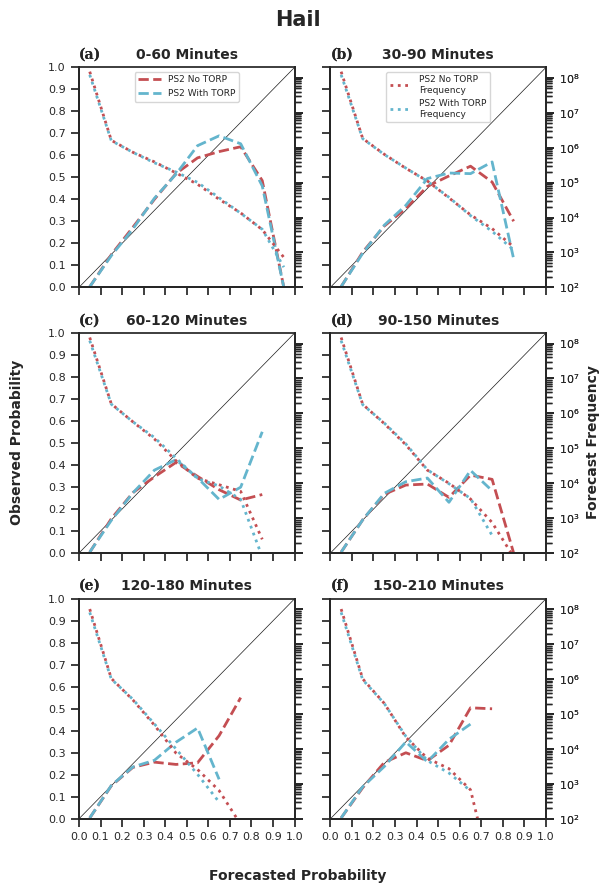

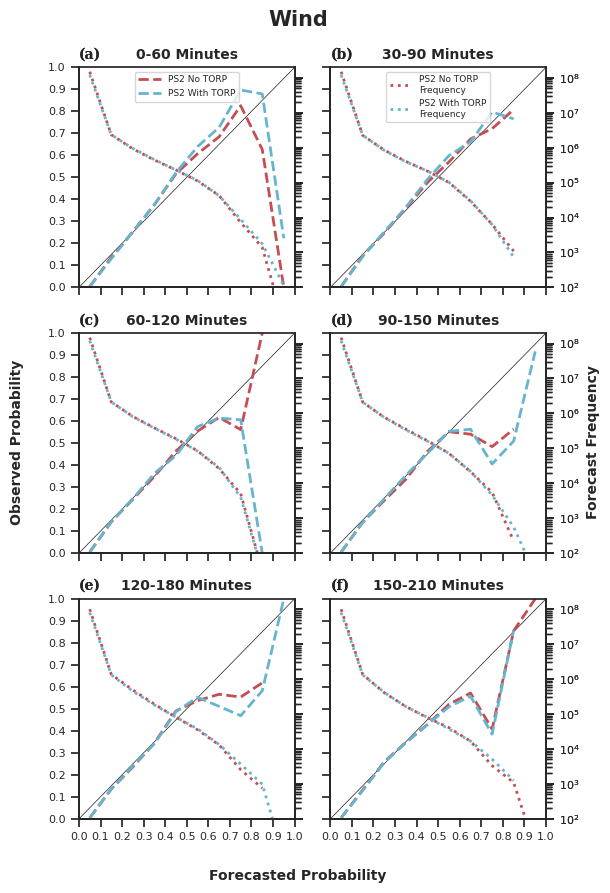

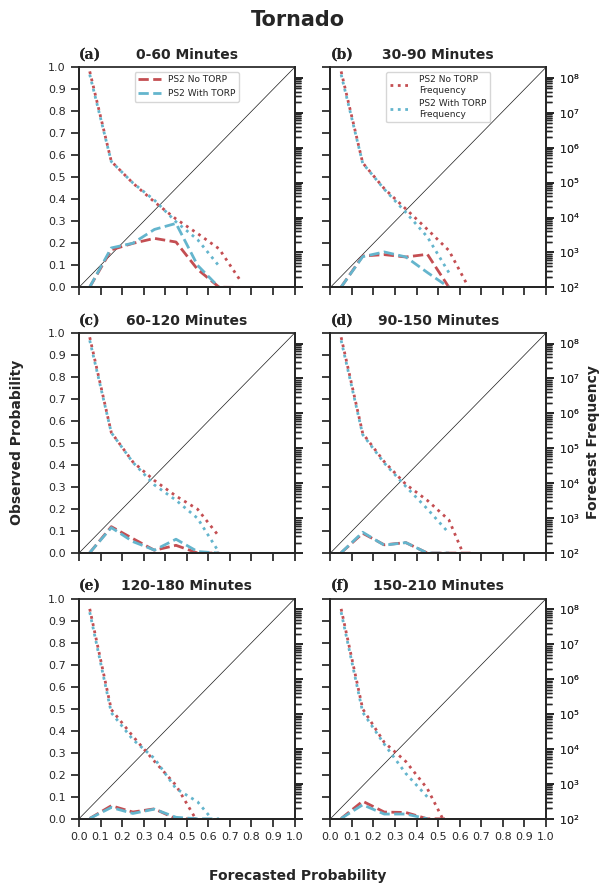

In [82]:
########### Reliability 6 panel subplot ##########

%matplotlib inline
xticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=8, weight='normal', stretch='normal')
yticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=8, weight='normal', stretch='normal')
legend_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=6.5, weight='normal', stretch='normal')

model_types = ['wofs_psv2_no_torp', 'wofs_psv2_with_torp']
train_types = ['obs']
prob_types = ['raw']#, 'avg_sr']
hazards = ['hail', 'wind', 'tornado']
forecast_lengths = [60]#, 120]
train_radii = [39]#, 15]
leads = [30, 60, 90, 120, 150, 180]
use_avg_srs = True

fig_save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/Rel_Figs'

for hazard in hazards:
    if len(leads) == 6:
        fig, axs = plt.subplots(3,2,figsize = (6,9))
    else:
        fig, axs = plt.subplots(2,2,figsize = (6,6))

    xticks = np.array([0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65, 0.75, 0.85, 0.95])
    positions_plotted = []
    rel_lns = []
    freq_lns = []
    rel_legend_row = 0
    rel_legend_col = 0

    subplot_labels = ['(a)', '(b)', '(c)', '(d)', '(e)', '(f)']#, '(g)', '(h)', '(i)', '(j)', '(k)', '(l)']

    #fig_save_fname = 'ps2_no_torp_15_v_39_%s_%s_rel.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_no_vs_with_torp_%s_%s_rel.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_no_vs_with_torp_%s_%s_rel.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_vs_3_no_torp_%s_%s_rel.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_vs_3_with_torp_%s_%s_rel.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_no_torp_obs_vs_ps3_with_torp_obs_and_warnings_%s_rel.png' %(hazard)
    #fig_save_fname = 'ps0_vs_ps3_with_torp_%s_obs_and_warnings_rel.png' %(hazard)
    #fig_save_fname = 'ps2_no_torp_vs_ps3_with_torp_%s_%s_rel.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_with_torp_1_vs_2_hour_%s_%s_rel.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_with_torp_obs_vs_obs_and_warnings_%s_rel.png' %(hazard)
    #fig_save_fname = 'ps3_with_torp_vs_filtered_%s_%s_rel.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_with_torp_vs_p_only_%s_%s_rel.png' %(hazard, train_types[0])

    #fig_save_fname = 'ps2_no_torp_obsw_raw_vs_sr_probs_%s_%s_rel.png' %(hazard, train_types[0])
    
    fig_save_fname = 'ps2_no_vs_with_torp_%s_%s_rel.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_vs_3_with_torp_%s_%s_rel.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_no_torp_vs_ps3_with_torp_%s_%s_rel.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_with_torp_obs_vs_obs_and_warnings_%s_rel.png' %(hazard)
    #fig_save_fname = 'ps0_vs_ps3_with_torp_%s_obs_and_warnings_rel.png' %(hazard)

    for model_type in model_types:
        for train_type in train_types:
            for prob_type in prob_types:

                #if model_type == 'wofs_psv2_no_torp':
                #    train_type = 'obs'
                #else:
                #    train_type = 'obs_and_warnings'
                ver_type = train_type

                for train_radius in train_radii:
                    ver_radius = train_radius
                    
                    #sr_rel_scores = []
                    #prob_rel_scores = []
                    #climos = []
                    for forecast_length in forecast_lengths:
                        
                        #line_label = '%s-Hour Window' %(int(forecast_length/60))
                        line_label = '%s' %(get_model_label(model_type[5:]))
                        #line_label = '%s' %(get_train_type_label(train_type))
                        
                        for i in range(len(leads)):
                            lead = leads[i]
                            row_index = int(np.floor(i/2))
                            col_index = i % 2

                            if lead+max(forecast_lengths) > 240:
                                continue

                            color, linewidth, linestyle, fcst_freq_linestyle, pod_marker, marker_size =\
                            get_plot_style(model_type, train_type, train_radius, forecast_length, prob_type)


                            ########################################################################

                            rel_data_fname = get_reliability_file(model_type, train_type, ver_type, hazard,\
                                                                  forecast_length, train_radius, ver_radius, lead, use_avg_srs)
                            rel_data = np.load(rel_data_fname)
                            #sr_rel_scores.append(rel_data[0,0])
                            #prob_rel_scores.append(rel_data[0,1])
                            #climos.append(rel_data[0,2])
                            fcsts = rel_data[1,:]
                            sr_fcst_freq = rel_data[2,:]
                            sr_obs_freq = rel_data[3,:]
                            prob_fcst_freq = rel_data[4,:]
                            prob_obs_freq = rel_data[5,:]

                            sr_obs_freq = sr_obs_freq[np.where(sr_fcst_freq > 0)]
                            sr_fcsts = fcsts[np.where(sr_fcst_freq > 0)]
                            sr_xticks = xticks[np.where(sr_fcst_freq > 0)]
                            sr_fcst_freq = sr_fcst_freq[np.where(sr_fcst_freq > 0)]

                            prob_obs_freq = prob_obs_freq[np.where(prob_fcst_freq > 0)]
                            prob_fcsts = fcsts[np.where(prob_fcst_freq > 0)]
                            prob_xticks = xticks[np.where(prob_fcst_freq > 0)]
                            prob_fcst_freq = prob_fcst_freq[np.where(prob_fcst_freq > 0)]

                            if not ((row_index, col_index) in positions_plotted):
                                a = axs[row_index, col_index].plot([0,1], [0,1], 'k', linewidth = 0.5, label = 'Perfect Reliability')
                                #if (row_index == rel_legend_row):
                                #    rel_lns.append(a)
                                positions_plotted.append((row_index, col_index))

                            if prob_type == 'raw':
                                b = axs[row_index, col_index].plot(prob_fcsts, prob_obs_freq, color=color, linewidth = linewidth,\
                                                                    linestyle = linestyle, label = line_label)
                            elif prob_type == 'avg_sr':
                                b = axs[row_index, col_index].plot(sr_fcsts, sr_obs_freq, color=color, linewidth = linewidth,\
                                                                    linestyle = linestyle, label = 'SR Mapped Probs')#\
                                                                   #%(int(forecast_length/60)))
                                                                   #%(get_model_label(model_type[5:]), get_train_type_label(train_type)))
                            if (row_index == rel_legend_row) and (i == 0):
                                rel_lns.append(b)

                            ax2 = axs[row_index, col_index].twinx()
                            ax2.set_yscale('log')
                            ax2.set_ylim([10**2, 10**8.3])
                            if col_index == 0:
                                for ylabel_i in ax2.get_yticklabels():
                                    ylabel_i.set_visible(False)
                            #ax2.set_ylabel('Forecast Frequency', fontname="DejaVu Sans", fontsize = 10)

                            c = ax2.plot(prob_xticks, prob_fcst_freq, color=color, linewidth = linewidth,\
                                          linestyle = fcst_freq_linestyle, label = '%s\nFrequency' %(line_label))
                            if (row_index == rel_legend_row) and (i == 0):
                                freq_lns.append(c)
                            #if (row_index == rel_legend_row):
                            #    rel_lns.append(c)
                            ax2.tick_params(axis = 'y', labelsize = 8)
                            ax2.spines["right"].set_visible(True)

                            for label in axs[row_index, col_index].get_xticklabels():
                                label.set_fontproperties(xticks_font)
                            for label in axs[row_index, col_index].get_yticklabels():
                                label.set_fontproperties(yticks_font)
                            for label in ax2.get_yticklabels():
                                label.set_fontproperties(yticks_font)
                            if 120 in forecast_lengths:
                                if row_index < 1:
                                    for xlabel_i in axs[row_index, col_index].get_xticklabels():
                                        xlabel_i.set_visible(False)
                            else:
                                if row_index < 2:
                                    for xlabel_i in axs[row_index, col_index].get_xticklabels():
                                        xlabel_i.set_visible(False)
                            
                            if col_index == 1:
                                for ylabel_i in axs[row_index, col_index].get_yticklabels():
                                    ylabel_i.set_visible(False)
                            
                            if 120 in forecast_lengths:
                                axs[row_index, col_index].set_title('%s Minute Lead Time' %(lead-30), fontname="DejaVu Sans", fontsize = 10, weight = 'bold')
                            else:
                                axs[row_index, col_index].set_title('%s-%s Minutes' %(lead-30, forecast_length+lead-30), fontname="DejaVu Sans", fontsize = 10, weight = 'bold')
                            axs[row_index, col_index].set_xlim([0,1])
                            axs[row_index, col_index].set_ylim([0,1])
                            #axs[row_index, col_index].set_xlabel('Forecasted Probability', fontname="DejaVu Sans", fontsize = 10)
                            axs[row_index, col_index].set_xticks(np.arange(0,1.01,0.1))
                            axs[row_index, col_index].set_yticks(np.arange(0,1.01,0.1))
                            #axs[row_index, col_index].set_ylabel('Observed Probability', fontname="DejaVu Sans", fontsize = 10)
                            axs[row_index, col_index].spines["top"].set_visible(True)
                            axs[row_index, col_index].text(0, 1.04, subplot_labels[i], weight = 'bold', fontsize = 10)

                            lns = []
                            for l in freq_lns:
                                lns += l
                            labs = [l.get_label() for l in lns]
                            axs[rel_legend_row, 1].legend(lns, labs, prop=legend_font, loc = 'upper center', handlelength=2.5)
                            
                            lns = []
                            for l in rel_lns:
                                lns += l
                            labs = [l.get_label() for l in lns]
                            axs[rel_legend_row, 0].legend(lns, labs, prop=legend_font, loc = 'upper center', handlelength=2.5)

                            
    fig.supxlabel('Forecasted Probability', fontname="DejaVu Sans", fontsize = 10, weight = 'bold')
    fig.supylabel('Observed Probability', fontname="DejaVu Sans", fontsize = 10, weight = 'bold')
    fig.suptitle('%s' %(hazard.capitalize()), fontname="DejaVu Sans", fontsize = 15, weight = 'bold')
    fig.tight_layout()
    fig.text(0.98, 0.5, 'Forecast Frequency', fontname="DejaVu Sans", fontsize = 10, va='center', rotation='vertical', weight = 'bold')
    fig.savefig('%s/%s' %(fig_save_dir, fig_save_fname))

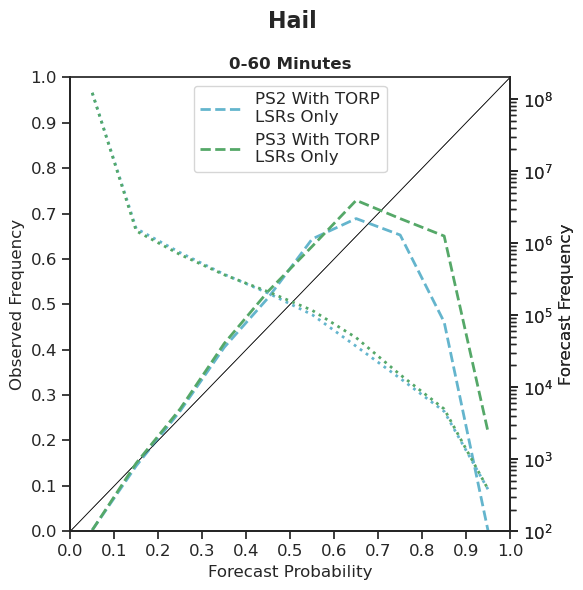

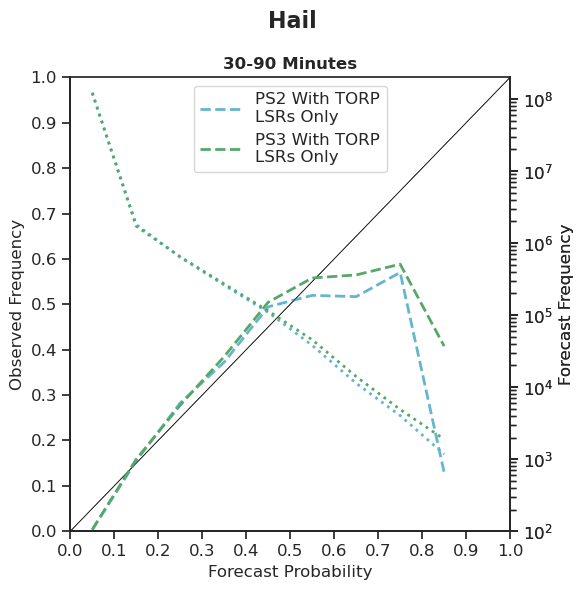

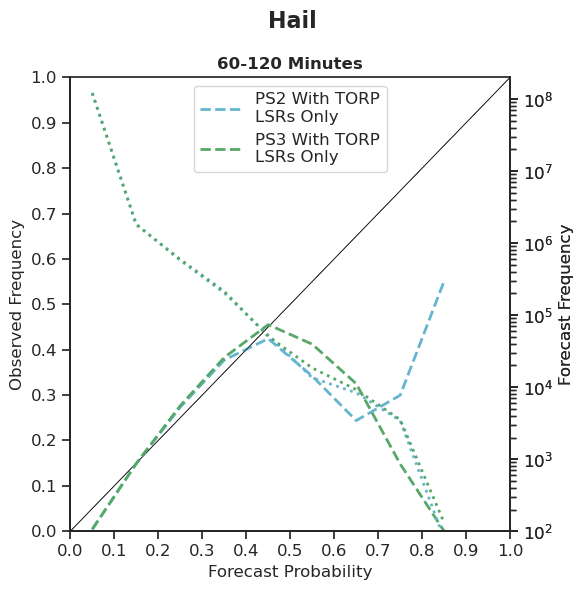

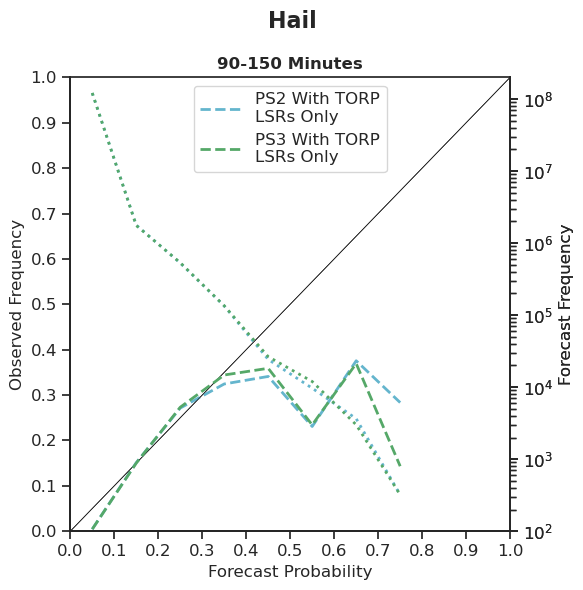

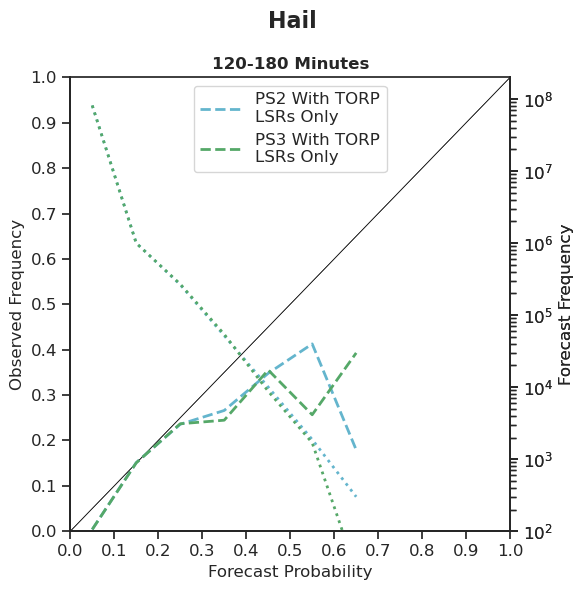

...

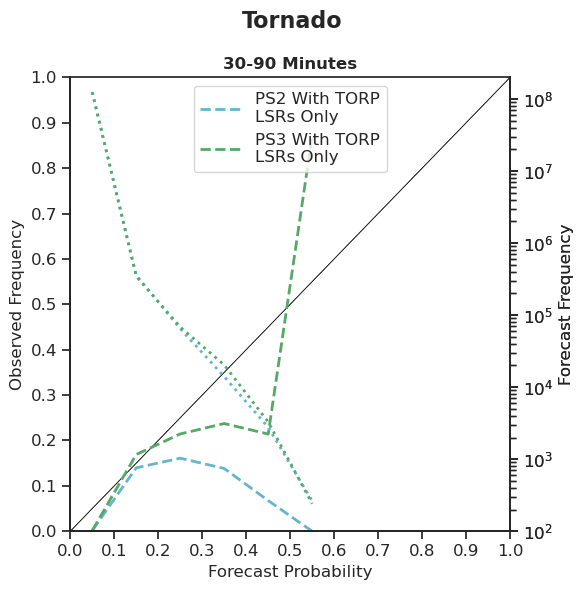

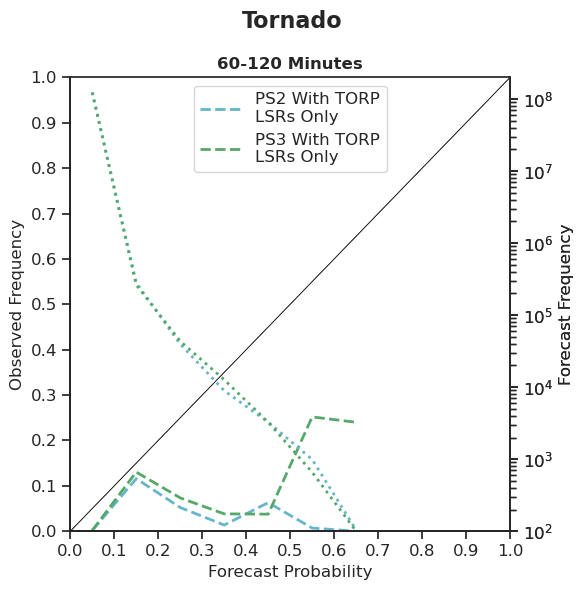

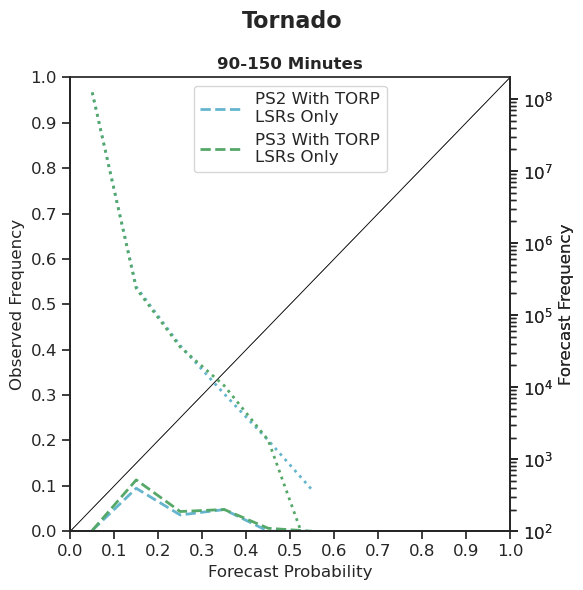

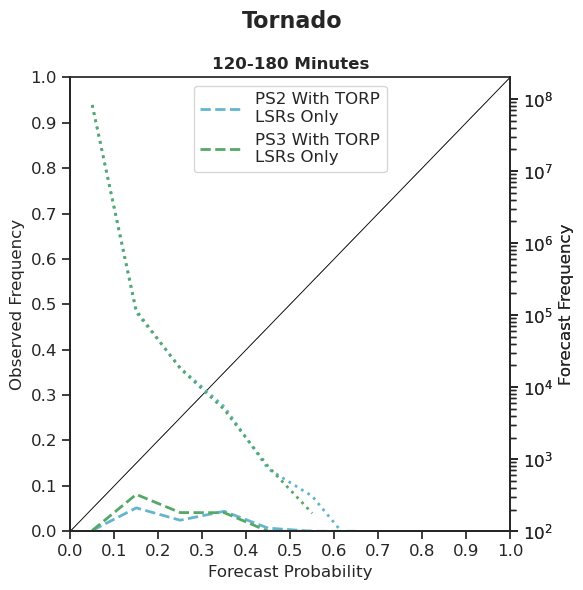

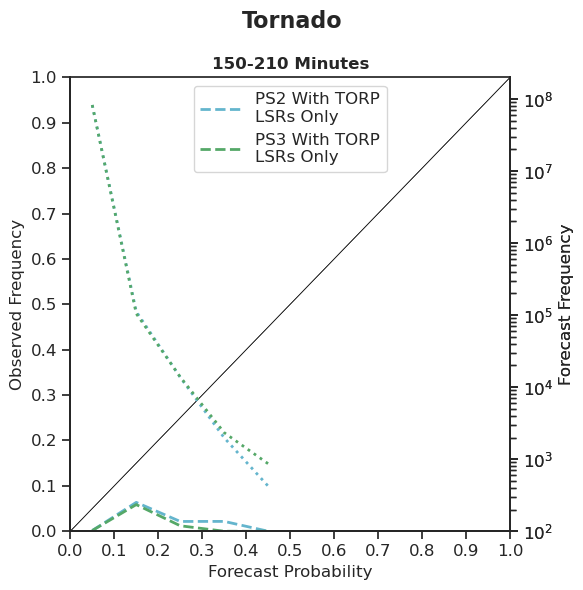

In [31]:
########### Reliability GIFs ##########

%matplotlib inline
xticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=12, weight='normal', stretch='normal')
yticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=12, weight='normal', stretch='normal')
legend_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=12, weight='normal', stretch='normal')

model_types = ['wofs_psv2_with_torp', 'wofs_psv3_with_torp']
train_types = ['obs']#, 'obs_and_warnings']
prob_types = ['raw']#, 'avg_sr']
hazards = ['hail', 'wind', 'tornado']
forecast_lengths = [60]#, 120]#, 120]
train_radii = [39]#, 15]
leads = [30, 60, 90, 120, 150, 180]
use_avg_srs = True

fig_save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/Rel_GIFs'

for hazard in hazards:

    xticks = np.array([0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65, 0.75, 0.85, 0.95])
    gif_fig_list = []

    #subplot_labels = ['(a)', '(b)', '(c)', '(d)', '(e)', '(f)']#, '(g)', '(h)', '(i)', '(j)', '(k)', '(l)']

    #fig_save_fname = 'ps2_no_torp_15_v_39_%s_%s_rel' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_no_vs_with_torp_%s_%s_rel' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_no_vs_with_torp_%s_%s_rel' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_vs_3_no_torp_%s_%s_rel' %(hazard, train_types[0])
    fig_save_fname = 'ps2_vs_3_with_torp_%s_%s_rel' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_no_torp_obs_vs_ps3_with_torp_obs_and_warnings_%s_rel' %(hazard)
    #fig_save_fname = 'ps0_vs_ps3_with_torp_%s_obs_and_warnings_rel' %(hazard)
    #fig_save_fname = 'ps2_no_torp_vs_ps3_with_torp_%s_%s_rel' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_with_torp_1_vs_2_hour_%s_%s_rel' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_with_torp_obs_vs_obs_and_warnings_%s_rel' %(hazard)
    #fig_save_fname = 'ps3_with_torp_vs_filtered_%s_%s_rel' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_with_torp_vs_p_only_%s_%s_rel' %(hazard, train_types[0])

    #fig_save_fname = 'ps2_no_torp_obsw_raw_vs_sr_probs_%s_%s_rel.png' %(hazard, train_types[0])

    for i in range(len(leads)):
        fig, ax = plt.subplots(1,1,figsize = (6,6))
        rel_lns = []
        freq_lns = []
        for train_type in train_types:
            for prob_type in prob_types:

                #if model_type == 'wofs_psv2_no_torp':
                #    train_type = 'obs'
                #else:
                #    train_type = 'obs_and_warnings'
                ver_type = train_type

                for forecast_length in forecast_lengths:
                    
                    #sr_rel_scores = []
                    #prob_rel_scores = []
                    #climos = []
                    for train_radius in train_radii:
                        ver_radius = train_radius
                        
                        for model_type in model_types:
                            
                            #line_label = '%s-Hour Window' %(int(forecast_length/60))
                            #line_label = '%s\n%skm LSRs' %(get_model_label(model_type[5:]), ver_radius)
                            line_label = '%s\n%s' %(get_model_label(model_type[5:]), get_train_type_label(train_type))
                            
                            lead = leads[i]
                            row_index = int(np.floor(i/2))
                            col_index = i % 2

                            if lead+max(forecast_lengths) > 240:
                                continue

                            color, linewidth, linestyle, fcst_freq_linestyle, pod_marker, marker_size =\
                            get_plot_style(model_type, train_type, train_radius, forecast_length, prob_type)
                            
                            if model_type == 'wofs_psv3_with_torp':
                                color = 'g'
                            
                            ########################################################################

                            rel_data_fname = get_reliability_file(model_type, train_type, ver_type, hazard,\
                                                                  forecast_length, train_radius, ver_radius, lead, use_avg_srs)
                            rel_data = np.load(rel_data_fname)
                            #sr_rel_scores.append(rel_data[0,0])
                            #prob_rel_scores.append(rel_data[0,1])
                            #climos.append(rel_data[0,2])
                            fcsts = rel_data[1,:]
                            sr_fcst_freq = rel_data[2,:]
                            sr_obs_freq = rel_data[3,:]
                            prob_fcst_freq = rel_data[4,:]
                            prob_obs_freq = rel_data[5,:]

                            sr_obs_freq = sr_obs_freq[np.where(sr_fcst_freq > 0)]
                            sr_fcsts = fcsts[np.where(sr_fcst_freq > 0)]
                            sr_xticks = xticks[np.where(sr_fcst_freq > 0)]
                            sr_fcst_freq = sr_fcst_freq[np.where(sr_fcst_freq > 0)]

                            prob_obs_freq = prob_obs_freq[np.where(prob_fcst_freq > 0)]
                            prob_fcsts = fcsts[np.where(prob_fcst_freq > 0)]
                            prob_xticks = xticks[np.where(prob_fcst_freq > 0)]
                            prob_fcst_freq = prob_fcst_freq[np.where(prob_fcst_freq > 0)]

                            a = ax.plot([0,1], [0,1], 'k', linewidth = 0.5, label = 'Perfect Reliability')

                            if prob_type == 'raw':
                                b = ax.plot(prob_fcsts, prob_obs_freq, color=color, linewidth = linewidth,\
                                                                    linestyle = linestyle, label = line_label)
                            elif prob_type == 'avg_sr':
                                b = ax.plot(sr_fcsts, sr_obs_freq, color=color, linewidth = linewidth,\
                                                                    linestyle = linestyle, label = 'SR Mapped Probs')#\
                                                                   #%(int(forecast_length/60)))
                                                                   #%(get_model_label(model_type[5:]), get_train_type_label(train_type)))
                            rel_lns.append(b)

                            ax2 = ax.twinx()
                            ax2.set_yscale('log')
                            ax2.set_ylim([10**2, 10**8.3])
                            
                            ax2_top_line = [((10**4) + (5*10**4)), ((10**4) + (5*10**4))]
                            ax2_bottom_line = [(10**4), (10**4)]
                            ax2_xs = [0, 1]
                            #ax2.fill_between(ax2_xs, ax2_bottom_line, ax2_top_line, color = 'y', alpha = 0.25)
                            ax2.set_ylabel('Forecast Frequency', fontname="DejaVu Sans", fontsize = 12)
                            ax.set_ylabel('Observed Frequency', fontname="DejaVu Sans", fontsize = 12)
                            ax.set_xlabel('Forecast Probability', fontname="DejaVu Sans", fontsize = 12)

                            c = ax2.plot(prob_xticks, prob_fcst_freq, color=color, linewidth = linewidth,\
                                          linestyle = fcst_freq_linestyle, label = 'Forecast Frequency')
                            freq_lns.append(c)
                            #if (row_index == rel_legend_row):
                            #    rel_lns.append(c)
                            ax2.tick_params(axis = 'y', labelsize = 8)
                            ax2.spines["right"].set_visible(True)

                            for label in ax.get_xticklabels():
                                label.set_fontproperties(xticks_font)
                            for label in ax.get_yticklabels():
                                label.set_fontproperties(yticks_font)
                            for label in ax2.get_yticklabels():
                                label.set_fontproperties(yticks_font)
                            
                            
                            if 120 in forecast_lengths:
                                ax.set_title('%s Minute Lead Time' %(lead-30), fontname="DejaVu Sans", fontsize = 12, weight = 'bold')
                            else:
                                ax.set_title('%s-%s Minutes' %(lead-30, forecast_length+lead-30), fontname="DejaVu Sans", fontsize = 12, weight = 'bold')
                            ax.set_xlim([0,1])
                            ax.set_ylim([0,1])
                            #axs[row_index, col_index].set_xlabel('Forecasted Probability', fontname="DejaVu Sans", fontsize = 10)
                            ax.set_xticks(np.arange(0,1.01,0.1))
                            ax.set_yticks(np.arange(0,1.01,0.1))
                            #axs[row_index, col_index].set_ylabel('Observed Probability', fontname="DejaVu Sans", fontsize = 10)
                            ax.spines["top"].set_visible(True)

                            lns = []
                            for l in freq_lns:
                                lns += l
                            labs = [l.get_label() for l in lns]
                            ax.legend(lns, labs, prop=legend_font, loc = 'upper center', handlelength=2.5)
                            
                            lns = []
                            for l in rel_lns:
                                lns += l
                            labs = [l.get_label() for l in lns]
                            ax.legend(lns, labs, prop=legend_font, loc = 'upper center', handlelength=2.5)

                fig.suptitle('%s' %(hazard.capitalize()), fontname="DejaVu Sans", fontsize = 16, weight = 'bold')
                fig.tight_layout()
                
                save_fname = '%s_%s-%smin.png' %(fig_save_fname, lead-30, lead+forecast_length-30)
                fig.savefig('%s/%s' %(fig_save_dir, save_fname))
                gif_fig_list.append('%s/%s' %(fig_save_dir, save_fname))
    
    images = []
    gif_fname = '%s.gif' %(fig_save_fname)
    for filename in gif_fig_list:
        images.append(iio.imread(filename))
    iio.imwrite('%s/%s' %(fig_save_dir, gif_fname), images, duration = 750, loop = 0)

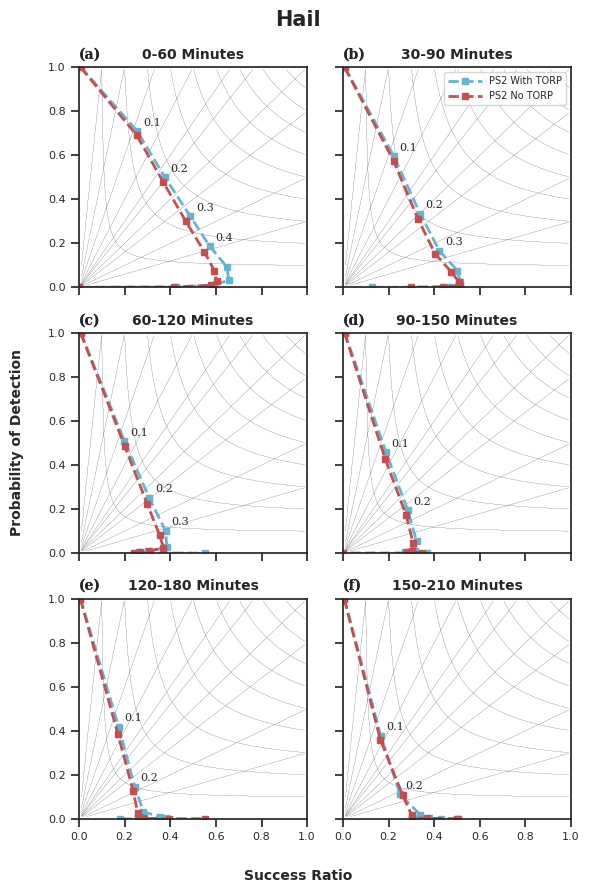

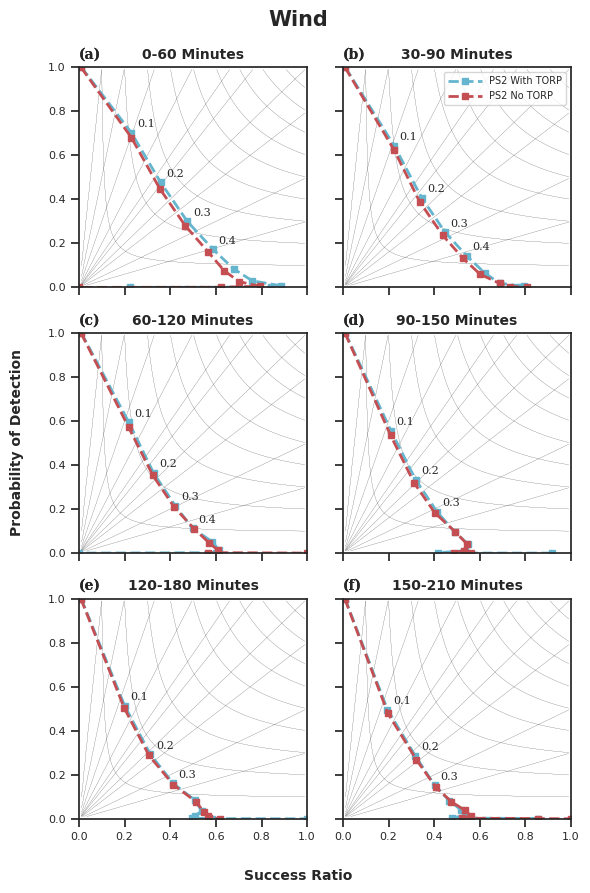

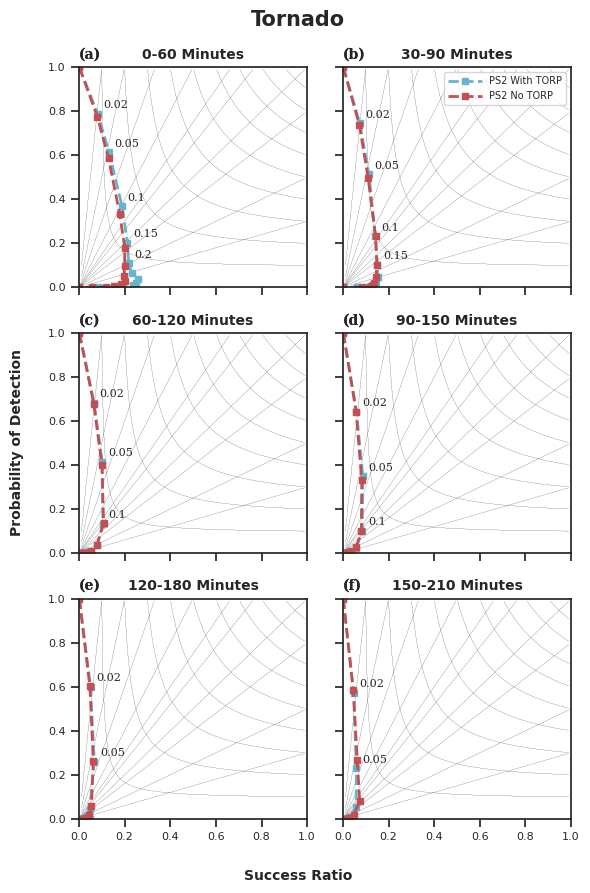

In [111]:
########### PD 6 panel subplot ##########

%matplotlib inline
xticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=8, weight='normal', stretch='normal')
yticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=8, weight='normal', stretch='normal')
legend_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=7, weight='normal', stretch='normal')

model_types = ['wofs_psv2_with_torp', 'wofs_psv2_no_torp']
train_types = ['obs']
prob_types = ['raw']#, 'avg_sr']
hazards = ['hail', 'wind', 'tornado']
forecast_lengths = [60]#, 120]
train_radii = [39]#, 15]
leads = [30, 60, 90, 120, 150, 180]
use_avg_srs = True

fig_save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/PD_Figs'

for hazard in hazards:
    if len(leads) == 6:
        fig, axs = plt.subplots(3,2,figsize = (6,9))
    else:
        fig, axs = plt.subplots(2,2,figsize = (6,6))

    xticks = np.array([0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65, 0.75, 0.85, 0.95])
    positions_plotted = []
    rel_lns = []
    freq_lns = []
    rel_legend_row = 0
    rel_legend_col = 1
    
    if 120 in forecast_lengths:
        subplot_labels = ['(a)', '(b)', '(c)', '(d)']
    else:
        subplot_labels = ['(a)', '(b)', '(c)', '(d)', '(e)', '(f)']

    #fig_save_fname = 'ps2_no_torp_15_v_39_%s_%s_pd.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_no_vs_with_torp_%s_%s_pd.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_no_vs_with_torp_%s_%s_pd.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_vs_3_no_torp_%s_%s_pd.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_vs_3_with_torp_%s_%s_pd.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_no_torp_obs_vs_ps3_with_torp_obs_and_warnings_%s_pd.png' %(hazard)
    #fig_save_fname = 'ps0_vs_ps3_with_torp_%s_obs_and_warnings_pd.png' %(hazard)
    #fig_save_fname = 'ps2_no_torp_vs_ps3_with_torp_%s_%s_pd.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_with_torp_1_vs_2_hour_%s_%s_pd.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_with_torp_obs_vs_obs_and_warnings_%s_pd.png' %(hazard)
    #fig_save_fname = 'ps3_with_torp_vs_filtered_%s_%s_pd.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_with_torp_vs_p_only_%s_%s_pd.png' %(hazard, train_types[0])

    #fig_save_fname = 'ps2_no_torp_obsw_raw_vs_sr_probs_%s_%s_pd.png' %(hazard, train_types[0])
    
    fig_save_fname = 'ps2_no_vs_with_torp_%s_%s_pd.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_vs_3_with_torp_%s_%s_pd.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_no_torp_vs_ps3_with_torp_%s_%s_pd.png' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_with_torp_obs_vs_obs_and_warnings_%s_pd.png' %(hazard)
    #fig_save_fname = 'ps0_vs_ps3_with_torp_%s_obs_and_warnings_pd.png' %(hazard)
    
    pd_lns = []
    
    plotted_thresholds = np.array([[False, False], [False, False], [False, False]])
    
    for model_type in model_types:
        for train_type in train_types:
            for prob_type in prob_types:

                #if model_type == 'wofs_psv2_no_torp':
                #    train_type = 'obs'
                #else:
                #    train_type = 'obs_and_warnings'
                ver_type = train_type

                for train_radius in train_radii:
                    ver_radius = train_radius
                    
                    #sr_rel_scores = []
                    #prob_rel_scores = []
                    #climos = []
                    for forecast_length in forecast_lengths:
                        
                        #line_label = '%s-Hour Window' %(int(forecast_length/60))
                        line_label = '%s' %(get_model_label(model_type[5:]))
                        #line_label = '%s' %(get_train_type_label(train_type))
                        
                        for i in range(len(leads)):
                            lead = leads[i]
                            row_index = int(np.floor(i/2))
                            col_index = i % 2

                            if lead+max(forecast_lengths) > 240:
                                continue

                            color, linewidth, linestyle, fcst_freq_linestyle, pod_marker, marker_size =\
                            get_plot_style(model_type, train_type, train_radius, forecast_length, prob_type)
                            
                            pd_fname = get_performance_diagram_file(model_type, train_type, ver_type, hazard,\
                                                                forecast_length, train_radius, ver_radius,
                                                                lead, use_avg_srs)
                            pd_data = np.load(pd_fname)
                            sr_thresholds = pd_data[0,:]
                            sr_pods = pd_data[1,:]
                            sr_srs = pd_data[2,:]
                            prob_thresholds = pd_data[3,:]
                            prob_pods = pd_data[4,:]
                            prob_srs = pd_data[5,:]

                            sr_thresholds = sr_thresholds[np.where(sr_thresholds > -1)]
                            sr_pods = sr_pods[np.where(sr_pods > -1)]
                            sr_srs = sr_srs[np.where(sr_srs > -1)]
                            prob_thresholds = prob_thresholds[np.where(prob_thresholds > -1)]
                            prob_pods = prob_pods[np.where(prob_pods > -1)]
                            prob_srs = prob_srs[np.where(prob_srs > -1)]

                            mesh_sr, mesh_pod, csis, bias = calc_csi_bias_contours()
                            
                            if prob_type == 'raw':
                                pd = axs[row_index, col_index].plot(prob_srs, prob_pods, color = color,\
                                                                    linewidth = linewidth, linestyle = linestyle,\
                                                                    marker = pod_marker, markersize = marker_size,\
                                                                   label = line_label)
                                if i == 0:
                                    pd_lns.append(pd)
                            elif prob_type == 'avg_sr':
                                pd = axs[row_index, col_index].plot(sr_srs, sr_pods, color = color,\
                                                                    linewidth = linewidth, linestyle = linestyle,\
                                                                    marker = pod_marker, markersize = marker_size)
                            csi_lines = axs[row_index, col_index].contour(mesh_sr, mesh_pod, csis, np.arange(0.1, 1, 0.1),\
                                                                          colors = ['k'], linewidths = 0.07)
                            bias_lines = axs[row_index, col_index].contour(mesh_sr, mesh_pod, bias,\
                                                                           [0.3, 0.5, 0.8, 1, 1.3, 1.5, 2, 3, 5, 10],\
                                                                           colors = ['k'], linewidths = 0.07)
                            
                            if not plotted_thresholds[row_index, col_index]:
                                for j in range(len(prob_thresholds)):
                                    if (prob_pods[j] < 0.1) or (prob_thresholds[j] == 0):
                                        continue
                                    if hazard == 'tornado':
                                        text_label = str(round(prob_thresholds[j], 2))
                                    else:
                                        text_label = str(round(prob_thresholds[j], 1))
                                    axs[row_index, col_index].annotate(text_label, xy=(prob_srs[j], prob_pods[j]),\
                                                                       xytext = (4,4), textcoords='offset points',\
                                                                      fontsize = 8)
                                    plotted_thresholds[row_index, col_index] = True
                            
                            h2,_ = csi_lines.legend_elements()
                            h3,_ = bias_lines.legend_elements()
                            if 120 in forecast_lengths:
                                axs[row_index, col_index].set_title('%s Minute Lead Time' %(lead-30), fontname="DejaVu Sans", fontsize = 10, weight = 'bold')
                            else:
                                axs[row_index, col_index].set_title('%s-%s Minutes' %(lead-30, forecast_length+lead-30), fontname="DejaVu Sans", fontsize = 10, weight = 'bold')
                            axs[row_index, col_index].set_xlim([0,1])
                            axs[row_index, col_index].set_ylim([0,1])
                            #axs[row_index, col_index].set_xlabel('Success Ratio', fontname="DejaVu Sans", fontsize = 10)
                            #axs[row_index, col_index].set_ylabel('Probability of Detection', fontname="DejaVu Sans", fontsize = 10)
                            axs[row_index, col_index].spines["top"].set_visible(True)
                            axs[row_index, col_index].spines["right"].set_visible(True)
                            axs[row_index, col_index].text(0, 1.04, subplot_labels[i], weight = 'bold', fontsize = 10)
                            if 120 in forecast_lengths:
                                if row_index < 1:
                                    for xlabel_i in axs[row_index, col_index].get_xticklabels():
                                        xlabel_i.set_visible(False)
                            else:
                                if row_index < 2:
                                    for xlabel_i in axs[row_index, col_index].get_xticklabels():
                                        xlabel_i.set_visible(False)
                                    
                            if col_index == 1:
                                for ylabel_i in axs[row_index, col_index].get_yticklabels():
                                    ylabel_i.set_visible(False)

                            for label in axs[row_index, col_index].get_xticklabels():
                                label.set_fontproperties(xticks_font)
                            for label in axs[row_index, col_index].get_yticklabels():
                                label.set_fontproperties(yticks_font)

                            lns = []
                            for l in pd_lns:
                                lns += l
                            labs = [l.get_label() for l in lns]
                            axs[rel_legend_row, rel_legend_col].legend(lns, labs, loc = 'upper right', prop=legend_font, handlelength = 3.5)
                            
    fig.supxlabel('Success Ratio', fontname="DejaVu Sans", fontsize = 10, weight = 'bold')
    fig.supylabel('Probability of Detection', fontname="DejaVu Sans", fontsize = 10, weight = 'bold')
    fig.suptitle('%s' %(hazard.capitalize()), fontname="DejaVu Sans", fontsize = 15, weight = 'bold')
    fig.tight_layout()
    fig.savefig('%s/%s' %(fig_save_dir, fig_save_fname))

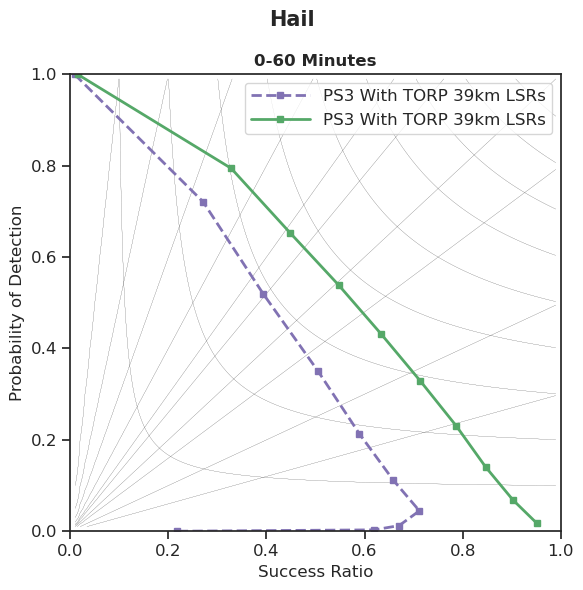

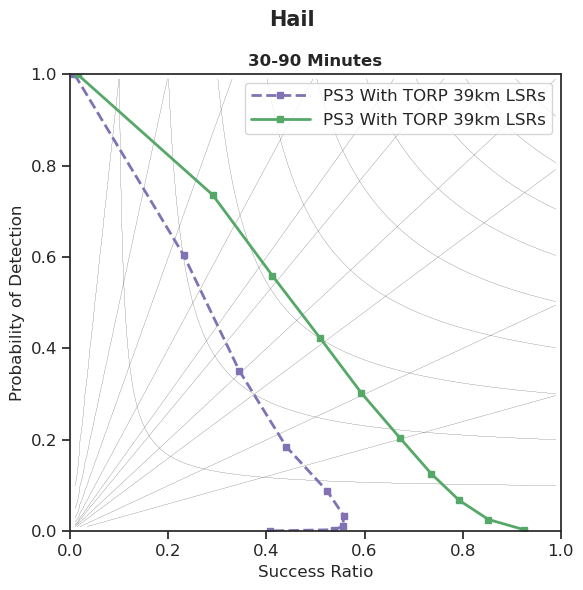

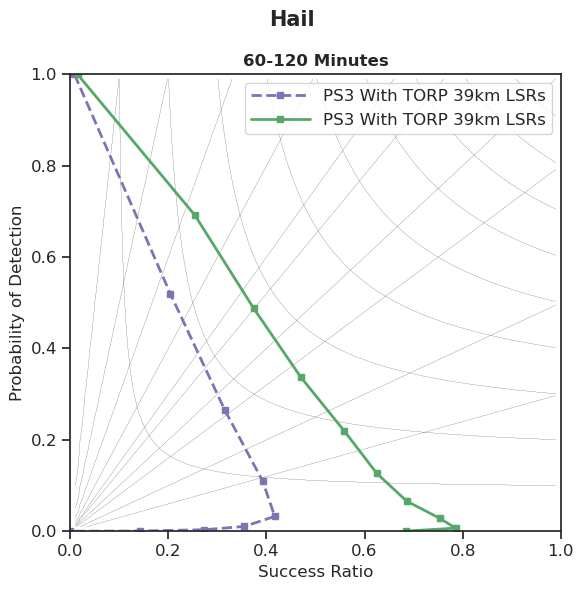

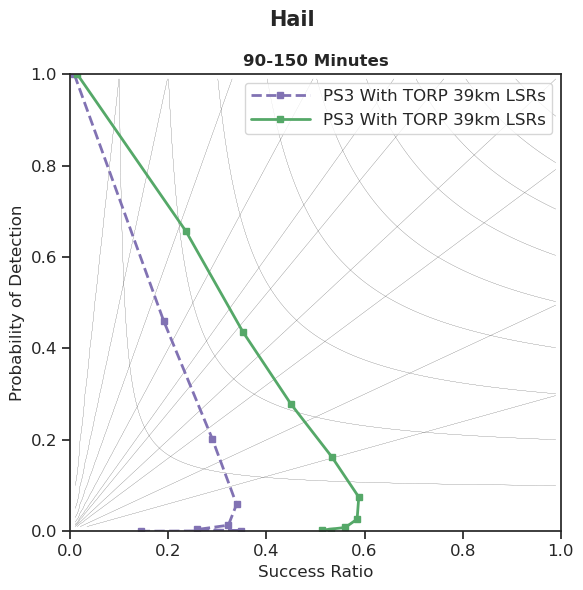

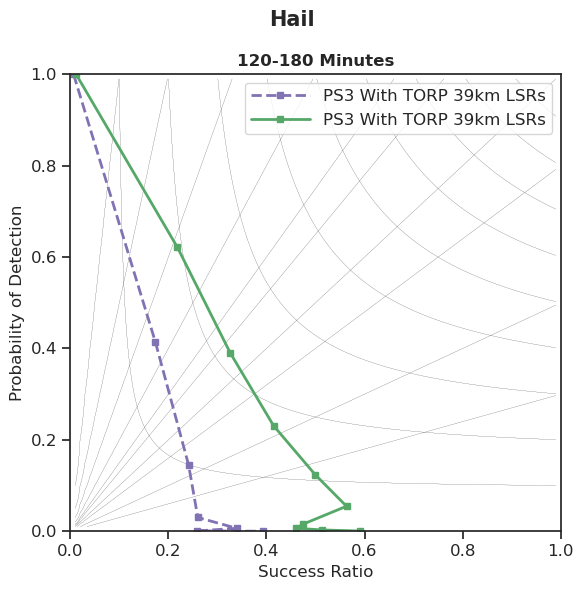

...

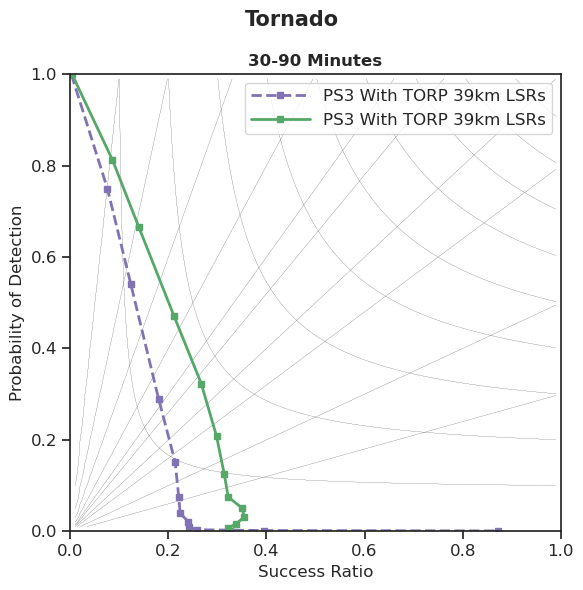

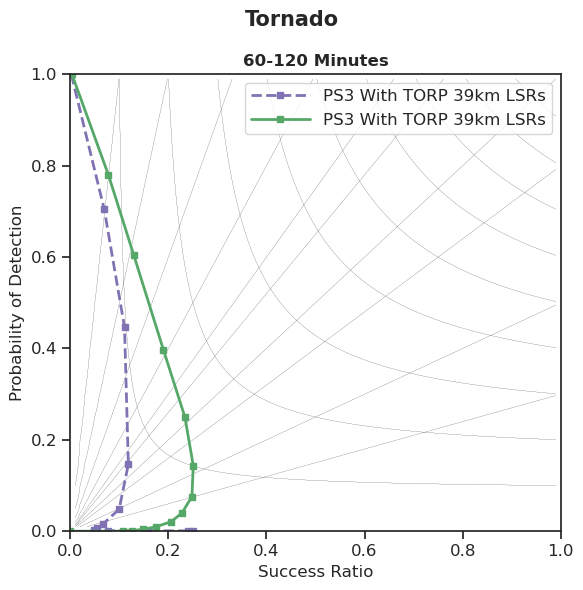

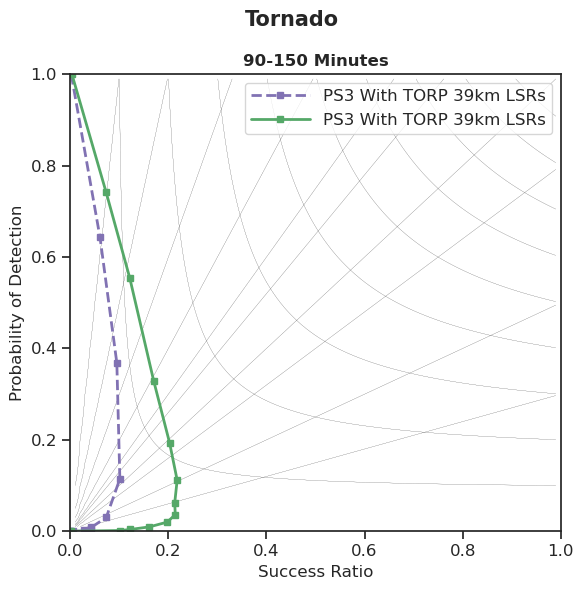

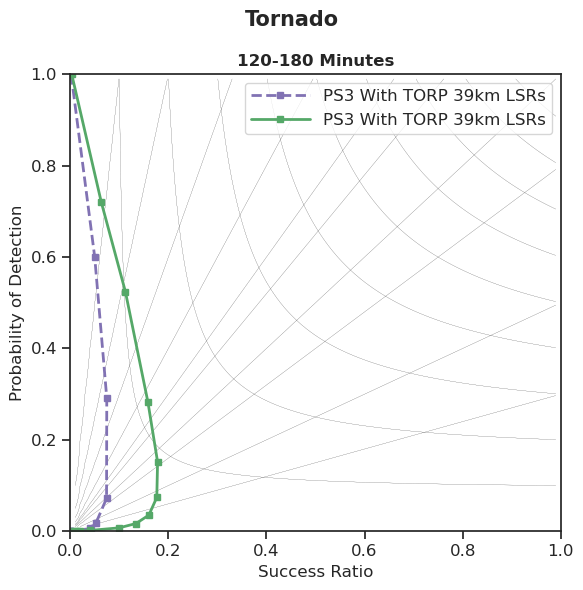

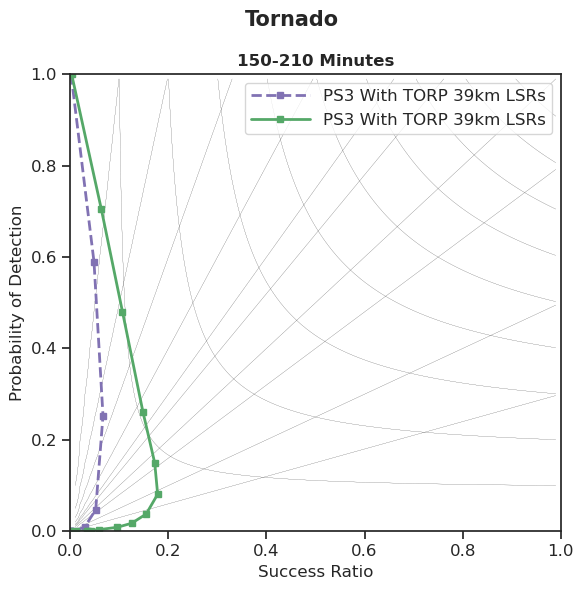

In [47]:
########### PD 6 GIFs ##########

%matplotlib inline
xticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=12, weight='normal', stretch='normal')
yticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=12, weight='normal', stretch='normal')
legend_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                          size=12, weight='normal', stretch='normal')

model_types = ['wofs_psv3_with_torp']
train_types = ['obs', 'obs_and_warnings']
prob_types = ['raw']#, 'avg_sr']
hazards = ['hail', 'wind', 'tornado']
forecast_lengths = [60]#, 120]#, 120]
train_radii = [39]#, 15]
leads = [30, 60, 90, 120, 150, 180]
use_avg_srs = True

fig_save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/PD_GIFs'

for hazard in hazards:
    gif_fig_list = []

    xticks = np.array([0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65, 0.75, 0.85, 0.95])

    #fig_save_fname = 'ps2_no_torp_15_v_39_%s_%s_pd' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_no_vs_with_torp_%s_%s_pd' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_no_vs_with_torp_%s_%s_pd' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_vs_3_no_torp_%s_%s_pd' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_vs_3_with_torp_%s_%s_pd' %(hazard, train_types[0])
    #fig_save_fname = 'ps2_no_torp_obs_vs_ps3_with_torp_obs_and_warnings_%s_pd' %(hazard)
    #fig_save_fname = 'ps0_vs_ps3_with_torp_%s_obs_and_warnings_pd' %(hazard)
    #fig_save_fname = 'ps2_no_torp_vs_ps3_with_torp_%s_%s_pd' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_with_torp_1_vs_2_hour_%s_%s_pd' %(hazard, train_types[0])
    fig_save_fname = 'ps3_with_torp_obs_vs_obs_and_warnings_%s_pd' %(hazard)
    #fig_save_fname = 'ps3_with_torp_vs_filtered_%s_%s_pd' %(hazard, train_types[0])
    #fig_save_fname = 'ps3_with_torp_vs_p_only_%s_%s_pd' %(hazard, train_types[0])

    #fig_save_fname = 'ps2_no_torp_obsw_raw_vs_sr_probs_%s_%s_pd.png' %(hazard, train_types[0])
    
    for i in range(len(leads)):
        fig, ax = plt.subplots(1,1,figsize = (6,6))
        pd_lns = []
        for train_type in train_types:
            for prob_type in prob_types:

                #if model_type == 'wofs_psv2_no_torp':
                #    train_type = 'obs'
                #else:
                #    train_type = 'obs_and_warnings'
                ver_type = train_type

                for train_radius in train_radii:
                    ver_radius = train_radius
                    
                    #sr_rel_scores = []
                    #prob_rel_scores = []
                    #climos = []
                    for forecast_length in forecast_lengths:
                        
                        for model_type in model_types:
                            
                            #line_label = '%s-Hour Window' %(int(forecast_length/60))
                            line_label = '%s %skm LSRs' %(get_model_label(model_type[5:]), ver_radius)
                            #line_label = '%s\n%s' %(get_model_label(model_type[5:]), get_train_type_label(train_type))
                            
                            lead = leads[i]
                            if lead+max(forecast_lengths) > 240:
                                continue

                            color, linewidth, linestyle, fcst_freq_linestyle, pod_marker, marker_size =\
                            get_plot_style(model_type, train_type, train_radius, forecast_length, prob_type)
                            
                            if train_type == 'obs_and_warnings':
                                color = 'g'
                            #if model_type == 'wofs_psv3_with_torp':
                            #    color = 'g'
                            
                            pd_fname = get_performance_diagram_file(model_type, train_type, ver_type, hazard,\
                                                                forecast_length, train_radius, ver_radius,
                                                                lead, use_avg_srs)
                            pd_data = np.load(pd_fname)
                            sr_thresholds = pd_data[0,:]
                            sr_pods = pd_data[1,:]
                            sr_srs = pd_data[2,:]
                            prob_thresholds = pd_data[3,:]
                            prob_pods = pd_data[4,:]
                            prob_srs = pd_data[5,:]

                            sr_thresholds = sr_thresholds[np.where(sr_thresholds > -1)]
                            sr_pods = sr_pods[np.where(sr_pods > -1)]
                            sr_srs = sr_srs[np.where(sr_srs > -1)]
                            prob_thresholds = prob_thresholds[np.where(prob_thresholds > -1)]
                            prob_pods = prob_pods[np.where(prob_pods > -1)]
                            prob_srs = prob_srs[np.where(prob_srs > -1)]

                            mesh_sr, mesh_pod, csis, bias = calc_csi_bias_contours()
                            
                            if prob_type == 'raw':
                                pd = ax.plot(prob_srs, prob_pods, color = color,\
                                                                    linewidth = linewidth, linestyle = linestyle,\
                                                                    marker = pod_marker, markersize = marker_size,\
                                                                   label = line_label)
                                pd_lns.append(pd)
                            elif prob_type == 'avg_sr':
                                pd = ax.plot(sr_srs, sr_pods, color = color,\
                                                                    linewidth = linewidth, linestyle = linestyle,\
                                                                    marker = pod_marker, markersize = marker_size)
                            csi_lines = ax.contour(mesh_sr, mesh_pod, csis, np.arange(0.1, 1, 0.1),\
                                                                          colors = ['k'], linewidths = 0.07)
                            bias_lines = ax.contour(mesh_sr, mesh_pod, bias,\
                                                                           [0.3, 0.5, 0.8, 1, 1.3, 1.5, 2, 3, 5, 10],\
                                                                           colors = ['k'], linewidths = 0.07)
                            h2,_ = csi_lines.legend_elements()
                            h3,_ = bias_lines.legend_elements()
                            if 120 in forecast_lengths:
                                ax.set_title('%s Minute Lead Time' %(lead-30), fontname="DejaVu Sans", fontsize = 12, weight = 'bold')
                            else:
                                ax.set_title('%s-%s Minutes' %(lead-30, forecast_length+lead-30), fontname="DejaVu Sans", fontsize = 12, weight = 'bold')
                            ax.set_xlim([0,1])
                            ax.set_ylim([0,1])
                            ax.set_xlabel('Success Ratio', fontname="DejaVu Sans", fontsize = 12)
                            ax.set_ylabel('Probability of Detection', fontname="DejaVu Sans", fontsize = 12)
                            ax.spines["top"].set_visible(True)
                            ax.spines["right"].set_visible(True)
                            
                            for label in ax.get_xticklabels():
                                label.set_fontproperties(xticks_font)
                            for label in ax.get_yticklabels():
                                label.set_fontproperties(yticks_font)

                            lns = []
                            for l in pd_lns:
                                lns += l
                            labs = [l.get_label() for l in lns]
                            ax.legend(lns, labs, loc = 'upper right', prop=legend_font, handlelength = 3.5)
                            
                    fig.suptitle('%s' %(hazard.capitalize()), fontname="DejaVu Sans", fontsize = 15, weight = 'bold')
                    fig.tight_layout()
                    save_fname = '%s_%s-%smin.png' %(fig_save_fname, lead-30, lead+forecast_length-30)
                    fig.savefig('%s/%s' %(fig_save_dir, save_fname))
                    gif_fig_list.append('%s/%s' %(fig_save_dir, save_fname))
    images = []
    gif_fname = '%s.gif' %(fig_save_fname)
    for filename in gif_fig_list:
        images.append(iio.imread(filename))
    iio.imwrite('%s/%s' %(fig_save_dir, gif_fname), images, duration = 750, loop = 0)

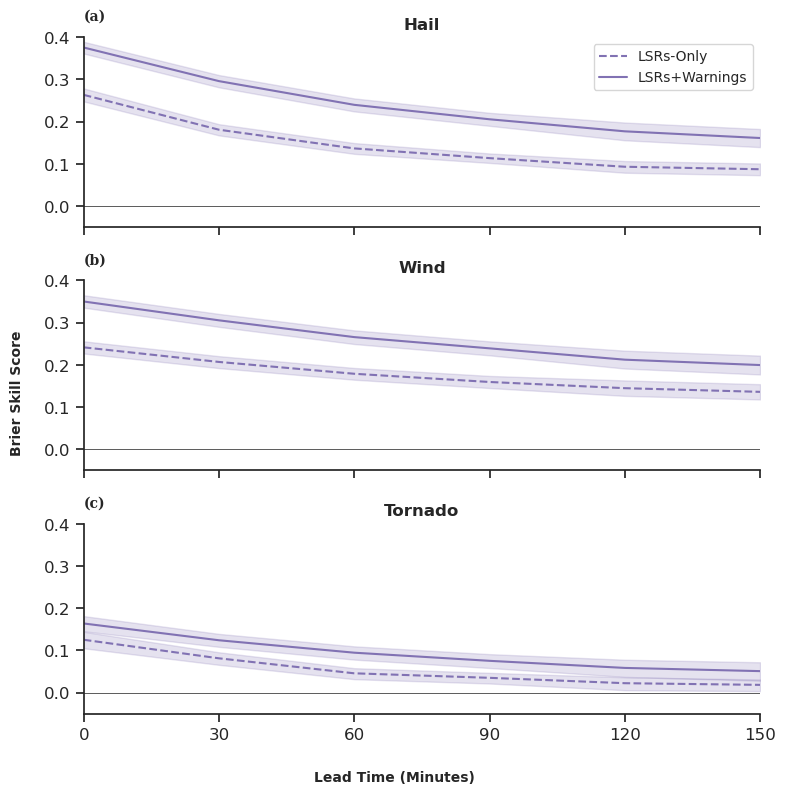

In [117]:
%matplotlib inline

hazards = ['hail', 'wind', 'tornado']
forecast_length = 60
train_radius = 39
ver_radius = 39
leads = [0, 30, 60, 90, 120, 150]

fig_save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/BSS_Plots'
fig, axs = plt.subplots(3,1,figsize = (8,8))

subplot_labels = ['(a)', '(b)', '(c)']

for i in range(len(hazards)):
    hazard = hazards[i]

    #fig_save_fname = 'ps2_no_torp_15_v_39_%s_obs_bss.png' %(hazard)
    #fig_save_fname = 'ps2_no_vs_with_torp_%s_obs_bss.png' %(hazard)
    #fig_save_fname = 'ps3_no_vs_with_torp_%s_obs_bss.png' %(hazard)
    #fig_save_fname = 'ps2_vs_3_no_torp_%s_obs_bss.png' %(hazard)
    #fig_save_fname = 'ps2_vs_3_with_torp_%s_obs_bss.png' %(hazard)
    #fig_save_fname = 'ps2_no_torp_obs_vs_ps3_with_torp_obs_and_warnings_%s_bss.png' %(hazard)
    #fig_save_fname = 'ps2_no_torp_vs_ps3_with_torp_%s_obs_bss.png' %(hazard)
    #fig_save_fname = 'ps0_vs_ps3_with_torp_%s_obs_and_warnings_bss.png' %(hazard)
    #fig_save_fname = 'ps3_with_torp_1_vs_2_hour_%s_obs_and_warnings_bss.png' %(hazard)
    #fig_save_fname = 'ps3_with_torp_obs_vs_obs_and_warnings_%s_bss.png' %(hazard)
    #fig_save_fname = 'ps3_with_torp_vs_filtered_%s_obs_and_warnings_bss.png' %(hazard)
    #fig_save_fname = 'ps3_with_torp_vs_p_only_%s_obs_and_warnings_bss.png' %(hazard)
    #fig_save_fname = 'all_models_no_error_%s_bss.png' %(hazard)
    
    #fig_save_fname = 'ps2_no_vs_with_torp_all_haz_obs_bss.png'
    #fig_save_fname = 'ps2_vs_3_with_torp_all_haz_obs_bss.png'
    #fig_save_fname = 'ps2_no_torp_vs_ps3_with_torp_all_haz_obs_bss.png'
    #fig_save_fname = 'ps0_vs_ps3_with_torp_all_haz_obs_and_warnings_bss.png'
    fig_save_fname = 'ps3_with_torp_obs_vs_obs_and_warnings_all_haz_bss.png'


    xticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                              size=12, weight='normal', stretch='normal')
    yticks_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                              size=12, weight='normal', stretch='normal')
    legend_font = font_manager.FontProperties(family='DejaVu Sans', style='normal',\
                                              size=10, weight='normal', stretch='normal')

    ps2nt15o_prob_bss_file, ps2nt15o_sr_bss_file = get_bootstrapped_bss_file('wofs_psv2_no_torp', 'obs', 'obs',\
                                                                             hazard, forecast_length, 15, 15)
    ps2nt39o_prob_bss_file, ps2nt39o_sr_bss_file = get_bootstrapped_bss_file('wofs_psv2_no_torp', 'obs', 'obs',\
                                                                             hazard, forecast_length, train_radius, ver_radius)
    ps2nt39ow_prob_bss_file, ps2nt39ow_sr_bss_file = get_bootstrapped_bss_file('wofs_psv2_no_torp', 'obs_and_warnings',\
                                                                             'obs_and_warnings', hazard, forecast_length,\
                                                                             train_radius, ver_radius)
    ps2wt39o_prob_bss_file, ps2wt39o_sr_bss_file = get_bootstrapped_bss_file('wofs_psv2_with_torp', 'obs', 'obs',\
                                                                             hazard, forecast_length, train_radius, ver_radius)
    ps2wt39ow_prob_bss_file, ps2wt39ow_sr_bss_file = get_bootstrapped_bss_file('wofs_psv2_with_torp', 'obs_and_warnings',\
                                                                             'obs_and_warnings', hazard, forecast_length,\
                                                                             train_radius, ver_radius)
    ps3nt39o_prob_bss_file, ps3nt39o_sr_bss_file = get_bootstrapped_bss_file('wofs_psv3_no_torp', 'obs', 'obs',\
                                                                             hazard, forecast_length, train_radius, ver_radius)
    ps3wt39o_prob_bss_file, ps3wt39o_sr_bss_file = get_bootstrapped_bss_file('wofs_psv3_with_torp', 'obs', 'obs',\
                                                                             hazard, forecast_length, train_radius, ver_radius)
    ps3nt39ow_prob_bss_file, ps3nt39ow_sr_bss_file = get_bootstrapped_bss_file('wofs_psv3_no_torp', 'obs_and_warnings',\
                                                                               'obs_and_warnings', hazard, forecast_length,\
                                                                               train_radius, ver_radius)
    ps3nt39ow2h_prob_bss_file, ps3nt39ow2h_sr_bss_file = get_bootstrapped_bss_file('wofs_psv3_no_torp', 'obs_and_warnings',\
                                                                               'obs_and_warnings', hazard, 120,\
                                                                               train_radius, ver_radius)
    ps3wt39ow_prob_bss_file, ps3wt39ow_sr_bss_file = get_bootstrapped_bss_file('wofs_psv3_with_torp', 'obs_and_warnings',\
                                                                               'obs_and_warnings', hazard, forecast_length,\
                                                                               train_radius, ver_radius)
    ps3wt39ow2h_prob_bss_file, ps3wt39ow2h_sr_bss_file = get_bootstrapped_bss_file('wofs_psv3_with_torp', 'obs_and_warnings',\
                                                                               'obs_and_warnings', hazard, 120,\
                                                                               train_radius, ver_radius)
    ps3wtF39ow_prob_bss_file, ps3wtF39ow_sr_bss_file = get_bootstrapped_bss_file('wofs_psv3_with_torp_filtered', 'obs_and_warnings',\
                                                                               'obs_and_warnings', hazard, forecast_length,\
                                                                               train_radius, ver_radius)
    ps3wtNR39ow_prob_bss_file, ps3wtNR39ow_sr_bss_file = get_bootstrapped_bss_file('wofs_psv3_with_torp_p_only', 'obs_and_warnings',\
                                                                               'obs_and_warnings', hazard, forecast_length,\
                                                                               train_radius, ver_radius)
    ps0wt39ow_prob_bss_file, ps0wt39ow_sr_bss_file = get_bootstrapped_bss_file('wofs_psv0_with_torp', 'obs_and_warnings',\
                                                                               'obs_and_warnings', hazard, forecast_length,\
                                                                               train_radius, ver_radius)

    ps2nt15o_prob_bss = np.load(ps2nt15o_prob_bss_file)
    ps2nt39o_prob_bss = np.load(ps2nt39o_prob_bss_file)
    ps2nt39ow_prob_bss = np.load(ps2nt39ow_prob_bss_file)
    ps2wt39o_prob_bss = np.load(ps2wt39o_prob_bss_file)
    ps2wt39ow_prob_bss = np.load(ps2wt39ow_prob_bss_file)
    ps0wt39ow_prob_bss = np.load(ps0wt39ow_prob_bss_file)
    ps3nt39o_prob_bss = np.load(ps3nt39o_prob_bss_file)
    ps3nt39ow_prob_bss = np.load(ps3nt39ow_prob_bss_file)
    ps3nt39ow2h_prob_bss = np.load(ps3nt39ow2h_prob_bss_file)
    ps3wt39ow2h_prob_bss = np.load(ps3wt39ow2h_prob_bss_file)
    ps3wt39o_prob_bss = np.load(ps3wt39o_prob_bss_file)
    ps3wt39ow_prob_bss = np.load(ps3wt39ow_prob_bss_file)
    ps3wtF39ow_prob_bss = np.load(ps3wtF39ow_prob_bss_file)
    ps3wtNR39ow_prob_bss = np.load(ps3wtNR39ow_prob_bss_file)

    axs[i].plot([-30,180], [0,0], 'k', linewidth = 0.5)

    #axs[i].fill_between(leads, ps2nt15o_prob_bss[2,:], y2=ps2nt15o_prob_bss[0,:], color = 'r', alpha = 0.2)
    #axs[i].plot(leads, ps2nt15o_prob_bss[1,:], 'r--', linewidth = 0.5, label = 'PS2 No TORP 15km LSRs')

    #axs[i].fill_between(leads, ps2nt39o_prob_bss[2,:], y2=ps2nt39o_prob_bss[0,:], color = 'r', alpha = 0.2)
    #axs[i].plot(leads, ps2nt39o_prob_bss[1,:], 'r--', label = 'PS2 No TORP')

    #axs[i].fill_between(leads, ps2wt39o_prob_bss[2,:], y2=ps2wt39o_prob_bss[0,:], color = 'c', alpha = 0.2)
    #axs[i].plot(leads, ps2wt39o_prob_bss[1,:], 'c--', label = 'PS2 With TORP')

    #axs[i].fill_between(leads, ps3nt39o_prob_bss[2,:], y2=ps3nt39o_prob_bss[0,:], color = 'springgreen', alpha = 0.2)
    #axs[i].plot(leads, ps3nt39o_prob_bss[1,:], color = 'springgreen', linestyle = '--', label = 'PS3 No TORP 39km LSRs')

    axs[i].fill_between(leads, ps3wt39o_prob_bss[2,:], y2=ps3wt39o_prob_bss[0,:], color = 'm', alpha = 0.2)
    axs[i].plot(leads, ps3wt39o_prob_bss[1,:], 'm--', label = 'LSRs-Only')

    #axs[i].fill_between(leads, ps2nt39ow_prob_bss[2,:], y2=ps2nt39ow_prob_bss[0,:], color = 'r', alpha = 0.2)
    #axs[i].plot(leads, ps2nt39ow_prob_bss[1,:], 'r', label = 'PS2 No TORP 39km LSRs+Warnings')

    #axs[i].fill_between(leads, ps0wt39ow_prob_bss[2,:], y2=ps0wt39ow_prob_bss[0,:], color = 'navy', alpha = 0.2)
    #axs[i].plot(leads, ps0wt39ow_prob_bss[1,:], 'navy', label = 'TORP Only')

    #axs[i].fill_between(leads, ps2wt39ow_prob_bss[2,:], y2=ps2wt39ow_prob_bss[0,:], color = 'c', alpha = 0.2)
    #axs[i].plot(leads, ps2wt39ow_prob_bss[1,:], 'c', label = 'PS2 With TORP 39km LSRs+Warnings')

    #axs[i].fill_between(leads, ps3nt39ow_prob_bss[2,:], y2=ps3nt39ow_prob_bss[0,:], color = 'springgreen', alpha = 0.2)
    #axs[i].plot(leads, ps3nt39ow_prob_bss[1,:], color = 'springgreen', label = 'PS3 No TORP 39km LSRs+Warnings')

    axs[i].fill_between(leads, ps3wt39ow_prob_bss[2,:], y2=ps3wt39ow_prob_bss[0,:], color = 'm', alpha = 0.2)
    axs[i].plot(leads, ps3wt39ow_prob_bss[1,:], 'm', label = 'LSRs+Warnings')

    #axs[i].fill_between(leads, ps3wtF39ow_prob_bss[2,:], y2=ps3wtF39ow_prob_bss[0,:], color = 'g', alpha = 0.2)
    #axs[i].plot(leads, ps3wtF39ow_prob_bss[1,:], 'g', label = 'PS3 With TORP Filtered 39km LSRs+Warnings')

    #axs[i].fill_between(leads, ps3wtNR39ow_prob_bss[2,:], y2=ps3wtNR39ow_prob_bss[0,:], color = 'orange', alpha = 0.2)
    #axs[i].plot(leads, ps3wtNR39ow_prob_bss[1,:], 'orange', label = 'PS3 With TORP P-Only 39km LSRs+Warnings')

    #axs[i].fill_between(leads[0:4], ps3wt39ow2h_prob_bss[2,0:4], y2=ps3wt39ow2h_prob_bss[0,0:4], color = 'pink', alpha = 0.2)
    #axs[i].plot(leads[0:4], ps3wt39ow2h_prob_bss[1,0:4], color = 'pink', label = '2-Hour Window')
    
    axs[i].text(0, 0.44, subplot_labels[i], weight = 'bold', fontsize = 10)
    axs[i].set_title('%s' %(hazard.capitalize()), fontname = 'DejaVu Sans', fontsize = 12, weight = 'bold')
    #axs[i].set_xlabel('Lead Time (Minutes)', fontsize = 12, fontname="DejaVu Sans", weight = 'bold')
    #axs[i].set_ylabel('Brier Skill Score', fontsize = 12, fontname="DejaVu Sans", weight = 'bold')
    axs[i].set_xticks(leads)
    if not (i == 2):
        axs[i].set_xticklabels([])
    axs[i].set_yticks([0, 0.1, 0.2, 0.3, 0.4])
    axs[i].tick_params(axis='both', which='major', labelsize=12)
    axs[i].tick_params(axis='both', which='minor', labelsize=8)
    axs[i].set_ylim([-0.05,0.4])
    axs[i].set_xlim([leads[0], leads[-1]])
    if i == 0:
        axs[i].legend(loc = 'upper right', prop=legend_font)
    for label in axs[i].get_xticklabels():
        label.set_fontproperties(xticks_font)
    for label in axs[i].get_yticklabels():
        label.set_fontproperties(yticks_font)

fig.supxlabel('Lead Time (Minutes)', fontname="DejaVu Sans", fontsize = 10, weight = 'bold')
fig.supylabel('Brier Skill Score', fontname="DejaVu Sans", fontsize = 10, weight = 'bold')
fig.tight_layout()
fig.savefig('%s/%s' %(fig_save_dir, fig_save_fname))
    

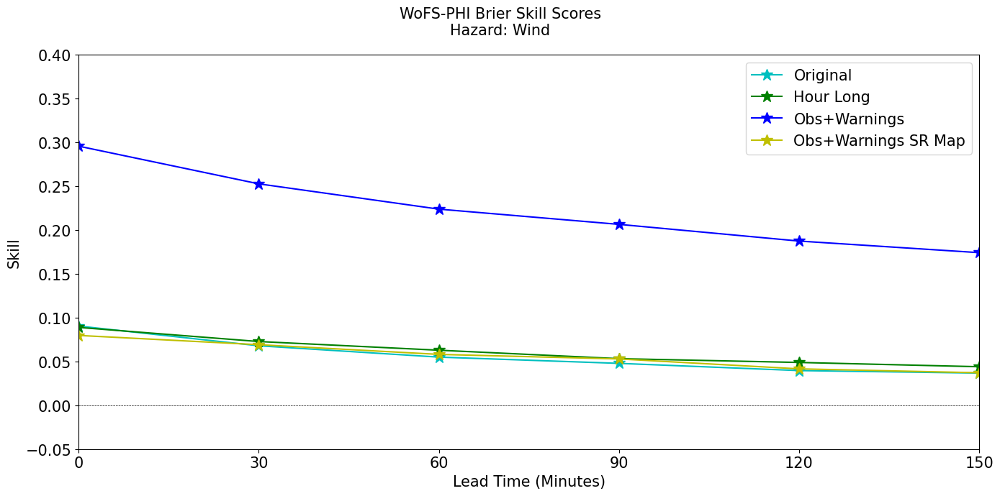

In [35]:
### SLS BSS Figures ###

haz = 'wind'
fig_dir = '/work/ryan.martz/wofs_phi_data/SLS_2024/verification_figs'
fig_fname = 'sls_%s_bss_fig.png' %(haz)

length = 60
train_types = ['obs', 'obs_and_warnings']
ver_types = ['obs', 'obs_and_warnings']
train_radius = 15
ver_radius = 15
leads = [30, 60, 90, 120, 150, 180]
model_type = 'wofs_psv2_no_torp'

original_bss_file, _ = get_overall_bss_file(model_type, 'obs', 'obs', haz, 30, train_radius, ver_radius, use_avg_srs = False)
original_bss = np.load(original_bss_file)
hour_long_bss_file, _ = get_overall_bss_file(model_type, 'obs', 'obs', haz, length, train_radius, ver_radius, use_avg_srs = False)
hour_long_bss = np.load(hour_long_bss_file)
obsw_probs_file, obsw_sr_file = get_overall_bss_file(model_type, 'obs_and_warnings', 'obs_and_warnings', haz, length, train_radius, ver_radius, use_avg_srs = True)
obsw_bss = np.load(obsw_probs_file)
obsw_sr_bss = np.load(obsw_sr_file)

fig, axs = plt.subplots(figsize = (14,7))
sup_title = 'WoFS-PHI Brier Skill Scores\nHazard: %s' %(haz.capitalize())
fig.suptitle(sup_title, fontsize = 15)

leads = np.array(leads) - 30
axs.plot(leads, original_bss, 'c-*', label = 'Original', markersize = 12)
axs.plot(leads, hour_long_bss, 'g-*', label = 'Hour Long', markersize = 12)
axs.plot(leads, obsw_bss, 'b-*', label = 'Obs+Warnings', markersize = 12)
axs.plot(leads, obsw_sr_bss, 'y-*', label = 'Obs+Warnings SR Map', markersize = 12)
axs.plot([0,150],[0,0],'k--', linewidth = 0.5)

axs.set_xlabel('Lead Time (Minutes)', fontsize = 15)
axs.set_ylabel('Skill', fontsize = 15)
axs.set_xticks(leads)
axs.tick_params(axis='both', which='major', labelsize=15)
axs.tick_params(axis='both', which='minor', labelsize=8)
axs.set_ylim([-0.05,0.4])
axs.set_xlim([0,150])

axs.legend(fontsize=15)
    
fig.tight_layout()

utilities.save_data(fig_dir, fig_fname, fig, 'png')


In [24]:
np.power(np.array([2, 3, 4, 5]), 2)

array([ 4,  9, 16, 25])

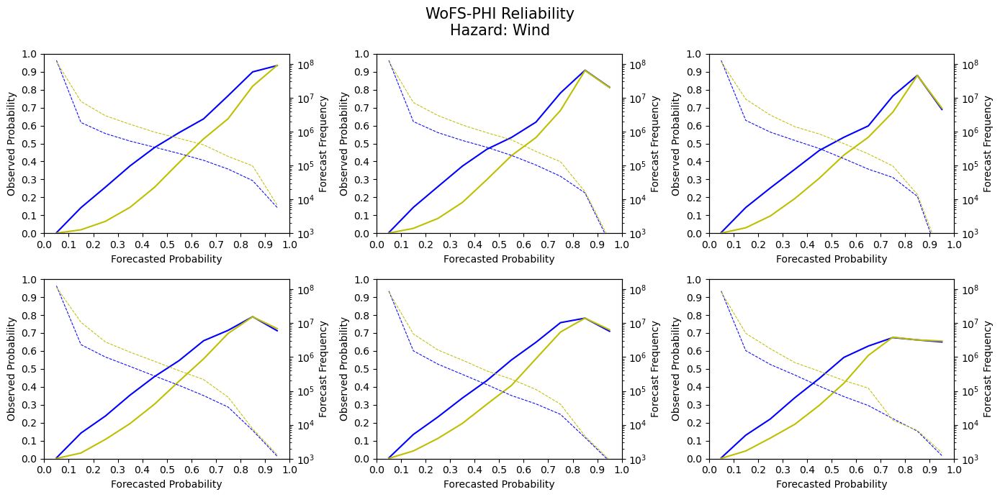

In [79]:
### SLS Reliability Figures ###

haz = 'wind'
fig_dir = '/work/ryan.martz/wofs_phi_data/SLS_2024/verification_figs'
fig_fname = 'sls_%s_reliability_fig.png' %(haz)

length = 60
train_types = ['obs', 'obs_and_warnings']
ver_types = ['obs', 'obs_and_warnings']
train_radius = 15
ver_radius = 15
leads = [30, 60, 90, 120, 150, 180]
model_type = 'wofs_psv2_no_torp'

if length == 60:
    num_cols = 3
    fig_width = 14
elif length == 120:
    num_cols = 2
    fig_width = 14/1.5

fig, axs = plt.subplots(2,num_cols, figsize = (fig_width, 7))
sup_title = 'WoFS-PHI Reliability\nHazard: %s' %(haz.capitalize())
fig.suptitle(sup_title, fontsize = 15)
original_climos = []
hour_long_climos = []
obsw_climos = []
for i in range(len(leads)):
    lead = leads[i]
    
    original_rel_data_fname = get_reliability_file(model_type, 'obs', 'obs', haz, 30, train_radius, ver_radius, lead, use_avg_srs = False)
    original_rel_data = np.load(original_rel_data_fname)
    original_climos.append(original_rel_data[0,2])
    fcsts = original_rel_data[1,:]
    original_fcst_freq = original_rel_data[4,:]
    original_obs_freq = original_rel_data[5,:]
    original_obs_freq = original_obs_freq[np.where(original_fcst_freq > 0)]
    original_fcsts = fcsts[np.where(original_fcst_freq > 0)]
    
    hour_long_rel_data_fname = get_reliability_file(model_type, 'obs', 'obs', haz, length, train_radius, ver_radius, lead, use_avg_srs = True)
    hour_long_rel_data = np.load(hour_long_rel_data_fname)
    hour_long_climos.append(hour_long_rel_data[0,2])
    fcsts = hour_long_rel_data[1,:]
    hour_long_fcst_freq = hour_long_rel_data[4,:]
    hour_long_obs_freq = hour_long_rel_data[5,:]
    hour_long_obs_freq = hour_long_obs_freq[np.where(hour_long_fcst_freq > 0)]
    hour_long_fcsts = fcsts[np.where(hour_long_fcst_freq > 0)]
    
    obsw_rel_data_fname = get_reliability_file(model_type, 'obs_and_warnings', 'obs_and_warnings', haz, length, train_radius, ver_radius, lead, use_avg_srs = True)
    obsw_rel_data = np.load(obsw_rel_data_fname)
    obsw_climos.append(obsw_rel_data[0,2])
    fcsts = obsw_rel_data[1,:]
    obsw_fcst_freq = obsw_rel_data[4,:]
    obsw_obs_freq = obsw_rel_data[5,:]
    obsw_obs_freq = obsw_obs_freq[np.where(obsw_fcst_freq > 0)]
    obsw_fcsts = fcsts[np.where(obsw_fcst_freq > 0)]
    
    obsw_sr_fcst_freq = obsw_rel_data[2,:]
    obsw_sr_obs_freq = obsw_rel_data[3,:]
    obsw_sr_obs_freq = obsw_sr_obs_freq[np.where(obsw_sr_fcst_freq > 0)]
    obsw_sr_fcsts = fcsts[np.where(obsw_sr_fcst_freq > 0)]
    

    index = int(lead/30)-1
    row_index = math.floor(index/num_cols)
    if index <= (num_cols-1):
        col_index = index
    else:
        col_index = index-num_cols
                        
    color = get_model_color(model_type)
    dash_length = 5
    dash_spacing = 5
    
    #l1 = axs[row_index, col_index].plot([0,1], [obsw_climos[i], obsw_climos[i]], 'orange', linewidth = 0.5, label = '60 Min Obs+Warnings Climatology')
    #l2 = axs[row_index, col_index].plot([0,1], [0,1], 'k', linewidth = 0.5, label = 'Perfect Reliability')
    
    #l3 = axs[row_index, col_index].plot(original_fcsts, original_obs_freq, 'c', label = 'Original Reliability')
    #l4 = axs[row_index, col_index].plot(hour_long_fcsts, hour_long_obs_freq, 'g', label = 'Hour Long Reliability')
    l5 = axs[row_index, col_index].plot(obsw_fcsts, obsw_obs_freq, 'b', label = 'Obs+Warnings Reliability')
    l6 = axs[row_index, col_index].plot(obsw_sr_fcsts, obsw_sr_obs_freq, 'y', label = 'Obs+Warnings SR Mapped\nReliability')
    
    axs[row_index, col_index].set_xlim([0,1])
    axs[row_index, col_index].set_ylim([0,1])
    axs[row_index, col_index].set_xlabel('Forecasted Probability')
    axs[row_index, col_index].set_xticks(np.arange(0,1.01,0.1))
    axs[row_index, col_index].set_yticks(np.arange(0,1.01,0.1))
    axs[row_index, col_index].set_ylabel('Observed Probability')
    ax2 = axs[row_index, col_index].twinx()
    ax2.set_yscale('log')
    ax2.set_ylim([10**3, 10**8.3])
    ax2.set_ylabel('Forecast Frequency')
    l7 = ax2.plot(obsw_fcsts, obsw_fcst_freq, 'b--', linewidth = 0.75, label = 'Obs+Warnings Forecast Frequency')
    l8 = ax2.plot(obsw_sr_fcsts, obsw_sr_fcst_freq, 'y--', linewidth = 0.75, label = 'Obs+Warnings SR Mapped\nForecast Frequency')
    title = 'Lead Time: %s min' %(lead)
    #prob_axs[row_index, col_index].set_title(title)
    lns = l5+l6+l7+l8
    labs = [l.get_label() for l in lns]
    #axs[row_index, col_index].legend(lns, labs, loc=0, fontsize = 11)

fig.tight_layout()
utilities.save_data(fig_dir, fig_fname, fig, 'png')
probs, obs, obs_color, levels, init_date, title, save_dir, save_file

In [290]:
a = np.array([[1, 2, 3, 4, 5, 6, 7, 8, 9], [1, 2, 3, 4, 5, 6, 7, 8, 9], [1, 2, 3, 4, 5, 6, 7, 8, 9]])
a = np.delete(a, [3, 6, 7], axis = 1)
a

array([[1, 2, 3, 5, 6, 9],
       [1, 2, 3, 5, 6, 9],
       [1, 2, 3, 5, 6, 9]])

In [8]:
%matplotlib inline

pred_path = '/work/eric.loken/wofs/2024_update/SFE2024/fcst/full_npy_backup'
obs_dir = '/work/ryan.martz/wofs_phi_data/training_data/obs_and_warnings/full_2d_obs_and_warnings'
#pred_path = '/work/eric.loken/wofs/paper6/fcst/30/full_npy'

length = 60
date = '20200428'
init_str = '2100'
ps_init = '%s24' %(init_str[0:2])
init = dt.datetime(1970, 1, 1, int(init_str[0:2]), 0)
hazard = 'tornado'
obs_color = 'r'
radius = 39
ps_predictor_index = 54
torp_predictor_index = 269

torp_gif_fnames = []
torp_filtered_gif_fnames = []
gif_fnames = []

for lead in [30]:#, 60, 90, 120, 150, 180]:
#for lead in [25, 55, 85, 115, 145, 175]:
    start = init + dt.timedelta(seconds = lead*60)
    end = start + dt.timedelta(seconds = length*60)

    start_str = start.strftime('%H%M')
    end_str = end.strftime('%H%M')
    
    ps2_file = 'wofs1d_psv2_with_torp_%s_%s_%s_v%s-%s.npy' %(date, init_str, ps_init, start_str, end_str)
    ps3_file = 'wofs1d_psv3_with_torp_%s_%s_%s_v%s-%s.npy' %(date, init_str, ps_init, start_str, end_str)
    obsw_file = '%s/length_%s/%s/%s_obs_and_warnings_%s_v%s-%s_r%skm_2d.npy' %(obs_dir, length, hazard, hazard, date, start_str, end_str, radius)
    #print(sample_file)
    ps2_preds = np.load('%s/%s' %(pred_path, ps2_file))
    ps3_preds = np.load('%s/%s' %(pred_path, ps3_file))
    torp_grid_1d = deepcopy(ps2_preds[:,torp_predictor_index])
    torp_grid_1d[torp_grid_1d < 0.4] = 0
    torp_grid_filtered = np.reshape(torp_grid_1d, (300,300))
    torp_grid = np.reshape(ps2_preds[:,torp_predictor_index], (300,300))
    ps2_grid = np.reshape(ps2_preds[:,ps_predictor_index],(300,300))
    ps3_grid = np.reshape(ps3_preds[:,ps_predictor_index],(300,300))
    
    obsw = np.load(obsw_file)
    levels = np.arange(0.1,1.01,0.1)
    
    title = ''
    save_dir = '/work/ryan.martz/wofs_phi_data/experiments/Thesis_Figs/Raw_Objects'
    save_file = 'raw_objects_%s_init_%s_%s-%s.png' %(date, init_str, lead, lead+length)
    gif_fnames.append('%s/%s' %(save_dir, save_file))
    torp_save_file = 'torp_%s_init_%s_%s-%s.png' %(date, init_str, lead, lead+length)
    #torp_gif_fnames.append('%s/%s' %(save_dir, torp_save_file))
    #torp_filtered_save_file = 'torp_filtered_%s_init_%s_%s-%s.png' %(date, init_str, lead, lead+length)
    #torp_filtered_gif_fnames.append('%s/%s' %(save_dir, torp_filtered_save_file))
    
    wofs_template_directory = '/work2/wof/SummaryFiles/' + date + '/2200'
    wofs_file = 'wofs_SWT_00_' + date + '_2200_2200.nc'
    wofs_grid = Grid.create_wofs_grid(wofs_template_directory, wofs_file)
    
    cmap = 'jet'
    fig, axs = plt.subplots(2, 2, subplot_kw={'projection': ccrs.PlateCarree()}, figsize = (6,6))
    axs[0,0].add_feature(cfeature.STATES, edgecolor='black', linewidth=1)
    axs[0,0].set_title('PS2 Objects', font = 'DejaVu Sans', fontsize = 12)
    axs[0,1].add_feature(cfeature.STATES, edgecolor='black', linewidth=1)
    axs[0,1].set_title('PS3 Objects', font = 'DejaVu Sans', fontsize = 12)
    axs[1,0].add_feature(cfeature.STATES, edgecolor='black', linewidth=1)
    axs[1,0].set_title('TORP Objects', font = 'DejaVu Sans', fontsize = 12)
    axs[1,1].add_feature(cfeature.STATES, edgecolor='black', linewidth=1)
    axs[1,1].set_title('Filtered TORP Objects', font = 'DejaVu Sans', fontsize = 12)
    p = axs[0,0].contourf(wofs_grid.lons, wofs_grid.lats, ps2_grid, cmap=cmap, levels = levels,\
                     alpha = 0.8, antialiased = True, extend = 'max')
    p = axs[0,1].contourf(wofs_grid.lons, wofs_grid.lats, ps3_grid, cmap=cmap, levels = levels,\
                     alpha = 0.8, antialiased = True, extend = 'max')
    p = axs[1,0].contourf(wofs_grid.lons, wofs_grid.lats, torp_grid, cmap=cmap, levels = levels,\
                     alpha = 0.8, antialiased = True, extend = 'max')
    p = axs[1,1].contourf(wofs_grid.lons, wofs_grid.lats, torp_grid_filtered, cmap=cmap, levels = levels,\
                     alpha = 0.8, antialiased = True, extend = 'max')
    axs[0,0].contour(wofs_grid.lons, wofs_grid.lats, obsw, colors = obs_color, linewidths = 0.25)
    axs[0,1].contour(wofs_grid.lons, wofs_grid.lats, obsw, colors = obs_color, linewidths = 0.25)
    axs[1,0].contour(wofs_grid.lons, wofs_grid.lats, obsw, colors = obs_color, linewidths = 0.25)
    axs[1,1].contour(wofs_grid.lons, wofs_grid.lats, obsw, colors = obs_color, linewidths = 0.25)

    axs[0,0].text(wofs_grid.lons[0][20],wofs_grid.lats[250][0],'(a)')
    axs[0,1].text(wofs_grid.lons[0][20],wofs_grid.lats[250][0],'(b)')
    axs[1,0].text(wofs_grid.lons[0][20],wofs_grid.lats[250][0],'(c)')
    axs[1,1].text(wofs_grid.lons[0][20],wofs_grid.lats[250][0],'(d)')
    
    cbar_ax = fig.add_axes([0.155, 0.04, 0.712, 0.02])
    cbar = fig.colorbar(p, cax=cbar_ax, orientation='horizontal')
    cbar.ax.tick_params(labelsize=10)

    fig.suptitle('WoFS Initialization: May 1, 2019 0100 UTC\nForecast Valid: 0130 - 0230 UTC', font = 'DejaVu Sans', fontsize = 15)
    fig.tight_layout()
    utilities.save_data(save_dir, save_file, fig, 'png')
    plt.close(fig)
    
    #t.plot_probs(ps_grid, obsw, 'r', levels, date, title, save_dir, ps_save_file, cmap = 'Blues')
    #t.plot_probs(torp_grid, obsw, 'r', levels, date, title, save_dir, torp_save_file)
    #t.plot_probs(torp_grid_filtered, obsw, 'r', levels, date, title, save_dir, torp_filtered_save_file)

torp_gif_fname = '%smin_torp_gif_%s_init_%s.gif' %(length, date, init_str)
torp_filtered_gif_fname = '%smin_torp_filtered_gif_%s_init_%s.gif' %(length, date, init_str)
ps_gif_fname = '%smin_ps_gif_%s_init_%s.gif' %(length, date, init_str)

gif_fname = '%smin_raw_objects_gif_%s_init_%s.gif' %(length, date, init_str)

images = []
for filename in gif_fnames:
    images.append(iio.imread(filename))
#iio.imwrite('%s/%s' %(save_dir, gif_fname), images, duration = 500, loop = 0)

images = []
#for filename in torp_filtered_gif_fnames:
#    images.append(iio.imread(filename))
#iio.imwrite('%s/%s' %(save_dir, torp_filtered_gif_fname), images, duration = 500, loop = 0)

images = []
#for filename in ps_gif_fnames:
#    images.append(iio.imread(filename))
#iio.imwrite('%s/%s' %(save_dir, ps_gif_fname), images, duration = 500, loop = 0)

In [8]:
ps3_preds[:,58]

array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)

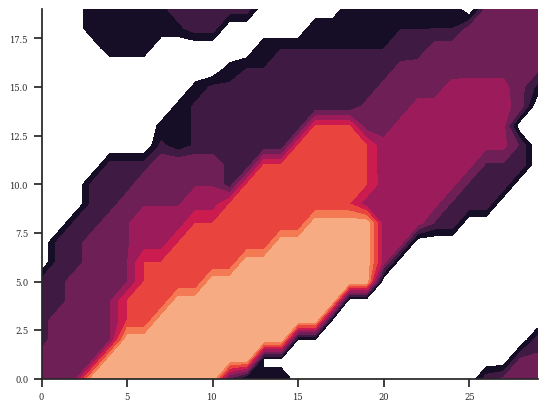

In [25]:
%matplotlib inline
plt.contourf(torp_grid[190:210, 210:240], levels = np.arange(0.1,1.01,0.1))

In [24]:
a = ps_grid[190:210, 210:240]
b = torp_grid[190:210, 210:240]
b[1,15]

0.07750000059604645

In [63]:
import json

year = 2019
date_str = '20190501'
time_str = '0000'
ps_dir = '/work/eric.loken/wofs/probSevere3_data/new_cintineo/PS_json/'
ps_file = '%s/%s/%s/PROBSEVERE-V3/SSEC_AWIPS_PROBSEVERE-V3_%s_%s00.json' %(ps_dir, year, date_str, date_str, time_str)
#ps_dir = '/work/eric.loken/wofs/probSevere'
#ps_file = '%s/MRMS_EXP_PROBSEVERE_%s.%s00.json' %(ps_dir, date_str, time_str)

f = open (ps_file) 
data = json.load(f)

In [64]:
for f in data['features']:
    print(f['properties']['MOTION_SOUTH'])

-9
0.9
-10
-8
-2
-8
-6
-12
-10
-13
0.4
-7
-9
-10
-7
-9
-2
-12
-5
-10
-9
-13
0.5
-4
-6
-9
-2
-8
5.6
-6
-6
-12
-13
-11
-10
-9
-5
-4
-7
-7
-15
-12
-7
-13
-4
-9
-8
-6
-7
-6
-3
3.6
-14
-14
-9
-7
-6
-8
-9
-6
-10
-6
-5
-15
-11
-9
-12
-2
-12
-14
-9
-7
-3
-6
-6
-13
-6
-2
-14
-10
-12
-10
-5
-6
-12
-6
-10
-6
-13
-7
-6
-6
-12
-12
-8
-7
-10
-9
-7
-3
-14
-9
-7
-11
-12
-10
-6
-2
-6
-4
-5
-8
-6
-6
-6
-11
-10
-7
-11
-11
-6
-11
-6
-6
-6
0.8
0.5
-6
-14
-3
-4
-6
-6
-6
-8
-7
-12
-12
-8
-11
-6
-6
-6
-11
-7
-9
-10
-14
-12


In [38]:
df = pd.read_csv('/work/ryan.martz/wofs_phi_data/experiments/vars_dict.csv')

In [40]:
i = 0
for row in df.Variable:
    print(i, row)
    i += 1

0 ws_80
1 dbz_1km
2 wz_0to2_instant
3 uh_0to2_instant
4 uh_2to5
5 w_up
6 w_1km
7 10-500m_bulkshear
8 fed
9 u_10
10 v_10
11 td_2
12 t_2
13 mid_level_lapse_rate
14 low_level_lapse_rate
15 shear_u_0to1
16 shear_v_0to1
17 shear_u_0to3
18 shear_v_0to3
19 shear_u_0to6
20 shear_v_0to6
21 srh_0to500
22 srh_0to1
23 srh_0to3
24 cape_sfc
25 stp
26 scp
27 stp_srh0to500
28 w_down
29 ctt
30 mslp
31 psfc
32 lcl_sfc
33 hail
34 freezing_level
35 prob40dbz
36 m1_uh_2to5
37 m2_uh_2to5
38 m3_uh_2to5
39 m4_uh_2to5
40 m5_uh_2to5
41 m6_uh_2to5
42 m7_uh_2to5
43 m8_uh_2to5
44 m9_uh_2to5
45 m10_uh_2to5
46 m11_uh_2to5
47 m12_uh_2to5
48 m13_uh_2to5
49 m14_uh_2to5
50 m15_uh_2to5
51 m16_uh_2to5
52 m17_uh_2to5
53 m18_uh_2to5
54 tornado_raw_probs
55 tornado_ages
56 tornado_leads
57 tornado_changes14
58 tornado_changes30
59 tornado_smooth_probs
60 wind_raw_probs
61 wind_ages
62 wind_leads
63 wind_changes14
64 wind_changes30
65 wind_smooth_probs
66 hail_raw_probs
67 hail_ages
68 hail_leads
69 hail_changes14
70 hail_cha

In [5]:
pred_dir = '/work/eric.loken/wofs/2024_update/SFE2024/fcst/full_npy_backup'
obs_dir = '/work/ryan.martz/wofs_phi_data/training_data/obs_and_warnings/full_1d_obs_and_warnings'

for file in os.listdir(pred_dir):
    if 'psv3_with_torp' in file:
        print(file)
    break

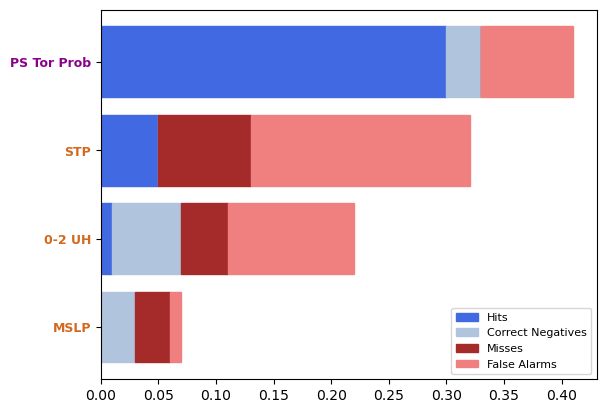

In [300]:
fig, ax = plt.subplots()

ys = [1, 2, 3, 4]
overall = np.array([0.21, 0.31, 0.41, 0.06])
overall = np.array([0.06, 0.21, 0.31, 0.41])

hits = np.array([0, 0.01, 0.05, 0.3])
misses = np.array([0.03, 0.04, 0.08, 0])
cnegs = np.array([0.03, 0.06, 0, 0.03])
fp = np.array([0.01, 0.11, 0.19, 0.08])
names = ['MSLP', '0-2 UH', 'STP', 'PS Tor Prob']
name_colors = ['chocolate', 'chocolate', 'chocolate', 'darkmagenta']

ax.set_yticks(ys)
ax.barh(ys, hits, color='royalblue', left=0, label='Hits', edgecolor='royalblue')
ax.barh(ys, cnegs, color='lightsteelblue', left=hits, label='Correct Negatives', edgecolor='lightsteelblue')
ax.barh(ys, misses, color='brown', left=hits+cnegs, label='Misses', edgecolor='brown')
ax.barh(ys, fp, color='lightcoral', left=hits+cnegs+misses, label='False Alarms', edgecolor='lightcoral')

ax.set_yticklabels(names, fontsize=9, fontweight='bold')
for ytick, color in zip(ax.get_yticklabels(), name_colors):
    ytick.set_color(color)

ax.legend(loc='lower right', prop={'size': 8}) 


In [13]:
def get_chunk_splits(dates, num_folds):
        '''Does the k fold logic. The class stores a list of dates to train on, and this samples it into training, testing, validation for each fold.
        This allows us to just use the fold number as an index to each of the lists to get the list of dates for the current fold for testing, validation,
        and training.'''
        
        num_dates = len(dates)
        indices = np.arange(num_dates)
        splits = np.array_split(indices, num_folds)
        chunk_splits = []
        for i in range(len(splits)):
            split = splits[i]
            chunk_splits.append(split[0])
        chunk_splits.append(num_dates)
        date_test_folds = []
        date_val_folds = []
        date_train_folds = []
        if num_folds == 1:
            date_test_folds = [dates]
            date_val_folds = [dates]
            date_train_folds = [dates]
            return
        for i in range(num_folds):
            if i == 0:
                date_test_folds.append(dates[chunk_splits[i]:chunk_splits[i+1]])
                date_val_folds.append(dates[chunk_splits[-2]:chunk_splits[-1]])
                date_train_folds.append(dates[chunk_splits[i+1]:chunk_splits[i+1+(num_folds-2)]])
            elif i == num_folds - 1:
                date_test_folds.append(dates[chunk_splits[i]:chunk_splits[-1]])
                date_val_folds.append(dates[chunk_splits[i-1]:chunk_splits[i]])
                date_train_folds.append(dates[chunk_splits[0]:chunk_splits[num_folds-2]])
            elif (i+1+(num_folds-2)) > (num_folds):
                date_test_folds.append(dates[chunk_splits[i]:chunk_splits[i+1]])
                date_val_folds.append(dates[chunk_splits[i-1]:chunk_splits[i]])
                train_folds = list(dates[chunk_splits[i+1]:chunk_splits[-1]])
                train_folds.extend(dates[chunk_splits[0]:chunk_splits[i-1]])
                date_train_folds.append(train_folds)
            else:
                date_test_folds.append(dates[chunk_splits[i]:chunk_splits[i+1]])
                date_val_folds.append(dates[chunk_splits[i-1]:chunk_splits[i]])
                date_train_folds.append(dates[chunk_splits[i+1]:chunk_splits[i+1+(num_folds-2)]])
        
        return date_train_folds, date_val_folds, date_test_folds

In [14]:
train, val, test = get_chunk_splits(np.genfromtxt('../wofs_phi/probSevere_dates.txt'), 5)

In [22]:
train[1]

array([20200506., 20200507., 20200508., 20200513., 20200515., 20200518.,
       20200519., 20200526., 20200527., 20200528., 20200529., 20200615.,
       20200616., 20200619., 20200621., 20200622., 20200623., 20200624.,
       20200626., 20200629., 20200630., 20200706., 20200710., 20200717.,
       20200723., 20200724., 20200725., 20200726., 20200801., 20200803.,
       20200804., 20200806., 20200812., 20200814., 20200815., 20200824.,
       20200825., 20200827., 20200909., 20200915., 20200916., 20210503.,
       20210504., 20210505., 20210506., 20210507., 20210510., 20210512.,
       20210513., 20210514., 20210517., 20210518., 20210519., 20210520.,
       20210521., 20210523., 20210524., 20210525., 20210526., 20210527.,
       20210528., 20210601., 20210602., 20210603., 20210604.])